In [1]:
import os
import sys
import numpy as np
import matplotlib.pyplot as plt

# Add the directory where dynamics.py and utils.py are located to sys.path
module_path = os.path.abspath(os.path.join('../src'))
if module_path not in sys.path:
    sys.path.append(module_path)

from tqdm import tqdm
from dynamics import SatelliteDynamics
from scipy.optimize import approx_fprime
from scipy.linalg import block_diag, solve
from utils import get_form_initial_conditions

In [2]:
# Simulation parameters
dt = 60.0  # Time step [s]
T = 395  # Duration [min]
T_RMSE = 300  # Index from which the RMSE is calculated
M = 1  # Number of Monte-Carlo simulations
N = 4  # Number of satellites
formation = 1
n_x = 6  # Number of states
n_p = 3  
n_y_1 = 3  # Number of measurements
n_y_2 = 2
n_y_3 = 2
n_y_4 = 2
K = T
W = 100 # Window size [min]

In [3]:
# Initial state vector and get the true state vectors (propagation) F
X_initial = get_form_initial_conditions(formation)
X_true = np.zeros((24, 1, T))
X_true[:, :, 0] = X_initial
for t in range(T - 1):
    X_true[:, :, t + 1] = SatelliteDynamics().x_new(dt, X_true[:, :, t])

# Process noise
q_chief_pos = 1e-1  # [m]
q_chief_vel = 1e-2 # [m / s]
Q_chief = (
    np.diag(np.concatenate([q_chief_pos * np.ones(3), q_chief_vel * np.ones(3)]))
    ** 2
)
q_deputy_pos = 1e0  # [m]
q_deputy_vel = 1e-2  # [m / s]
Q_deputy = (
    np.diag(np.concatenate([q_deputy_pos * np.ones(3), q_deputy_vel * np.ones(3)]))
    ** 2
)
Q_deputies = block_diag(Q_deputy, Q_deputy, Q_deputy)
Q = block_diag(Q_chief, Q_deputies)

# Observation noise
r_chief_pos = 1e-1  # [m]
R_chief = np.diag(np.concatenate([r_chief_pos * np.ones(3)])) ** 2
r_deputy_pos = 1e0  # [m]
R_deputies = np.diag(np.concatenate([r_deputy_pos * np.ones(6)])) ** 2
R = block_diag(R_chief, R_deputies)

# Initial deviation noise
p_pos_initial = 1e2  # [m]
p_vel_initial = 1e-2  # [m / s]
P = np.array([[1, 0, 0, 0, 0, 0], [0, 1, 0, 0, 0, 0], [0, 0, 1, 0, 0, 0]])

In [4]:
def h_function_chief(x_vec):
    """
    Computes the measurement vector based on the current state vector.
    The measurement vector includes position components.

    Parameters:
    x_vec (np.array): The current state vector of the satellite (position [km] and velocity [km / s]).
    """
    return x_vec[0:3]

def h_function_deputy(x_vec):
    """
    Computes the measurement vector based on the current state vector.

    Parameters:
    x_vec (np.array): The current state vector of the satellite (position [km] and velocity [km / s]).

    Returns:
    y (np.array): The measurement vector of the satellite (range [km]).
    """
    r_chief = x_vec[:3]
    r_deputy1 = x_vec[6:9]
    r_deputy2 = x_vec[12:15]
    r_deputy3 = x_vec[18:21]

    range_deputy1_chief = np.linalg.norm(r_deputy1 - r_chief)
    range_deputy1_deputy2 = np.linalg.norm(r_deputy1 - r_deputy2)
    range_deputy1_deputy3 = np.linalg.norm(r_deputy1 - r_deputy3)
    range_deputy2_chief = np.linalg.norm(r_deputy2 - r_chief)
    range_deputy2_deputy3 = np.linalg.norm(r_deputy2 - r_deputy3)
    range_deputy3_chief = np.linalg.norm(r_deputy3 - r_chief)

    return np.array(
        [
            [range_deputy1_chief],
            [range_deputy1_deputy2],
            [range_deputy1_deputy3],
            [range_deputy2_chief],
            [range_deputy2_deputy3],
            [range_deputy3_chief],
        ]
    )

def h(x_vec):
    return np.concatenate([h_function_chief(x_vec), h_function_deputy(x_vec)])

In [5]:
# Simulation setup
np.random.seed(43)
X_est = np.zeros_like(X_true)
initial_dev = np.concatenate(
    (
        p_pos_initial * np.random.randn(3, 1),
        p_vel_initial * np.random.randn(3, 1),
        p_pos_initial * np.random.randn(3, 1),
        p_vel_initial * np.random.randn(3, 1),
        p_pos_initial * np.random.randn(3, 1),
        p_vel_initial * np.random.randn(3, 1),
        p_pos_initial * np.random.randn(3, 1),
        p_vel_initial * np.random.randn(3, 1),
    )
)
X_est[:, :, 0] = X_initial + initial_dev
for t in range(T - 1):
    X_est[:, :, t + 1] = SatelliteDynamics().x_new(dt, X_est[:, :, t])

# Observations
Y = np.zeros((9, 1, T))
for t in range(T):
    Y[:, :, t] = h(X_true[:, :, t]) + np.random.normal(0, np.sqrt(np.diag(R)).reshape((9, 1)), size=(9, 1))
    
dev_chief_initial = np.linalg.norm(X_est[:3, :, :] - X_true[:3, :, :], axis=0).reshape(-1, 1)
dev_deputy1_initial = np.linalg.norm(X_est[6:9, :, :] - X_true[6:9, :, :], axis=0).reshape(-1, 1)
dev_deputy2_initial = np.linalg.norm(X_est[12:15, :, :] - X_true[12:15, :, :], axis=0).reshape(-1, 1)
dev_deputy3_initial = np.linalg.norm(X_est[18:21, :, :] - X_true[18:21, :, :], axis=0).reshape(-1, 1)

In [6]:
def surrogate_function(x_i, x_j, z_i, z_j, d_ij, sigma=None):
    """
    Compute the surrogate function Φ_ij.
    
    Args:
        x_i, x_j: Current position vectors for agents i and j
        z_i, z_j: Previous iteration position vectors (denoted as bar_x in the equation)
        d_ij: True measurement between agents i and j
        sigma: Standard deviation parameter
    """
    # Compute the norm of the difference between previous positions
    z_ij_norm = np.linalg.norm(P @ z_i - P @ z_j)
    
    # Term 1: ||x_i - bar_x_i||^2 / sigma^2
    term1 = np.linalg.norm(P @ x_i - P @ z_i)**2 / sigma**2
    
    # Term 2: (||bar_x_i - bar_x_j|| - d_ij) * (x_i - bar_x_i)^T(bar_x_i - bar_x_j) / (sigma^2 * ||bar_x_i - bar_x_j||)
    term2 = ((z_ij_norm - d_ij) / (sigma**2 * z_ij_norm)) * (P @ x_i - P @ z_i).T @ (P @ z_i - P @ z_j)
    
    # Term 3: ||x_j - bar_x_j||^2 / sigma^2
    term3 = np.linalg.norm(P @ x_j - P @ z_j)**2 / sigma**2
    
    # Term 4: -(||bar_x_i - bar_x_j|| - d_ij) * (x_j - bar_x_j)^T(bar_x_i - bar_x_j) / (sigma^2 * ||bar_x_i - bar_x_j||)
    term4 = -((z_ij_norm - d_ij) / (sigma**2 * z_ij_norm)) * (P @ x_j - P @ z_j).T @ (P @ z_i - P @ z_j)
    
    # Term 5: ||bar_x_i - bar_x_j||^2 / (2*sigma^2)
    term5 = z_ij_norm**2 / (2 * sigma**2)
    
    # Term 6: -d_ij * ||bar_x_i - bar_x_j|| / sigma^2
    term6 = -(d_ij * z_ij_norm) / sigma**2
    
    # Term 7: d_ij^2 / (2*sigma^2)
    term7 = d_ij**2 / (2 * sigma**2)
    
    return term1 + term2 + term3 + term4 + term5 + term6 + term7

def surrogate_gradient(x_i, x_j, z_i, z_j, d_ij, sigma=None):
    """
    Compute the gradient of the surrogate function Φ_ij.
    """
    z_ij_norm = np.linalg.norm(P @ z_i - P @ z_j)
    z_ij = P @ z_i - P @ z_j
    
    # Gradient with respect to x_i
    grad_i = (2/sigma**2) * P.T @ (P @ x_i - P @ z_i) + ((z_ij_norm - d_ij) / (sigma**2 * z_ij_norm)) * P.T @ z_ij
    
    # Gradient with respect to x_j
    grad_j = (2/sigma**2) * P.T @ (P @ x_j - P @ z_j) - ((z_ij_norm - d_ij) / (sigma**2 * z_ij_norm)) * P.T @ z_ij
    
    return grad_i, grad_j

def surrogate_hessian(x_i, x_j, z_i, z_j, d_ij, sigma=None):
    """
    Compute the Hessian of the surrogate function Φ_ij.
    """
    n = len(x_i)
    
    # The Hessian is constant with respect to x_i and x_j
    H_ii = (2/sigma**2) * P.T @ P
    H_ij = P.T @ np.zeros((n, n)) @ P
    H_ji = P.T @ np.zeros((n, n)) @ P
    H_jj = (2/sigma**2) * P.T @ P
    
    return H_ii, H_ij, H_ji, H_jj

In [7]:
def f(x_0, y, z_0=None):
    """
    Cost function combining direct measurements and surrogate terms.
    """
    f_x_0 = 0
    if z_0 is None:
        z_0 = x_0.copy()

    # Extract positions for each satellite
    x_1_k = x_0[:n_x, :]
    x_2_k = x_0[n_x:2*n_x, :]
    x_3_k = x_0[2*n_x:3*n_x, :]
    x_4_k = x_0[3*n_x:4*n_x, :]
    
    z_1_k = z_0[:n_x, :]
    z_2_k = z_0[n_x:2*n_x, :]
    z_3_k = z_0[2*n_x:3*n_x, :]
    z_4_k = z_0[3*n_x:4*n_x, :]
    
    for k in range(W):    
        # 1. Direct measurements (deputies to chief)
        y_1_k = y[:n_y_1, :, k]
        y_rel_k = y[n_y_1:, :, k]

        # Chief absolute measurements
        residual = y_1_k - P @ x_1_k
        f_x_0 += 1/2 * residual.T @ np.linalg.inv(R_chief) @ residual

        # Deputy-to-chief measurements
        y_21_k = y_rel_k[0]  # Deputy 1 to chief
        y_31_k = y_rel_k[3]  # Deputy 2 to chief
        y_41_k = y_rel_k[5]  # Deputy 3 to chief

        # Process direct measurements (deputies to chief)
        pairs_direct = [
            (2, 1, x_2_k, x_1_k, y_21_k),
            (3, 1, x_3_k, x_1_k, y_31_k),
            (4, 1, x_4_k, x_1_k, y_41_k),
        ]

        for i, j, x_i_k, x_j_k, y_ij_k in pairs_direct:
            d_ij_k_vec = P @ x_i_k - P @ x_j_k
            d_ij_k = np.linalg.norm(d_ij_k_vec)
            f_x_0 += (y_ij_k - d_ij_k) ** 2 / (2 * r_deputy_pos**2)

        # 2. Surrogate terms for residual edges (between deputies)
        pairs_surrogate = [
            (x_2_k, x_3_k, z_2_k, z_3_k, y_rel_k[1]),  # Deputies 1-2
            (x_2_k, x_4_k, z_2_k, z_4_k, y_rel_k[2]),  # Deputies 1-3
            (x_3_k, x_4_k, z_3_k, z_4_k, y_rel_k[4]),  # Deputies 2-3
        ]

        for x_i_k, x_j_k, z_i_k, z_j_k, d_ij_k in pairs_surrogate:
            f_x_0 += surrogate_function(x_i_k, x_j_k, z_i_k, z_j_k, d_ij_k, sigma=r_deputy_pos)

        if k < W - 1:
            # Propagate states
            x_1_k = SatelliteDynamics().x_new(dt, x_1_k)
            x_2_k = SatelliteDynamics().x_new(dt, x_2_k)
            x_3_k = SatelliteDynamics().x_new(dt, x_3_k)
            x_4_k = SatelliteDynamics().x_new(dt, x_4_k)
            
            z_1_k = SatelliteDynamics().x_new(dt, z_1_k)
            z_2_k = SatelliteDynamics().x_new(dt, z_2_k)
            z_3_k = SatelliteDynamics().x_new(dt, z_3_k)
            z_4_k = SatelliteDynamics().x_new(dt, z_4_k)

    return f_x_0

def grad_f(x_0, y, z_0=None):
    """
    Gradient of cost function.
    """
    grad_f_x_0 = np.zeros_like(x_0)
    if z_0 is None:
        z_0 = x_0.copy()

    # Extract positions and STMs
    x_1_k = x_0[:n_x, :]
    x_2_k = x_0[n_x:2*n_x, :]
    x_3_k = x_0[2*n_x:3*n_x, :]
    x_4_k = x_0[3*n_x:4*n_x, :]
    
    z_1_k = z_0[:n_x, :]
    z_2_k = z_0[n_x:2*n_x, :]
    z_3_k = z_0[2*n_x:3*n_x, :]
    z_4_k = z_0[3*n_x:4*n_x, :]
    
    F_1_k = np.eye(n_x)
    F_2_k = np.eye(n_x)
    F_3_k = np.eye(n_x)
    F_4_k = np.eye(n_x)

    for k in range(W):
        # 1. Direct measurements (deputies to chief)
        y_1_k = y[:n_y_1, :, k]
        y_rel_k = y[n_y_1:, :, k]

        # Chief absolute measurements gradient
        grad_f_x_0[:n_x, :] -= F_1_k.T @ P.T @ np.linalg.inv(R_chief) @ (y_1_k - P @ x_1_k)

        # Process direct measurements gradients (deputies to chief)
        pairs_direct = [
            (2, 1, x_2_k, x_1_k, y_rel_k[0], F_2_k, F_1_k),
            (3, 1, x_3_k, x_1_k, y_rel_k[3], F_3_k, F_1_k),
            (4, 1, x_4_k, x_1_k, y_rel_k[5], F_4_k, F_1_k),
        ]

        for i, j, x_i_k, x_j_k, y_ij_k, STM_t0_i, STM_t0_j in pairs_direct:
            d_ij_k_vec = P @ x_i_k - P @ x_j_k
            d_ij_k = np.linalg.norm(d_ij_k_vec)
            
            grad_i = -(y_ij_k - d_ij_k) / r_deputy_pos**2 * (STM_t0_i.T @ P.T @ d_ij_k_vec) / d_ij_k
            grad_j = (y_ij_k - d_ij_k) / r_deputy_pos**2 * (STM_t0_j.T @ P.T @ d_ij_k_vec) / d_ij_k
            
            grad_f_x_0[(i-1)*n_x:i*n_x, :] += grad_i
            grad_f_x_0[(j-1)*n_x:j*n_x, :] += grad_j

        # 2. Surrogate terms gradients (between deputies)
        pairs_surrogate = [
            (2, 3, x_2_k, x_3_k, z_2_k, z_3_k, y_rel_k[1], F_2_k, F_3_k),  # Deputies 1-2
            (2, 4, x_2_k, x_4_k, z_2_k, z_4_k, y_rel_k[2], F_2_k, F_4_k),  # Deputies 1-3
            (3, 4, x_3_k, x_4_k, z_3_k, z_4_k, y_rel_k[4], F_3_k, F_4_k),  # Deputies 2-3
        ]

        for i, j, x_i_k, x_j_k, z_i_k, z_j_k, d_ij_k, STM_t0_i, STM_t0_j in pairs_surrogate:
            grad_i, grad_j = surrogate_gradient(x_i_k, x_j_k, z_i_k, z_j_k, d_ij_k, sigma=r_deputy_pos)
            
            grad_f_x_0[(i-1)*n_x:i*n_x, :] += STM_t0_i.T @ grad_i
            grad_f_x_0[(j-1)*n_x:j*n_x, :] += STM_t0_j.T @ grad_j

        if k < W - 1:
            # Propagate states and STMs
            F_1_old = F_1_k
            F_2_old = F_2_k
            F_3_old = F_3_k
            F_4_old = F_4_k
            
            x_1_k, F_1_k = SatelliteDynamics().x_new_and_F(dt, x_1_k)
            x_2_k, F_2_k = SatelliteDynamics().x_new_and_F(dt, x_2_k)
            x_3_k, F_3_k = SatelliteDynamics().x_new_and_F(dt, x_3_k)
            x_4_k, F_4_k = SatelliteDynamics().x_new_and_F(dt, x_4_k)
            
            F_1_k = F_1_k @ F_1_old
            F_2_k = F_2_k @ F_2_old
            F_3_k = F_3_k @ F_3_old
            F_4_k = F_4_k @ F_4_old
            
            z_1_k = SatelliteDynamics().x_new(dt, z_1_k)
            z_2_k = SatelliteDynamics().x_new(dt, z_2_k)
            z_3_k = SatelliteDynamics().x_new(dt, z_3_k)
            z_4_k = SatelliteDynamics().x_new(dt, z_4_k)

    return grad_f_x_0

def hessian_f(x_0, y, z_0=None):
    """
    Hessian of cost function combining direct measurements and surrogate terms.
    """
    hessian_f_x_0 = np.zeros((x_0.shape[0], x_0.shape[0]))
    if z_0 is None:
        z_0 = x_0.copy()

    # Extract positions and STMs
    x_1_k = x_0[:n_x, :]
    x_2_k = x_0[n_x:2*n_x, :]
    x_3_k = x_0[2*n_x:3*n_x, :]
    x_4_k = x_0[3*n_x:4*n_x, :]
    
    z_1_k = z_0[:n_x, :]
    z_2_k = z_0[n_x:2*n_x, :]
    z_3_k = z_0[2*n_x:3*n_x, :]
    z_4_k = z_0[3*n_x:4*n_x, :]
    
    F_1_k = np.eye(n_x)
    F_2_k = np.eye(n_x)
    F_3_k = np.eye(n_x)
    F_4_k = np.eye(n_x)

    for k in range(W):
        # 1. Direct measurements (deputies to chief)
        y_1_k = y[:n_y_1, :, k]
        y_rel_k = y[n_y_1:, :, k]

        # Chief absolute measurements Hessian
        hessian_f_x_0[:n_x, :n_x] += F_1_k.T @ P.T @ np.linalg.inv(R_chief) @ P @ F_1_k

        # Process direct measurements Hessian (deputies to chief)
        pairs_direct = [
            (2, 1, x_2_k, x_1_k, y_rel_k[0], F_2_k, F_1_k),
            (3, 1, x_3_k, x_1_k, y_rel_k[3], F_3_k, F_1_k),
            (4, 1, x_4_k, x_1_k, y_rel_k[5], F_4_k, F_1_k),
        ]

        for i, j, x_i_k, x_j_k, y_ij_k, STM_t0_i, STM_t0_j in pairs_direct:
            d_ij_k_vec = P @ x_i_k - P @ x_j_k
            d_ij_k = np.linalg.norm(d_ij_k_vec)
            
            # Compute Hessian blocks for direct measurements
            H_term = 1/r_deputy_pos**2 * (
                ((y_ij_k - d_ij_k)/d_ij_k) * P.T @ P -
                (y_ij_k/d_ij_k**3) * P.T @ (d_ij_k_vec @ d_ij_k_vec.T) @ P
            )
            
            idx_i = (i-1)*n_x
            idx_j = (j-1)*n_x
            
            # Update Hessian blocks
            hessian_f_x_0[idx_i:idx_i+n_x, idx_i:idx_i+n_x] -= STM_t0_i.T @ H_term @ STM_t0_i
            hessian_f_x_0[idx_i:idx_i+n_x, idx_j:idx_j+n_x] += STM_t0_i.T @ H_term @ STM_t0_j
            hessian_f_x_0[idx_j:idx_j+n_x, idx_i:idx_i+n_x] += STM_t0_j.T @ H_term @ STM_t0_i
            hessian_f_x_0[idx_j:idx_j+n_x, idx_j:idx_j+n_x] -= STM_t0_j.T @ H_term @ STM_t0_j

        # 2. Surrogate terms Hessian (between deputies)
        pairs_surrogate = [
            (2, 3, P @ x_2_k, P @ x_3_k, P @ z_2_k, P @ z_3_k, y_rel_k[1], F_2_k, F_3_k),  # Deputies 1-2
            (2, 4, P @ x_2_k, P @ x_4_k, P @ z_2_k, P @ z_4_k, y_rel_k[2], F_2_k, F_4_k),  # Deputies 1-3
            (3, 4, P @ x_3_k, P @ x_4_k, P @ z_3_k, P @ z_4_k, y_rel_k[4], F_3_k, F_4_k),  # Deputies 2-3
        ]

        for i, j, x_i_k, x_j_k, z_i_k, z_j_k, d_ij_k, STM_t0_i, STM_t0_j in pairs_surrogate:
            H_ii, H_ij, H_ji, H_jj = surrogate_hessian(x_i_k, x_j_k, z_i_k, z_j_k, d_ij_k, sigma=r_deputy_pos)
            
            idx_i = (i-1)*n_x
            idx_j = (j-1)*n_x
            
            # Update Hessian blocks with surrogate terms
            hessian_f_x_0[idx_i:idx_i+n_x, idx_i:idx_i+n_x] += STM_t0_i.T @ H_ii @ STM_t0_i
            hessian_f_x_0[idx_i:idx_i+n_x, idx_j:idx_j+n_x] += STM_t0_i.T @ H_ij @ STM_t0_j
            hessian_f_x_0[idx_j:idx_j+n_x, idx_i:idx_i+n_x] += STM_t0_j.T @ H_ji @ STM_t0_i
            hessian_f_x_0[idx_j:idx_j+n_x, idx_j:idx_j+n_x] += STM_t0_j.T @ H_jj @ STM_t0_j

        if k < W - 1:
            # Propagate states and STMs
            F_1_old = F_1_k
            F_2_old = F_2_k
            F_3_old = F_3_k
            F_4_old = F_4_k
            
            x_1_k, F_1_k = SatelliteDynamics().x_new_and_F(dt, x_1_k)
            x_2_k, F_2_k = SatelliteDynamics().x_new_and_F(dt, x_2_k)
            x_3_k, F_3_k = SatelliteDynamics().x_new_and_F(dt, x_3_k)
            x_4_k, F_4_k = SatelliteDynamics().x_new_and_F(dt, x_4_k)
            
            F_1_k = F_1_k @ F_1_old
            F_2_k = F_2_k @ F_2_old
            F_3_k = F_3_k @ F_3_old
            F_4_k = F_4_k @ F_4_old
            
            z_1_k = SatelliteDynamics().x_new(dt, z_1_k)
            z_2_k = SatelliteDynamics().x_new(dt, z_2_k)
            z_3_k = SatelliteDynamics().x_new(dt, z_3_k)
            z_4_k = SatelliteDynamics().x_new(dt, z_4_k)

    return hessian_f_x_0

# def numerical_gradient(f, x_0, y, z_0=None, epsilon=1e-6):
#     """
#     Compute the numerical gradient of f at x_0 using finite differences.
    
#     Args:
#         f (function): The cost function.
#         x_0 (numpy.ndarray): The current state vector.
#         STM (numpy.ndarray): State transition matrix.
#         y (numpy.ndarray): Observed data.
#         epsilon (float): Small perturbation for finite differences.

#     Returns:
#         numpy.ndarray: Numerical gradient of f at x_0.
#     """
#     if z_0 is None:
#         z_0 = x_0.copy()
    
#     grad = np.zeros_like(x_0)
#     for i in range(x_0.size):
#         # Create perturbed versions of x_0
#         x_0_plus = x_0.copy()
#         x_0_minus = x_0.copy()
        
#         # Add and subtract epsilon to the i-th component
#         x_0_plus[i] += epsilon
#         x_0_minus[i] -= epsilon
        
#         # Compute the function value for perturbed inputs
#         f_plus = f(x_0_plus, y, z_0)
#         f_minus = f(x_0_minus, y, z_0)
        
#         # Central difference approximation
#         grad[i] = (f_plus - f_minus) / (2 * epsilon)
    
#     return grad

# Test grad_f using scipy's approx_fprime
# n = 0
# m = 0
# W = 100
# numerical_grad = numerical_gradient(f, X_true[:, :, n], Y[:, :, n:n + W], X_true[:, :, m]).flatten()
# analytical_grad = grad_f(X_true[:, :, n], Y[:, :, n:n + W], X_true[:, :, m]).flatten()
# print("Numerical Gradient:", numerical_grad)
# print("Analytical Gradient:", analytical_grad)
# print("Gradient Difference:", numerical_grad - analytical_grad)
# -np.linalg.inv(hessian_f(X_true[:, :, n], Y[:, :, n:n + W], X_true[:, :, m])) @ grad_f(X_true[:, :, n], Y[:, :, n:n + W], X_true[:, :, m])

# def numerical_hessian(f, x_0, y, z_0=None, epsilon=1e-6):
#     """
#     Compute the numerical Hessian of f at x_0 using finite differences.
    
#     Args:
#         f (function): The cost function.
#         x_0 (numpy.ndarray): The current state vector.
#         y (numpy.ndarray): Observed data.
#         z_0 (numpy.ndarray, optional): Previous iteration state vector.
#         epsilon (float): Small perturbation for finite differences.

#     Returns:
#         numpy.ndarray: Numerical Hessian of f at x_0.
#     """
#     if z_0 is None:
#         z_0 = x_0.copy()
    
#     n = x_0.size
#     H = np.zeros((n, n))
    
#     for i in range(n):
#         for j in range(n):
#             # Create perturbed versions of x_0
#             x_pp = x_0.copy()  # x plus-plus
#             x_pm = x_0.copy()  # x plus-minus
#             x_mp = x_0.copy()  # x minus-plus
#             x_mm = x_0.copy()  # x minus-minus
            
#             # Add/subtract epsilon to the i,j components
#             x_pp[i] += epsilon
#             x_pp[j] += epsilon
            
#             x_pm[i] += epsilon
#             x_pm[j] -= epsilon
            
#             x_mp[i] -= epsilon
#             x_mp[j] += epsilon
            
#             x_mm[i] -= epsilon
#             x_mm[j] -= epsilon
            
#             # Compute function values and ensure they're scalar
#             f_pp = f(x_pp, y, z_0).item()
#             f_pm = f(x_pm, y, z_0).item()
#             f_mp = f(x_mp, y, z_0).item()
#             f_mm = f(x_mm, y, z_0).item()
            
#             # Central difference approximation for second derivative
#             H[i, j] = (f_pp - f_pm - f_mp + f_mm) / (4 * epsilon * epsilon)
    
#     return H

# # Example usage to test:
# n = 0  # time index
# m = 0  # previous iteration time index
# W = 1  # window size

# numerical_H = numerical_hessian(f, X_true[:, :, n], Y[:, :, n:n + W], X_true[:, :, m])
# analytical_H = hessian_f(X_true[:, :, n], Y[:, :, n:n + W], X_true[:, :, m])

# print("Numerical Hessian:", numerical_H)
# print("Analytical Hessian:", analytical_H)
# print("Hessian Difference:", np.linalg.norm(numerical_H - analytical_H))

# Test grad_f using scipy's approx_fprime
# n = 0
# m = 10
# W = 10
# Y = np.zeros((9, 1, T))
# for t in range(T):
#     Y[:, :, t] = h(X_true[:, :, t]) + np.random.normal(0, np.sqrt(np.diag(R)).reshape((9, 1)), size=(9, 1))
# x_init = np.zeros((4 * n_x, 1))
# x_init[:4*n_x, :] = X_est[:, :, 0]
# f(x_init, Y[:, :, n:n + W]), f(x_init, Y[:, :, n:n + W], X_true[:, :, m]), np.linalg.norm(grad_f(x_init, Y[:, :, n:n + W])), np.linalg.norm(grad_f(x_init, Y[:, :, n:n + W], X_true[:, :, m]))

In [8]:
def L(x_0, y, z_0=None):
    """
    Lagrangian wrapper for the cost function.
    """
    return f(x_0, y, z_0)
    
def grad_L(x_0, y, z_0=None):
    """
    Gradient of Lagrangian wrapper.
    """
    return grad_f(x_0, y, z_0)

def hessian_L(x_0, y, z_0=None):
    """
    Hessian of Lagrangian wrapper.
    """
    return hessian_f(x_0, y, z_0)

In [9]:

class MM_Newton:
    def __init__(self, grad_tol=1e0, max_iter=20, mm_tol=1e0, mm_max_iter=5):
        self.grad_tol = grad_tol
        self.max_iter = max_iter
        self.mm_tol = mm_tol
        self.mm_max_iter = mm_max_iter
        
        # Storage for results
        self.cost_function_values = []
        self.grad_norm_values = []

    def solve(self, x_init, Y, X_true):
        x = x_init
        z = x_init.copy()  # Initialize z as current iterate
        
        for mm_iter in range(self.mm_max_iter):
            print(f"\nMajorization-Minimization Iteration {mm_iter + 1}")
            
            prev_cost_function_value = None
            prev_grad_norm_value = None
            prev_global_error = None
            
            # Solve the surrogate problem
            for iteration in range(self.max_iter):
                # Compute the cost function, gradient and Hessian using current z
                L_x = L(x, Y, z)
                grad_L_x = grad_L(x, Y, z)
                hessian_L_x = hessian_L(x, Y, z)

                # Convergence tracking
                cost_function_value = L_x[0][0]
                grad_norm_value = np.linalg.norm(grad_L_x)

                # Store the norms
                self.cost_function_values.append(cost_function_value)
                self.grad_norm_values.append(grad_norm_value)
                
                if prev_cost_function_value is not None:
                    cost_function_change = (cost_function_value - prev_cost_function_value) / abs(prev_cost_function_value) * 100
                    grad_norm_change = (grad_norm_value - prev_grad_norm_value) / abs(prev_grad_norm_value) * 100
                    global_error_change = (np.linalg.norm(x - X_true) - prev_global_error) / abs(prev_global_error) * 100
                prev_cost_function_value = cost_function_value
                prev_grad_norm_value = grad_norm_value
                prev_global_error = np.linalg.norm(x - X_true)

                # Check convergence and print metrics
                if grad_norm_value < self.grad_tol or iteration + 1 == self.max_iter:
                    print(f"STOP on Iteration {iteration}\nCost function = {cost_function_value} ({cost_function_change:.2f}%)\nGradient norm = {grad_norm_value} ({grad_norm_change:.2f}%)\nGlobal relative error = {np.linalg.norm(x - X_true)} ({global_error_change:.2f}%)")
                    print(f"Final position relative errors: {np.linalg.norm(x[0:3, :] - X_true[0:3, :])} m, {np.linalg.norm(x[6:9, :] - X_true[6:9, :])} m, {np.linalg.norm(x[12:15, :] - X_true[12:15, :])} m, {np.linalg.norm(x[18:21, :] - X_true[18:21, :])} m\n")
                    break
                else:
                    if iteration == 0:
                        print(f"Before applying the algorithm\nCost function: {cost_function_value}\nGradient norm: {grad_norm_value}\nGlobal relative error: {np.linalg.norm(x - X_true)}")
                    else:
                        print(f"Iteration {iteration}\nCost function: {cost_function_value} ({cost_function_change:.2f}%)\nGradient norm: {grad_norm_value} ({grad_norm_change:.2f}%)\nGlobal relative error = {np.linalg.norm(x - X_true)} ({global_error_change:.2f}%)")
                        
                # Print relative errors 
                print(f"Position relative errors: {np.linalg.norm(x[0:3, :] - X_true[0:3, :])} m, {np.linalg.norm(x[6:9, :] - X_true[6:9, :])} m, {np.linalg.norm(x[12:15, :] - X_true[12:15, :])} m, {np.linalg.norm(x[18:21, :] - X_true[18:21, :])} m\n")
                
                # Solve for the Newton step
                delta_x = solve(hessian_L_x, -grad_L_x)
                x += delta_x
            
            # Update z for next majorization step
            if np.linalg.norm(x - z) < self.mm_tol:
                print(f"Majorization-Minimization converged after {mm_iter + 1} iterations")
                break
            
            # Update z for next majorization step
            z = x.copy()

        return x

In [10]:
def give_me_the_plots(cost_function_values, grad_norm_values):
    iterations = np.arange(0, len(cost_function_values))

    # Plot 1
    plt.semilogy(iterations, cost_function_values, '.-')
    plt.xlabel(r'$m$')
    plt.ylabel(r'$L(x^{(m)})$')
    plt.grid(True)
    plt.grid(True, which="minor", linestyle='--')
    plt.show()
    
    # Plot 2
    plt.semilogy(iterations, grad_norm_values, '.-')
    plt.xlabel(r'$m$')
    plt.ylabel(r'$||\nabla L(x^{(m)})||_2$')
    plt.grid(True)
    plt.grid(True, which="minor", linestyle='--')
    plt.show()

Windows:   0%|          | 0/296 [00:00<?, ?it/s]


Majorization-Minimization Iteration 1
Before applying the algorithm
Cost function: 1027490136.0165377
Gradient norm: 29945857737.629856
Global relative error: 354.63849616863644
Position relative errors: 101.72796255564326 m, 242.56776705223683 m, 194.18001273776096 m, 137.38589643018517 m

Iteration 1
Cost function: 308413682.23199487 (-69.98%)
Gradient norm: 17017236.520509288 (-99.94%)
Global relative error = 400.09937756733666 (12.82%)
Position relative errors: 4.321105642713138 m, 200.14431318748493 m, 281.51977451960164 m, 201.8650911126859 m

Iteration 2
Cost function: 308393795.98104805 (-0.01%)
Gradient norm: 2924.8661530007207 (-99.98%)
Global relative error = 402.60907649355926 (0.63%)
Position relative errors: 4.641425477618749 m, 203.25805556296876 m, 283.3899480288305 m, 201.11844725098297 m

STOP on Iteration 3
Cost function = 308393795.97892535 (-0.00%)
Gradient norm = 0.32165434256502484 (-99.99%)
Global relative error = 402.6106470143682 (0.00%)
Final position relati

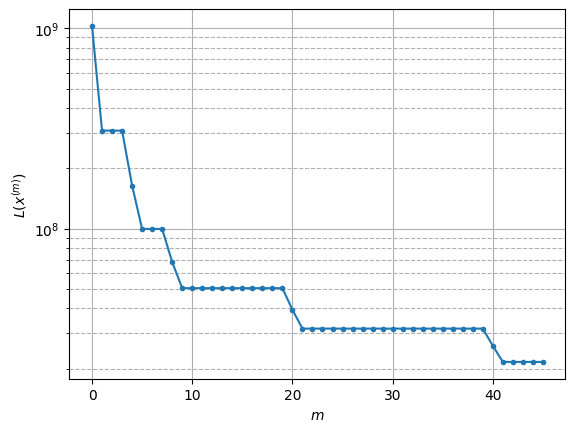

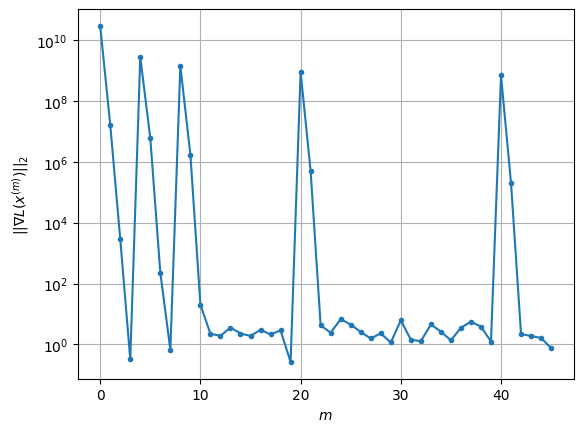

Windows:   0%|          | 1/296 [02:07<10:28:11, 127.77s/it]


Majorization-Minimization Iteration 1
Before applying the algorithm
Cost function: 18546104.202025242
Gradient norm: 584563095.8692791
Global relative error: 331.86279346126975
Position relative errors: 1.474757323593856 m, 122.74461423571438 m, 305.2472929699236 m, 43.45580047709829 m

Iteration 1
Cost function: 15587377.880694726 (-15.95%)
Gradient norm: 134689.83469549657 (-99.98%)
Global relative error = 316.81623896762187 (-4.53%)
Position relative errors: 1.1573627139967755 m, 117.12494736869988 m, 291.70544625800596 m, 39.50563435367664 m

STOP on Iteration 2
Cost function = 15587377.343162466 (-0.00%)
Gradient norm = 0.7321871938831969 (-100.00%)
Global relative error = 316.8124072273099 (-0.00%)
Final position relative errors: 1.157115657489859 m, 117.12538538449823 m, 291.700611388583 m, 39.509313968374556 m


Majorization-Minimization Iteration 2
Before applying the algorithm
Cost function: 13157067.50825697
Gradient norm: 488514369.6943592
Global relative error: 316.812407

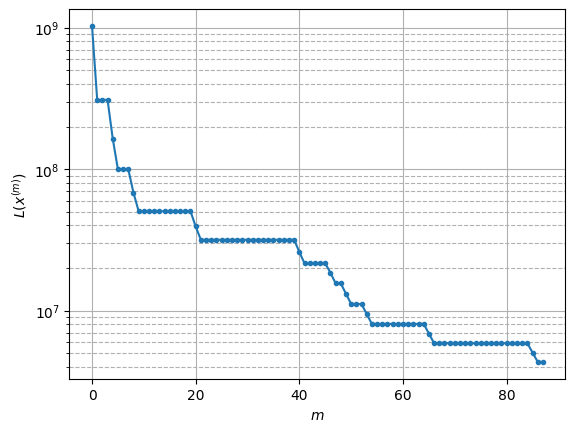

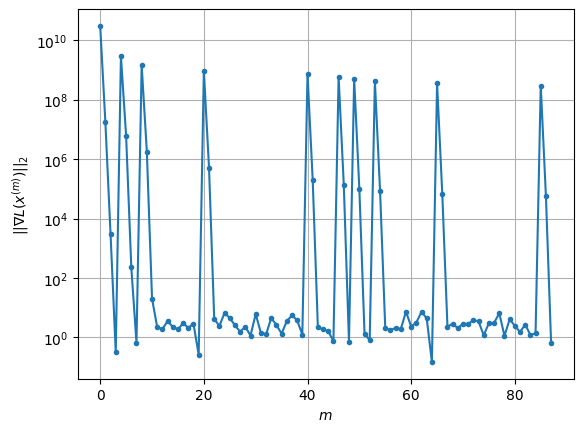

Windows:   1%|          | 2/296 [04:02<9:47:26, 119.89s/it] 


Majorization-Minimization Iteration 1
Before applying the algorithm
Cost function: 3778026.1841975045
Gradient norm: 253129640.28039372
Global relative error: 268.68089524249064
Position relative errors: 0.33260288246988085 m, 116.27275775038282 m, 225.43000043208778 m, 88.60659741425009 m

Iteration 1
Cost function: 3259273.5160862473 (-13.73%)
Gradient norm: 47634.55384309635 (-99.98%)
Global relative error = 262.9249828416378 (-2.14%)
Position relative errors: 0.22546219026613173 m, 113.12066312463972 m, 214.97408521224867 m, 100.5943081583885 m

Iteration 2
Cost function: 3259273.485846832 (-0.00%)
Gradient norm: 3.876028093770209 (-99.99%)
Global relative error = 262.926719687926 (0.00%)
Position relative errors: 0.22527136945806409 m, 113.12315070728289 m, 214.97434408894202 m, 100.59549758877014 m

Iteration 3
Cost function: 3259273.4858648623 (0.00%)
Gradient norm: 1.3290086707353528 (-65.71%)
Global relative error = 262.9267196886488 (0.00%)
Position relative errors: 0.225271

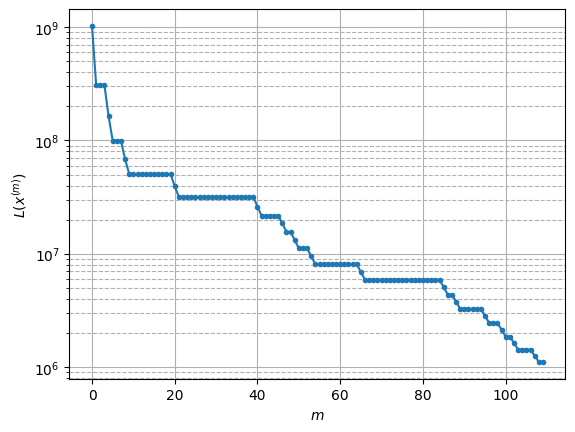

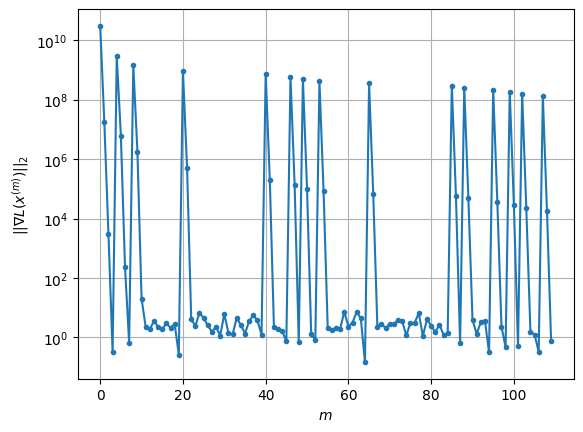

Windows:   1%|          | 3/296 [04:59<7:25:30, 91.23s/it] 


Majorization-Minimization Iteration 1
Before applying the algorithm
Cost function: 976132.8384524127
Gradient norm: 113075391.12105937
Global relative error: 231.98954235951368
Position relative errors: 0.2985912351266316 m, 109.22402476886262 m, 164.47131854741397 m, 121.81232437325502 m

Iteration 1
Cost function: 866351.1412003622 (-11.25%)
Gradient norm: 14697.539089198133 (-99.99%)
Global relative error = 227.22273484378633 (-2.05%)
Position relative errors: 0.285026098973121 m, 105.8512415701393 m, 155.79960378403655 m, 127.09043590147473 m

STOP on Iteration 2
Cost function = 866351.137840241 (-0.00%)
Gradient norm = 0.8583791043497546 (-99.99%)
Global relative error = 227.22400152692404 (0.00%)
Final position relative errors: 0.2848151283804983 m, 105.85173640535835 m, 155.80046380645186 m, 127.09123461134946 m


Majorization-Minimization Iteration 2
Before applying the algorithm
Cost function: 771465.7572535442
Gradient norm: 96614344.1562113
Global relative error: 227.224001

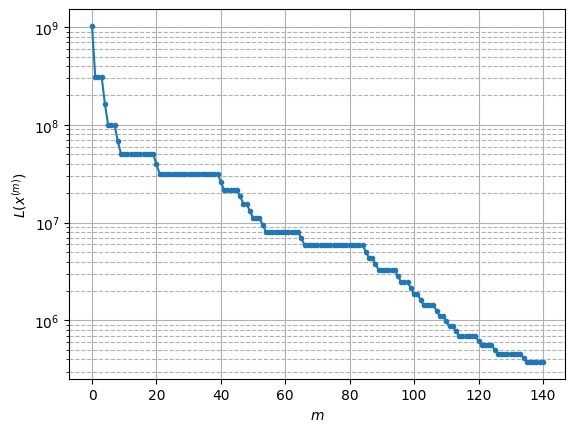

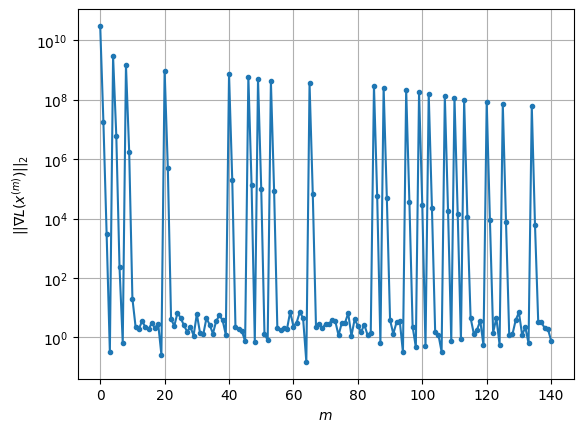

Windows:   1%|▏         | 4/296 [06:25<7:14:24, 89.26s/it]


Majorization-Minimization Iteration 1
Before applying the algorithm
Cost function: 340820.93135255616
Gradient norm: 51576628.869946525
Global relative error: 202.90252647474537
Position relative errors: 0.27785761405391274 m, 100.88903528504103 m, 116.87834283651395 m, 131.6439276101603 m

Iteration 1
Cost function: 312306.47638370085 (-8.37%)
Gradient norm: 4869.508510006551 (-99.99%)
Global relative error = 199.11908466806906 (-1.86%)
Position relative errors: 0.273391812451346 m, 97.86016589551313 m, 110.48022880213391 m, 133.66284386570854 m

Iteration 2
Cost function: 312306.4758700227 (-0.00%)
Gradient norm: 2.3691572684410316 (-99.95%)
Global relative error = 199.11955839126347 (0.00%)
Position relative errors: 0.27330157775606195 m, 97.86022219425529 m, 110.48075508078257 m, 133.66307353958263 m

Iteration 3
Cost function: 312306.4758760684 (0.00%)
Gradient norm: 1.0341376949964372 (-56.35%)
Global relative error = 199.11955839386584 (0.00%)
Position relative errors: 0.273301

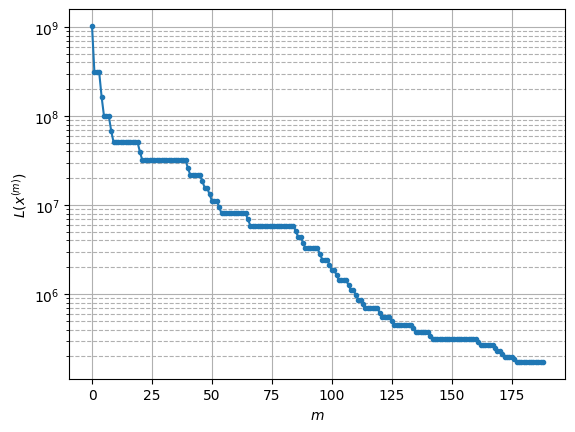

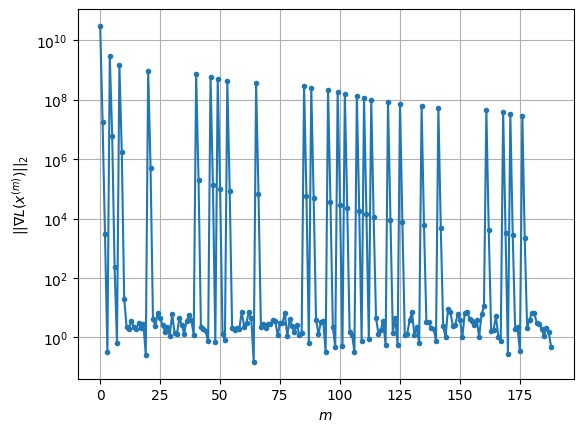

Windows:   2%|▏         | 5/296 [08:36<8:25:16, 104.18s/it]


Majorization-Minimization Iteration 1
Before applying the algorithm
Cost function: 161554.16603655013
Gradient norm: 24195962.2389527
Global relative error: 180.2807770532699
Position relative errors: 0.2221727077287095 m, 93.42916285724982 m, 82.20509467688471 m, 130.4390678403091 m

Iteration 1
Cost function: 152048.43965898102 (-5.88%)
Gradient norm: 1870.391874373842 (-99.99%)
Global relative error = 177.23207923108535 (-1.69%)
Position relative errors: 0.2225510556277928 m, 90.92129820866064 m, 77.92911422915805 m, 130.6578010442534 m

STOP on Iteration 2
Cost function = 152048.43955661863 (-0.00%)
Gradient norm = 0.7440723080305446 (-99.96%)
Global relative error = 177.232194841441 (0.00%)
Final position relative errors: 0.22250888983518569 m, 90.92128146006787 m, 77.92936186648109 m, 130.65782189090493 m


Majorization-Minimization Iteration 2
Before applying the algorithm
Cost function: 143469.51048111918
Gradient norm: 21104221.631633643
Global relative error: 177.23219484144

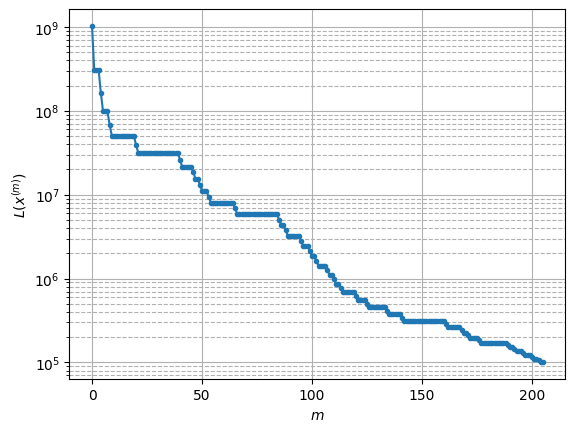

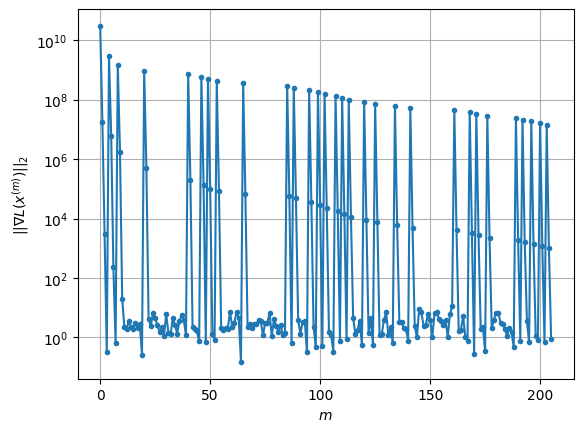

Windows:   2%|▏         | 6/296 [09:21<6:47:09, 84.24s/it] 


Majorization-Minimization Iteration 1
Before applying the algorithm
Cost function: 97024.3369933439
Gradient norm: 11796081.304238917
Global relative error: 161.91450568727572
Position relative errors: 0.1726808225014612 m, 87.30904125292028 m, 58.02621565457251 m, 123.39492070242069 m

Iteration 1
Cost function: 92993.80623193689 (-4.15%)
Gradient norm: 879.7412064514803 (-99.99%)
Global relative error = 159.30062118504142 (-1.61%)
Position relative errors: 0.17209314650710952 m, 85.27559036719478 m, 55.40056240015921 m, 122.61913043326297 m

Iteration 2
Cost function: 92993.80620219886 (-0.00%)
Gradient norm: 1.1439626604450313 (-99.87%)
Global relative error = 159.30063280182145 (0.00%)
Position relative errors: 0.17207180357870905 m, 85.27557101045669 m, 55.40066052046933 m, 122.61911468479109 m

STOP on Iteration 3
Cost function = 92993.80619944326 (-0.00%)
Gradient norm = 0.32699371028747926 (-71.42%)
Global relative error = 159.30063280508614 (0.00%)
Final position relative err

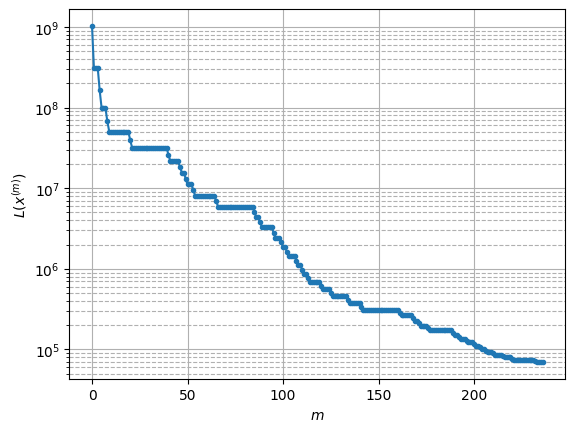

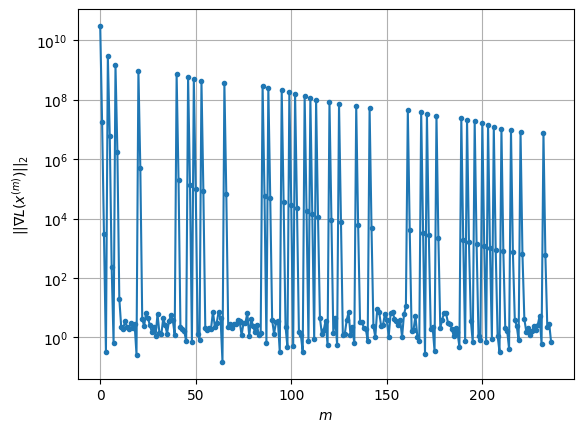

Windows:   2%|▏         | 7/296 [10:42<6:40:38, 83.18s/it]


Majorization-Minimization Iteration 1
Before applying the algorithm
Cost function: 67935.1413431611
Gradient norm: 5984766.816880772
Global relative error: 146.08027669628066
Position relative errors: 0.1337046878469519 m, 82.20036551696047 m, 41.43322080790192 m, 113.4273602785427 m

Iteration 1
Cost function: 65829.73394252437 (-3.10%)
Gradient norm: 518.1812687894227 (-99.99%)
Global relative error = 143.70510440378015 (-1.63%)
Position relative errors: 0.13325296873637277 m, 80.51016808190349 m, 39.97299674112929 m, 112.12208413302693 m

STOP on Iteration 2
Cost function = 65829.73393198264 (-0.00%)
Gradient norm = 0.3095553994644704 (-99.94%)
Global relative error = 143.70509978203017 (-0.00%)
Final position relative errors: 0.13324147266724326 m, 80.51015320265962 m, 39.973028113321725 m, 112.12207772253319 m


Majorization-Minimization Iteration 2
Before applying the algorithm
Cost function: 63891.03217353601
Gradient norm: 5405404.448764949
Global relative error: 143.705099782

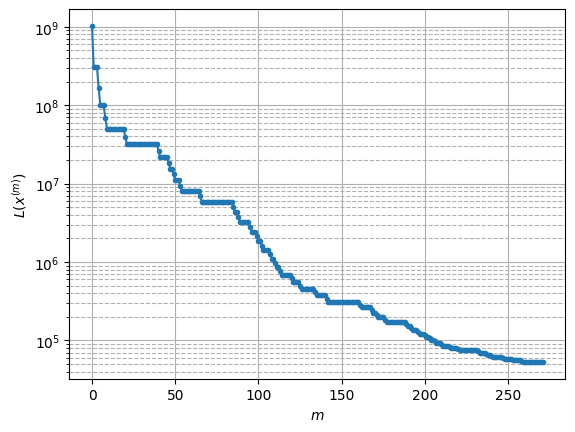

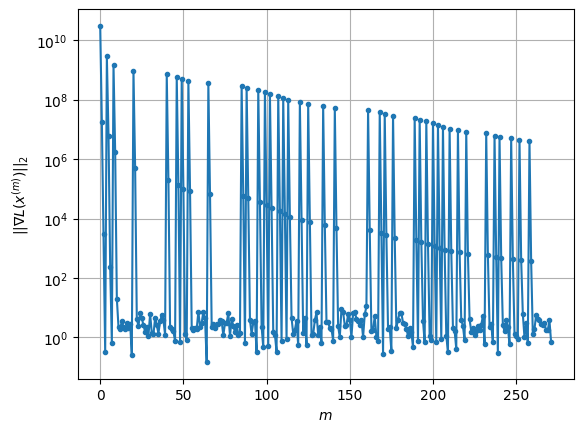

Windows:   3%|▎         | 8/296 [12:18<6:57:51, 87.05s/it]


Majorization-Minimization Iteration 1
Before applying the algorithm
Cost function: 52115.51339578639
Gradient norm: 3242827.24188192
Global relative error: 131.82938379685856
Position relative errors: 0.10551688575430382 m, 77.5792400343935 m, 29.9911045459931 m, 102.27866852711773 m

Iteration 1
Cost function: 50803.09231323854 (-2.52%)
Gradient norm: 360.1066324579697 (-99.99%)
Global relative error = 129.60991488983646 (-1.68%)
Position relative errors: 0.10463447254850793 m, 76.12990007023146 m, 29.252814014787326 m, 100.73324714755529 m

Iteration 2
Cost function: 50803.092310013235 (-0.00%)
Gradient norm: 3.9726387404691246 (-98.90%)
Global relative error = 129.60991400335178 (-0.00%)
Position relative errors: 0.10462794578092544 m, 76.12988680402722 m, 29.252822473554023 m, 100.73325358329748 m

Iteration 3
Cost function: 50803.09231156029 (0.00%)
Gradient norm: 4.526538073330215 (13.94%)
Global relative error = 129.6099139997173 (-0.00%)
Position relative errors: 0.10462793779

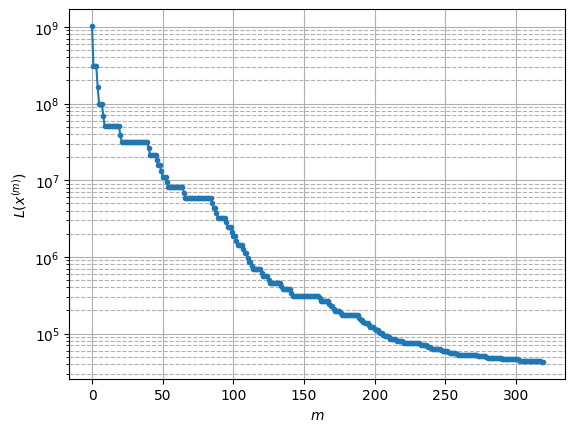

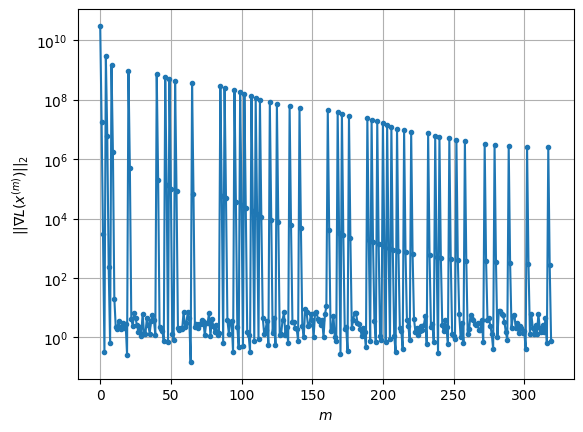

Windows:   3%|▎         | 9/296 [14:24<7:55:13, 99.35s/it]


Majorization-Minimization Iteration 1
Before applying the algorithm
Cost function: 41997.46601392678
Gradient norm: 1773374.0831534537
Global relative error: 118.76561386083328
Position relative errors: 0.08416982241095915 m, 73.11345947719506 m, 21.81241262944484 m, 91.01574481942941 m

Iteration 1
Cost function: 41070.365138092006 (-2.21%)
Gradient norm: 274.7047963494014 (-99.98%)
Global relative error = 116.70422976089327 (-1.74%)
Position relative errors: 0.0752930615974455 m, 71.8282181101617 m, 21.495872868271515 m, 89.43415601696965 m

Iteration 2
Cost function: 41070.365135927284 (-0.00%)
Gradient norm: 1.8796692388271528 (-99.32%)
Global relative error = 116.70423192250838 (0.00%)
Position relative errors: 0.07528933084726516 m, 71.82820541278645 m, 21.49587340150232 m, 89.43416891042679 m

Iteration 3
Cost function: 41070.36513804942 (0.00%)
Gradient norm: 4.571939372973596 (143.23%)
Global relative error = 116.70423192617501 (0.00%)
Position relative errors: 0.075289323923

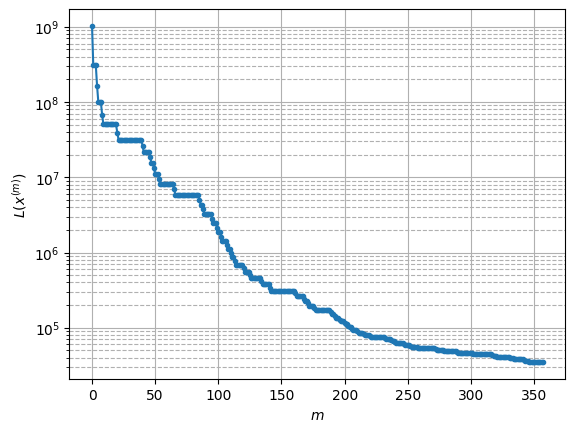

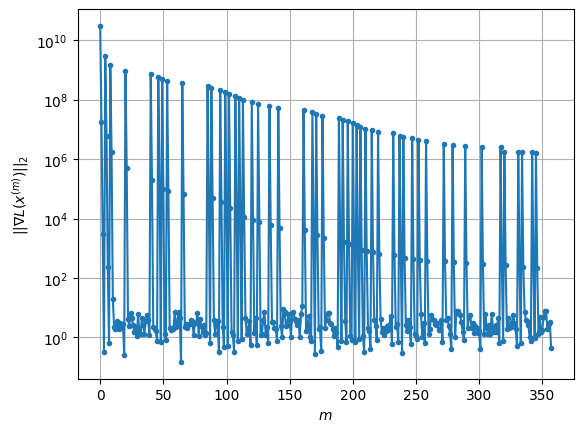

Windows:   3%|▎         | 10/296 [16:07<7:59:06, 100.51s/it]


Majorization-Minimization Iteration 1
Before applying the algorithm
Cost function: 34836.66191725115
Gradient norm: 1162954.1587534086
Global relative error: 106.83863617126913
Position relative errors: 0.06024476558762503 m, 68.57611704670344 m, 15.787942965365731 m, 80.38975840769452 m

Iteration 1
Cost function: 34128.36488886464 (-2.03%)
Gradient norm: 219.67429181876233 (-99.98%)
Global relative error = 104.92481617149816 (-1.79%)
Position relative errors: 0.05653401701486268 m, 67.41455684528121 m, 15.693353847614947 m, 78.85541529778972 m

Iteration 2
Cost function: 34128.36489097121 (0.00%)
Gradient norm: 2.504375216985892 (-98.86%)
Global relative error = 104.92481986500813 (0.00%)
Position relative errors: 0.056531943284200775 m, 67.41454534855767 m, 15.693352211667538 m, 78.85543036810839 m

Iteration 3
Cost function: 34128.36489187022 (0.00%)
Gradient norm: 3.9491943607561812 (57.69%)
Global relative error = 104.9248198578007 (-0.00%)
Position relative errors: 0.0565319469

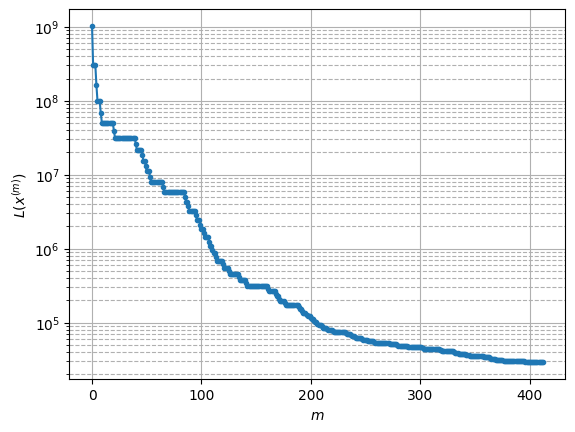

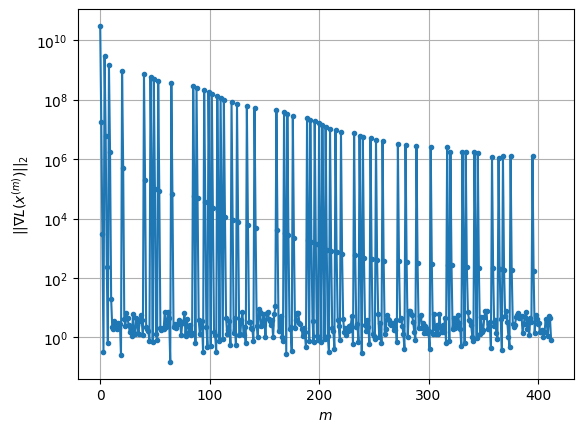

Windows:   4%|▎         | 11/296 [18:24<8:50:37, 111.71s/it]


Majorization-Minimization Iteration 1
Before applying the algorithm
Cost function: 29481.060366247115
Gradient norm: 944712.4193318915
Global relative error: 95.97594488164614
Position relative errors: 0.045229014724687676 m, 63.89194841565103 m, 11.3938696558473 m, 70.70606771374315 m

Iteration 1
Cost function: 28901.80425102905 (-1.96%)
Gradient norm: 184.41118551752785 (-99.98%)
Global relative error = 94.18423956166774 (-1.87%)
Position relative errors: 0.057721327596295204 m, 62.82074277678997 m, 11.37886066155683 m, 69.24387002246519 m

STOP on Iteration 2
Cost function = 28901.8042493965 (-0.00%)
Gradient norm = 0.3696283949984432 (-99.80%)
Global relative error = 94.18424205775192 (0.00%)
Final position relative errors: 0.05772044047804531 m, 62.820730991422124 m, 11.378858392839533 m, 69.24388448327778 m


Majorization-Minimization Iteration 2
Before applying the algorithm
Cost function: 28371.07544124495
Gradient norm: 797408.3997065654
Global relative error: 94.18424205775

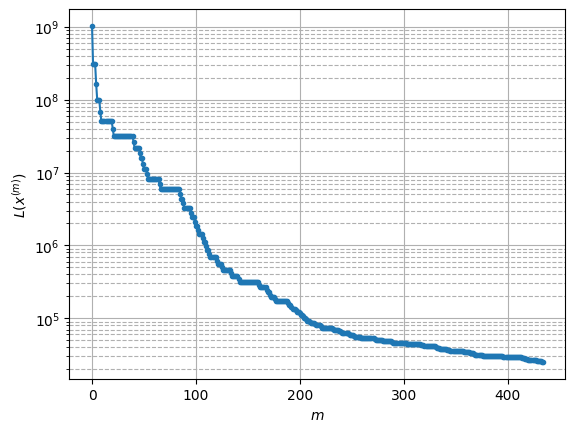

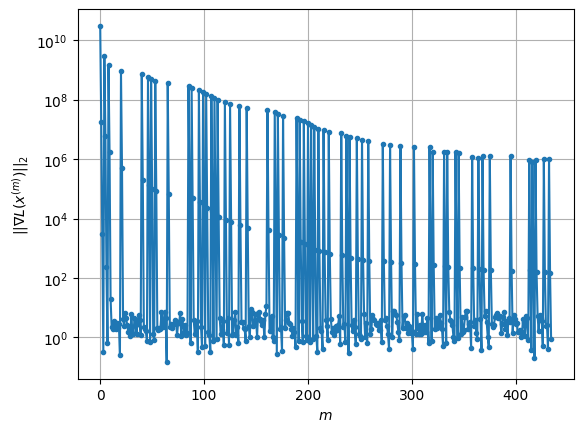

Windows:   4%|▍         | 12/296 [19:14<7:20:22, 93.04s/it] 


Majorization-Minimization Iteration 1
Before applying the algorithm
Cost function: 25090.096554860647
Gradient norm: 795405.1922137806
Global relative error: 86.08415120956737
Position relative errors: 0.04877094652624695 m, 59.00947636395599 m, 8.605699430102005 m, 62.082806378025275 m

Iteration 1
Cost function: 24617.64235510148 (-1.88%)
Gradient norm: 149.97126451795629 (-99.98%)
Global relative error = 84.43296544695642 (-1.92%)
Position relative errors: 0.04158892243580141 m, 58.019903833453874 m, 8.539946792921144 m, 60.74254730366424 m

STOP on Iteration 2
Cost function = 24617.64235409388 (-0.00%)
Gradient norm = 0.5085698442711697 (-99.66%)
Global relative error = 84.43296695268799 (0.00%)
Final position relative errors: 0.041588671933579666 m, 58.01989358134635 m, 8.539944626648005 m, 60.74255949395002 m


Majorization-Minimization Iteration 2
Before applying the algorithm
Cost function: 24181.688322419686
Gradient norm: 664904.2952842832
Global relative error: 84.432966952

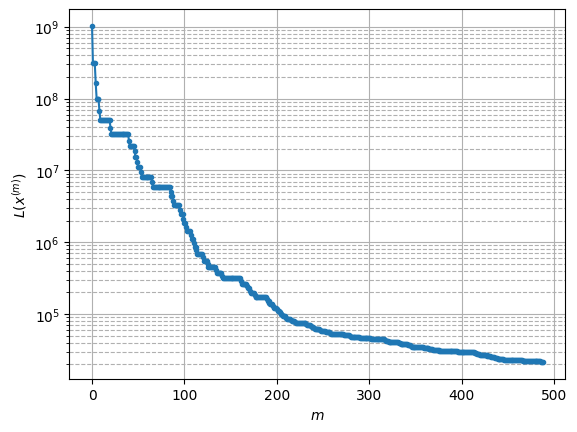

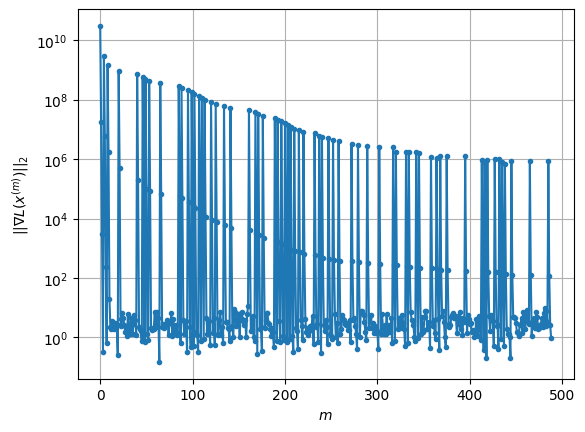

Windows:   4%|▍         | 13/296 [21:41<8:34:48, 109.15s/it]


Majorization-Minimization Iteration 1
Before applying the algorithm
Cost function: 21587.27686899723
Gradient norm: 511884.573728689
Global relative error: 77.19640190748694
Position relative errors: 0.03424443220012648 m, 53.95738197376467 m, 7.693824695531091 m, 54.66867833028668 m

Iteration 1
Cost function: 21187.128154101294 (-1.85%)
Gradient norm: 125.53779559043402 (-99.98%)
Global relative error = 75.64764455409004 (-2.01%)
Position relative errors: 0.037395921244208985 m, 53.03847018388043 m, 7.482986360180544 m, 53.417842471327525 m

Iteration 2
Cost function: 21187.128154497586 (0.00%)
Gradient norm: 3.6197545562170457 (-97.12%)
Global relative error = 75.64764514695086 (0.00%)
Position relative errors: 0.03739611538599607 m, 53.03846065715455 m, 7.482985029920897 m, 53.41785295617332 m

Iteration 3
Cost function: 21187.12815420731 (-0.00%)
Gradient norm: 7.71409137341414 (113.11%)
Global relative error = 75.64764514975984 (0.00%)
Position relative errors: 0.037396121685951

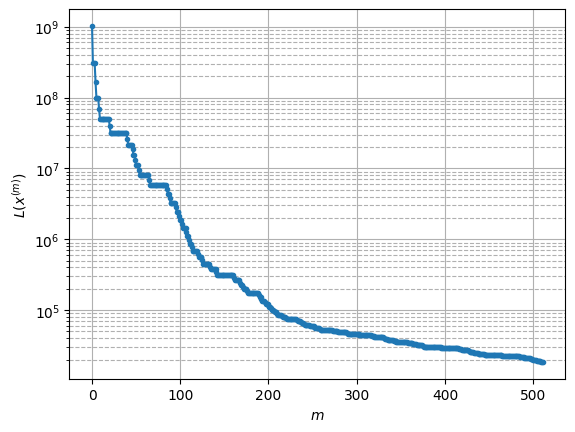

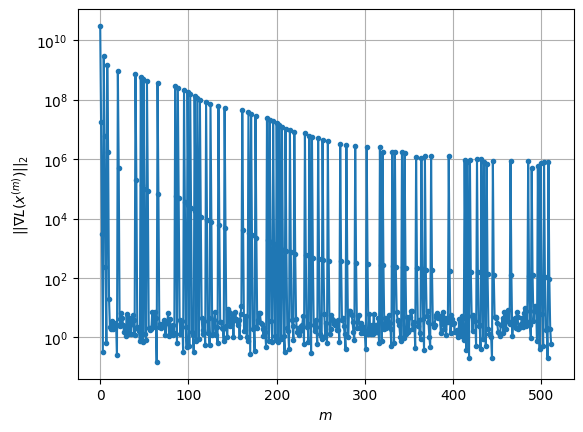

Windows:   5%|▍         | 14/296 [22:41<7:23:08, 94.29s/it] 


Majorization-Minimization Iteration 1
Before applying the algorithm
Cost function: 18728.385514303995
Gradient norm: 646212.4300024261
Global relative error: 69.22311591493987
Position relative errors: 0.031883921339662134 m, 48.762223070857395 m, 8.478538980956118 m, 48.3960335096852 m

Iteration 1
Cost function: 18384.911633932006 (-1.83%)
Gradient norm: 107.18573645018898 (-99.98%)
Global relative error = 67.75858758395198 (-2.12%)
Position relative errors: 0.029304424634479357 m, 47.906084955577136 m, 8.118483223382386 m, 47.226055296866114 m

Iteration 2
Cost function: 18384.911633767646 (-0.00%)
Gradient norm: 3.290626268009788 (-96.93%)
Global relative error = 67.75858760589449 (0.00%)
Position relative errors: 0.029304764930320762 m, 47.906076667771785 m, 8.11848311618453 m, 47.22606375370005 m

Iteration 3
Cost function: 18384.911634882574 (0.00%)
Gradient norm: 4.857311777048102 (47.61%)
Global relative error = 67.75858760632786 (0.00%)
Position relative errors: 0.0293047695

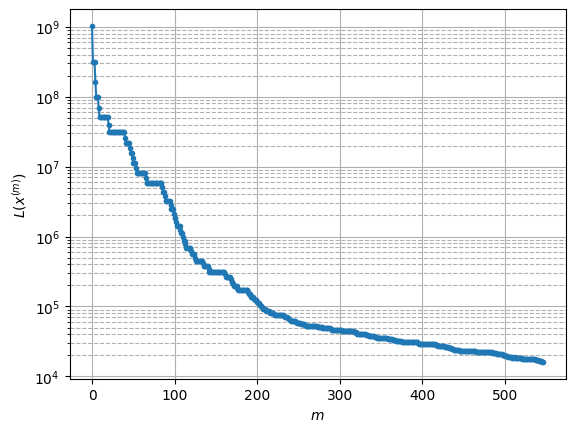

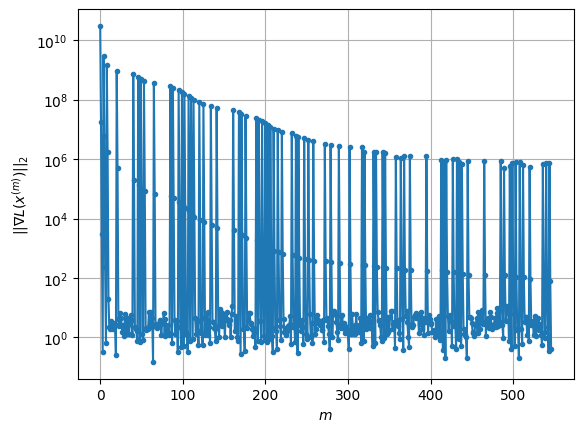

Windows:   5%|▌         | 15/296 [24:18<7:25:58, 95.22s/it]


Majorization-Minimization Iteration 1
Before applying the algorithm
Cost function: 16383.12733541634
Gradient norm: 502037.19035355025
Global relative error: 62.13068229924944
Position relative errors: 0.02509904235595668 m, 43.45149704826197 m, 10.122095529601273 m, 43.240153493040154 m

Iteration 1
Cost function: 16087.485395376238 (-1.80%)
Gradient norm: 85.90612517542328 (-99.98%)
Global relative error = 60.735772778999916 (-2.25%)
Position relative errors: 0.03672002988573298 m, 42.64883699812755 m, 9.658183703922457 m, 42.14983391577018 m

Iteration 2
Cost function: 16087.485397273933 (0.00%)
Gradient norm: 3.9512109932430945 (-95.40%)
Global relative error = 60.73577228291631 (-0.00%)
Position relative errors: 0.03672048862849727 m, 42.648829073939986 m, 9.658184702157088 m, 42.149840989794875 m

STOP on Iteration 3
Cost function = 16087.485396384916 (-0.00%)
Gradient norm = 0.1097010649486859 (-97.22%)
Global relative error = 60.73577227916309 (-0.00%)
Final position relative 

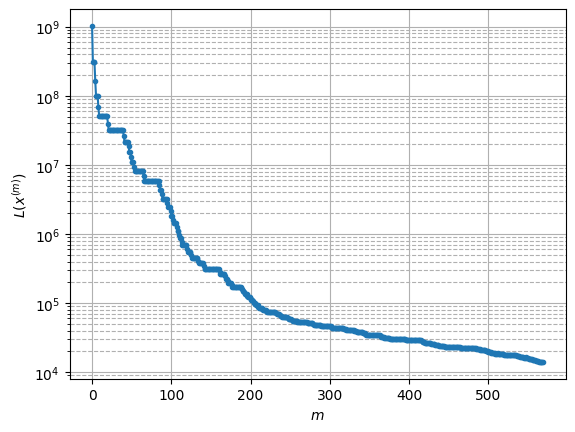

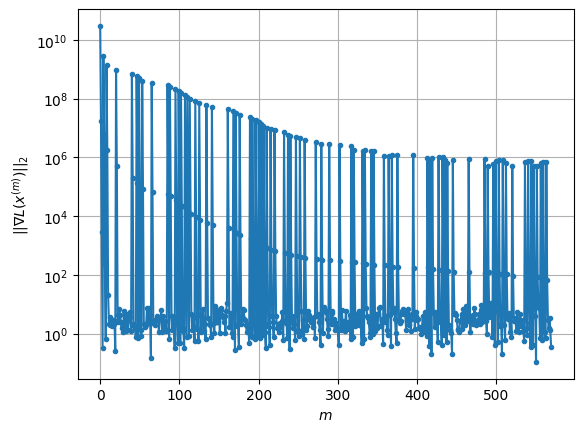

Windows:   5%|▌         | 16/296 [25:19<6:35:38, 84.78s/it]


Majorization-Minimization Iteration 1
Before applying the algorithm
Cost function: 14495.924110530825
Gradient norm: 601698.5262130245
Global relative error: 55.90783117527664
Position relative errors: 0.03323279909888773 m, 38.04300357702227 m, 11.986536924932015 m, 39.175479598741674 m

Iteration 1
Cost function: 14232.68971891779 (-1.82%)
Gradient norm: 73.3724782939121 (-99.99%)
Global relative error = 54.53870751983719 (-2.45%)
Position relative errors: 0.029961809327099947 m, 37.29733265660783 m, 11.47922413710765 m, 38.09970207179329 m

Iteration 2
Cost function: 14232.689714439777 (-0.00%)
Gradient norm: 2.4811252854788086 (-96.62%)
Global relative error = 54.53870738563211 (-0.00%)
Position relative errors: 0.029962208785554136 m, 37.297326112714096 m, 11.479225814516019 m, 38.09970778004757 m

STOP on Iteration 3
Cost function = 14232.689716127472 (0.00%)
Gradient norm = 0.6767258129558715 (-72.73%)
Global relative error = 54.538707390880006 (0.00%)
Final position relative e

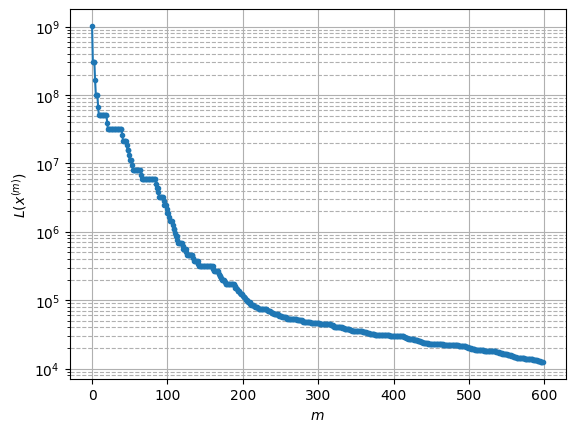

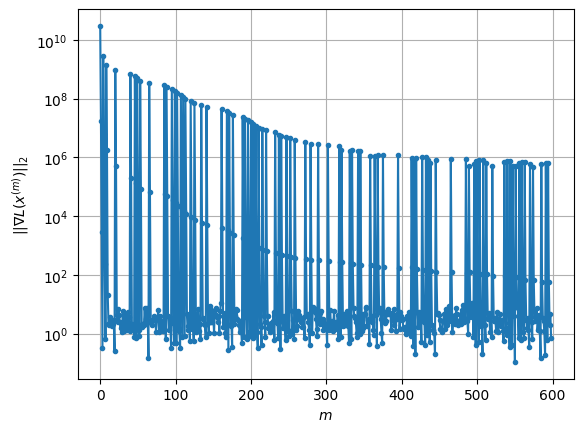

Windows:   6%|▌         | 17/296 [26:38<6:26:55, 83.21s/it]


Majorization-Minimization Iteration 1
Before applying the algorithm
Cost function: 12820.063089211559
Gradient norm: 693807.5713896239
Global relative error: 50.49105262814394
Position relative errors: 0.02730673338165227 m, 32.59646239612067 m, 13.854554499198107 m, 35.984024416890506 m

Iteration 1
Cost function: 12590.539556764372 (-1.79%)
Gradient norm: 60.75242794944642 (-99.99%)
Global relative error = 49.17708534545984 (-2.60%)
Position relative errors: 0.033088947087174414 m, 31.90035127421596 m, 13.307203897935912 m, 34.98075444251866 m

Iteration 2
Cost function: 12590.539553950639 (-0.00%)
Gradient norm: 1.200448069156108 (-98.02%)
Global relative error = 49.177085243293725 (-0.00%)
Position relative errors: 0.03308931810762852 m, 31.90034513940724 m, 13.307206290625995 m, 34.98075898289443 m

STOP on Iteration 3
Cost function = 12590.539556589414 (0.00%)
Gradient norm = 0.5263646297058536 (-56.15%)
Global relative error = 49.177085241543736 (-0.00%)
Final position relative

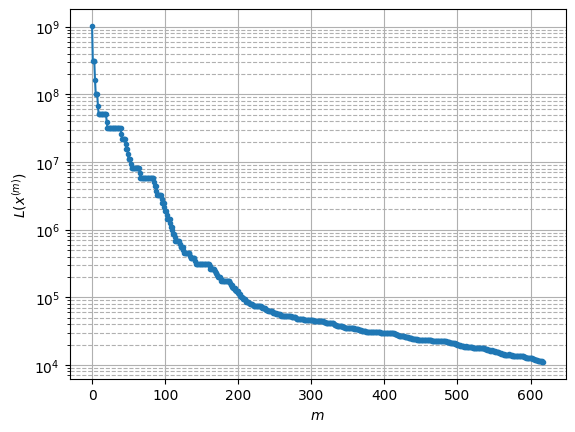

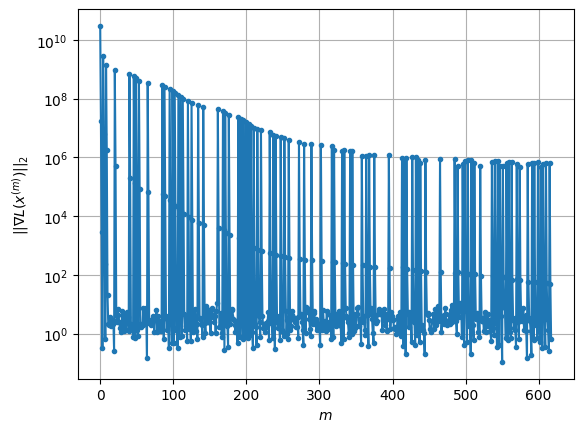

Windows:   6%|▌         | 18/296 [27:29<5:40:29, 73.49s/it]


Majorization-Minimization Iteration 1
Before applying the algorithm
Cost function: 11428.940329265819
Gradient norm: 520992.2302499424
Global relative error: 46.04183249969029
Position relative errors: 0.03016896730404809 m, 27.13531019474757 m, 15.576709025357802 m, 33.77683015327636 m

Iteration 1
Cost function: 11224.438812774333 (-1.79%)
Gradient norm: 52.463472111715866 (-99.99%)
Global relative error = 44.7649005240885 (-2.77%)
Position relative errors: 0.04224760137512163 m, 26.478664874157964 m, 15.013608416218919 m, 32.82301559497001 m

Iteration 2
Cost function: 11224.438814827423 (0.00%)
Gradient norm: 4.991201678450522 (-90.49%)
Global relative error = 44.76490041656364 (-0.00%)
Position relative errors: 0.04224793810338185 m, 26.47865874983817 m, 15.013611238639163 m, 32.82301909743028 m

Iteration 3
Cost function: 11224.438811242988 (-0.00%)
Gradient norm: 8.631095422725615 (72.93%)
Global relative error = 44.76490041229088 (-0.00%)
Position relative errors: 0.0422479512

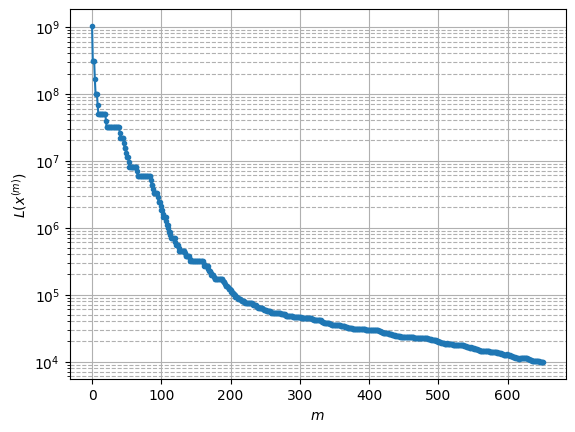

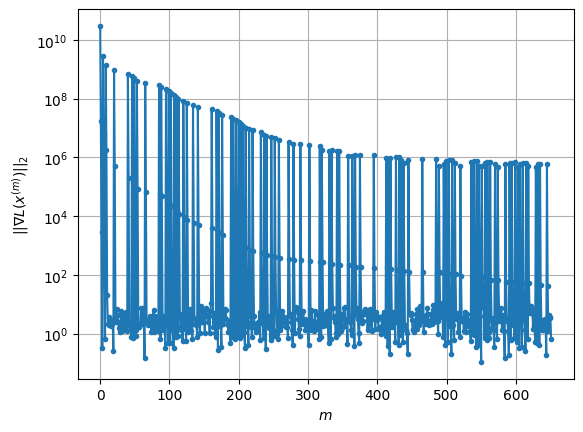

Windows:   6%|▋         | 19/296 [28:51<5:51:48, 76.20s/it]


Majorization-Minimization Iteration 1
Before applying the algorithm
Cost function: 10203.960362087573
Gradient norm: 427403.81992777606
Global relative error: 42.56312238795344
Position relative errors: 0.0394708796985001 m, 21.668392919572845 m, 17.15561115207556 m, 32.3692533627607 m

Iteration 1
Cost function: 10022.00773013984 (-1.78%)
Gradient norm: 52.3337435770417 (-99.99%)
Global relative error = 41.341451977394286 (-2.87%)
Position relative errors: 0.043927730053062844 m, 21.053039182742516 m, 16.58496118998772 m, 31.477094459120327 m

Iteration 2
Cost function: 10022.007729615694 (-0.00%)
Gradient norm: 6.725687501934685 (-87.15%)
Global relative error = 41.341452160246035 (0.00%)
Position relative errors: 0.04392804514707082 m, 21.053033362977132 m, 16.584964306745846 m, 31.47709694911395 m

Iteration 3
Cost function: 10022.007730286958 (0.00%)
Gradient norm: 1.1181984040340607 (-83.37%)
Global relative error = 41.34145215939186 (-0.00%)
Position relative errors: 0.04392803

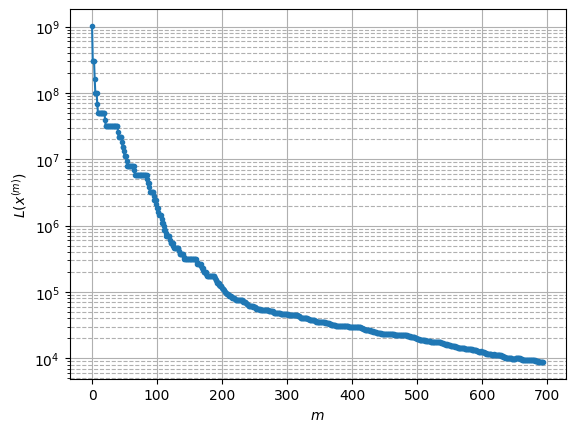

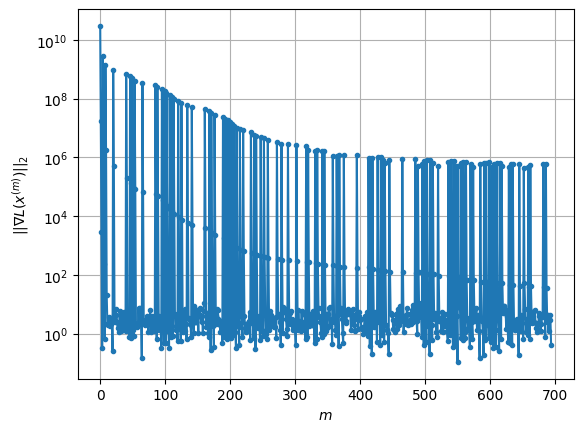

Windows:   7%|▋         | 20/296 [30:27<6:16:36, 81.87s/it]


Majorization-Minimization Iteration 1
Before applying the algorithm
Cost function: 9095.429727414976
Gradient norm: 504143.615640421
Global relative error: 40.167069028690335
Position relative errors: 0.04143486768885528 m, 16.26215604945185 m, 18.599336390729686 m, 31.66993527790547 m

Iteration 1
Cost function: 8936.272149245104 (-1.75%)
Gradient norm: 41.592446100000735 (-99.99%)
Global relative error = 39.03825477768601 (-2.81%)
Position relative errors: 0.03947747083713459 m, 15.687653606783897 m, 18.033422225166213 m, 30.865243306203055 m

Iteration 2
Cost function: 8936.272145475024 (-0.00%)
Gradient norm: 5.1754426677227965 (-87.56%)
Global relative error = 39.038255427828965 (0.00%)
Position relative errors: 0.03947767622832364 m, 15.687648211212796 m, 18.03342565588462 m, 30.865244866160005 m

Iteration 3
Cost function: 8936.272147528683 (0.00%)
Gradient norm: 6.050386658101913 (16.91%)
Global relative error = 39.038255432868915 (0.00%)
Position relative errors: 0.0394776771

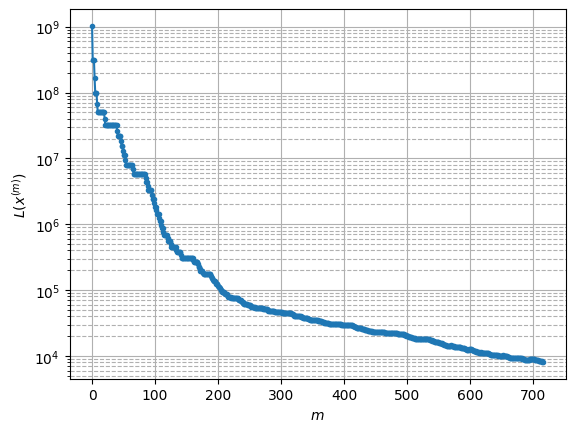

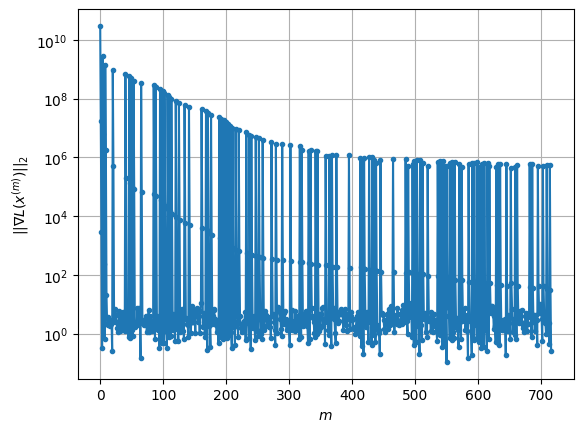

Windows:   7%|▋         | 21/296 [31:18<5:33:51, 72.84s/it]


Majorization-Minimization Iteration 1
Before applying the algorithm
Cost function: 8358.688929748978
Gradient norm: 532126.5856538174
Global relative error: 39.858393033203285
Position relative errors: 0.03793371545576537 m, 11.490421059890757 m, 20.437739161016815 m, 32.23268771112005 m

Iteration 1
Cost function: 8212.790298382999 (-1.75%)
Gradient norm: 36.98935968955352 (-99.99%)
Global relative error = 38.79381327947341 (-2.67%)
Position relative errors: 0.038982318385735966 m, 10.948159836838803 m, 19.86154120283589 m, 31.473839763907666 m

Iteration 2
Cost function: 8212.790299794207 (0.00%)
Gradient norm: 1.9796250839042762 (-94.65%)
Global relative error = 38.79381447741472 (0.00%)
Position relative errors: 0.03898244081243615 m, 10.948154025043102 m, 19.86154484130269 m, 31.473840965881386 m

Iteration 3
Cost function: 8212.790296904728 (-0.00%)
Gradient norm: 1.9492355996915252 (-1.54%)
Global relative error = 38.79381447263211 (-0.00%)
Position relative errors: 0.038982440

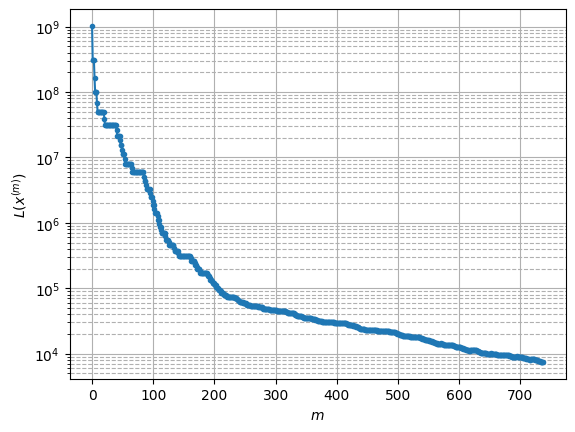

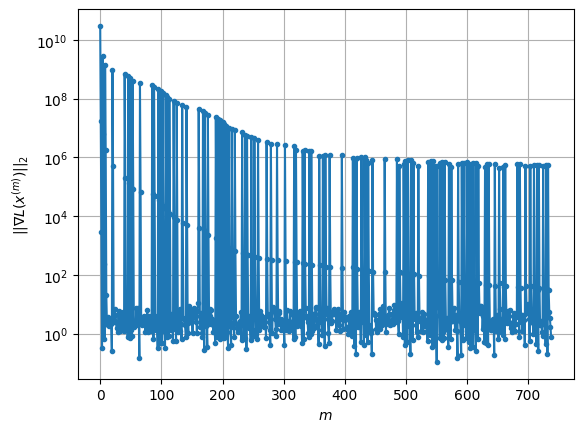

Windows:   7%|▋         | 22/296 [32:07<4:59:07, 65.50s/it]


Majorization-Minimization Iteration 1
Before applying the algorithm
Cost function: 7625.745428741176
Gradient norm: 500050.55109036306
Global relative error: 40.42204709395905
Position relative errors: 0.037382313025359375 m, 6.894978126553612 m, 22.12792842522035 m, 33.11710334983784 m

Iteration 1
Cost function: 7492.63141378079 (-1.75%)
Gradient norm: 35.5610303384606 (-99.99%)
Global relative error = 39.452200107483904 (-2.40%)
Position relative errors: 0.04127330913913119 m, 6.405504756117306 m, 21.56220072244655 m, 32.41147151913049 m

Iteration 2
Cost function: 7492.631415796699 (0.00%)
Gradient norm: 5.206641561835723 (-85.36%)
Global relative error = 39.45220162332807 (0.00%)
Position relative errors: 0.04127342795059317 m, 6.405497774353983 m, 21.56220432401206 m, 32.41147234792399 m

Iteration 3
Cost function: 7492.631414867928 (-0.00%)
Gradient norm: 1.587184135300609 (-69.52%)
Global relative error = 39.452201621967006 (-0.00%)
Position relative errors: 0.0412734318343210

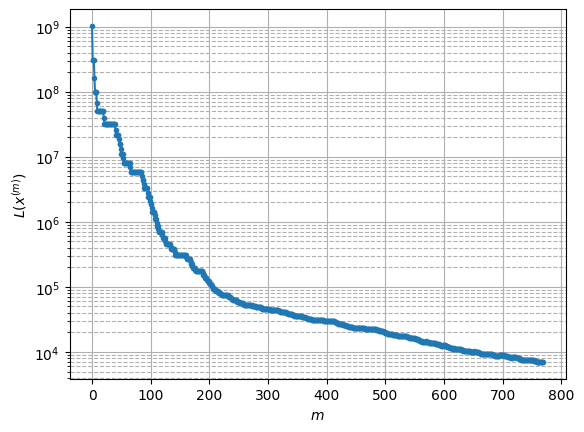

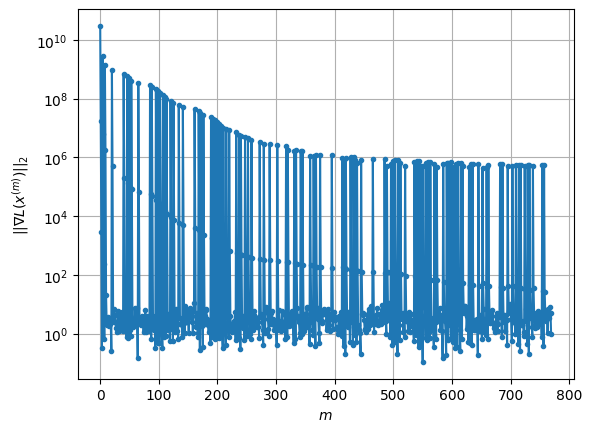

Windows:   8%|▊         | 23/296 [33:19<5:07:28, 67.58s/it]


Majorization-Minimization Iteration 1
Before applying the algorithm
Cost function: 7193.558378028887
Gradient norm: 597865.3371262604
Global relative error: 42.58300718725649
Position relative errors: 0.04004302795515763 m, 3.4928976400098484 m, 24.228451502242763 m, 34.843672269836496 m

Iteration 1
Cost function: 7064.490508822544 (-1.79%)
Gradient norm: 27.704218826242105 (-100.00%)
Global relative error = 41.691048215536085 (-2.09%)
Position relative errors: 0.048807715651204585 m, 3.1793595211720294 m, 23.664472550032936 m, 34.17622595278129 m

Iteration 2
Cost function: 7064.490509692393 (0.00%)
Gradient norm: 4.36046814275904 (-84.26%)
Global relative error = 41.691050029710645 (0.00%)
Position relative errors: 0.048807814031247926 m, 3.1793502815600307 m, 23.664476395238083 m, 34.176226362751486 m

Iteration 3
Cost function: 7064.490509259049 (-0.00%)
Gradient norm: 5.767812885033102 (32.28%)
Global relative error = 41.691050029040795 (-0.00%)
Position relative errors: 0.04880

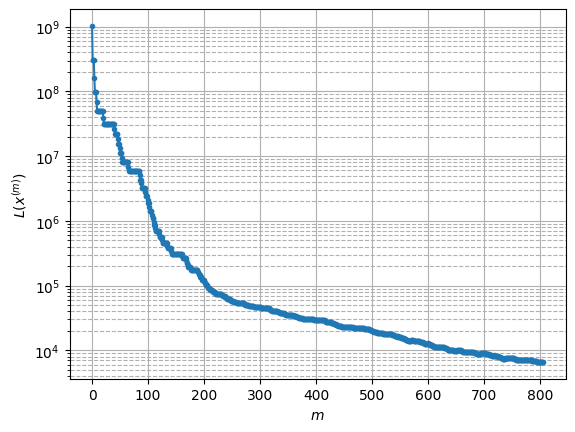

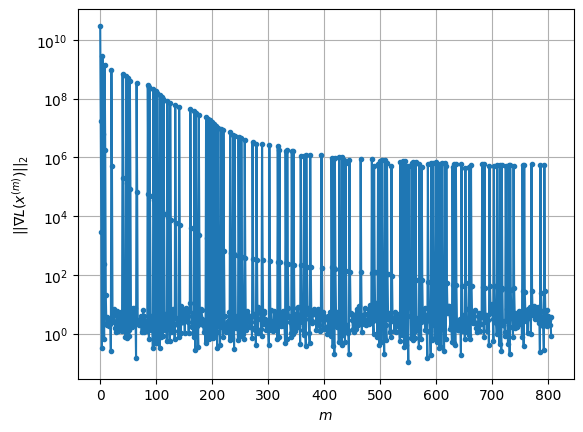

Windows:   8%|▊         | 24/296 [34:40<5:24:20, 71.54s/it]


Majorization-Minimization Iteration 1
Before applying the algorithm
Cost function: 6724.735362197749
Gradient norm: 603292.3281844184
Global relative error: 45.206957166939446
Position relative errors: 0.04735638157364742 m, 3.717335435917447 m, 26.199373992147326 m, 36.65283854352734 m

Iteration 1
Cost function: 6607.126102484156 (-1.75%)
Gradient norm: 29.26876288300501 (-100.00%)
Global relative error = 44.401971892692266 (-1.78%)
Position relative errors: 0.06689444235321097 m, 4.000983934346536 m, 25.646024299423768 m, 36.024906661427465 m

Iteration 2
Cost function: 6607.126100658182 (-0.00%)
Gradient norm: 4.659154876148877 (-84.08%)
Global relative error = 44.40197397676915 (0.00%)
Position relative errors: 0.06689452870039515 m, 4.0009806387489055 m, 25.646027958011643 m, 36.02490699144071 m

Iteration 3
Cost function: 6607.126101120466 (0.00%)
Gradient norm: 4.831876976651369 (3.71%)
Global relative error = 44.40197397859196 (0.00%)
Position relative errors: 0.0668945271252

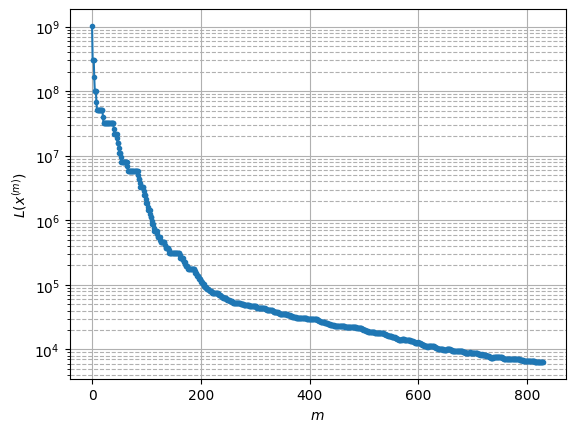

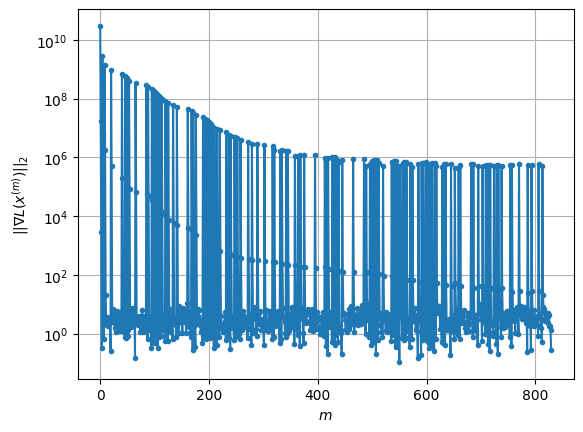

Windows:   8%|▊         | 25/296 [35:37<5:03:35, 67.22s/it]


Majorization-Minimization Iteration 1
Before applying the algorithm
Cost function: 6466.063458063136
Gradient norm: 616826.1353467582
Global relative error: 48.86247552040935
Position relative errors: 0.06465562674184712 m, 6.785095101703849 m, 28.584099181046337 m, 39.04407093616676 m

Iteration 1
Cost function: 6353.552958020943 (-1.74%)
Gradient norm: 22.54158931633813 (-100.00%)
Global relative error = 48.1180496617597 (-1.52%)
Position relative errors: 0.06387362942447694 m, 7.174754042847887 m, 28.02904875059606 m, 38.44773606678653 m

Iteration 2
Cost function: 6353.552959295023 (0.00%)
Gradient norm: 4.753084654209992 (-78.91%)
Global relative error = 48.118051914360144 (0.00%)
Position relative errors: 0.0638736738988045 m, 7.174753728355573 m, 28.029052455887275 m, 38.44773624335101 m

Iteration 3
Cost function: 6353.55295709601 (-0.00%)
Gradient norm: 1.5406555192945492 (-67.59%)
Global relative error = 48.11805191391427 (-0.00%)
Position relative errors: 0.0638736794452443

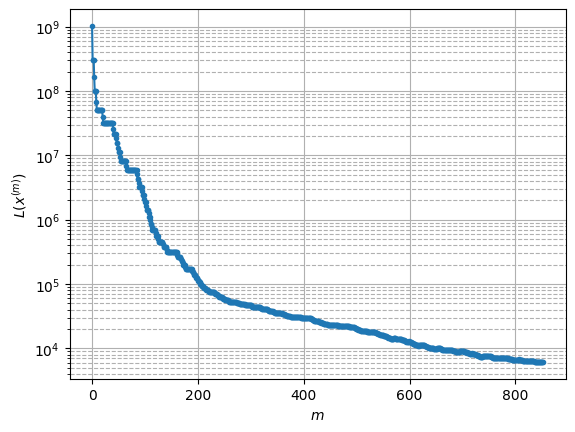

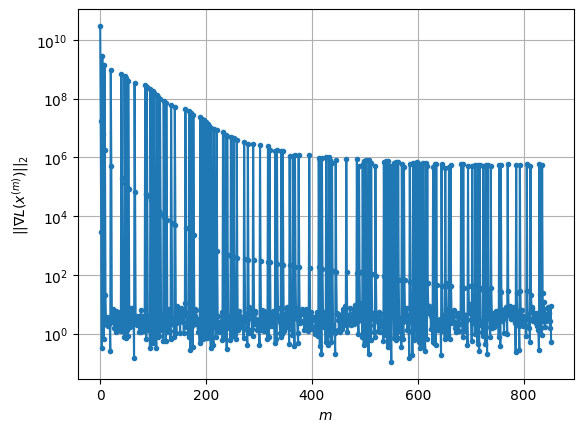

Windows:   9%|▉         | 26/296 [36:29<4:42:15, 62.72s/it]


Majorization-Minimization Iteration 1
Before applying the algorithm
Cost function: 6154.126973022662
Gradient norm: 600041.6714419625
Global relative error: 52.60658231835086
Position relative errors: 0.06162167614380098 m, 10.258737577371633 m, 30.83570688238246 m, 41.368555170169294 m

Iteration 1
Cost function: 6049.01611619864 (-1.71%)
Gradient norm: 25.718128428432742 (-100.00%)
Global relative error = 51.92155742362777 (-1.30%)
Position relative errors: 0.07365827500790958 m, 10.659000053617088 m, 30.288274731916193 m, 40.80245164837521 m

Iteration 2
Cost function: 6049.0161133176525 (-0.00%)
Gradient norm: 1.1274565061022401 (-95.62%)
Global relative error = 51.92155970407269 (0.00%)
Position relative errors: 0.0736583186459035 m, 10.65900054615359 m, 30.288278207798232 m, 40.80245184132007 m

Iteration 3
Cost function: 6049.016115003678 (0.00%)
Gradient norm: 3.794983926049532 (236.60%)
Global relative error = 51.92155970540641 (0.00%)
Position relative errors: 0.073658327403

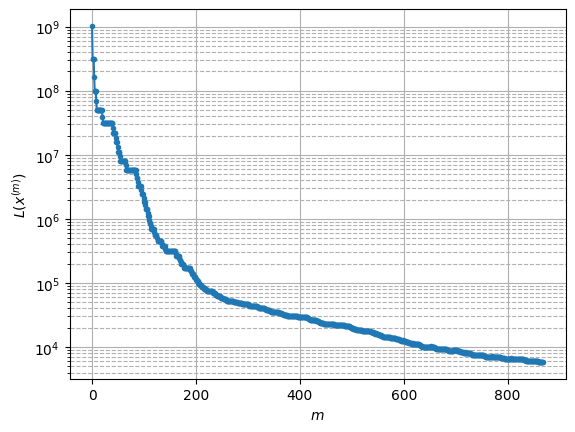

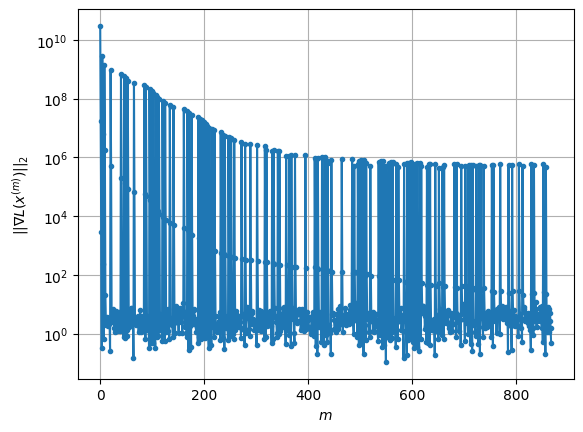

Windows:   9%|▉         | 27/296 [37:09<4:09:55, 55.74s/it]


Majorization-Minimization Iteration 1
Before applying the algorithm
Cost function: 5867.686162493872
Gradient norm: 508493.62361754733
Global relative error: 56.36050763424685
Position relative errors: 0.07059571170714447 m, 13.760594916385086 m, 32.96490471484558 m, 43.594207005929185 m

Iteration 1
Cost function: 5773.179049572408 (-1.61%)
Gradient norm: 24.89681943278254 (-100.00%)
Global relative error = 55.735384095824394 (-1.11%)
Position relative errors: 0.06228256384735287 m, 14.13798399804072 m, 32.42942377411173 m, 43.068214032008 m

Iteration 2
Cost function: 5773.1790474409545 (-0.00%)
Gradient norm: 3.6826039810181617 (-85.21%)
Global relative error = 55.73538617729428 (0.00%)
Position relative errors: 0.06228258630251763 m, 14.137984571346939 m, 32.42942698189914 m, 43.068214122052495 m

Iteration 3
Cost function: 5773.1790488947845 (0.00%)
Gradient norm: 1.4799652612668968 (-59.81%)
Global relative error = 55.73538617791744 (0.00%)
Position relative errors: 0.0622825895

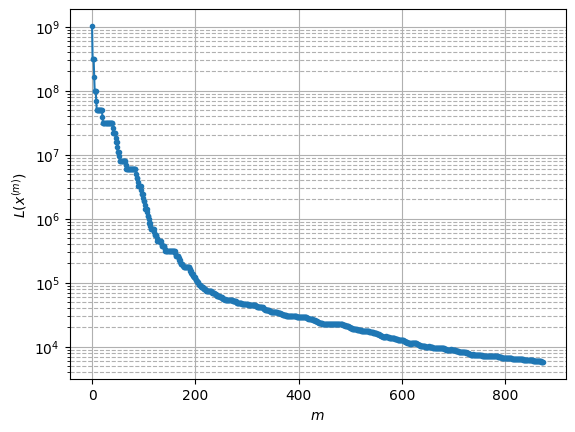

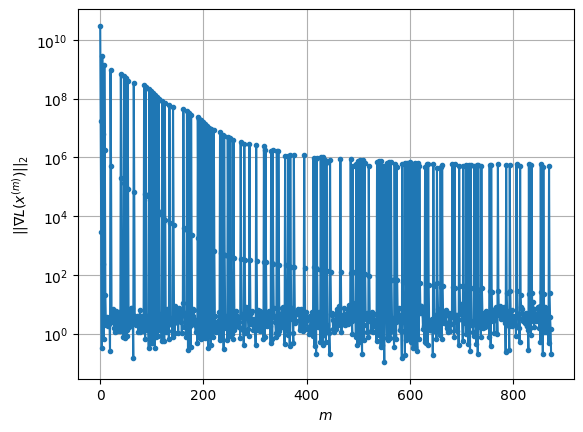

Windows:   9%|▉         | 28/296 [37:21<3:11:11, 42.81s/it]


Majorization-Minimization Iteration 1
Before applying the algorithm
Cost function: 5752.302880756203
Gradient norm: 477699.96836285247
Global relative error: 60.646909415937586
Position relative errors: 0.05972380725705078 m, 16.820567047117358 m, 35.485133338088374 m, 46.21591294261999 m

Iteration 1
Cost function: 5655.757947564904 (-1.68%)
Gradient norm: 17.299199883442125 (-100.00%)
Global relative error = 60.04503706106873 (-0.99%)
Position relative errors: 0.04927827098081017 m, 17.182133629748815 m, 34.93156022423117 m, 45.71604966440957 m

Iteration 2
Cost function: 5655.757948030691 (0.00%)
Gradient norm: 3.7547924684018716 (-78.29%)
Global relative error = 60.04503938932192 (0.00%)
Position relative errors: 0.04927825272231559 m, 17.182134641094528 m, 34.93156350143509 m, 45.71604983822285 m

Iteration 3
Cost function: 5655.757949628611 (0.00%)
Gradient norm: 1.4215197604321164 (-62.14%)
Global relative error = 60.04503938964936 (0.00%)
Position relative errors: 0.0492782544

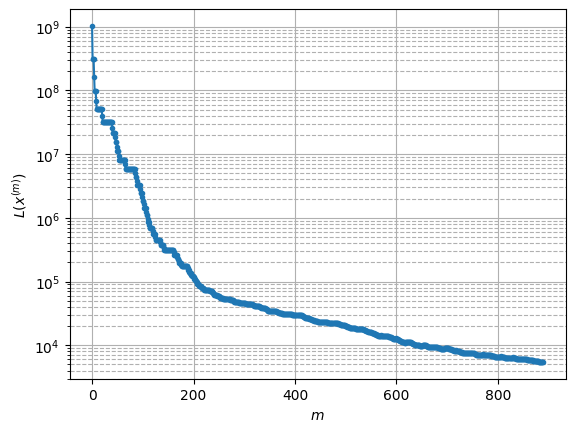

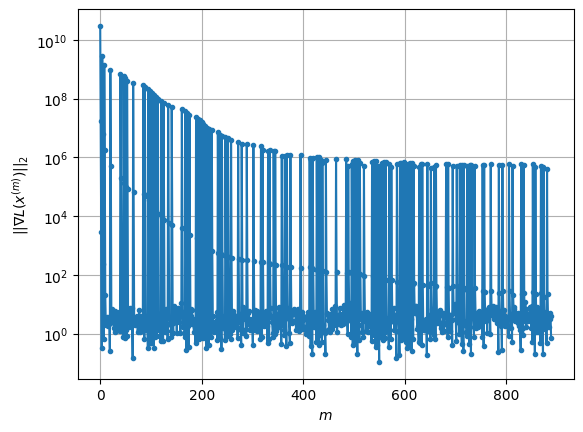

Windows:  10%|▉         | 29/296 [38:00<3:05:31, 41.69s/it]


Majorization-Minimization Iteration 1
Before applying the algorithm
Cost function: 5464.675759418626
Gradient norm: 389315.29974780674
Global relative error: 64.18868680361888
Position relative errors: 0.04666287516874784 m, 20.137917730640503 m, 37.3144208717863 m, 48.190010607344334 m

Iteration 1
Cost function: 5385.90448282199 (-1.44%)
Gradient norm: 14.749234273869678 (-100.00%)
Global relative error = 63.64624802520241 (-0.85%)
Position relative errors: 0.048271907645862276 m, 20.45758522640774 m, 36.78325521657294 m, 47.74217695153388 m

Iteration 2
Cost function: 5385.904482107217 (-0.00%)
Gradient norm: 2.0217110690467033 (-86.29%)
Global relative error = 63.64624980273922 (0.00%)
Position relative errors: 0.048271936039807915 m, 20.457586148492148 m, 36.783257674132294 m, 47.742177032627126 m

STOP on Iteration 3
Cost function = 5385.904482343451 (0.00%)
Gradient norm = 0.39789140615304763 (-80.32%)
Global relative error = 63.646249802927635 (0.00%)
Final position relative e

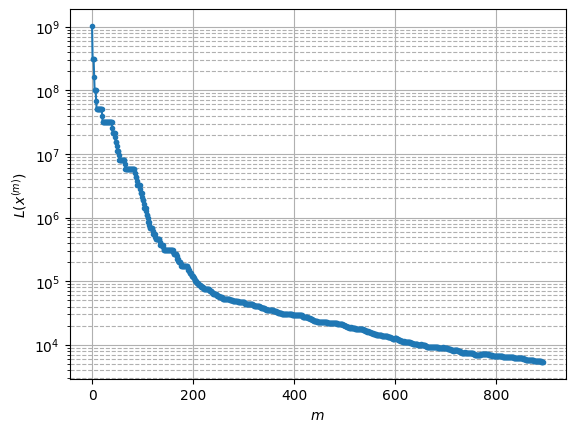

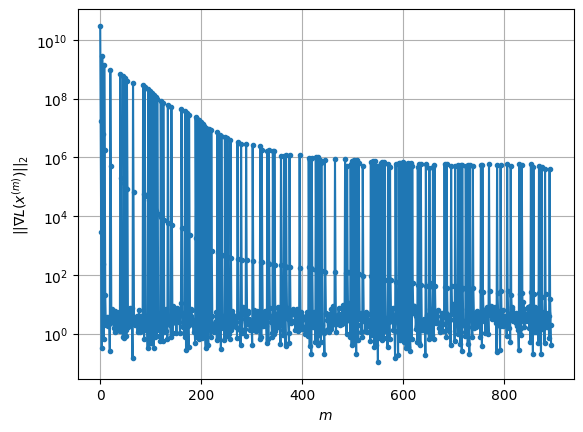

Windows:  10%|█         | 30/296 [38:11<2:23:04, 32.27s/it]


Majorization-Minimization Iteration 1
Before applying the algorithm
Cost function: 5351.958670450802
Gradient norm: 306708.512717921
Global relative error: 68.11108732072314
Position relative errors: 0.045974273177592444 m, 22.988757056109794 m, 39.53004107995885 m, 50.47777016651033 m

Iteration 1
Cost function: 5272.5098553948155 (-1.48%)
Gradient norm: 14.916814050508174 (-100.00%)
Global relative error = 67.5855694034605 (-0.77%)
Position relative errors: 0.05460087984856231 m, 23.29122592485853 m, 39.00002291938118 m, 50.043156648599144 m

STOP on Iteration 2
Cost function = 5272.509852630173 (-0.00%)
Gradient norm = 0.9627050894965024 (-93.55%)
Global relative error = 67.58557118432756 (0.00%)
Final position relative errors: 0.054600866094367165 m, 23.291226582678615 m, 39.00002549435091 m, 50.04315674084753 m

Majorization-Minimization converged after 1 iterations


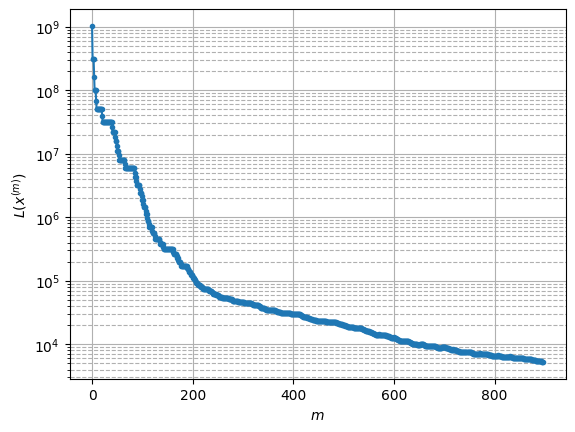

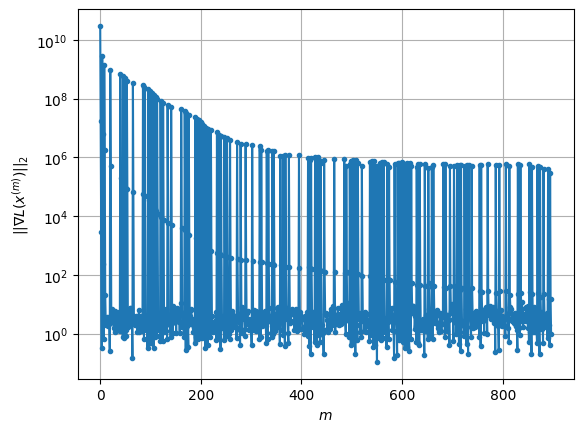

Windows:  10%|█         | 31/296 [38:19<1:50:08, 24.94s/it]


Majorization-Minimization Iteration 1
Before applying the algorithm
Cost function: 5218.66761839294
Gradient norm: 385036.6708037799
Global relative error: 71.7829453423663
Position relative errors: 0.05233502364135938 m, 25.72071779081256 m, 41.581100467522354 m, 52.55701936856867 m

Iteration 1
Cost function: 5141.524399516275 (-1.48%)
Gradient norm: 15.794275979698421 (-100.00%)
Global relative error = 71.27845960582682 (-0.70%)
Position relative errors: 0.057813212752702715 m, 25.99676368343334 m, 41.049663767503716 m, 52.15078036025398 m

Iteration 2
Cost function: 5141.5244004882425 (0.00%)
Gradient norm: 4.943150500081923 (-68.70%)
Global relative error = 71.27846126610733 (0.00%)
Position relative errors: 0.057813228020314814 m, 25.99676452765722 m, 41.04966589978831 m, 52.150780530237164 m

STOP on Iteration 3
Cost function = 5141.524398899443 (-0.00%)
Gradient norm = 0.30711322689907655 (-93.79%)
Global relative error = 71.27846126596008 (-0.00%)
Final position relative erro

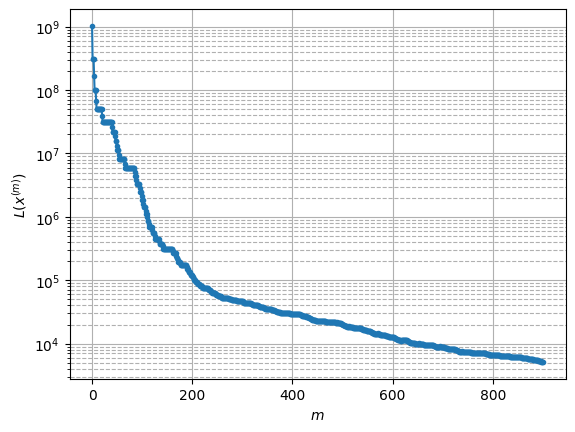

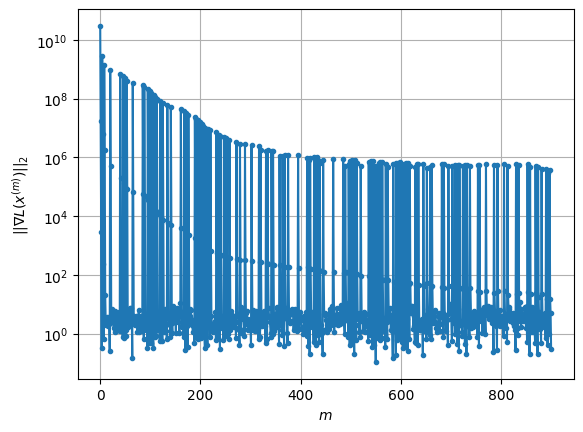

Windows:  11%|█         | 32/296 [38:29<1:30:37, 20.60s/it]


Majorization-Minimization Iteration 1
Before applying the algorithm
Cost function: 5055.249411629613
Gradient norm: 361261.4139879703
Global relative error: 75.18561048813648
Position relative errors: 0.055233820731290954 m, 28.310898003024306 m, 43.457090444280354 m, 54.43200401849464 m

Iteration 1
Cost function: 4978.329658423531 (-1.52%)
Gradient norm: 11.426254837563858 (-100.00%)
Global relative error = 74.70405271975604 (-0.64%)
Position relative errors: 0.04165561977516645 m, 28.561647415865348 m, 42.92297284804585 m, 54.06052368029376 m

Iteration 2
Cost function: 4978.329657375581 (-0.00%)
Gradient norm: 2.5845903031859847 (-77.38%)
Global relative error = 74.70405409110258 (0.00%)
Position relative errors: 0.04165561487633644 m, 28.561648212446148 m, 42.92297448309476 m, 54.06052385625571 m

Iteration 3
Cost function: 4978.329658365265 (0.00%)
Gradient norm: 2.689558322142545 (4.06%)
Global relative error = 74.70405409074905 (-0.00%)
Position relative errors: 0.041655608914

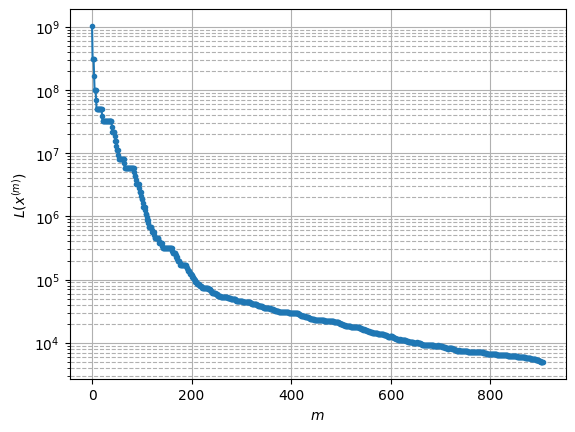

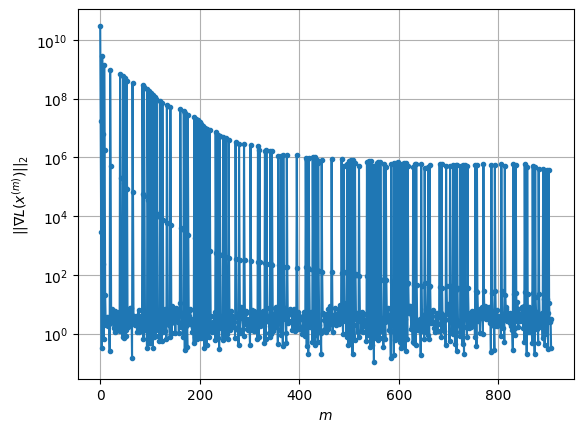

Windows:  11%|█         | 33/296 [38:44<1:23:04, 18.95s/it]


Majorization-Minimization Iteration 1
Before applying the algorithm
Cost function: 4910.418960877219
Gradient norm: 447953.9836342016
Global relative error: 78.30135306009419
Position relative errors: 0.03987481121124846 m, 30.747788365639913 m, 45.14957558395937 m, 56.099786704360156 m

Iteration 1
Cost function: 4836.298159374228 (-1.51%)
Gradient norm: 14.505803255727189 (-100.00%)
Global relative error = 77.84111420176242 (-0.59%)
Position relative errors: 0.04604404909726736 m, 30.969096683618528 m, 44.61780904628969 m, 55.761990227668385 m

Iteration 2
Cost function: 4836.298160440158 (0.00%)
Gradient norm: 1.3553961667097645 (-90.66%)
Global relative error = 77.8411152358851 (0.00%)
Position relative errors: 0.04604407303353833 m, 30.969097607725008 m, 44.617809977914725 m, 55.76199041256878 m

Iteration 3
Cost function: 4836.298158600891 (-0.00%)
Gradient norm: 2.654539179365883 (95.85%)
Global relative error = 77.8411152362905 (0.00%)
Position relative errors: 0.0460440792159

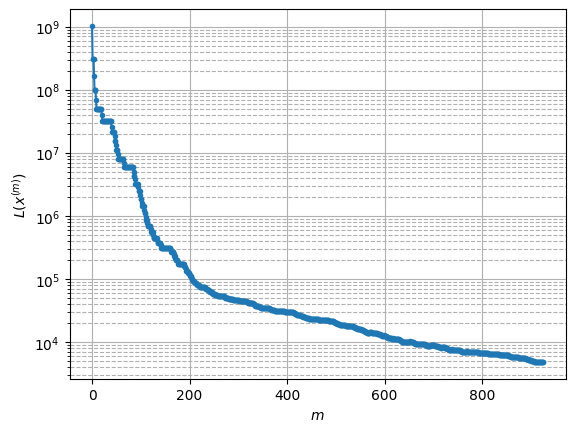

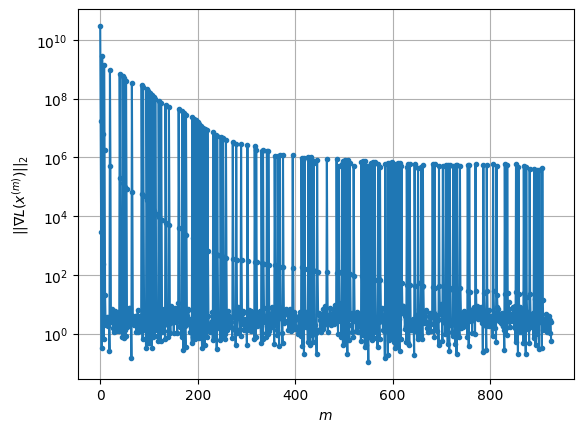

Windows:  11%|█▏        | 34/296 [39:31<1:59:49, 27.44s/it]


Majorization-Minimization Iteration 1
Before applying the algorithm
Cost function: 4782.440153472603
Gradient norm: 556425.889198352
Global relative error: 81.11178435174064
Position relative errors: 0.04403248449555534 m, 33.01551491233558 m, 46.6575464429935 m, 57.551419048291116 m

Iteration 1
Cost function: 4710.4623881037 (-1.51%)
Gradient norm: 12.94944889900348 (-100.00%)
Global relative error = 80.67003016335721 (-0.54%)
Position relative errors: 0.04868999915405021 m, 33.210617063775075 m, 46.13890620500002 m, 57.23551985096738 m

Iteration 2
Cost function: 4710.462387140278 (-0.00%)
Gradient norm: 1.3214721763339816 (-89.80%)
Global relative error = 80.67003082982828 (0.00%)
Position relative errors: 0.0486900391110601 m, 33.2106180081693 m, 46.13890650354569 m, 57.23552000164078 m

Iteration 3
Cost function: 4710.462387262415 (0.00%)
Gradient norm: 4.995952200861234 (278.06%)
Global relative error = 80.670030830307 (0.00%)
Position relative errors: 0.048690044296282986 m, 3

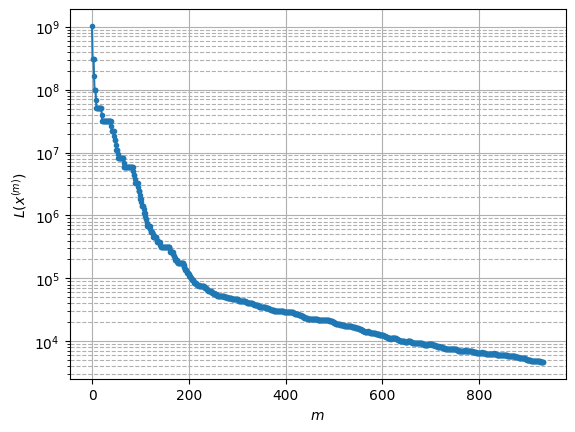

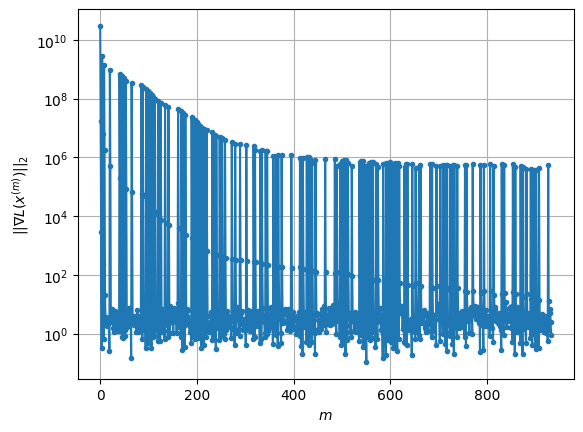

Windows:  12%|█▏        | 35/296 [39:49<1:46:46, 24.55s/it]


Majorization-Minimization Iteration 1
Before applying the algorithm
Cost function: 4650.986204264494
Gradient norm: 599472.2659631693
Global relative error: 83.599956724755
Position relative errors: 0.04638587468496999 m, 35.106407958992456 m, 47.98625759486119 m, 58.769103159400366 m

Iteration 1
Cost function: 4583.164996188472 (-1.46%)
Gradient norm: 15.797871370581728 (-100.00%)
Global relative error = 83.17407554504248 (-0.51%)
Position relative errors: 0.038894066656810236 m, 35.28134780175702 m, 47.47688903008184 m, 58.4730238055547 m

STOP on Iteration 2
Cost function = 4583.164994598816 (-0.00%)
Gradient norm = 0.5055337657378021 (-96.80%)
Global relative error = 83.17407600505601 (0.00%)
Final position relative errors: 0.038894099891254336 m, 35.28134875425521 m, 47.47688901033704 m, 58.473023901187965 m

Majorization-Minimization converged after 1 iterations


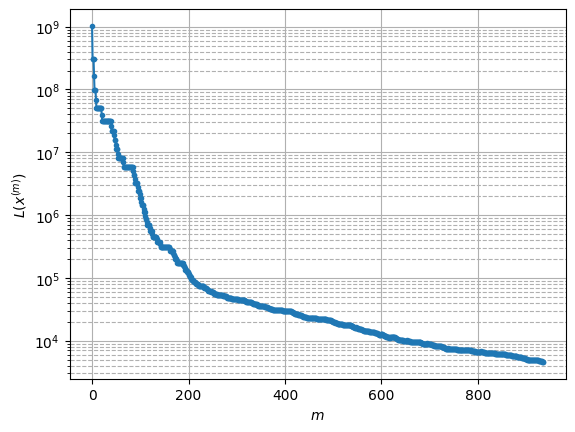

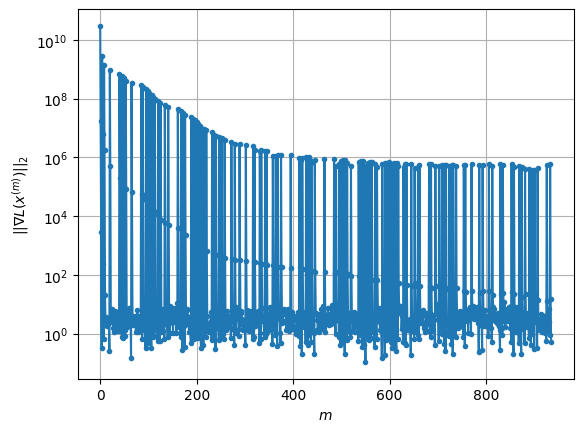

Windows:  12%|█▏        | 36/296 [39:59<1:26:52, 20.05s/it]


Majorization-Minimization Iteration 1
Before applying the algorithm
Cost function: 4545.123191045274
Gradient norm: 680605.1724675908
Global relative error: 85.75144321032525
Position relative errors: 0.03746322973829489 m, 37.016636855907365 m, 49.12683733767972 m, 59.74637447413523 m

Iteration 1
Cost function: 4479.225887496837 (-1.45%)
Gradient norm: 18.657859581811792 (-100.00%)
Global relative error = 85.33985009193411 (-0.48%)
Position relative errors: 0.038438818796212894 m, 37.170655298688345 m, 48.628402451500946 m, 59.46854297500166 m

Iteration 2
Cost function: 4479.225886449412 (-0.00%)
Gradient norm: 1.793129056501243 (-90.39%)
Global relative error = 85.33985011127466 (0.00%)
Position relative errors: 0.038438883772271185 m, 37.170656097707145 m, 48.628401791421794 m, 59.468543043047916 m

Iteration 3
Cost function: 4479.225886642835 (0.00%)
Gradient norm: 2.077008656894042 (15.83%)
Global relative error = 85.33985011141598 (0.00%)
Position relative errors: 0.0384388776

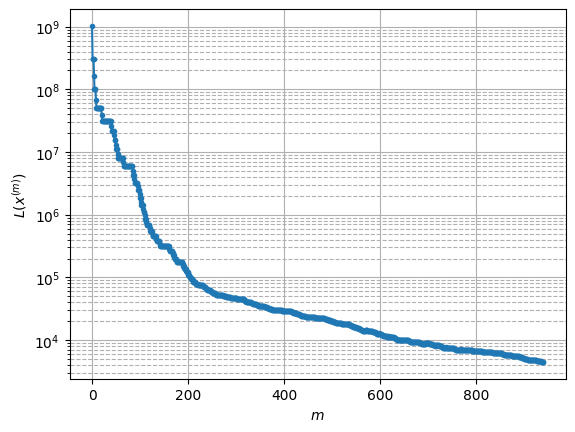

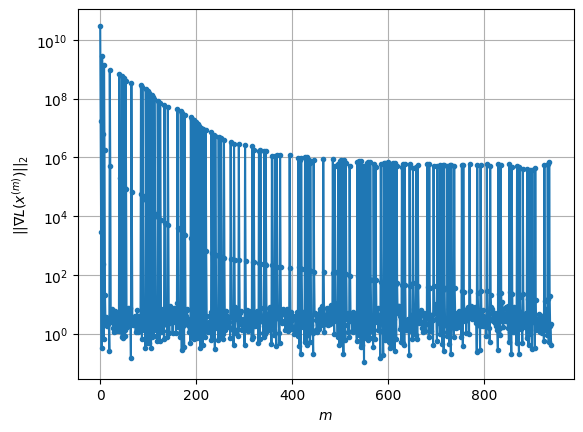

Windows:  12%|█▎        | 37/296 [40:13<1:18:38, 18.22s/it]


Majorization-Minimization Iteration 1
Before applying the algorithm
Cost function: 4457.443422427832
Gradient norm: 717266.6704637378
Global relative error: 87.55506385178249
Position relative errors: 0.03706560595075802 m, 38.73635531139768 m, 50.076840199002476 m, 60.47885048654906 m

Iteration 1
Cost function: 4393.973525797504 (-1.42%)
Gradient norm: 16.77422584022362 (-100.00%)
Global relative error = 87.15480169466491 (-0.46%)
Position relative errors: 0.04197386658401103 m, 38.87134338499452 m, 49.58939108471907 m, 60.21517519397927 m

Iteration 2
Cost function: 4393.973525558817 (-0.00%)
Gradient norm: 7.8525668874536185 (-53.19%)
Global relative error = 87.15480154524745 (-0.00%)
Position relative errors: 0.041973934798877684 m, 38.871344131981566 m, 49.58939020752179 m, 60.21517521786054 m

Iteration 3
Cost function: 4393.973525202042 (-0.00%)
Gradient norm: 4.167968490794286 (-46.92%)
Global relative error = 87.15480154545165 (0.00%)
Position relative errors: 0.041973922017

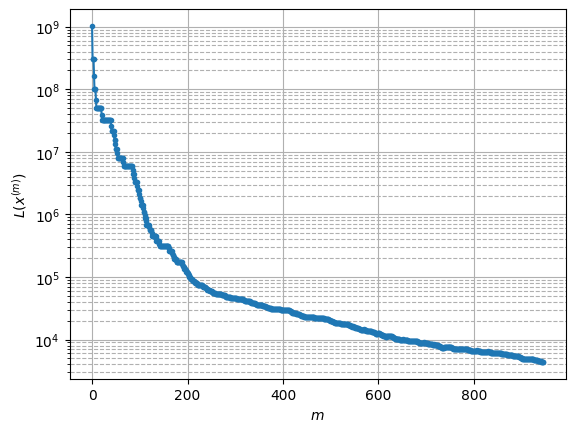

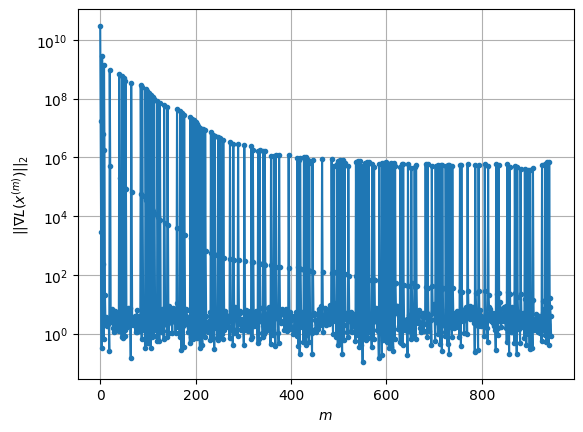

Windows:  13%|█▎        | 38/296 [40:26<1:11:29, 16.62s/it]


Majorization-Minimization Iteration 1
Before applying the algorithm
Cost function: 4353.665514156907
Gradient norm: 759702.6235039722
Global relative error: 89.00028438370241
Position relative errors: 0.039895575411709815 m, 40.25940417832585 m, 50.83290833313182 m, 60.961003102379415 m

Iteration 1
Cost function: 4293.07760752551 (-1.39%)
Gradient norm: 18.033538933548154 (-100.00%)
Global relative error = 88.61282479937353 (-0.44%)
Position relative errors: 0.03599500797906156 m, 40.37762781672126 m, 50.35944307176912 m, 60.710824015711154 m

STOP on Iteration 2
Cost function = 4293.077607580172 (0.00%)
Gradient norm = 0.6851109424219206 (-96.20%)
Global relative error = 88.61282463308018 (-0.00%)
Final position relative errors: 0.03599506743271174 m, 40.377628574732014 m, 50.3594421475316 m, 60.71082403547006 m

Majorization-Minimization converged after 1 iterations


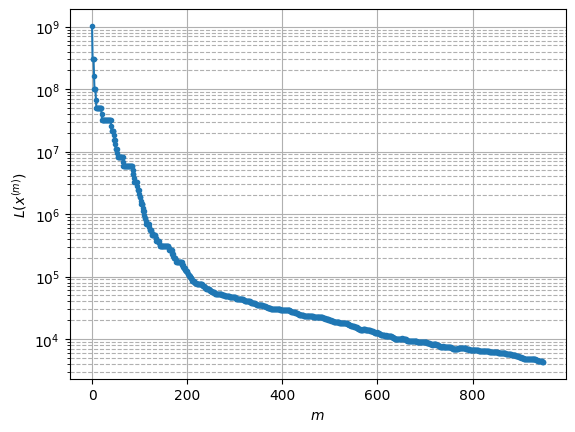

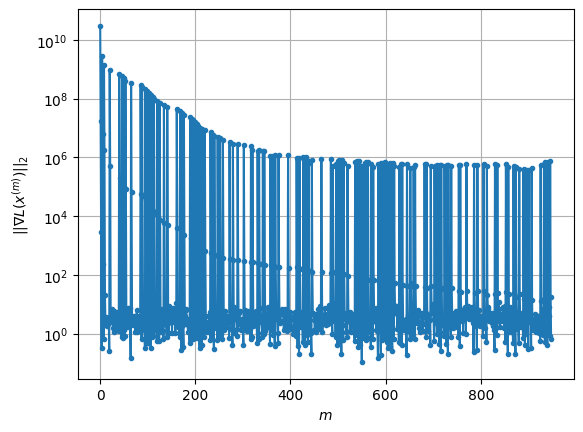

Windows:  13%|█▎        | 39/296 [40:34<1:00:18, 14.08s/it]


Majorization-Minimization Iteration 1
Before applying the algorithm
Cost function: 4267.974253103632
Gradient norm: 832618.9288075313
Global relative error: 90.08289913187245
Position relative errors: 0.03430236345961974 m, 41.581016585003525 m, 51.39549089162117 m, 61.19190711875758 m

Iteration 1
Cost function: 4210.320611266249 (-1.35%)
Gradient norm: 15.620573461400317 (-100.00%)
Global relative error = 89.70740736654737 (-0.42%)
Position relative errors: 0.036018055080795454 m, 41.68234165846484 m, 50.94066967485172 m, 60.95119019477399 m

Iteration 2
Cost function: 4210.320610726181 (-0.00%)
Gradient norm: 3.2689288154051392 (-79.07%)
Global relative error = 89.70740716128823 (-0.00%)
Position relative errors: 0.03601812178947778 m, 41.68234250779099 m, 50.94066863138235 m, 60.95119018390436 m

STOP on Iteration 3
Cost function = 4210.320611792425 (0.00%)
Gradient norm = 0.5598331440089638 (-82.87%)
Global relative error = 89.70740716161713 (0.00%)
Final position relative errors

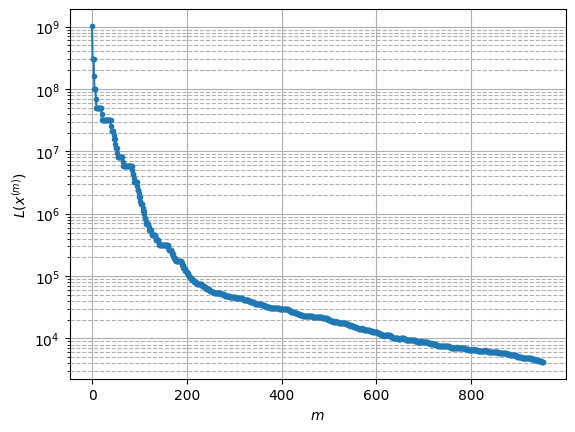

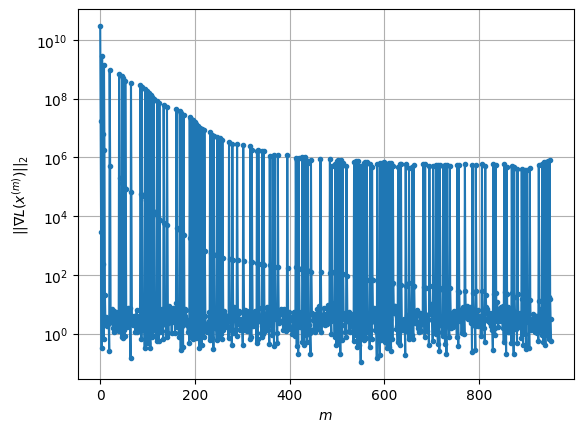

Windows:  14%|█▎        | 40/296 [40:44<55:08, 12.92s/it]  


Majorization-Minimization Iteration 1
Before applying the algorithm
Cost function: 4172.704370186946
Gradient norm: 709394.8971685716
Global relative error: 90.7982703392015
Position relative errors: 0.03386405754375697 m, 42.69497761161923 m, 51.767443646801794 m, 61.168578805786055 m

Iteration 1
Cost function: 4119.398375578279 (-1.28%)
Gradient norm: 12.039081513610896 (-100.00%)
Global relative error = 90.43428512678831 (-0.40%)
Position relative errors: 0.0304015313878334 m, 42.78327323350694 m, 51.32582276413985 m, 60.93939668238088 m

STOP on Iteration 2
Cost function = 4119.398376004054 (0.00%)
Gradient norm = 0.8083991867404557 (-93.29%)
Global relative error = 90.43428510935775 (-0.00%)
Final position relative errors: 0.03040156286142225 m, 42.78327408180128 m, 51.32582205353119 m, 60.93939665944843 m

Majorization-Minimization converged after 1 iterations


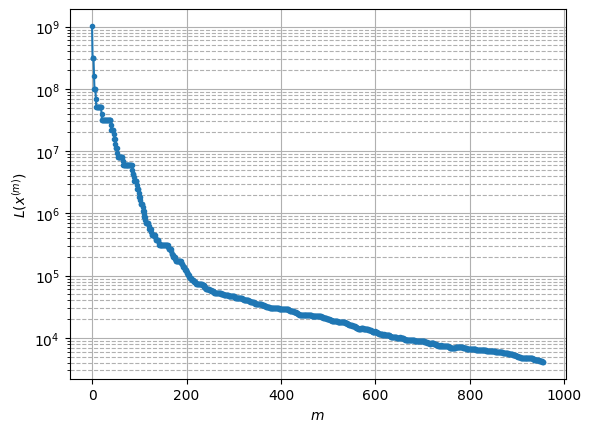

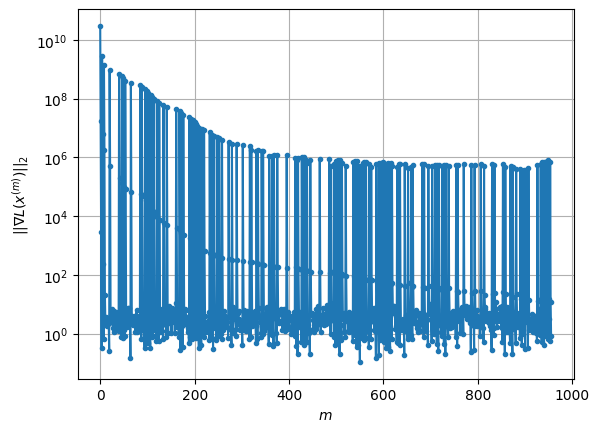

Windows:  14%|█▍        | 41/296 [40:52<48:33, 11.43s/it]


Majorization-Minimization Iteration 1
Before applying the algorithm
Cost function: 4088.6371161965167
Gradient norm: 679496.6783435101
Global relative error: 91.1439156821809
Position relative errors: 0.028507202021338655 m, 43.60008462717867 m, 51.94238341052296 m, 60.8952687174972 m

Iteration 1
Cost function: 4038.689730413776 (-1.22%)
Gradient norm: 14.280939568715604 (-100.00%)
Global relative error = 90.79268039954835 (-0.39%)
Position relative errors: 0.024669141672931664 m, 43.6735021215883 m, 51.52033165440874 m, 60.67611240531882 m

Iteration 2
Cost function: 4038.689730609049 (0.00%)
Gradient norm: 1.1623117633118294 (-91.86%)
Global relative error = 90.79268040560278 (0.00%)
Position relative errors: 0.024669169662148983 m, 43.67350287714026 m, 51.52033107147042 m, 60.67611236551075 m

Iteration 3
Cost function: 4038.6897309290543 (0.00%)
Gradient norm: 1.9952261445083788 (71.66%)
Global relative error = 90.79268040533064 (-0.00%)
Position relative errors: 0.02466917223168

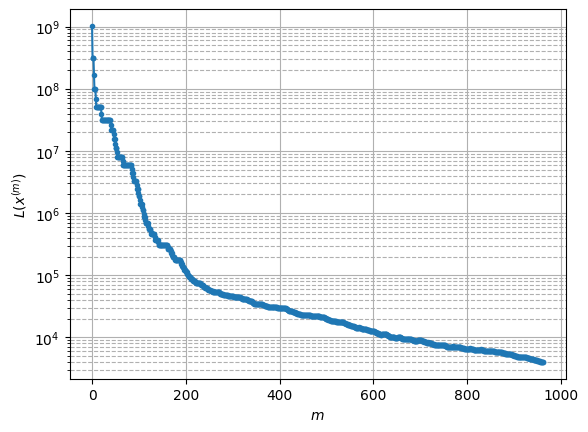

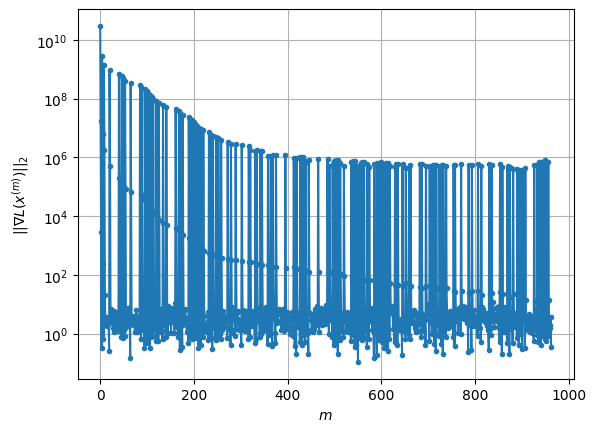

Windows:  14%|█▍        | 42/296 [41:10<56:25, 13.33s/it]


Majorization-Minimization Iteration 1
Before applying the algorithm
Cost function: 4042.9525742988412
Gradient norm: 711125.6432895791
Global relative error: 91.12070233621786
Position relative errors: 0.02307437624079924 m, 44.29047202556567 m, 51.92652349829279 m, 60.37360310367288 m

Iteration 1
Cost function: 3993.625457013348 (-1.22%)
Gradient norm: 18.162872117393235 (-100.00%)
Global relative error = 90.7822314759613 (-0.37%)
Position relative errors: 0.02405035303427374 m, 44.34942306958364 m, 51.525040981663146 m, 60.164039464004865 m

STOP on Iteration 2
Cost function = 3993.6254569965686 (-0.00%)
Gradient norm = 0.9475989029677155 (-94.78%)
Global relative error = 90.78223114342214 (-0.00%)
Final position relative errors: 0.02405039665131514 m, 44.34942357775335 m, 51.525039986686124 m, 60.16403943972973 m

Majorization-Minimization converged after 1 iterations


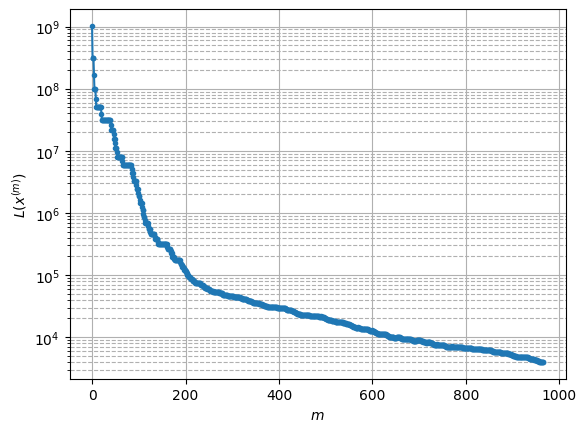

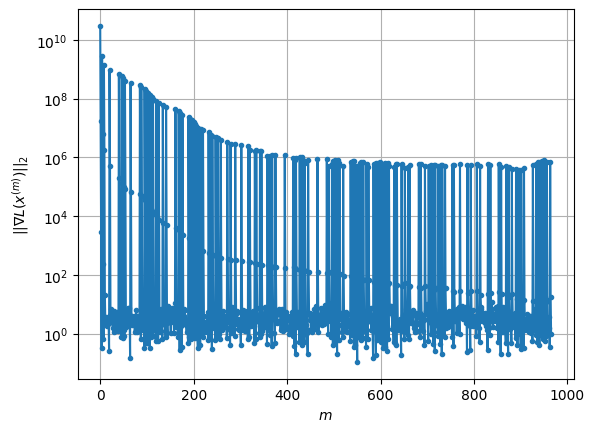

Windows:  15%|█▍        | 43/296 [41:18<49:16, 11.69s/it]


Majorization-Minimization Iteration 1
Before applying the algorithm
Cost function: 3995.9674960678135
Gradient norm: 700188.7477011525
Global relative error: 90.73004717281678
Position relative errors: 0.02260402700454225 m, 44.76364564186692 m, 51.72156366817155 m, 59.60735411406081 m

Iteration 1
Cost function: 3949.038027942682 (-1.17%)
Gradient norm: 7.298760048821276 (-100.00%)
Global relative error = 90.40448506400236 (-0.36%)
Position relative errors: 0.027968623210198697 m, 44.811442985402756 m, 51.34268806602028 m, 59.403980807678586 m

Iteration 2
Cost function: 3949.038029220832 (0.00%)
Gradient norm: 6.549810572249415 (-10.26%)
Global relative error = 90.40448476607145 (-0.00%)
Position relative errors: 0.02796865361783031 m, 44.811443445695566 m, 51.342687167454 m, 59.40398078366141 m

Iteration 3
Cost function: 3949.0380305516746 (0.00%)
Gradient norm: 2.5450866671520416 (-61.14%)
Global relative error = 90.40448476588615 (-0.00%)
Position relative errors: 0.027968654447

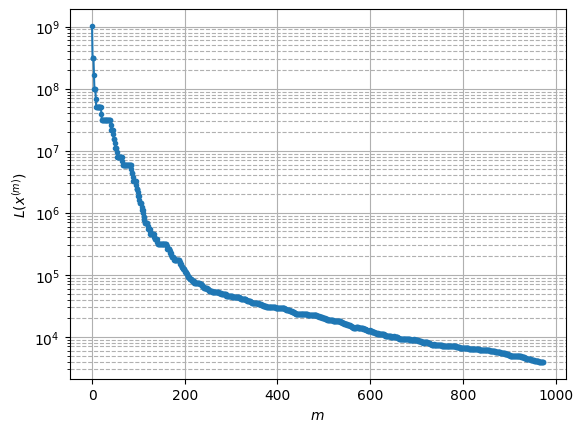

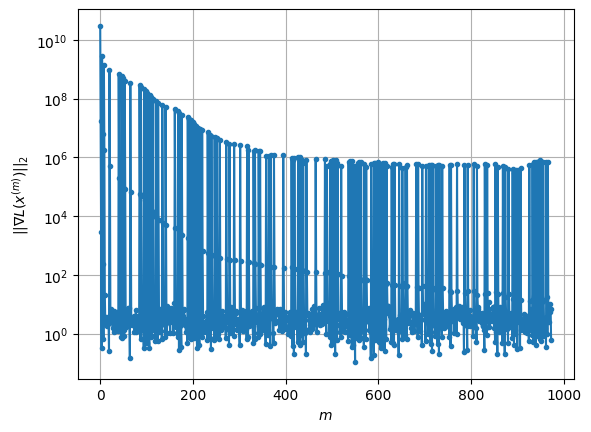

Windows:  15%|█▍        | 44/296 [41:38<59:34, 14.18s/it]


Majorization-Minimization Iteration 1
Before applying the algorithm
Cost function: 3941.5805526724616
Gradient norm: 679775.5395050537
Global relative error: 89.97519591098062
Position relative errors: 0.026726502726596733 m, 45.020963183126035 m, 51.330927060093465 m, 58.5984958119574 m

Iteration 1
Cost function: 3897.606575089627 (-1.12%)
Gradient norm: 14.679156691747304 (-100.00%)
Global relative error = 89.6627040600324 (-0.35%)
Position relative errors: 0.02629900364009712 m, 45.05863464400974 m, 50.97360465471798 m, 58.402145786086656 m

Iteration 2
Cost function: 3897.6065762645644 (0.00%)
Gradient norm: 4.362263907888796 (-70.28%)
Global relative error = 89.6627037510063 (-0.00%)
Position relative errors: 0.026299037586284085 m, 45.05863498894461 m, 50.9736038270878 m, 58.40214576786794 m

Iteration 3
Cost function: 3897.6065757892834 (-0.00%)
Gradient norm: 3.469871890366916 (-20.46%)
Global relative error = 89.66270375077806 (-0.00%)
Position relative errors: 0.02629903698

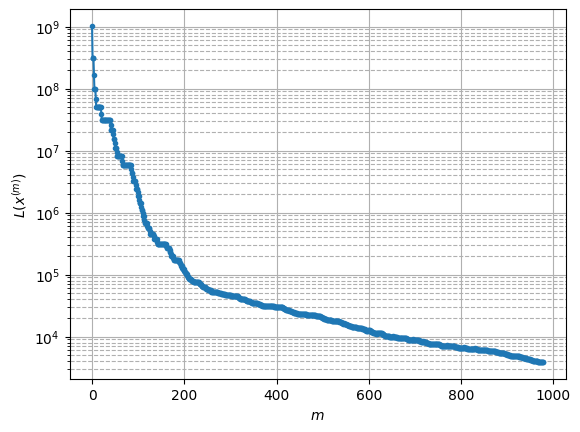

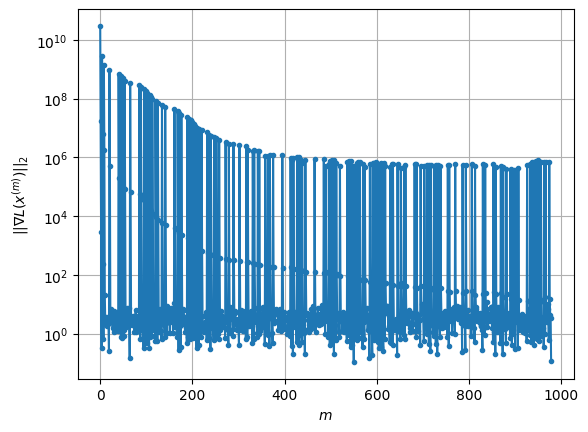

Windows:  15%|█▌        | 45/296 [41:50<57:15, 13.69s/it]


Majorization-Minimization Iteration 1
Before applying the algorithm
Cost function: 3881.8434760638806
Gradient norm: 555662.669232795
Global relative error: 88.86104000303155
Position relative errors: 0.024938608142702563 m, 45.06258362385846 m, 50.755805460835326 m, 57.3541206633276 m

Iteration 1
Cost function: 3841.323727579609 (-1.04%)
Gradient norm: 7.48707121757811 (-100.00%)
Global relative error = 88.5624835102892 (-0.34%)
Position relative errors: 0.02319071815420618 m, 45.091071417802965 m, 50.421175231585536 m, 57.164787275429106 m

STOP on Iteration 2
Cost function = 3841.3237273010886 (-0.00%)
Gradient norm = 0.29096610586583216 (-96.11%)
Global relative error = 88.56248336010047 (-0.00%)
Final position relative errors: 0.02319074122533868 m, 45.09107171223576 m, 50.421174715651325 m, 57.16478726556449 m

Majorization-Minimization converged after 1 iterations


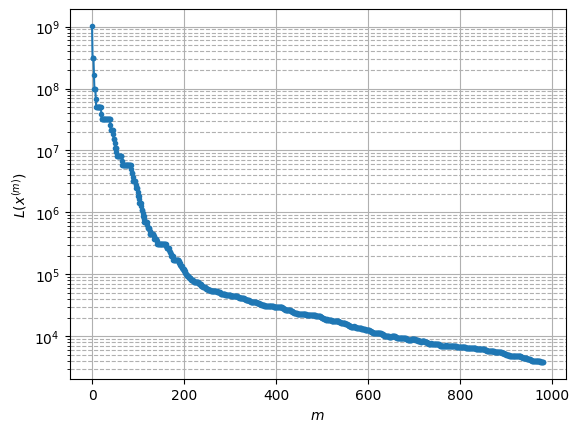

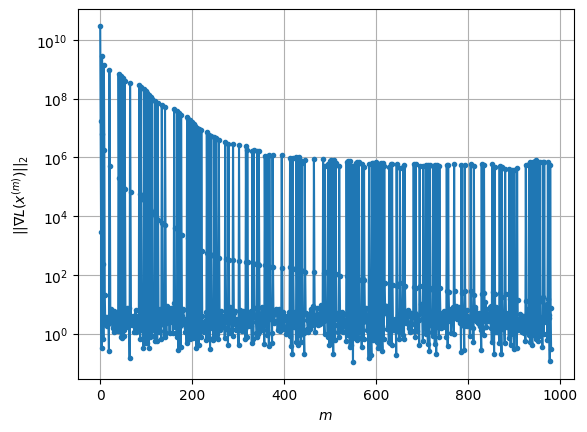

Windows:  16%|█▌        | 46/296 [41:58<49:28, 11.88s/it]


Majorization-Minimization Iteration 1
Before applying the algorithm
Cost function: 3821.7700805996055
Gradient norm: 494366.74334469193
Global relative error: 87.39468403178927
Position relative errors: 0.02179572423721892 m, 44.88960807160824 m, 50.00021051383394 m, 55.88140745701683 m

Iteration 1
Cost function: 3783.605127195167 (-1.00%)
Gradient norm: 9.92165849565805 (-100.00%)
Global relative error = 87.11115114231464 (-0.32%)
Position relative errors: 0.023854061963023566 m, 44.908193102534156 m, 49.68850927974338 m, 55.70150516979534 m

Iteration 2
Cost function: 3783.6051282525755 (0.00%)
Gradient norm: 3.2119895889834935 (-67.63%)
Global relative error = 87.11115096655641 (-0.00%)
Position relative errors: 0.023854084805354413 m, 44.90819327153712 m, 49.68850882905961 m, 55.70150516069558 m

Iteration 3
Cost function: 3783.6051284987607 (0.00%)
Gradient norm: 1.8595921285510963 (-42.10%)
Global relative error = 87.11115096598284 (-0.00%)
Position relative errors: 0.023854084

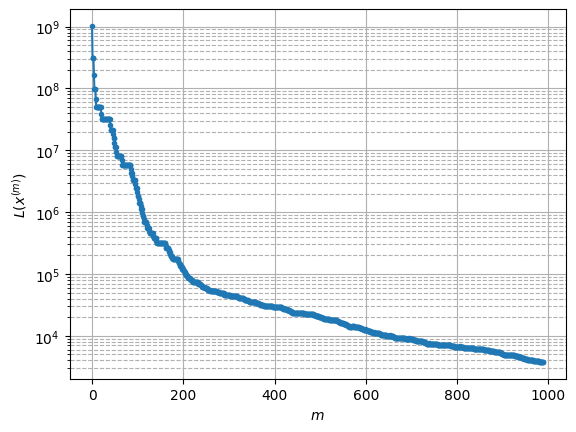

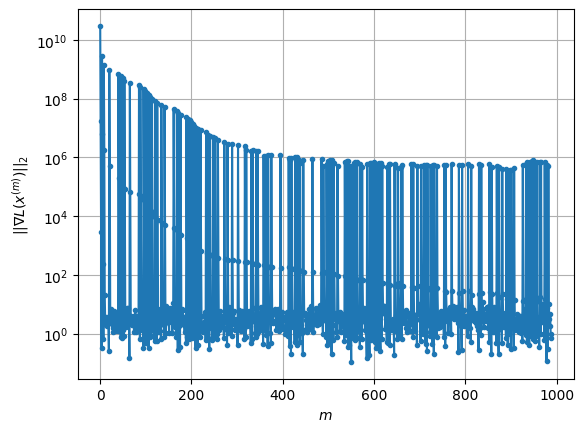

Windows:  16%|█▌        | 47/296 [42:15<56:25, 13.60s/it]


Majorization-Minimization Iteration 1
Before applying the algorithm
Cost function: 3784.0817415253973
Gradient norm: 534987.2065277025
Global relative error: 85.58489236851315
Position relative errors: 0.022495137522216692 m, 44.502687067113435 m, 49.06797266577277 m, 54.19056408171662 m

Iteration 1
Cost function: 3747.4121754201356 (-0.97%)
Gradient norm: 7.886062941552538 (-100.00%)
Global relative error = 85.31574231938072 (-0.31%)
Position relative errors: 0.026218576618956584 m, 44.51448691145578 m, 48.77643926816591 m, 54.019382479747925 m

Iteration 2
Cost function: 3747.412175196677 (-0.00%)
Gradient norm: 5.866580836771166 (-25.61%)
Global relative error = 85.31574211183568 (-0.00%)
Position relative errors: 0.02621859627028836 m, 44.51448698078091 m, 48.77643882283308 m, 54.01938249693415 m

Iteration 3
Cost function: 3747.412174901471 (-0.00%)
Gradient norm: 4.091944036762513 (-30.25%)
Global relative error = 85.31574211225374 (0.00%)
Position relative errors: 0.0262185998

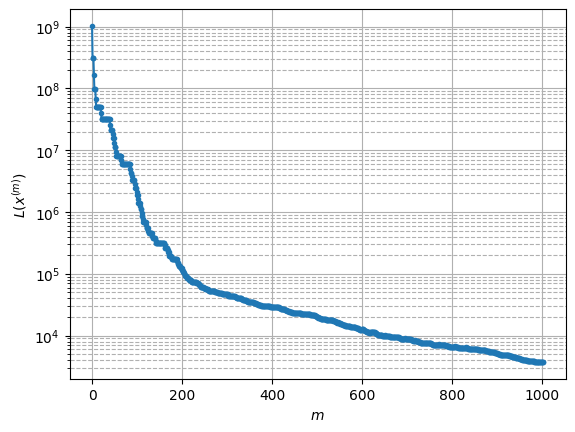

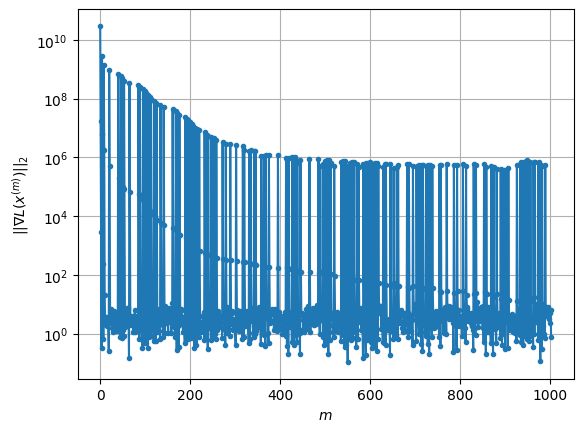

Windows:  16%|█▌        | 48/296 [42:49<1:21:22, 19.69s/it]


Majorization-Minimization Iteration 1
Before applying the algorithm
Cost function: 3752.2866499468773
Gradient norm: 550560.7874024808
Global relative error: 83.44028524497483
Position relative errors: 0.024738130073515673 m, 43.90710555378535 m, 47.960755736903245 m, 52.28968592669665 m

Iteration 1
Cost function: 3716.585512882708 (-0.95%)
Gradient norm: 12.185678248501103 (-100.00%)
Global relative error = 83.18602290224446 (-0.30%)
Position relative errors: 0.03244996235097771 m, 43.91221389239848 m, 47.69050712854878 m, 52.12720067885838 m

Iteration 2
Cost function: 3716.5855140236804 (0.00%)
Gradient norm: 1.0830066188781182 (-91.11%)
Global relative error = 83.18602272355919 (-0.00%)
Position relative errors: 0.03244997501563036 m, 43.91221392613226 m, 47.69050672165711 m, 52.127200737541756 m

Iteration 3
Cost function: 3716.585513728866 (-0.00%)
Gradient norm: 4.86417438694164 (349.14%)
Global relative error = 83.18602272332612 (-0.00%)
Position relative errors: 0.0324499739

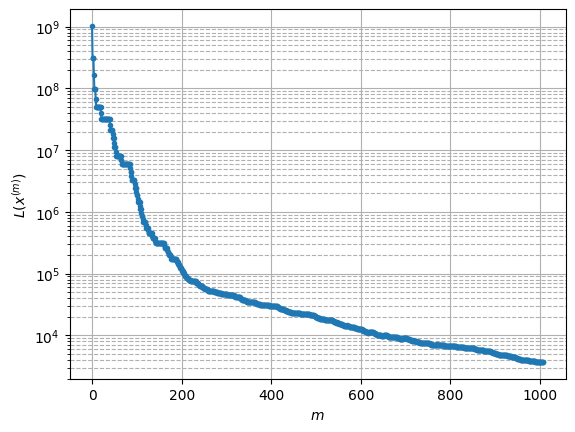

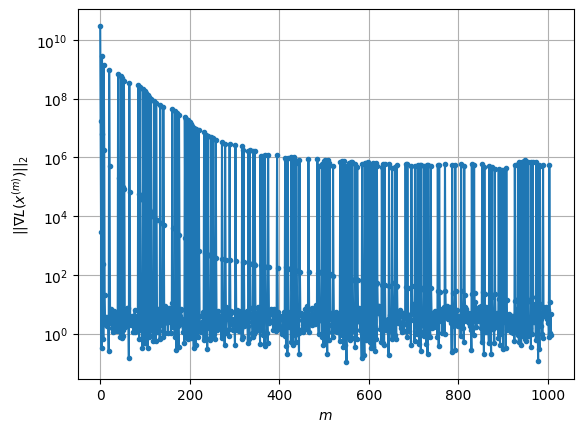

Windows:  17%|█▋        | 49/296 [43:02<1:12:22, 17.58s/it]


Majorization-Minimization Iteration 1
Before applying the algorithm
Cost function: 3739.530943887473
Gradient norm: 524607.2296814673
Global relative error: 80.97205048003637
Position relative errors: 0.030760648533230885 m, 43.10610114407487 m, 46.68486957039176 m, 50.18821840912452 m

Iteration 1
Cost function: 3704.2362677439364 (-0.94%)
Gradient norm: 17.170836301535125 (-100.00%)
Global relative error = 80.73238287516587 (-0.30%)
Position relative errors: 0.033740164520805825 m, 43.1054669530572 m, 46.43443692416224 m, 50.034753691424136 m

Iteration 2
Cost function: 3704.2362671418423 (-0.00%)
Gradient norm: 4.7944834261807525 (-72.08%)
Global relative error = 80.73238269126938 (-0.00%)
Position relative errors: 0.03374017293402243 m, 43.10546699990842 m, 46.4344364808405 m, 50.034753765755326 m

Iteration 3
Cost function: 3704.2362667968223 (-0.00%)
Gradient norm: 3.340205307452825 (-30.33%)
Global relative error = 80.73238269126878 (-0.00%)
Position relative errors: 0.03374018

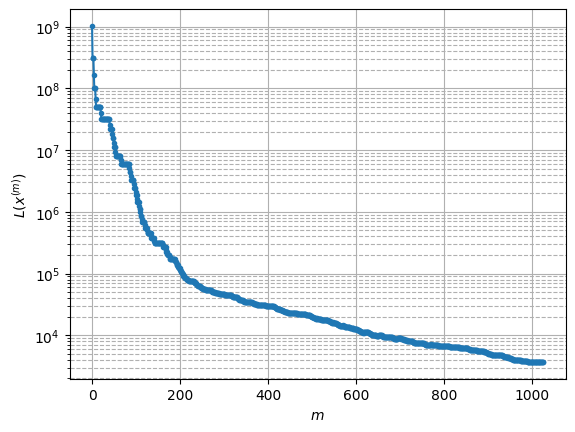

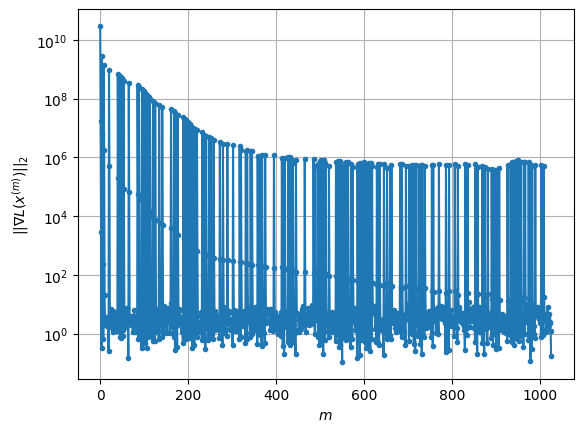

Windows:  17%|█▋        | 50/296 [43:47<1:45:30, 25.73s/it]


Majorization-Minimization Iteration 1
Before applying the algorithm
Cost function: 3730.027615138688
Gradient norm: 459787.3369277169
Global relative error: 78.19199505714703
Position relative errors: 0.03216231064308484 m, 42.10468853469669 m, 45.24455788839558 m, 47.896868766595915 m

Iteration 1
Cost function: 3694.5618738251733 (-0.95%)
Gradient norm: 16.251381043556282 (-100.00%)
Global relative error = 77.96694143859402 (-0.29%)
Position relative errors: 0.03413924989956371 m, 42.09930017678029 m, 45.015257674881546 m, 47.750561469851135 m

Iteration 2
Cost function: 3694.5618753572567 (0.00%)
Gradient norm: 1.7625086000162593 (-89.15%)
Global relative error = 77.96694130926049 (-0.00%)
Position relative errors: 0.03413924884852986 m, 42.09930019644002 m, 45.01525729486508 m, 47.75056159959094 m

STOP on Iteration 3
Cost function = 3694.5618749885202 (-0.00%)
Gradient norm = 0.7038775240041905 (-60.06%)
Global relative error = 77.96694130968477 (0.00%)
Final position relative er

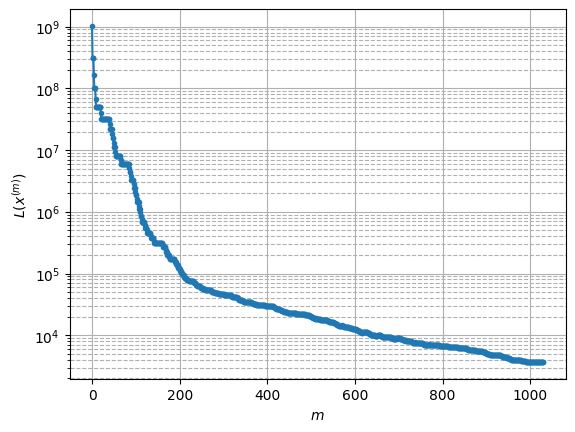

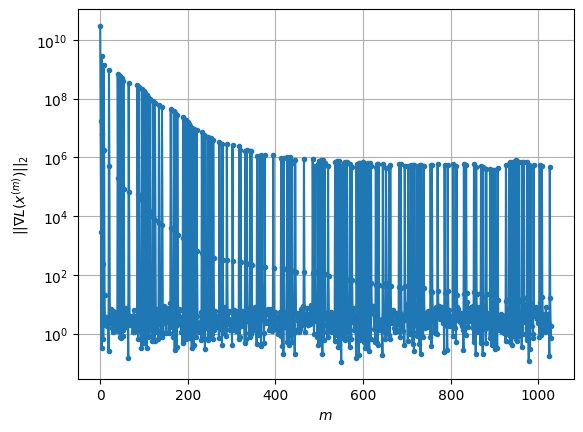

Windows:  17%|█▋        | 51/296 [43:57<1:26:22, 21.15s/it]


Majorization-Minimization Iteration 1
Before applying the algorithm
Cost function: 3682.7369153761238
Gradient norm: 343292.2485150161
Global relative error: 75.11372038152562
Position relative errors: 0.032587610080914584 m, 40.90879385802582 m, 43.647371861083926 m, 45.42515538653247 m

Iteration 1
Cost function: 3650.090286505712 (-0.89%)
Gradient norm: 7.78079281043311 (-100.00%)
Global relative error = 74.90434687505305 (-0.28%)
Position relative errors: 0.020136209655600874 m, 40.8993362372339 m, 43.43673975798514 m, 45.28964611632905 m

Iteration 2
Cost function: 3650.0902883656713 (0.00%)
Gradient norm: 4.419214950064226 (-43.20%)
Global relative error = 74.90434677251548 (-0.00%)
Position relative errors: 0.02013621716579161 m, 40.89933623336349 m, 43.436739454843504 m, 45.28964624097329 m

Iteration 3
Cost function: 3650.090287787978 (-0.00%)
Gradient norm: 3.7714232797241114 (-14.66%)
Global relative error = 74.9043467725459 (0.00%)
Position relative errors: 0.0201362106646

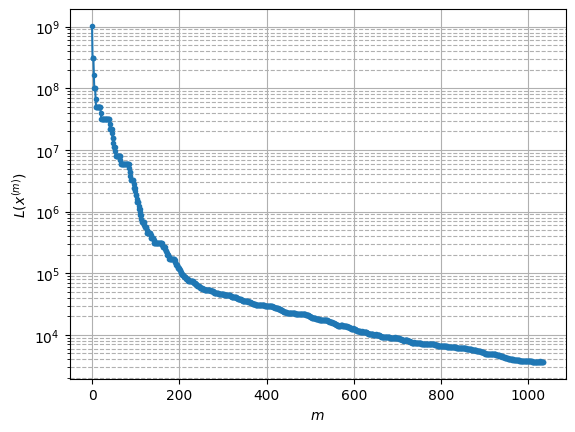

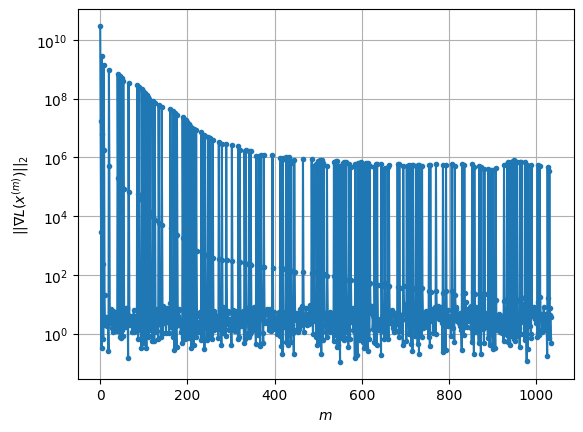

Windows:  18%|█▊        | 52/296 [44:10<1:15:17, 18.52s/it]


Majorization-Minimization Iteration 1
Before applying the algorithm
Cost function: 3662.884632569281
Gradient norm: 480591.67409246205
Global relative error: 71.75326025909385
Position relative errors: 0.018793448136483055 m, 39.525111760176266 m, 41.898026590444296 m, 42.788406015690796 m

Iteration 1
Cost function: 3631.650927928484 (-0.85%)
Gradient norm: 8.13602170472776 (-100.00%)
Global relative error = 71.55775360525688 (-0.27%)
Position relative errors: 0.014217510172942897 m, 39.514658079940354 m, 41.70073683319391 m, 42.663204987624425 m

Iteration 2
Cost function: 3631.650930169489 (0.00%)
Gradient norm: 1.5668575847133444 (-80.74%)
Global relative error = 71.55775350113817 (-0.00%)
Position relative errors: 0.014217522144573894 m, 39.514658076177426 m, 41.700736500572916 m, 42.66320514158686 m

Iteration 3
Cost function: 3631.6509311974414 (0.00%)
Gradient norm: 4.936987392701508 (215.09%)
Global relative error = 71.55775350180161 (0.00%)
Position relative errors: 0.014217

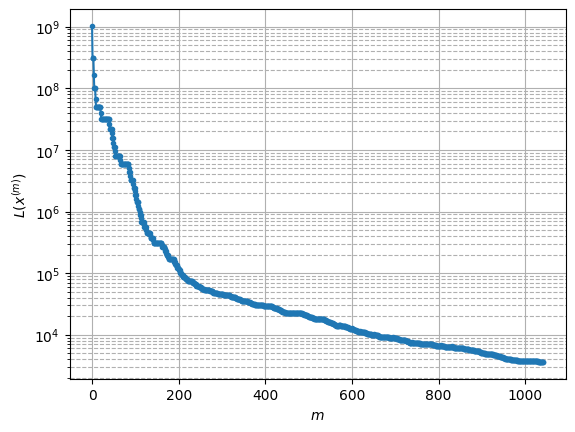

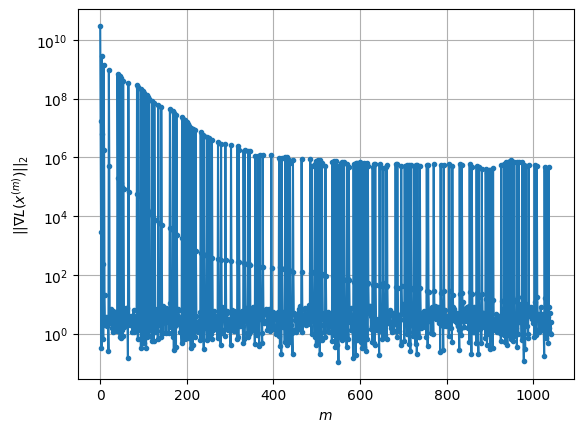

Windows:  18%|█▊        | 53/296 [44:27<1:13:53, 18.25s/it]


Majorization-Minimization Iteration 1
Before applying the algorithm
Cost function: 3654.330977120861
Gradient norm: 464337.5274406972
Global relative error: 68.12518338612294
Position relative errors: 0.013116197099207279 m, 37.96359740107711 m, 39.99911701962945 m, 39.998407293459145 m

Iteration 1
Cost function: 3625.933468367733 (-0.78%)
Gradient norm: 8.689818798269709 (-100.00%)
Global relative error = 67.9413044031102 (-0.27%)
Position relative errors: 0.0076664419264551205 m, 37.954016892012966 m, 39.807995879859554 m, 39.885249552365686 m

STOP on Iteration 2
Cost function = 3625.933467501863 (-0.00%)
Gradient norm = 0.2499127370185357 (-97.12%)
Global relative error = 67.94130427076429 (-0.00%)
Final position relative errors: 0.007666458487919281 m, 37.95401687580027 m, 39.80799551113106 m, 39.88524971036326 m

Majorization-Minimization converged after 1 iterations


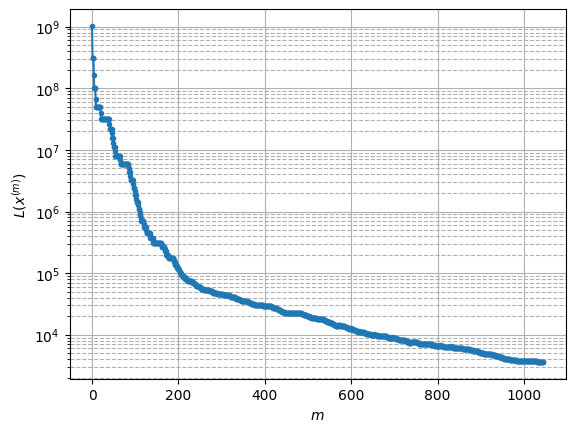

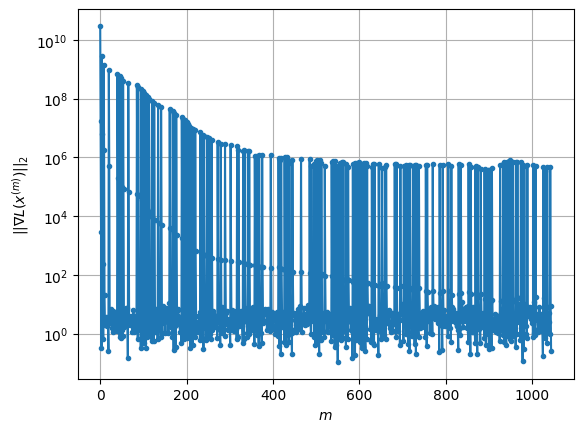

Windows:  18%|█▊        | 54/296 [44:36<1:02:12, 15.42s/it]


Majorization-Minimization Iteration 1
Before applying the algorithm
Cost function: 3649.8398303721547
Gradient norm: 337860.31102982815
Global relative error: 64.24527324302828
Position relative errors: 0.006009818031182134 m, 36.23363071668098 m, 37.952525557027755 m, 37.069941957979154 m

Iteration 1
Cost function: 3621.329870979609 (-0.78%)
Gradient norm: 6.440326132132025 (-100.00%)
Global relative error = 64.07541889131663 (-0.26%)
Position relative errors: 0.0058481539442351285 m, 36.226206228583536 m, 37.76740865656886 m, 36.97214944926566 m

Iteration 2
Cost function: 3621.329869464208 (-0.00%)
Gradient norm: 3.421204913526113 (-46.88%)
Global relative error = 64.07541881414248 (-0.00%)
Position relative errors: 0.005848161422685331 m, 36.22620621736272 m, 37.76740833778916 m, 36.972149652146335 m

Iteration 3
Cost function: 3621.3298695355807 (0.00%)
Gradient norm: 3.5377453169888455 (3.41%)
Global relative error = 64.07541881421251 (0.00%)
Position relative errors: 0.0058481

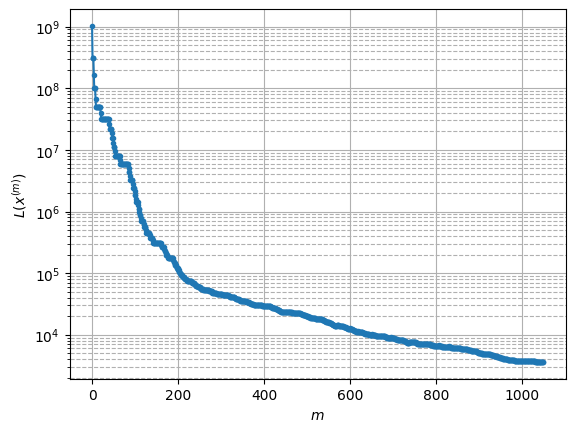

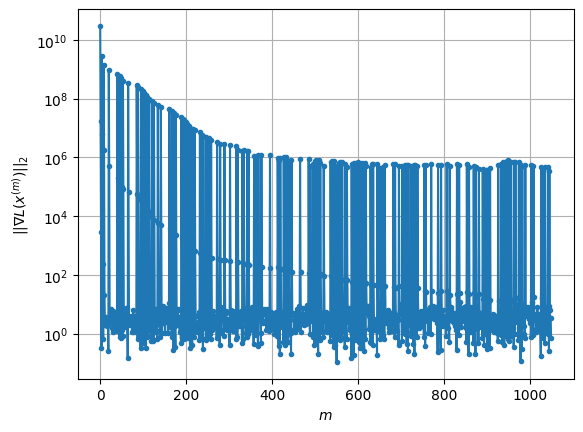

Windows:  19%|█▊        | 55/296 [44:51<1:01:54, 15.41s/it]


Majorization-Minimization Iteration 1
Before applying the algorithm
Cost function: 3633.705290957538
Gradient norm: 265875.8404972391
Global relative error: 60.13515328848628
Position relative errors: 0.004218851485507698 m, 34.34480285718451 m, 35.76695244293427 m, 34.020455879122174 m

Iteration 1
Cost function: 3605.954113593669 (-0.76%)
Gradient norm: 5.550945841781437 (-100.00%)
Global relative error = 59.97751729734517 (-0.26%)
Position relative errors: 0.017382936095149085 m, 34.33856166969648 m, 35.58636282843866 m, 33.9377582942256 m

Iteration 2
Cost function: 3605.9541119720666 (-0.00%)
Gradient norm: 5.681406992415361 (2.35%)
Global relative error = 59.97751722841386 (-0.00%)
Position relative errors: 0.01738292370251106 m, 34.33856165651493 m, 35.58636251569629 m, 33.93775851368203 m

STOP on Iteration 3
Cost function = 3605.9541114165972 (-0.00%)
Gradient norm = 0.7231200216723005 (-87.27%)
Global relative error = 59.97751722860253 (0.00%)
Final position relative errors:

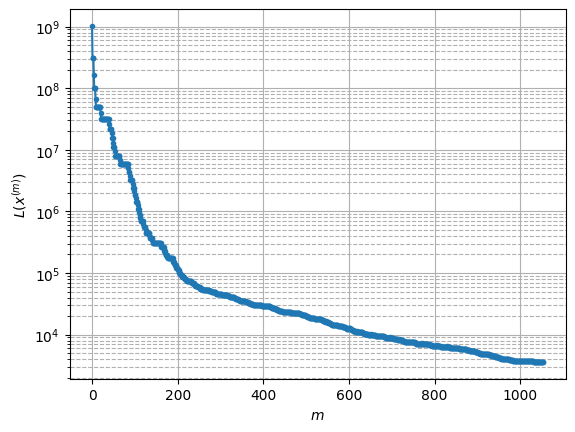

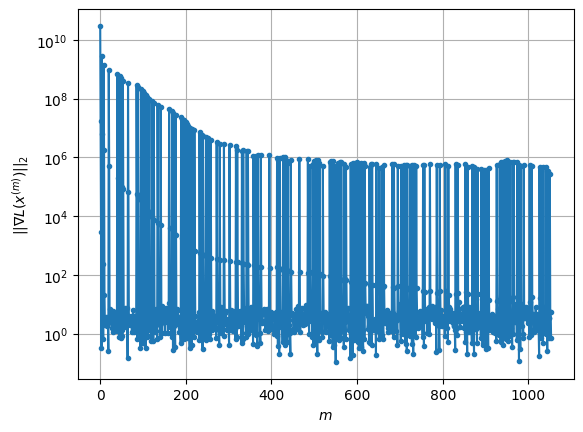

Windows:  19%|█▉        | 56/296 [45:01<55:09, 13.79s/it]  


Majorization-Minimization Iteration 1
Before applying the algorithm
Cost function: 3599.266404367668
Gradient norm: 221174.40648109379
Global relative error: 55.81405932501429
Position relative errors: 0.015738102919236528 m, 32.30514602085309 m, 33.45091597329644 m, 30.864499746245198 m

Iteration 1
Cost function: 3573.0728947580565 (-0.73%)
Gradient norm: 3.9890544231218135 (-100.00%)
Global relative error = 55.66973217680589 (-0.26%)
Position relative errors: 0.014921221421840141 m, 32.30330552072993 m, 33.27111835605377 m, 30.80004318320613 m

Iteration 2
Cost function: 3573.072895650298 (0.00%)
Gradient norm: 1.3290607512532902 (-66.68%)
Global relative error = 55.66973213815746 (-0.00%)
Position relative errors: 0.01492119646930498 m, 32.3033055260554 m, 33.27111807399922 m, 30.800043412460386 m

Iteration 3
Cost function: 3573.0728951974734 (-0.00%)
Gradient norm: 3.72093676060504 (179.97%)
Global relative error = 55.669732138494815 (0.00%)
Position relative errors: 0.014921192

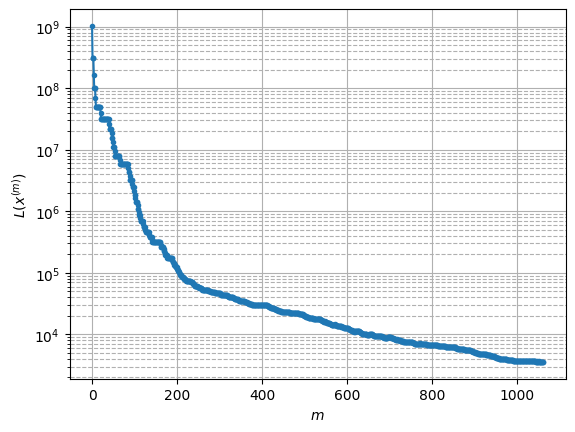

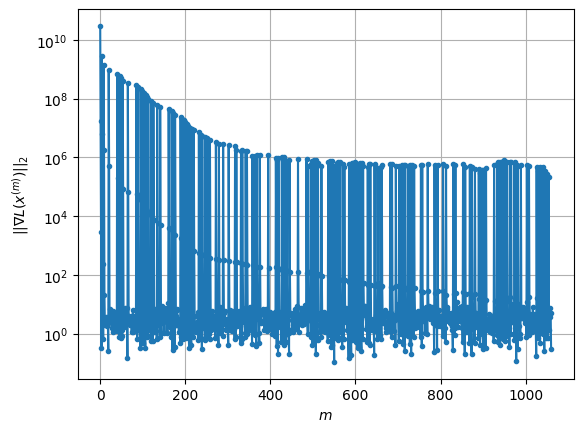

Windows:  19%|█▉        | 57/296 [45:19<59:30, 14.94s/it]


Majorization-Minimization Iteration 1
Before applying the algorithm
Cost function: 3574.6597470923557
Gradient norm: 180597.5232097528
Global relative error: 51.30616552589723
Position relative errors: 0.013639368130900406 m, 30.127563933228576 m, 31.011478257280576 m, 27.621271592256864 m

Iteration 1
Cost function: 3549.1660360710584 (-0.71%)
Gradient norm: 6.436597681403915 (-100.00%)
Global relative error = 51.17397078256862 (-0.26%)
Position relative errors: 0.021054831523747274 m, 30.129263151025114 m, 30.831834779014105 m, 27.575250972503735 m

Iteration 2
Cost function: 3549.16603788729 (0.00%)
Gradient norm: 2.7656760759469066 (-57.03%)
Global relative error = 51.17397074650555 (-0.00%)
Position relative errors: 0.021054818055085724 m, 30.129263161289767 m, 30.831834495052348 m, 27.575251211869347 m

Iteration 3
Cost function: 3549.166037256894 (-0.00%)
Gradient norm: 4.722630203682941 (70.76%)
Global relative error = 51.173970746661496 (0.00%)
Position relative errors: 0.021

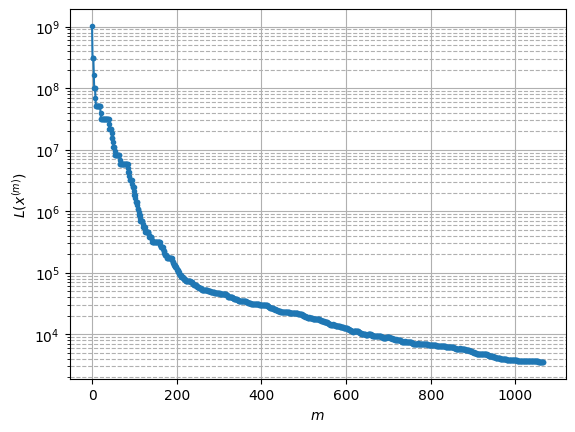

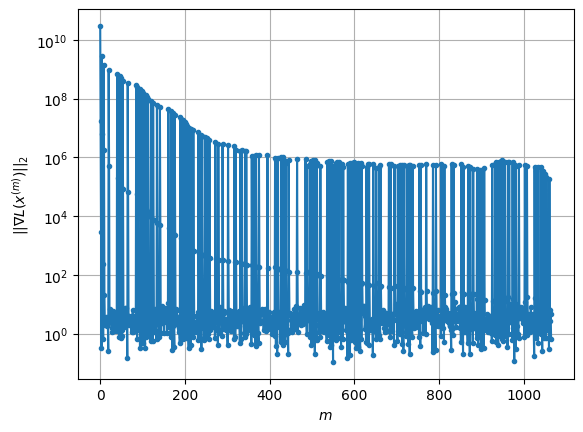

Windows:  20%|█▉        | 58/296 [45:32<56:44, 14.30s/it]


Majorization-Minimization Iteration 1
Before applying the algorithm
Cost function: 3530.375625567922
Gradient norm: 158992.05304015975
Global relative error: 46.63587359044677
Position relative errors: 0.019961969328073283 m, 27.82138054299885 m, 28.4596278587302 m, 24.308811050486895 m

Iteration 1
Cost function: 3504.2829156575544 (-0.74%)
Gradient norm: 3.993335810296439 (-100.00%)
Global relative error = 46.51965109445478 (-0.25%)
Position relative errors: 0.030171449344193354 m, 27.827051452683637 m, 28.279103641487062 m, 24.290290467023613 m

Iteration 2
Cost function: 3504.282914836333 (-0.00%)
Gradient norm: 1.8389773741111213 (-53.95%)
Global relative error = 46.519651087632745 (-0.00%)
Position relative errors: 0.03017140748040458 m, 27.827051465175114 m, 28.2791034034765 m, 24.290290716794523 m

Iteration 3
Cost function: 3504.2829153929692 (0.00%)
Gradient norm: 5.593300055397924 (204.15%)
Global relative error = 46.519651088088025 (0.00%)
Position relative errors: 0.03017

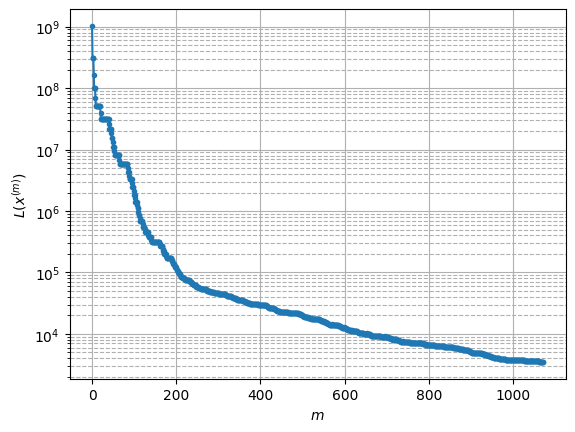

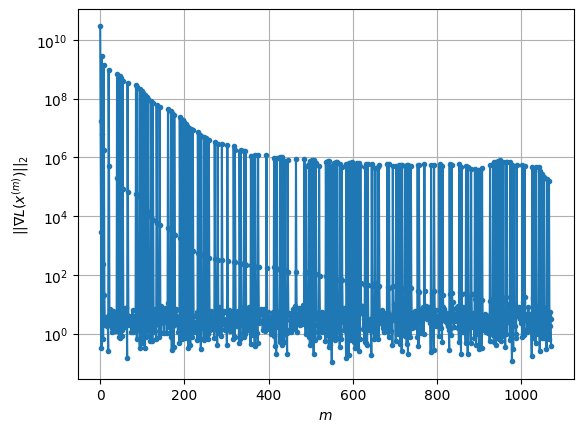

Windows:  20%|█▉        | 59/296 [45:47<58:01, 14.69s/it]


Majorization-Minimization Iteration 1
Before applying the algorithm
Cost function: 3490.5151567375437
Gradient norm: 246197.626463073
Global relative error: 41.83603800210984
Position relative errors: 0.02888474730377251 m, 25.3977950958791 m, 25.80630765842231 m, 20.957884168136466 m

Iteration 1
Cost function: 3465.5760015927144 (-0.71%)
Gradient norm: 5.132016807297397 (-100.00%)
Global relative error = 41.73254125255364 (-0.25%)
Position relative errors: 0.02585214422426256 m, 25.40712137102993 m, 25.628149468730914 m, 20.958857496962263 m

STOP on Iteration 2
Cost function = 3465.5760033919905 (0.00%)
Gradient norm = 0.9008073750949035 (-82.45%)
Global relative error = 41.732541221292585 (-0.00%)
Final position relative errors: 0.02585210346091343 m, 25.40712137333945 m, 25.628149212019917 m, 20.958857745867927 m

Majorization-Minimization converged after 1 iterations


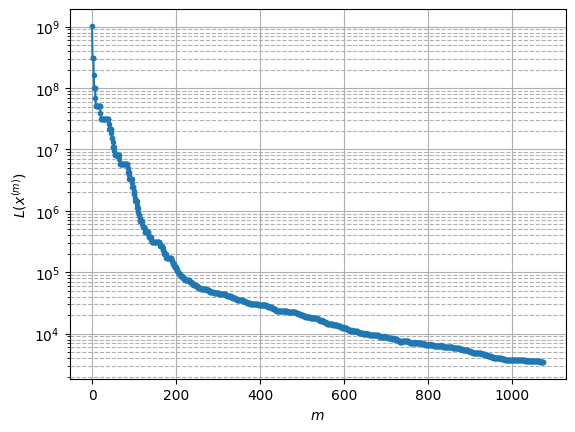

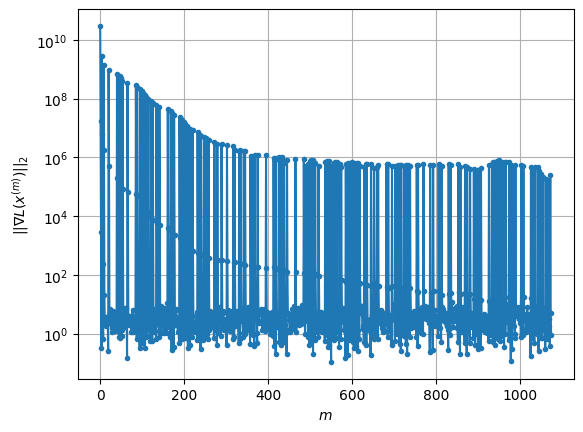

Windows:  20%|██        | 60/296 [45:55<49:50, 12.67s/it]


Majorization-Minimization Iteration 1
Before applying the algorithm
Cost function: 3457.323612737401
Gradient norm: 186954.5941596328
Global relative error: 36.93762094198774
Position relative errors: 0.02502745245009487 m, 22.86796557421312 m, 23.067948083471563 m, 17.587095212154118 m

Iteration 1
Cost function: 3432.185455768185 (-0.73%)
Gradient norm: 7.511240558571628 (-100.00%)
Global relative error = 36.84814109677259 (-0.24%)
Position relative errors: 0.023362159089060003 m, 22.877657795618862 m, 22.88857371296786 m, 17.621117077906682 m

Iteration 2
Cost function: 3432.1854554674314 (-0.00%)
Gradient norm: 5.5258903887094375 (-26.43%)
Global relative error = 36.84814101646627 (-0.00%)
Position relative errors: 0.02336211451274952 m, 22.877657792566954 m, 22.888573402261983 m, 17.621117317580474 m

Iteration 3
Cost function: 3432.185454337637 (-0.00%)
Gradient norm: 5.053041427495001 (-8.56%)
Global relative error = 36.848141016855365 (0.00%)
Position relative errors: 0.023362

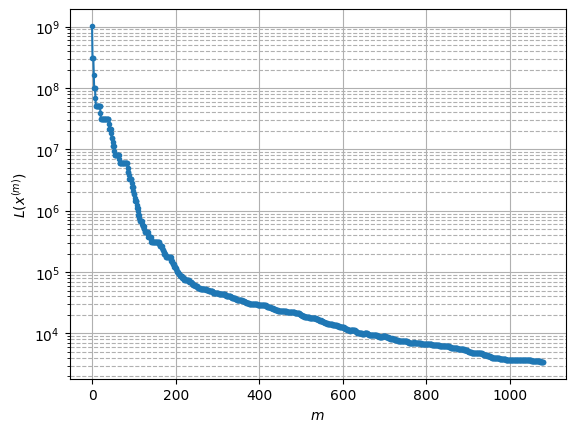

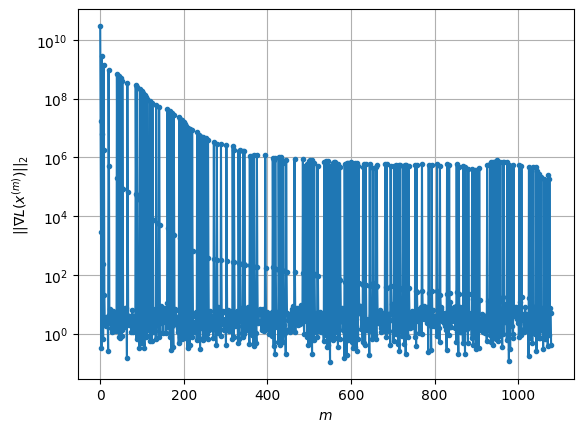

Windows:  21%|██        | 61/296 [46:08<49:39, 12.68s/it]


Majorization-Minimization Iteration 1
Before applying the algorithm
Cost function: 3407.9606749505883
Gradient norm: 235793.875627721
Global relative error: 31.98515537088011
Position relative errors: 0.023033188346799092 m, 20.240656374580873 m, 20.254852559896403 m, 14.251275358368506 m

Iteration 1
Cost function: 3381.7116391832815 (-0.77%)
Gradient norm: 3.8771649058408557 (-100.00%)
Global relative error = 31.91663691045547 (-0.21%)
Position relative errors: 0.03314791876657775 m, 20.25053260431299 m, 20.082288435360386 m, 14.327621365030694 m

Iteration 2
Cost function: 3381.71163983726 (0.00%)
Gradient norm: 2.3450024534795917 (-39.52%)
Global relative error = 31.91663680237951 (-0.00%)
Position relative errors: 0.03314784915042821 m, 20.25053259666561 m, 20.082288093406632 m, 14.327621614544919 m

Iteration 3
Cost function: 3381.7116389979965 (-0.00%)
Gradient norm: 1.1777658648026108 (-49.78%)
Global relative error = 31.916636803751683 (0.00%)
Position relative errors: 0.0331

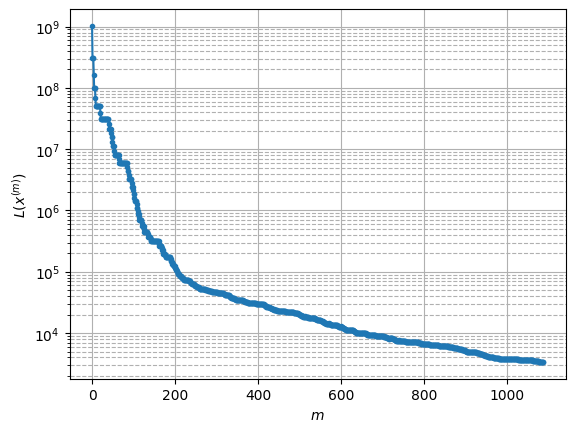

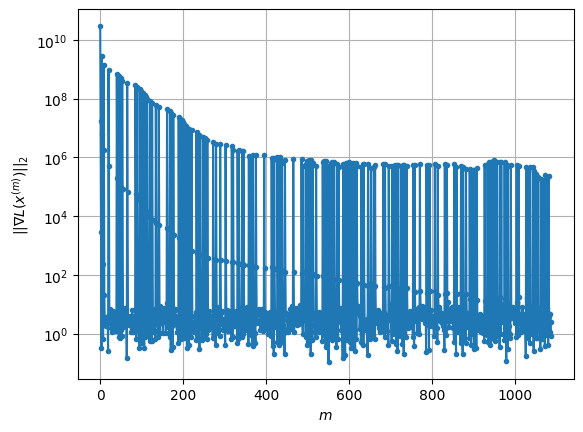

Windows:  21%|██        | 62/296 [46:25<54:50, 14.06s/it]


Majorization-Minimization Iteration 1
Before applying the algorithm
Cost function: 3365.0896104787353
Gradient norm: 344354.7567590268
Global relative error: 27.044987590254784
Position relative errors: 0.03264284599209492 m, 17.52844611250848 m, 17.38940668972196 m, 11.035603891616626 m

Iteration 1
Cost function: 3339.8408607526712 (-0.75%)
Gradient norm: 5.543400114705246 (-100.00%)
Global relative error = 26.989752161718535 (-0.20%)
Position relative errors: 0.03419433642936997 m, 17.539668066180738 m, 17.227033194246122 m, 11.136747310652876 m

Iteration 2
Cost function: 3339.840859000625 (-0.00%)
Gradient norm: 3.7685074862381556 (-32.02%)
Global relative error = 26.989751956437754 (-0.00%)
Position relative errors: 0.03419427788477023 m, 17.539668057598615 m, 17.227032727689334 m, 11.13674754855252 m

Iteration 3
Cost function: 3339.8408605900886 (0.00%)
Gradient norm: 2.174935260645717 (-42.29%)
Global relative error = 26.98975195671322 (0.00%)
Position relative errors: 0.0341

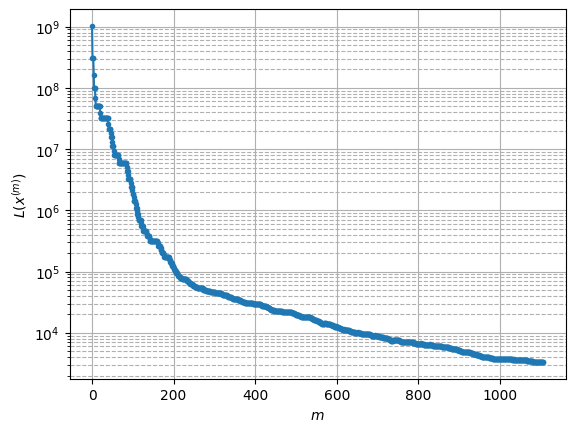

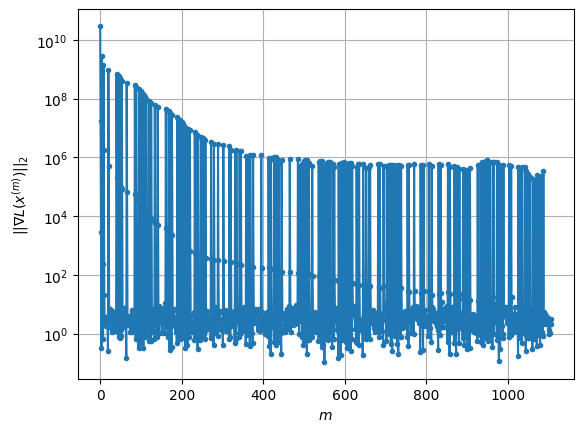

Windows:  21%|██▏       | 63/296 [47:15<1:35:33, 24.61s/it]


Majorization-Minimization Iteration 1
Before applying the algorithm
Cost function: 3322.120525741448
Gradient norm: 309891.5667343176
Global relative error: 22.201283735396885
Position relative errors: 0.03390280552393564 m, 14.745830484501385 m, 14.49216160676933 m, 8.08860415316852 m

Iteration 1
Cost function: 3296.595107229648 (-0.77%)
Gradient norm: 5.495026010904285 (-100.00%)
Global relative error = 22.16716527628579 (-0.15%)
Position relative errors: 0.03114524652686398 m, 14.757612157830401 m, 14.343026088579869 m, 8.238005113388528 m

STOP on Iteration 2
Cost function = 3296.595108958393 (0.00%)
Gradient norm = 0.22541789129731027 (-95.90%)
Global relative error = 22.167165001137462 (-0.00%)
Final position relative errors: 0.031145192167132192 m, 14.75761215178685 m, 14.343025532034023 m, 8.23800535302997 m

Majorization-Minimization converged after 1 iterations


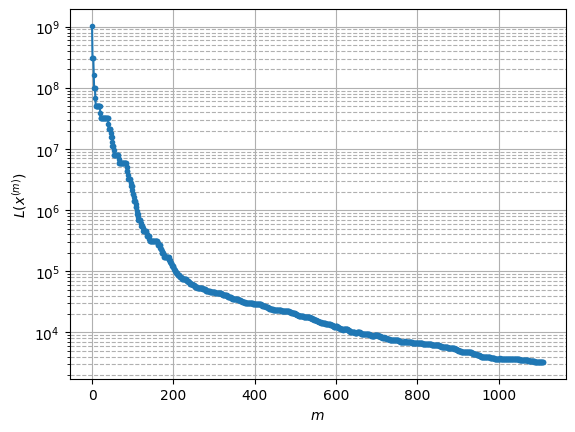

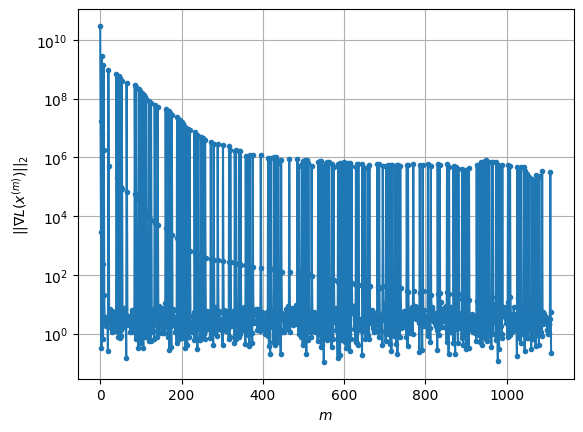

Windows:  22%|██▏       | 64/296 [47:23<1:15:53, 19.63s/it]


Majorization-Minimization Iteration 1
Before applying the algorithm
Cost function: 3270.0578206727505
Gradient norm: 366204.2418401947
Global relative error: 17.62840191521424
Position relative errors: 0.03156627883969487 m, 11.906738365568483 m, 11.586977188675036 m, 5.8926119937688854 m

Iteration 1
Cost function: 3243.778697805135 (-0.80%)
Gradient norm: 5.146336372118812 (-100.00%)
Global relative error = 17.62398426009884 (-0.03%)
Position relative errors: 0.03023182727571882 m, 11.918086476987703 m, 11.45318646324504 m, 6.113876274122555 m

STOP on Iteration 2
Cost function = 3243.7786967191682 (-0.00%)
Gradient norm = 0.6837993359923067 (-86.71%)
Global relative error = 17.623983941272993 (-0.00%)
Final position relative errors: 0.030231768779869172 m, 11.91808647579466 m, 11.453185858461842 m, 6.113876490629764 m

Majorization-Minimization converged after 1 iterations


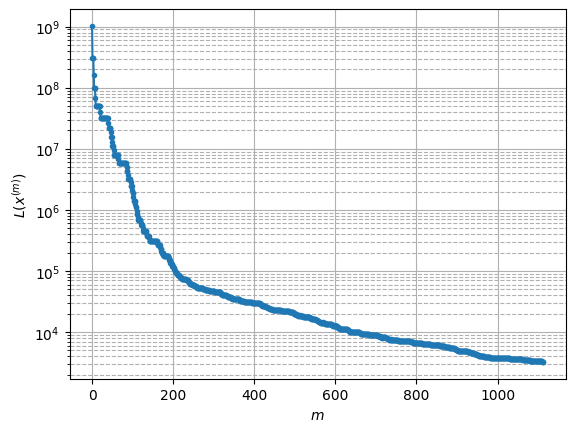

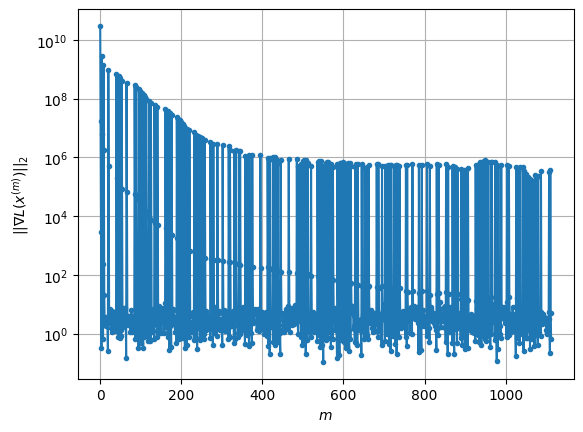

Windows:  22%|██▏       | 65/296 [47:31<1:02:24, 16.21s/it]


Majorization-Minimization Iteration 1
Before applying the algorithm
Cost function: 3223.3080276094283
Gradient norm: 545946.8670336782
Global relative error: 13.678521642257536
Position relative errors: 0.031005247090278278 m, 9.027474798792738 m, 8.705012653096995 m, 5.460781844119088 m

Iteration 1
Cost function: 3197.3284890890213 (-0.81%)
Gradient norm: 3.1594050557246818 (-100.00%)
Global relative error = 13.68853645202715 (0.07%)
Position relative errors: 0.026199274195412525 m, 9.04118045010754 m, 8.592484634600124 m, 5.638560402663469 m

Iteration 2
Cost function: 3197.3284912569898 (0.00%)
Gradient norm: 1.1639108054291962 (-63.16%)
Global relative error = 13.68853614993798 (-0.00%)
Position relative errors: 0.02619925125632971 m, 9.041180466851928 m, 8.592484044227124 m, 5.638560542207113 m

Iteration 3
Cost function: 3197.3284891721387 (-0.00%)
Gradient norm: 1.15652920658506 (-0.63%)
Global relative error = 13.688536153591304 (0.00%)
Position relative errors: 0.02619925094

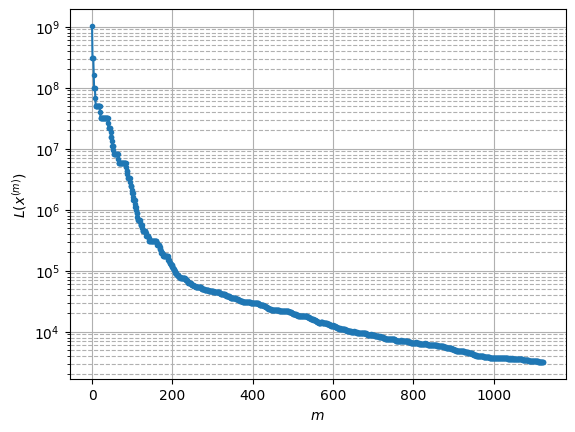

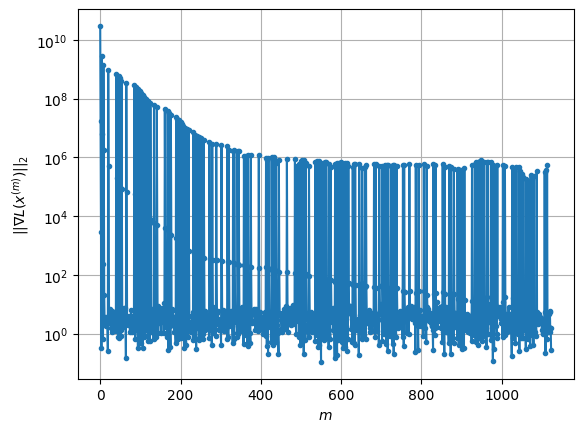

Windows:  22%|██▏       | 66/296 [47:58<1:15:09, 19.61s/it]


Majorization-Minimization Iteration 1
Before applying the algorithm
Cost function: 3185.7382083270268
Gradient norm: 461834.95795323927
Global relative error: 11.054164504301474
Position relative errors: 0.02812206296421147 m, 6.138945451832393 m, 5.910893711842825 m, 7.039895116782364 m

Iteration 1
Cost function: 3159.4901865669267 (-0.82%)
Gradient norm: 2.540222568435237 (-100.00%)
Global relative error = 11.090840802942472 (0.33%)
Position relative errors: 0.027051025287882252 m, 6.154879901104701 m, 5.816605183111046 m, 7.1611671740810765 m

Iteration 2
Cost function: 3159.490187687086 (0.00%)
Gradient norm: 3.705707334314772 (45.88%)
Global relative error = 11.090840545347827 (-0.00%)
Position relative errors: 0.02705099976614155 m, 6.15487991912418 m, 5.816604618193124 m, 7.161167218592708 m

STOP on Iteration 3
Cost function = 3159.490189131192 (0.00%)
Gradient norm = 0.3093693342960258 (-91.65%)
Global relative error = 11.090840545857851 (0.00%)
Final position relative error

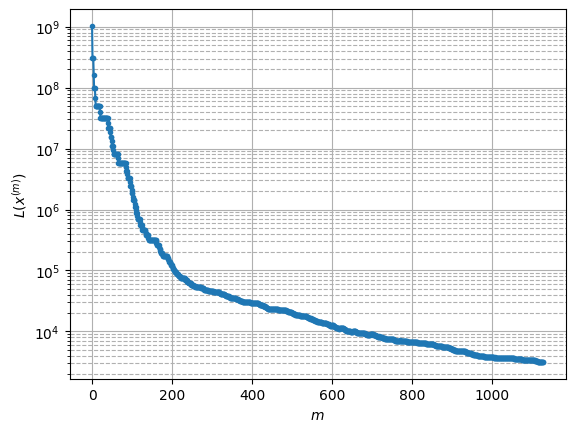

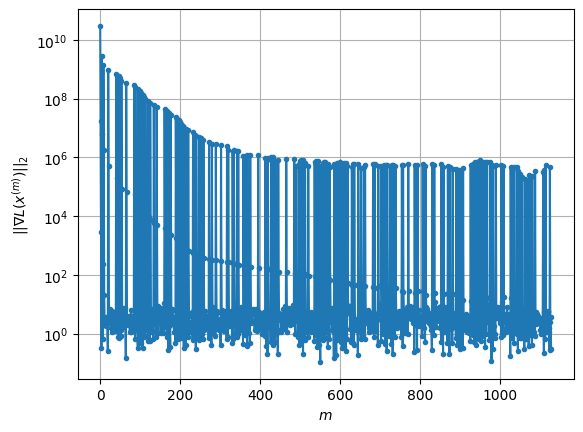

Windows:  23%|██▎       | 67/296 [48:09<1:04:18, 16.85s/it]


Majorization-Minimization Iteration 1
Before applying the algorithm
Cost function: 3151.0243685090754
Gradient norm: 440743.25973431894
Global relative error: 10.785761792439066
Position relative errors: 0.02885823018266331 m, 3.319577029876403 m, 3.411946927520152 m, 9.677943119152408 m

Iteration 1
Cost function: 3126.1597044671257 (-0.79%)
Gradient norm: 7.767639421015132 (-100.00%)
Global relative error = 10.798117155489155 (0.11%)
Position relative errors: 0.030255967694054742 m, 3.3483453849150964 m, 3.342992048697886 m, 9.705833283654295 m

Iteration 2
Cost function: 3126.15970568035 (0.00%)
Gradient norm: 1.2850391632509417 (-83.46%)
Global relative error = 10.798117047840483 (-0.00%)
Position relative errors: 0.030255948583957703 m, 3.3483454427330086 m, 3.3429916287549784 m, 9.70583328864672 m

Iteration 3
Cost function: 3126.1597046070815 (-0.00%)
Gradient norm: 1.4143097524362005 (10.06%)
Global relative error = 10.798117046340641 (-0.00%)
Position relative errors: 0.03025

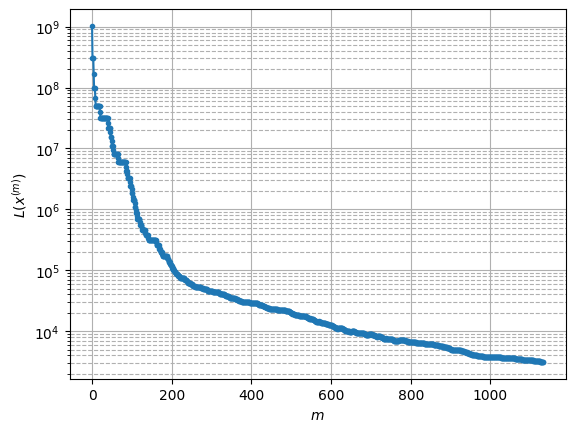

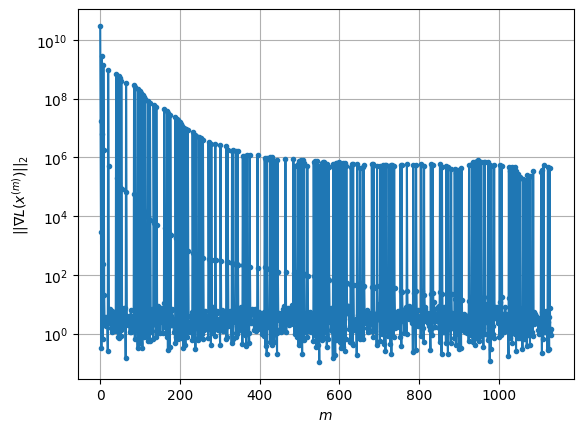

Windows:  23%|██▎       | 68/296 [48:22<59:30, 15.66s/it]  


Majorization-Minimization Iteration 1
Before applying the algorithm
Cost function: 3108.331790345616
Gradient norm: 423850.7589092945
Global relative error: 12.946071469053408
Position relative errors: 0.03194030310613619 m, 1.3967314922016647 m, 2.347263802012204 m, 12.654291594507892 m

Iteration 1
Cost function: 3084.120818676347 (-0.78%)
Gradient norm: 2.1854469008576203 (-100.00%)
Global relative error = 12.948083431512488 (0.02%)
Position relative errors: 0.029424442234842557 m, 1.425254250899347 m, 2.3243423610930987 m, 12.657408772707187 m

STOP on Iteration 2
Cost function = 3084.120816556419 (-0.00%)
Gradient norm = 0.38441651700068835 (-82.41%)
Global relative error = 12.948083380043718 (-0.00%)
Final position relative errors: 0.029424414248139862 m, 1.425254302829188 m, 2.3243423085670956 m, 12.657408723920604 m

Majorization-Minimization converged after 1 iterations


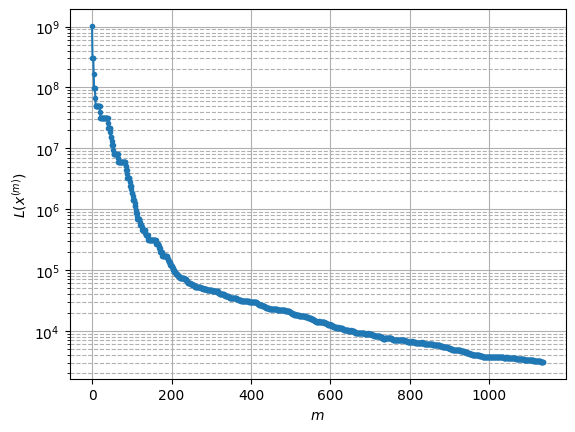

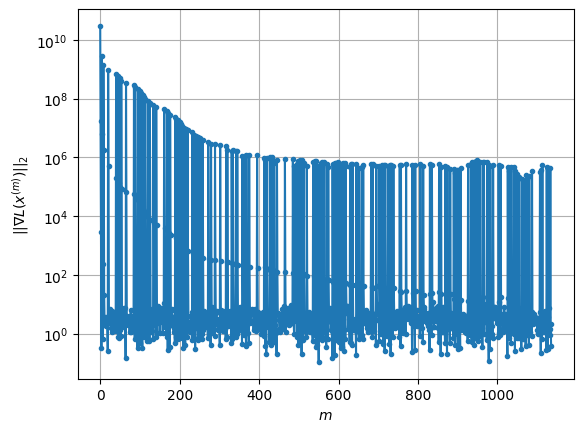

Windows:  23%|██▎       | 69/296 [48:30<50:30, 13.35s/it]


Majorization-Minimization Iteration 1
Before applying the algorithm
Cost function: 3091.7707865565917
Gradient norm: 516881.1062134406
Global relative error: 16.567654145017855
Position relative errors: 0.030670083485573322 m, 3.2370521419236695 m, 3.9769192757418055 m, 15.753852691930438 m

Iteration 1
Cost function: 3068.1879656382534 (-0.76%)
Gradient norm: 1.7588519895476449 (-100.00%)
Global relative error = 16.512326519523832 (-0.33%)
Position relative errors: 0.03001369305248773 m, 3.244624607772196 m, 3.9956200809276283 m, 15.689345447511096 m

Iteration 2
Cost function: 3068.187967324804 (0.00%)
Gradient norm: 2.254052117009692 (28.15%)
Global relative error = 16.512326540993588 (0.00%)
Position relative errors: 0.030013711876215536 m, 3.2446246387359805 m, 3.995620305816497 m, 15.689345406395862 m

Iteration 3
Cost function: 3068.1879659005317 (-0.00%)
Gradient norm: 1.2455784263149983 (-44.74%)
Global relative error = 16.512326540599922 (-0.00%)
Position relative errors: 0.

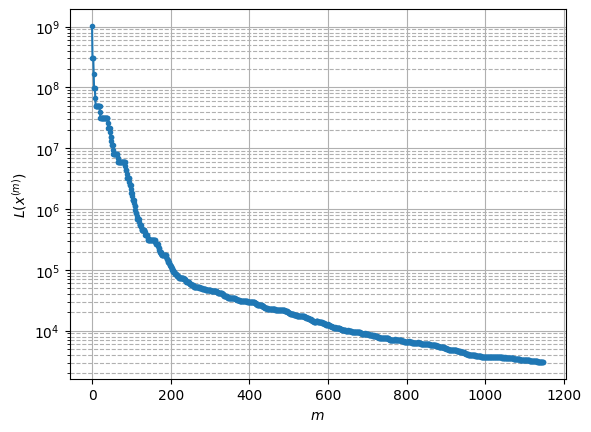

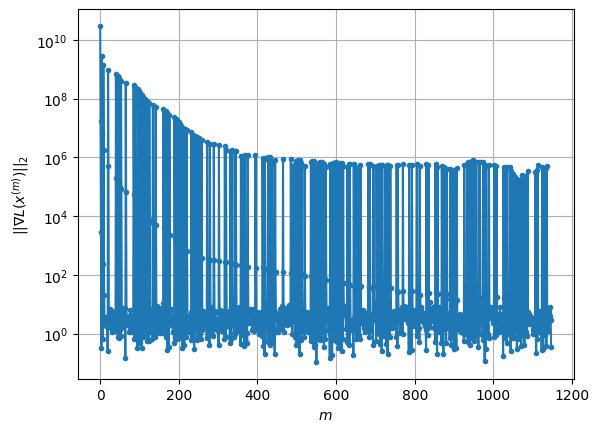

Windows:  24%|██▎       | 70/296 [48:59<1:08:55, 18.30s/it]


Majorization-Minimization Iteration 1
Before applying the algorithm
Cost function: 3047.705863068397
Gradient norm: 381094.5115893378
Global relative error: 20.800385249395017
Position relative errors: 0.03136488484685237 m, 6.038779746966028 m, 6.460596626382248 m, 18.82660804241431 m

Iteration 1
Cost function: 3026.3449759480472 (-0.70%)
Gradient norm: 6.337660219169561 (-100.00%)
Global relative error = 20.732346517618815 (-0.33%)
Position relative errors: 0.036726662974389694 m, 6.034355689428179 m, 6.45203417300229 m, 18.75577248278135 m

Iteration 2
Cost function: 3026.344977210129 (0.00%)
Gradient norm: 4.419535955603268 (-30.27%)
Global relative error = 20.732346501014845 (-0.00%)
Position relative errors: 0.03672667372733661 m, 6.034355675123866 m, 6.452034367682683 m, 18.755772402038684 m

STOP on Iteration 3
Cost function = 3026.3449783687374 (0.00%)
Gradient norm = 0.8914436342230774 (-79.83%)
Global relative error = 20.73234650121183 (0.00%)
Final position relative error

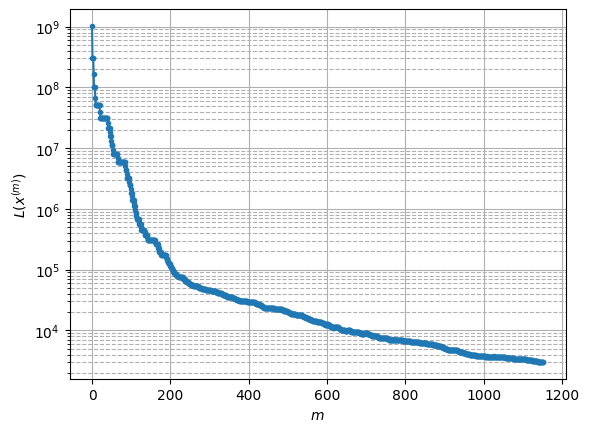

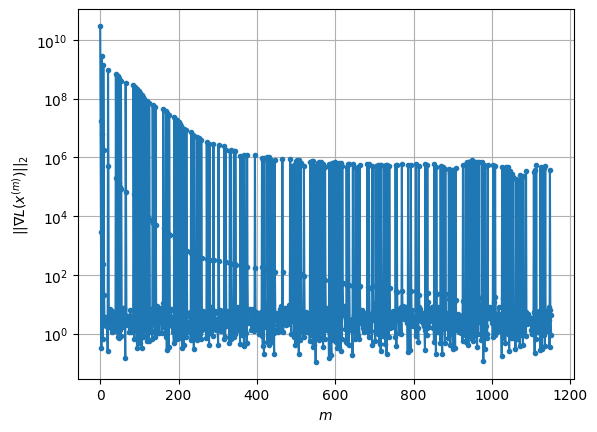

Windows:  24%|██▍       | 71/296 [49:10<59:43, 15.93s/it]  


Majorization-Minimization Iteration 1
Before applying the algorithm
Cost function: 3027.5523388973256
Gradient norm: 354734.2542277665
Global relative error: 25.285785998663837
Position relative errors: 0.03782884228502393 m, 8.907457079258151 m, 9.044721486730047 m, 21.86806736661924 m

Iteration 1
Cost function: 3007.276615059253 (-0.67%)
Gradient norm: 1.3876590566804925 (-100.00%)
Global relative error = 25.185147668910794 (-0.40%)
Position relative errors: 0.04064537656509996 m, 8.901988656810982 m, 9.022008312350582 m, 21.76328635293865 m

Iteration 2
Cost function: 3007.276614528756 (-0.00%)
Gradient norm: 1.2116853511802113 (-12.68%)
Global relative error = 25.18514765455359 (-0.00%)
Position relative errors: 0.040645388274740415 m, 8.901988634262967 m, 9.02200848742391 m, 21.763286272948577 m

STOP on Iteration 3
Cost function = 3007.276614728498 (0.00%)
Gradient norm = 0.48170633722996603 (-60.24%)
Global relative error = 25.18514765350239 (-0.00%)
Final position relative er

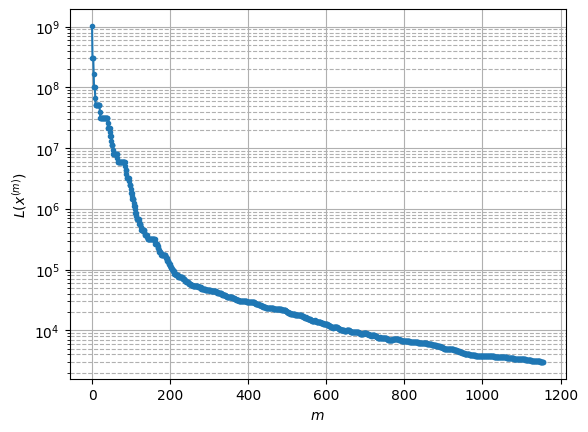

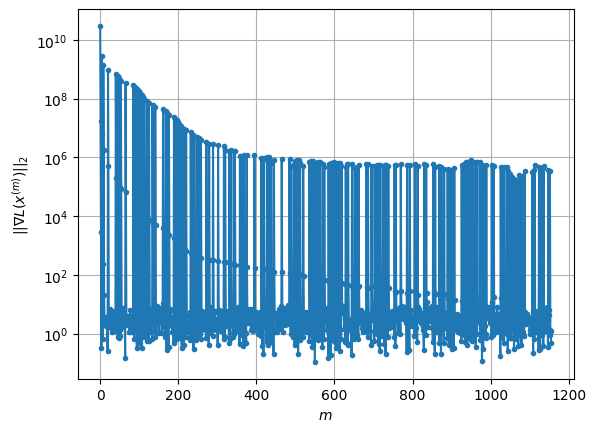

Windows:  24%|██▍       | 72/296 [49:23<56:25, 15.11s/it]


Majorization-Minimization Iteration 1
Before applying the algorithm
Cost function: 2995.068353456811
Gradient norm: 283441.63578223233
Global relative error: 29.816763877300453
Position relative errors: 0.04159160119853387 m, 11.761825752518941 m, 11.611453892277577 m, 24.816612159962233 m

Iteration 1
Cost function: 2976.995804371305 (-0.60%)
Gradient norm: 7.48381285540205 (-100.00%)
Global relative error = 29.69526209778727 (-0.41%)
Position relative errors: 0.04478315752965183 m, 11.75176104953538 m, 11.564667898348688 m, 24.697250240062147 m

STOP on Iteration 2
Cost function = 2976.9958070571984 (0.00%)
Gradient norm = 0.38589879330088056 (-94.84%)
Global relative error = 29.69526207498486 (-0.00%)
Final position relative errors: 0.04478316108720676 m, 11.751761021153289 m, 11.564668066539479 m, 24.69725014738765 m

Majorization-Minimization converged after 1 iterations


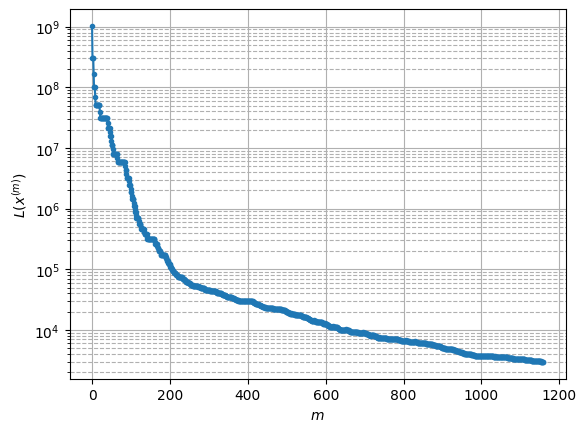

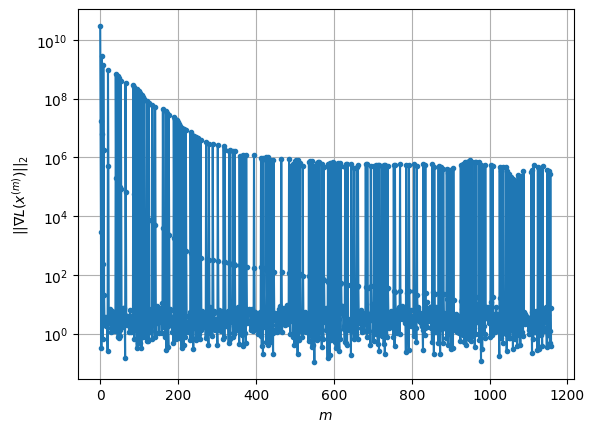

Windows:  25%|██▍       | 73/296 [49:31<48:10, 12.96s/it]


Majorization-Minimization Iteration 1
Before applying the algorithm
Cost function: 2967.471287011263
Gradient norm: 233066.69957472628
Global relative error: 34.303064666271226
Position relative errors: 0.045446867358309176 m, 14.569036125866429 m, 14.11003749379907 m, 27.664807646663704 m

Iteration 1
Cost function: 2949.9895338939377 (-0.59%)
Gradient norm: 2.6469766393196834 (-100.00%)
Global relative error = 34.159939151985654 (-0.42%)
Position relative errors: 0.04956604727715756 m, 14.556726268241453 m, 14.052464651853452 m, 27.52312412661348 m

Iteration 2
Cost function: 2949.989533561803 (-0.00%)
Gradient norm: 2.1577308387590834 (-18.48%)
Global relative error = 34.15993913951372 (-0.00%)
Position relative errors: 0.049566058943136614 m, 14.556726234939799 m, 14.05246481483457 m, 27.523124045513136 m

STOP on Iteration 3
Cost function = 2949.989532723894 (-0.00%)
Gradient norm = 0.8086310012181201 (-62.52%)
Global relative error = 34.159939138643956 (-0.00%)
Final position re

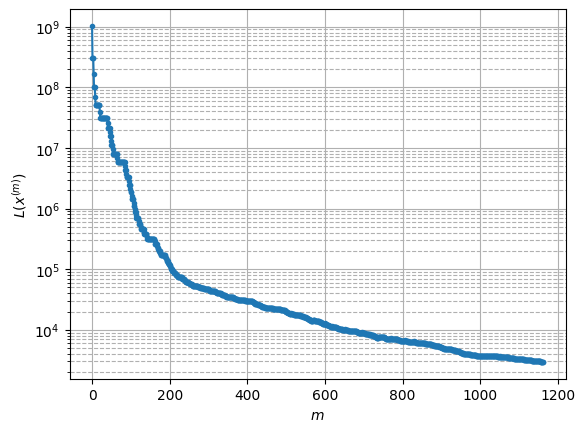

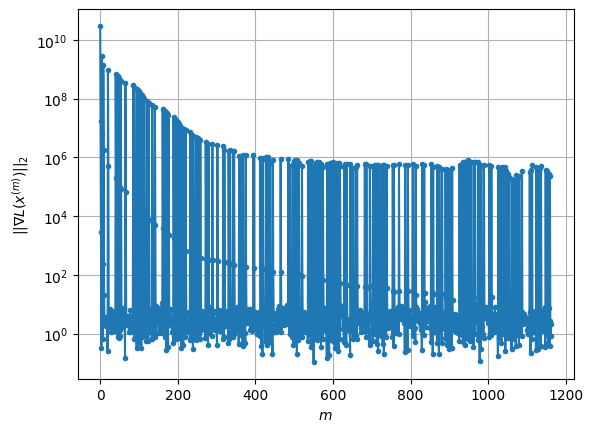

Windows:  25%|██▌       | 74/296 [49:41<44:58, 12.16s/it]


Majorization-Minimization Iteration 1
Before applying the algorithm
Cost function: 2947.6418314150487
Gradient norm: 271373.6612299821
Global relative error: 38.68229139160131
Position relative errors: 0.049619020421695754 m, 17.31286581783767 m, 16.530594638109914 m, 30.38610113371338 m

Iteration 1
Cost function: 2930.0916296918535 (-0.60%)
Gradient norm: 6.6870421072626876 (-100.00%)
Global relative error = 38.52180658919291 (-0.41%)
Position relative errors: 0.05180588306310632 m, 17.30324551546297 m, 16.461201471512158 m, 30.224944978459447 m

Iteration 2
Cost function: 2930.0916300584163 (0.00%)
Gradient norm: 4.347083859443712 (-34.99%)
Global relative error = 38.52180656641322 (-0.00%)
Position relative errors: 0.051805886590792154 m, 17.30324548094429 m, 16.461201635614167 m, 30.224944879808373 m

Iteration 3
Cost function: 2930.0916290091513 (-0.00%)
Gradient norm: 1.2683744052990755 (-70.82%)
Global relative error = 38.52180656613801 (-0.00%)
Position relative errors: 0.051

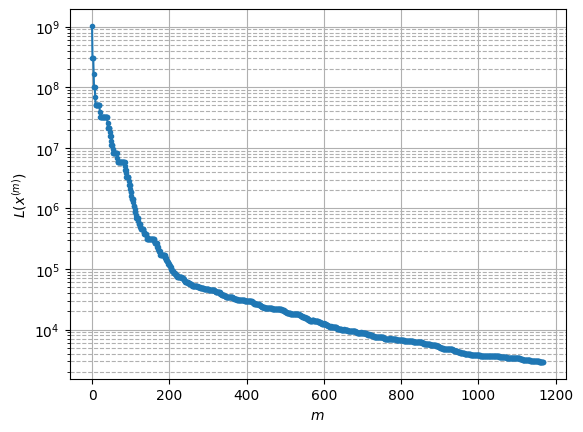

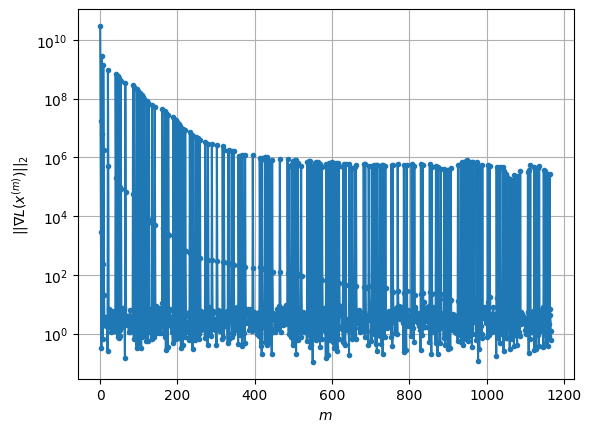

Windows:  25%|██▌       | 75/296 [49:54<45:22, 12.32s/it]


Majorization-Minimization Iteration 1
Before applying the algorithm
Cost function: 2897.0358658495775
Gradient norm: 270512.22413096076
Global relative error: 42.91579572083854
Position relative errors: 0.051577392516767226 m, 19.9834547892015 m, 18.857663861154045 m, 32.966759095137995 m

Iteration 1
Cost function: 2880.190976664261 (-0.58%)
Gradient norm: 2.046165550890654 (-100.00%)
Global relative error = 42.74535018177497 (-0.40%)
Position relative errors: 0.04166122739634519 m, 19.96805109173006 m, 18.787573674343847 m, 32.794230719332376 m

Iteration 2
Cost function: 2880.1909772268496 (0.00%)
Gradient norm: 2.662691971758038 (30.13%)
Global relative error = 42.74535015944129 (-0.00%)
Position relative errors: 0.04166122557804316 m, 19.96805105751876 m, 18.7875738164267 m, 32.79423062965697 m

STOP on Iteration 3
Cost function = 2880.1909771739925 (-0.00%)
Gradient norm = 0.9067794796804163 (-65.95%)
Global relative error = 42.74535016099066 (0.00%)
Final position relative erro

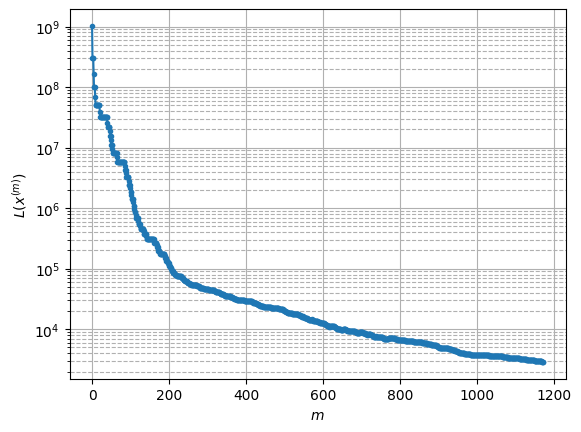

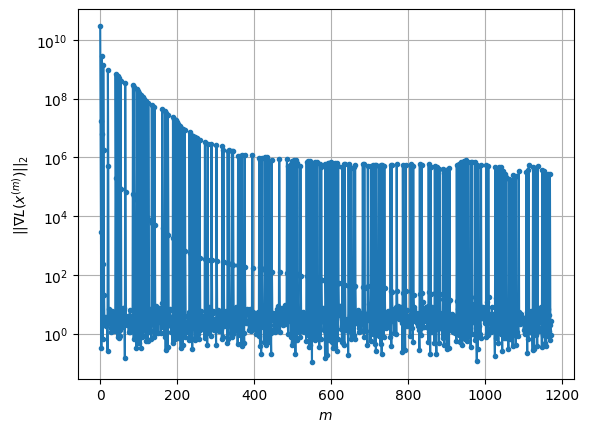

Windows:  26%|██▌       | 76/296 [50:04<42:45, 11.66s/it]


Majorization-Minimization Iteration 1
Before applying the algorithm
Cost function: 2879.685048891475
Gradient norm: 343111.8830979139
Global relative error: 46.97791007151039
Position relative errors: 0.04148245714233143 m, 22.55995255574816 m, 21.09036342287898 m, 35.40003133936593 m

Iteration 1
Cost function: 2862.6458001310307 (-0.59%)
Gradient norm: 2.084146577937819 (-100.00%)
Global relative error = 46.79081988501922 (-0.40%)
Position relative errors: 0.03500198522984637 m, 22.540030390886802 m, 21.016595910814345 m, 35.208296651743986 m

Iteration 2
Cost function: 2862.6458006648127 (0.00%)
Gradient norm: 2.7579545004810804 (32.33%)
Global relative error = 46.790819891352314 (0.00%)
Position relative errors: 0.03500197484738715 m, 22.540030350270072 m, 21.01659607100725 m, 35.20829659055081 m

Iteration 3
Cost function: 2862.645799642389 (-0.00%)
Gradient norm: 2.1049144532587 (-23.68%)
Global relative error = 46.79081989096034 (-0.00%)
Position relative errors: 0.035001975065

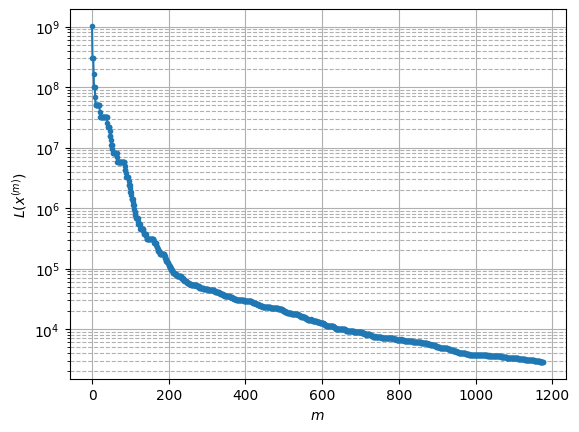

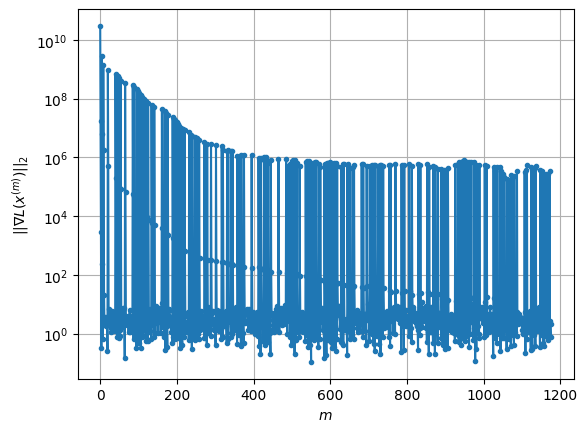

Windows:  26%|██▌       | 77/296 [50:17<43:45, 11.99s/it]


Majorization-Minimization Iteration 1
Before applying the algorithm
Cost function: 2816.439841742654
Gradient norm: 297141.0640459677
Global relative error: 50.836082177404656
Position relative errors: 0.035065284006626035 m, 25.03201672732019 m, 23.2151900793536 m, 37.666356574918474 m

Iteration 1
Cost function: 2799.867517463178 (-0.59%)
Gradient norm: 2.8344262146843677 (-100.00%)
Global relative error = 50.64391738902934 (-0.38%)
Position relative errors: 0.03495028365217296 m, 25.0101120947234 m, 23.13922661799542 m, 37.46826615007453 m

STOP on Iteration 2
Cost function = 2799.8675161863307 (-0.00%)
Gradient norm = 0.4552234966420533 (-83.94%)
Global relative error = 50.64391741069794 (0.00%)
Final position relative errors: 0.03495027502348944 m, 25.010112051273886 m, 23.1392267678123 m, 37.468266115851435 m

Majorization-Minimization converged after 1 iterations


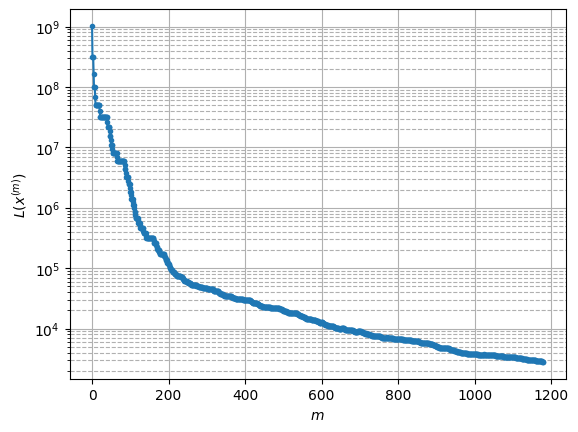

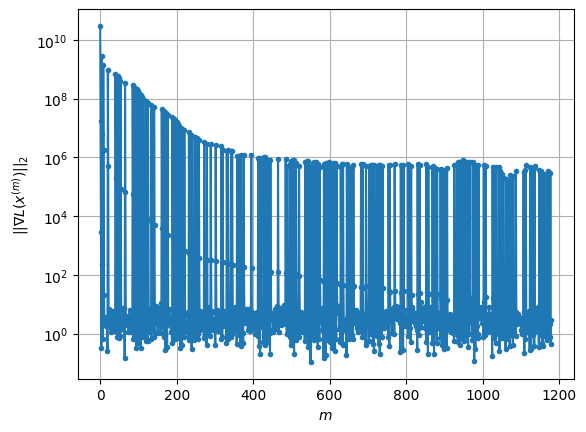

Windows:  26%|██▋       | 78/296 [50:25<39:08, 10.77s/it]


Majorization-Minimization Iteration 1
Before applying the algorithm
Cost function: 2763.8404286402338
Gradient norm: 336794.4200312129
Global relative error: 54.47897106854916
Position relative errors: 0.03495941354111567 m, 27.39103574048921 m, 25.224802332195466 m, 39.7667374023071 m

Iteration 1
Cost function: 2748.498302549216 (-0.56%)
Gradient norm: 1.8982640102135435 (-100.00%)
Global relative error = 54.281307422598275 (-0.36%)
Position relative errors: 0.0353637901120372 m, 27.3649513607448 m, 25.14384809848565 m, 39.56515232382572 m

STOP on Iteration 2
Cost function = 2748.49830275207 (0.00%)
Gradient norm = 0.5387378185287721 (-71.62%)
Global relative error = 54.28130741569299 (-0.00%)
Final position relative errors: 0.03536378800932941 m, 27.364951322302034 m, 25.14384822289773 m, 39.565152261878296 m

Majorization-Minimization converged after 1 iterations


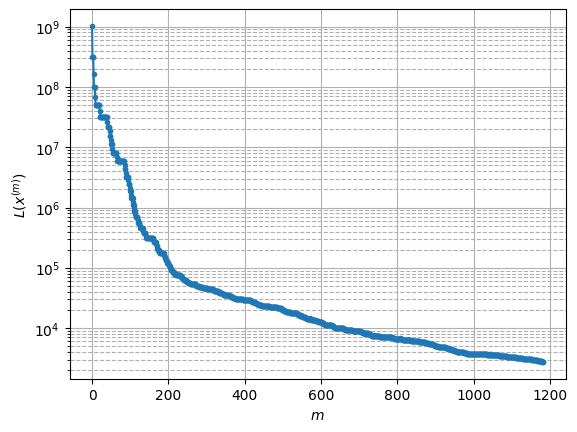

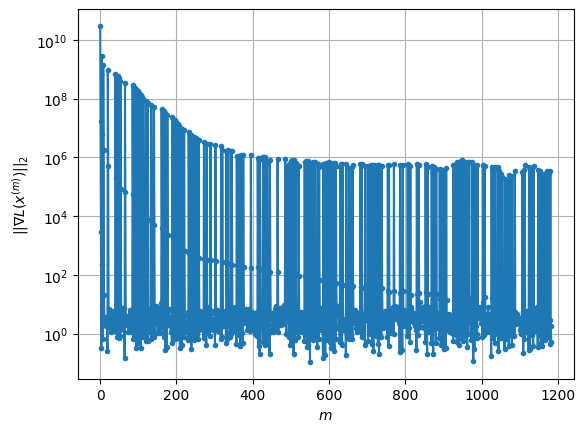

Windows:  27%|██▋       | 79/296 [50:33<35:56,  9.94s/it]


Majorization-Minimization Iteration 1
Before applying the algorithm
Cost function: 2682.918507122496
Gradient norm: 282529.3093359427
Global relative error: 57.88646894238432
Position relative errors: 0.03509901309253449 m, 29.62475285002629 m, 27.10928452211924 m, 41.69291442942164 m

Iteration 1
Cost function: 2668.2310927934027 (-0.55%)
Gradient norm: 3.8220538385458322 (-100.00%)
Global relative error = 57.683836777790816 (-0.35%)
Position relative errors: 0.03258992949464834 m, 29.593727393827805 m, 27.030131491633547 m, 41.4849806940628 m

STOP on Iteration 2
Cost function = 2668.2310943152165 (0.00%)
Gradient norm = 0.9476217322738792 (-75.21%)
Global relative error = 57.6838367816803 (0.00%)
Final position relative errors: 0.03258992554483209 m, 29.59372735657416 m, 27.030131578290177 m, 41.484980669587195 m

Majorization-Minimization converged after 1 iterations


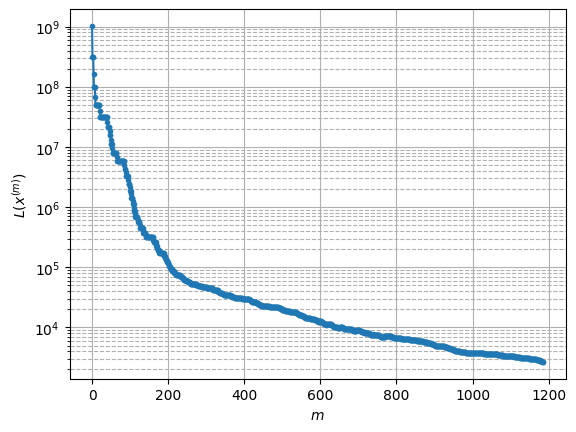

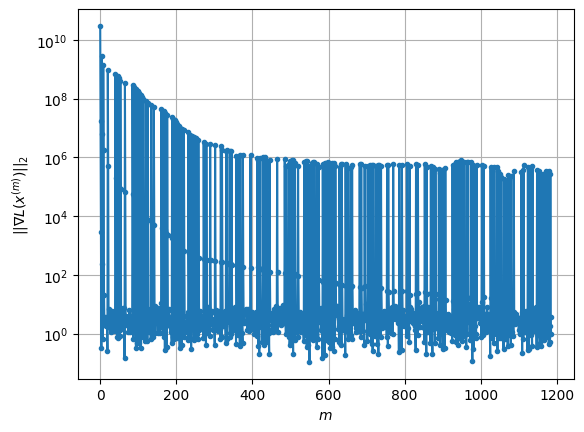

Windows:  27%|██▋       | 80/296 [50:41<33:28,  9.30s/it]


Majorization-Minimization Iteration 1
Before applying the algorithm
Cost function: 2594.503175677933
Gradient norm: 310319.12264155113
Global relative error: 61.04217761977002
Position relative errors: 0.0324283332843908 m, 31.722980704227776 m, 28.868052147453984 m, 43.4330670626072 m

Iteration 1
Cost function: 2581.489991684294 (-0.50%)
Gradient norm: 3.1391173566298503 (-100.00%)
Global relative error = 60.833889254654935 (-0.34%)
Position relative errors: 0.03475452844069016 m, 31.68635096862811 m, 28.7831502797035 m, 43.22341000374348 m

Iteration 2
Cost function: 2581.489992648616 (0.00%)
Gradient norm: 1.119222197372765 (-64.35%)
Global relative error = 60.83388929862431 (0.00%)
Position relative errors: 0.03475452368921179 m, 31.686350927256814 m, 28.78315036734827 m, 43.223410037595784 m

Iteration 3
Cost function: 2581.489991180203 (-0.00%)
Gradient norm: 2.2577850770430112 (101.73%)
Global relative error = 60.8338892984896 (-0.00%)
Position relative errors: 0.0347545240688

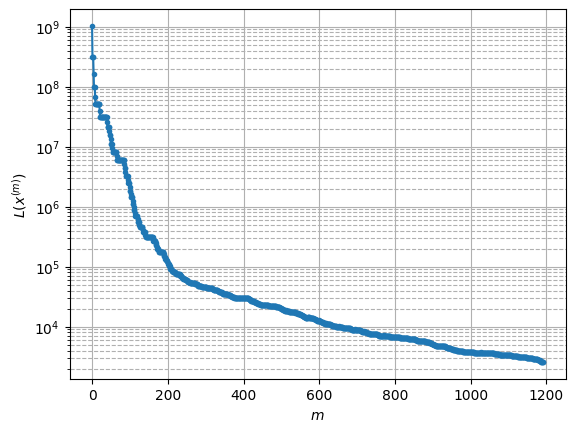

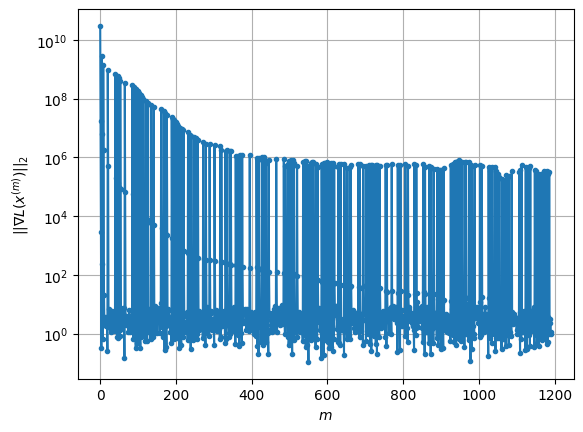

Windows:  27%|██▋       | 81/296 [50:55<39:15, 10.95s/it]


Majorization-Minimization Iteration 1
Before applying the algorithm
Cost function: 2522.2443503875475
Gradient norm: 349994.89724683494
Global relative error: 63.93065275541014
Position relative errors: 0.03446512341929171 m, 33.67606813542792 m, 30.487909422530706 m, 44.98371190848997 m

Iteration 1
Cost function: 2508.945269080981 (-0.53%)
Gradient norm: 1.9153303078391721 (-100.00%)
Global relative error = 63.71896512195543 (-0.33%)
Position relative errors: 0.036797468088111435 m, 33.63718197532019 m, 30.398293695305274 m, 44.77260610050621 m

Iteration 2
Cost function: 2508.945268817405 (-0.00%)
Gradient norm: 4.462785724383815 (133.00%)
Global relative error = 63.71896523868271 (0.00%)
Position relative errors: 0.036797462273397114 m, 33.63718194585033 m, 30.39829378760598 m, 44.772606226106596 m

STOP on Iteration 3
Cost function = 2508.9452688033243 (-0.00%)
Gradient norm = 0.8153626154490685 (-81.73%)
Global relative error = 63.71896523856327 (-0.00%)
Final position relative 

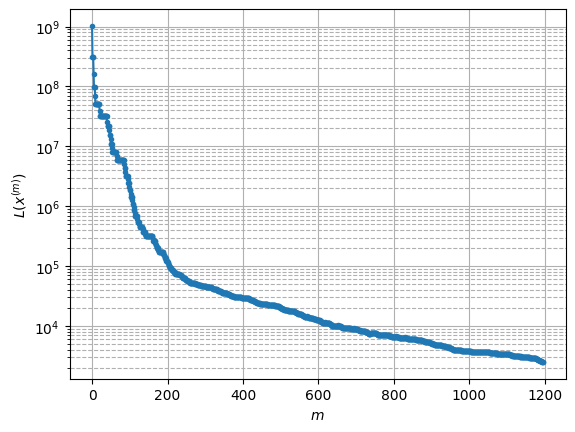

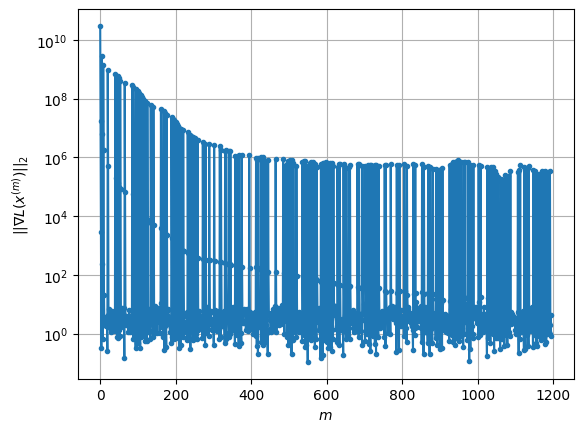

Windows:  28%|██▊       | 82/296 [51:06<38:25, 10.77s/it]


Majorization-Minimization Iteration 1
Before applying the algorithm
Cost function: 2434.087612473509
Gradient norm: 329418.8226935594
Global relative error: 66.54064383648553
Position relative errors: 0.036272449013107076 m, 35.4787978854128 m, 31.96366244658497 m, 46.33824518017466 m

Iteration 1
Cost function: 2422.2606492572254 (-0.49%)
Gradient norm: 2.486176960626379 (-100.00%)
Global relative error = 66.32767895277048 (-0.32%)
Position relative errors: 0.034479675647910046 m, 35.435268200142524 m, 31.86802381877525 m, 46.131642742665036 m

Iteration 2
Cost function: 2422.2606490750068 (-0.00%)
Gradient norm: 3.083973631139638 (24.04%)
Global relative error = 66.32767905474158 (0.00%)
Position relative errors: 0.03447967070854818 m, 35.43526818529243 m, 31.86802386483336 m, 46.131642868871566 m

Iteration 3
Cost function: 2422.260649821916 (0.00%)
Gradient norm: 2.5796137597879842 (-16.35%)
Global relative error = 66.32767905409702 (-0.00%)
Position relative errors: 0.03447967038

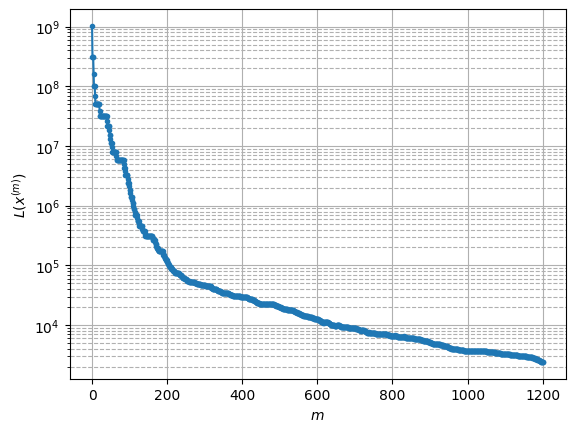

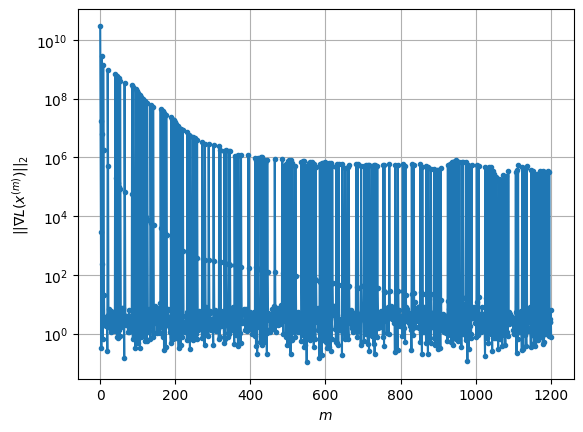

Windows:  28%|██▊       | 83/296 [51:21<42:54, 12.09s/it]


Majorization-Minimization Iteration 1
Before applying the algorithm
Cost function: 2362.142728897952
Gradient norm: 505519.1911349741
Global relative error: 68.86239394433589
Position relative errors: 0.03383506795858975 m, 37.12131925553163 m, 33.28918411306704 m, 47.495939654071336 m

Iteration 1
Cost function: 2350.4739529954663 (-0.49%)
Gradient norm: 5.286289719613006 (-100.00%)
Global relative error = 68.64541775455017 (-0.32%)
Position relative errors: 0.0337851102336631 m, 37.07302689477748 m, 33.18159290795297 m, 47.29442957991305 m

Iteration 2
Cost function: 2350.473952971888 (-0.00%)
Gradient norm: 1.8211859722513108 (-65.55%)
Global relative error = 68.64541788699633 (0.00%)
Position relative errors: 0.03378510221503582 m, 37.07302687673467 m, 33.181592926964285 m, 47.29442977296262 m

Iteration 3
Cost function: 2350.473952879404 (-0.00%)
Gradient norm: 3.066490705348494 (68.38%)
Global relative error = 68.64541788723233 (0.00%)
Position relative errors: 0.033785101292429

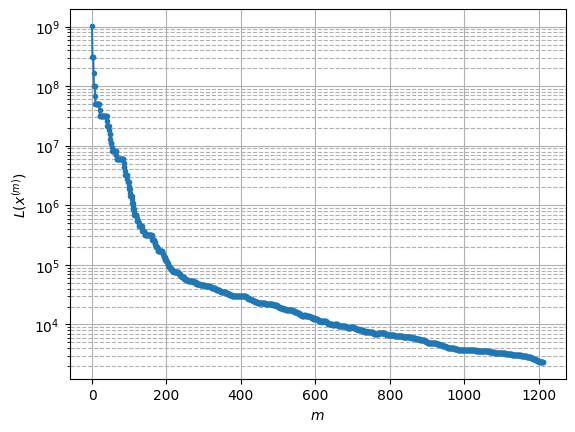

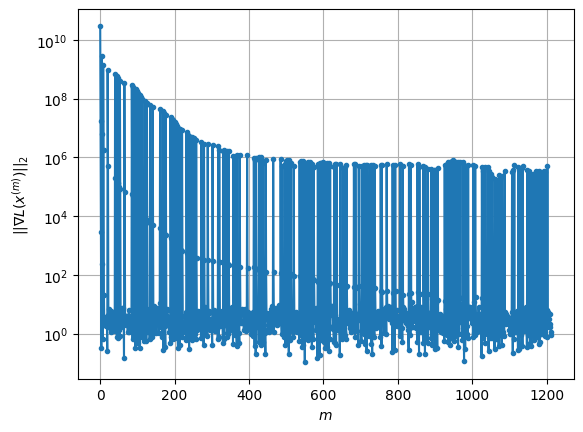

Windows:  28%|██▊       | 84/296 [51:48<58:56, 16.68s/it]


Majorization-Minimization Iteration 1
Before applying the algorithm
Cost function: 2290.0674993826206
Gradient norm: 373317.71817534696
Global relative error: 70.88311839647004
Position relative errors: 0.03327706939099677 m, 38.59618089598689 m, 34.45482334066552 m, 48.45218242586296 m

Iteration 1
Cost function: 2278.256985659381 (-0.52%)
Gradient norm: 1.9862131946753132 (-100.00%)
Global relative error = 70.66657912158688 (-0.31%)
Position relative errors: 0.03730382472093459 m, 38.546552234226844 m, 34.337705556028844 m, 48.25813877775717 m

STOP on Iteration 2
Cost function = 2278.256986302572 (0.00%)
Gradient norm = 0.1539250655965534 (-92.25%)
Global relative error = 70.6665792952573 (0.00%)
Final position relative errors: 0.03730380644837891 m, 38.546552216942075 m, 34.33770557612805 m, 48.258139031589664 m

Majorization-Minimization converged after 1 iterations


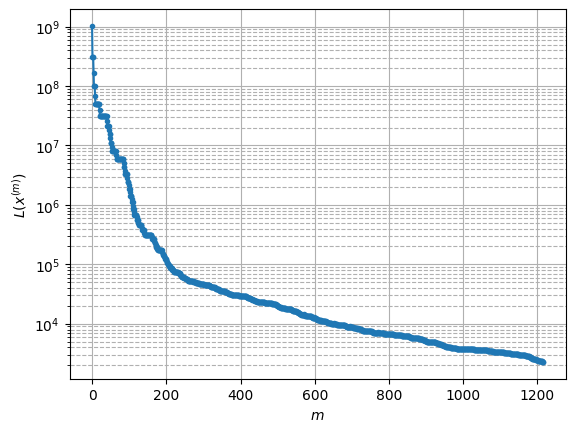

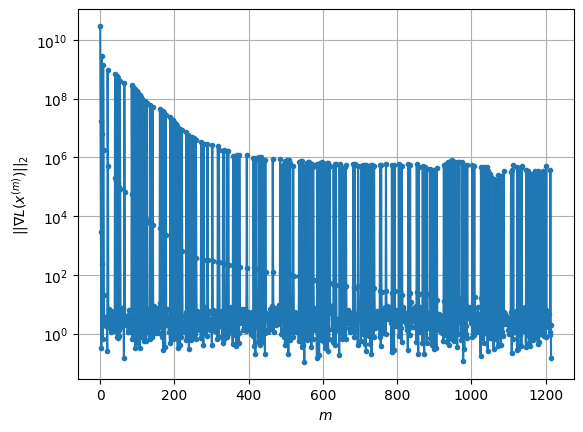

Windows:  29%|██▊       | 85/296 [51:56<49:16, 14.01s/it]


Majorization-Minimization Iteration 1
Before applying the algorithm
Cost function: 2221.1217001116543
Gradient norm: 331518.9211919376
Global relative error: 72.59828466380897
Position relative errors: 0.0367956955220105 m, 39.90020761511874 m, 35.45908474783934 m, 49.20503349206058 m

Iteration 1
Cost function: 2209.1726577945005 (-0.54%)
Gradient norm: 2.468301721031411 (-100.00%)
Global relative error = 72.38397736894373 (-0.30%)
Position relative errors: 0.04538988593359036 m, 39.84779627693319 m, 35.336382139510356 m, 49.01969354028184 m

Iteration 2
Cost function: 2209.1726574163845 (-0.00%)
Gradient norm: 1.4941432060264557 (-39.47%)
Global relative error = 72.38397754832701 (0.00%)
Position relative errors: 0.04538987112725072 m, 39.847796271602725 m, 35.33638212955434 m, 49.01969381668839 m

Iteration 3
Cost function: 2209.1726577145605 (0.00%)
Gradient norm: 1.451862816369051 (-2.83%)
Global relative error = 72.38397754889975 (0.00%)
Position relative errors: 0.0453898717991

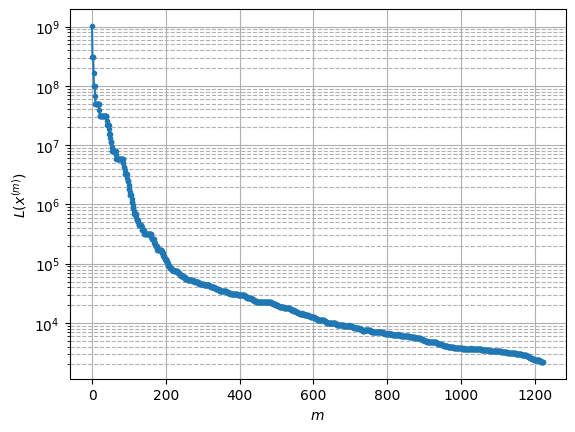

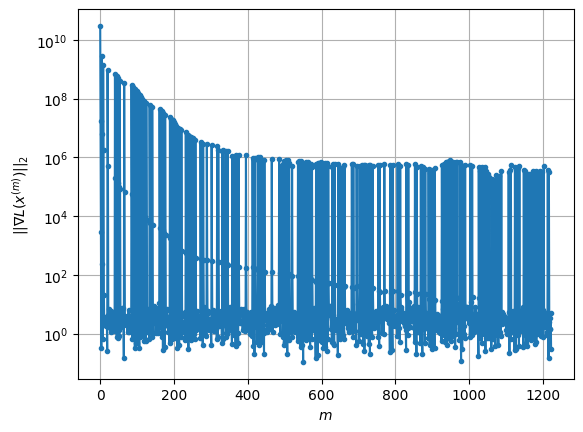

Windows:  29%|██▉       | 86/296 [52:13<52:35, 15.03s/it]


Majorization-Minimization Iteration 1
Before applying the algorithm
Cost function: 2162.6222670106667
Gradient norm: 352110.2600322954
Global relative error: 74.00206357944406
Position relative errors: 0.044752008236479186 m, 41.02665406634193 m, 36.301939065546094 m, 49.75224201426125 m

Iteration 1
Cost function: 2151.579736154123 (-0.51%)
Gradient norm: 1.5508137803476507 (-100.00%)
Global relative error = 73.7893926221913 (-0.29%)
Position relative errors: 0.050412198642677 m, 40.97028858091603 m, 36.17016530144419 m, 49.57848144953064 m

Iteration 2
Cost function: 2151.5797361129926 (-0.00%)
Gradient norm: 1.8896895207598072 (21.85%)
Global relative error = 73.78939277016019 (0.00%)
Position relative errors: 0.05041218140487213 m, 40.97028859797152 m, 36.1701652636101 m, 49.57848168328328 m

STOP on Iteration 3
Cost function = 2151.579736273745 (0.00%)
Gradient norm = 0.4062896907768419 (-78.50%)
Global relative error = 73.78939277024286 (0.00%)
Final position relative errors: 0.

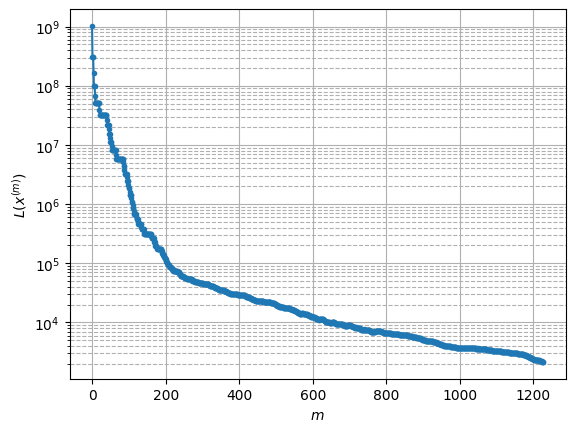

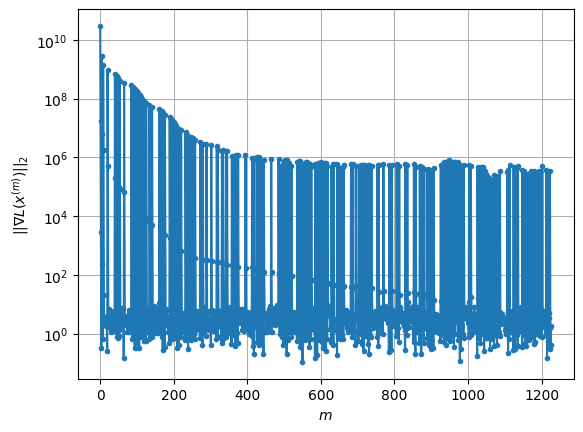

Windows:  29%|██▉       | 87/296 [52:24<47:33, 13.65s/it]


Majorization-Minimization Iteration 1
Before applying the algorithm
Cost function: 2124.377550013268
Gradient norm: 433588.2775569295
Global relative error: 75.0879602103188
Position relative errors: 0.04962499020197957 m, 41.96989439483219 m, 36.97725738576825 m, 50.09400413434841 m

Iteration 1
Cost function: 2114.008451401131 (-0.49%)
Gradient norm: 1.60173861163 (-100.00%)
Global relative error = 74.87822850370029 (-0.28%)
Position relative errors: 0.042776103009197215 m, 41.90904902954109 m, 36.84140657066413 m, 49.93084411962933 m

Iteration 2
Cost function: 2114.008450694852 (-0.00%)
Gradient norm: 3.6842339726675584 (130.01%)
Global relative error = 74.87822858654953 (0.00%)
Position relative errors: 0.04277610093554746 m, 41.909049030974245 m, 36.84140646628977 m, 49.93084431968459 m

Iteration 3
Cost function: 2114.008450112369 (-0.00%)
Gradient norm: 3.9524074740138664 (7.28%)
Global relative error = 74.87822858688912 (0.00%)
Position relative errors: 0.04277609581421566 m,

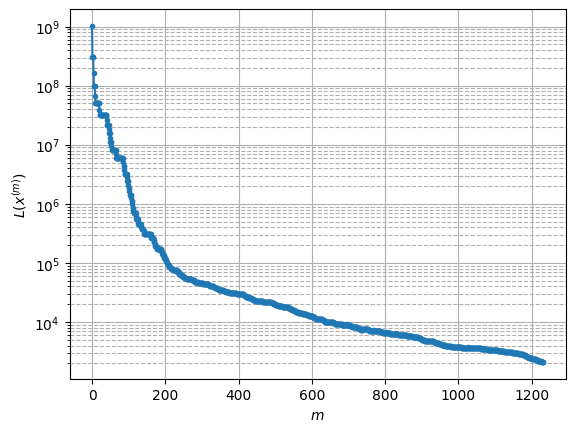

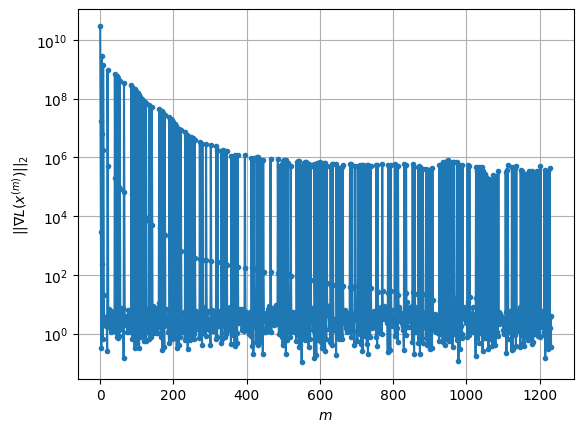

Windows:  30%|██▉       | 88/296 [52:37<46:41, 13.47s/it]


Majorization-Minimization Iteration 1
Before applying the algorithm
Cost function: 2047.036855860881
Gradient norm: 321150.6515336153
Global relative error: 75.85262610401219
Position relative errors: 0.042345919861256624 m, 42.725453996347305 m, 37.4874953574378 m, 50.22790157957344 m

Iteration 1
Cost function: 2034.6628426625991 (-0.60%)
Gradient norm: 3.136947429194645 (-100.00%)
Global relative error = 75.64948683856633 (-0.27%)
Position relative errors: 0.04926714692145002 m, 42.662187594153956 m, 37.35161316709031 m, 50.076310869784095 m

Iteration 2
Cost function: 2034.662842575881 (-0.00%)
Gradient norm: 3.489502632456146 (11.24%)
Global relative error = 75.64948700259676 (0.00%)
Position relative errors: 0.04926712674125576 m, 42.66218760854823 m, 37.35161311877685 m, 50.076311141375704 m

STOP on Iteration 3
Cost function = 2034.6628425995111 (0.00%)
Gradient norm = 0.6503418476530973 (-81.36%)
Global relative error = 75.64948700237191 (-0.00%)
Final position relative error

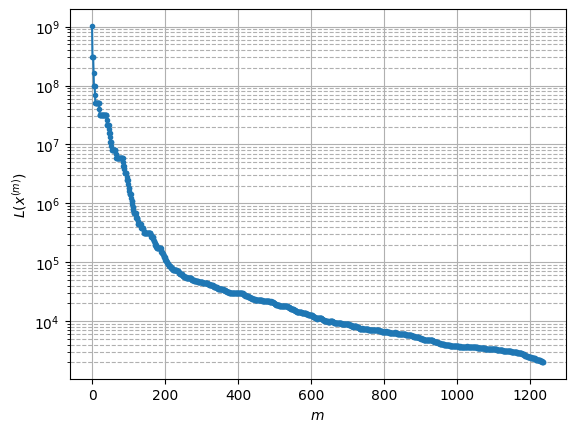

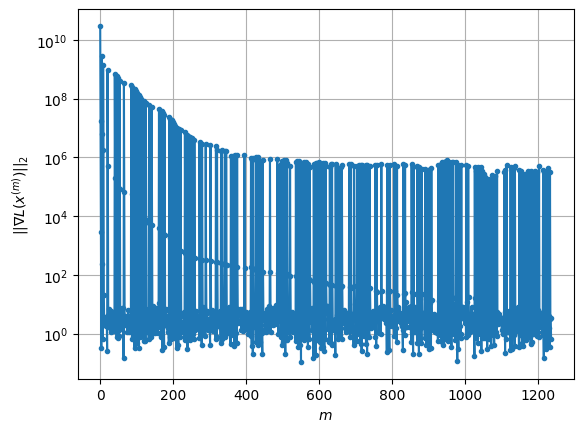

Windows:  30%|███       | 89/296 [52:48<43:36, 12.64s/it]


Majorization-Minimization Iteration 1
Before applying the algorithm
Cost function: 1996.1910715073286
Gradient norm: 491276.1367533339
Global relative error: 76.2964231007997
Position relative errors: 0.048905365876880526 m, 43.292018733102225 m, 37.8342264237493 m, 50.15490074168357 m

Iteration 1
Cost function: 1984.5205118815104 (-0.58%)
Gradient norm: 6.822513638941636 (-100.00%)
Global relative error = 76.09927621048979 (-0.26%)
Position relative errors: 0.047250197785410876 m, 43.22674748553487 m, 37.69473456962447 m, 50.01652482358589 m

Iteration 2
Cost function: 1984.5205119886293 (0.00%)
Gradient norm: 7.271413358314479 (6.58%)
Global relative error = 76.09927629411959 (0.00%)
Position relative errors: 0.04725019784064266 m, 43.22674749712859 m, 37.694734431879375 m, 50.01652504461827 m

Iteration 3
Cost function: 1984.5205117655555 (-0.00%)
Gradient norm: 1.1533320867035333 (-84.14%)
Global relative error = 76.09927629387163 (-0.00%)
Position relative errors: 0.047250194124

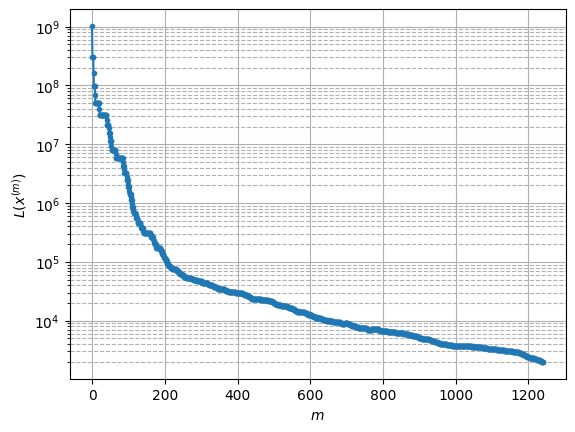

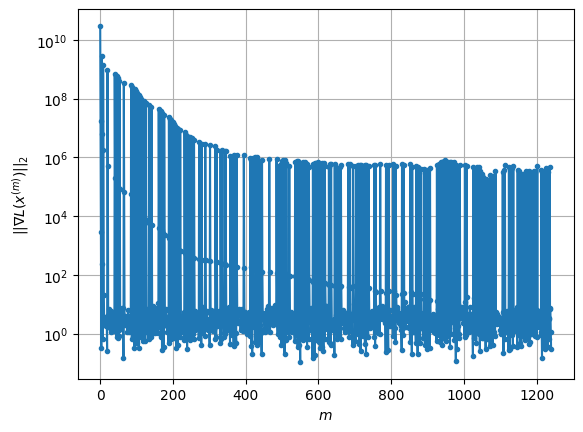

Windows:  30%|███       | 90/296 [53:01<44:30, 12.96s/it]


Majorization-Minimization Iteration 1
Before applying the algorithm
Cost function: 1946.6591119060465
Gradient norm: 236323.08964634163
Global relative error: 76.41726982826921
Position relative errors: 0.047219096203745446 m, 43.6676727311298 m, 38.01300303131044 m, 49.877277179265874 m

Iteration 1
Cost function: 1935.450582073641 (-0.58%)
Gradient norm: 5.322874332453983 (-100.00%)
Global relative error = 76.22807157901636 (-0.25%)
Position relative errors: 0.05344399810870447 m, 43.60084510229811 m, 37.87763070787166 m, 49.74904384038439 m

Iteration 2
Cost function: 1935.45058244882 (0.00%)
Gradient norm: 6.577532516661999 (23.57%)
Global relative error = 76.22807164751332 (0.00%)
Position relative errors: 0.05344398919237623 m, 43.600845116190655 m, 37.8776305764287 m, 49.74904403325018 m

Iteration 3
Cost function: 1935.4505823800075 (-0.00%)
Gradient norm: 1.0620490966137013 (-83.85%)
Global relative error = 76.22807164818566 (0.00%)
Position relative errors: 0.053443985433329

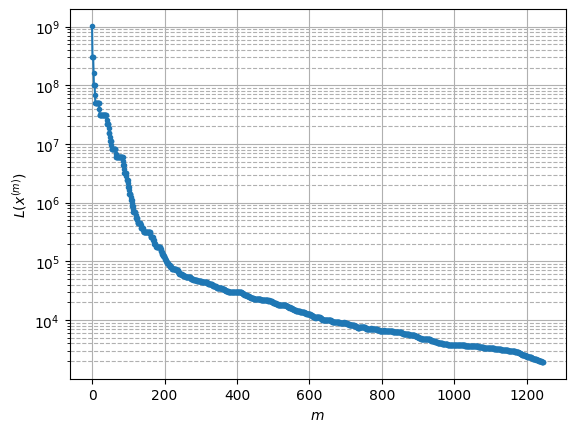

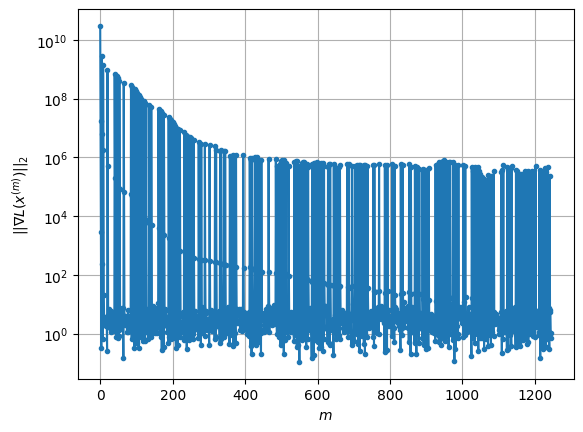

Windows:  31%|███       | 91/296 [53:16<46:21, 13.57s/it]


Majorization-Minimization Iteration 1
Before applying the algorithm
Cost function: 1915.9312388897247
Gradient norm: 281196.27419707365
Global relative error: 76.21685679536832
Position relative errors: 0.053183380289046685 m, 43.85134779814645 m, 38.030504909019086 m, 49.39378855294457 m

Iteration 1
Cost function: 1904.5801606591972 (-0.59%)
Gradient norm: 1.446130170593451 (-100.00%)
Global relative error = 76.03437571968581 (-0.24%)
Position relative errors: 0.05060157820595532 m, 43.78419750706114 m, 37.894946710231636 m, 49.27616786085322 m

STOP on Iteration 2
Cost function = 1904.5801607176263 (0.00%)
Gradient norm = 0.39870403472379073 (-72.43%)
Global relative error = 76.03437575049594 (0.00%)
Final position relative errors: 0.050601572166324674 m, 43.78419750076574 m, 37.89494656393981 m, 49.27616802649707 m

Majorization-Minimization converged after 1 iterations


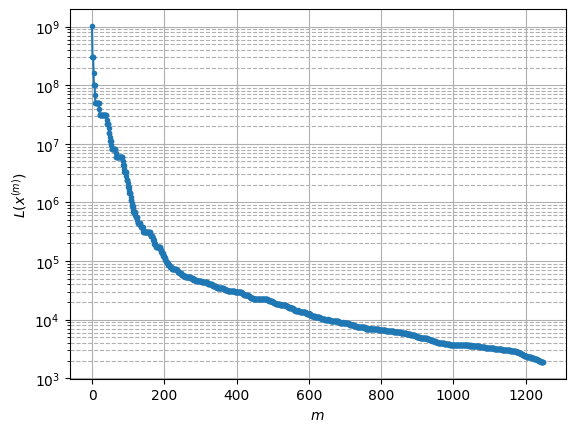

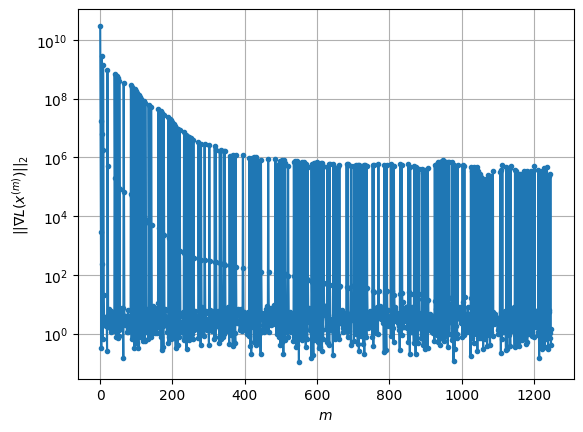

Windows:  31%|███       | 92/296 [53:24<40:24, 11.89s/it]


Majorization-Minimization Iteration 1
Before applying the algorithm
Cost function: 1877.9556550770924
Gradient norm: 219305.5163795446
Global relative error: 75.69538906750817
Position relative errors: 0.050285648080540424 m, 43.8432799315701 m, 37.882913478157676 m, 48.70770917431524 m

Iteration 1
Cost function: 1866.139224754048 (-0.63%)
Gradient norm: 1.6472418857678062 (-100.00%)
Global relative error = 75.52082071118852 (-0.23%)
Position relative errors: 0.05357391350835716 m, 43.774894463822 m, 37.7507194791662 m, 48.6007525752516 m

STOP on Iteration 2
Cost function = 1866.1392243147507 (-0.00%)
Gradient norm = 0.3701477092122577 (-77.53%)
Global relative error = 75.52082075169825 (0.00%)
Final position relative errors: 0.05357389907705759 m, 43.774894490006865 m, 37.7507193390426 m, 48.600752723472134 m

Majorization-Minimization converged after 1 iterations


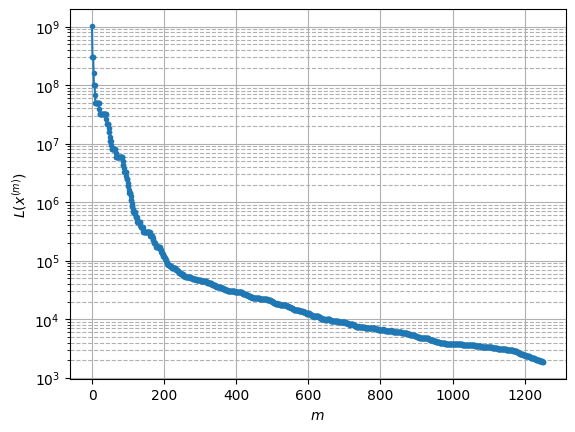

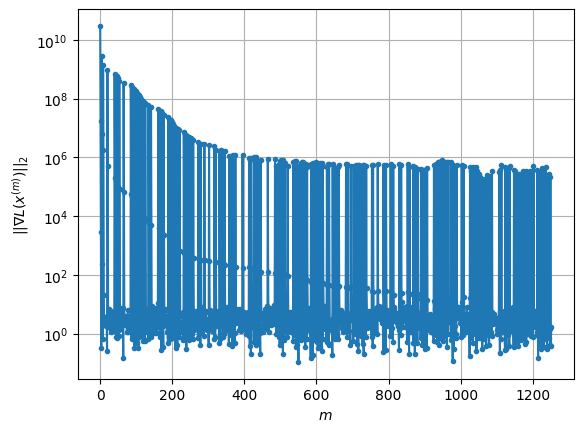

Windows:  31%|███▏      | 93/296 [53:32<36:14, 10.71s/it]


Majorization-Minimization Iteration 1
Before applying the algorithm
Cost function: 1860.7160387043361
Gradient norm: 536081.4955798563
Global relative error: 74.85695959543527
Position relative errors: 0.05314906563736452 m, 43.64249301280645 m, 37.574749036835 m, 47.82292712830622 m

Iteration 1
Cost function: 1849.1163540476298 (-0.62%)
Gradient norm: 4.550168557244715 (-100.00%)
Global relative error = 74.68987011415176 (-0.22%)
Position relative errors: 0.04190377660921253 m, 43.575003497400225 m, 37.44546126517266 m, 47.724534475345116 m

Iteration 2
Cost function: 1849.116355303258 (0.00%)
Gradient norm: 5.74714182691998 (26.31%)
Global relative error = 74.68987014107341 (0.00%)
Position relative errors: 0.04190377667251588 m, 43.575003520330114 m, 37.44546114326355 m, 47.72453459219369 m

Iteration 3
Cost function: 1849.1163554353288 (0.00%)
Gradient norm: 2.8395483107630772 (-50.59%)
Global relative error = 74.68987014098468 (-0.00%)
Position relative errors: 0.041903762510396

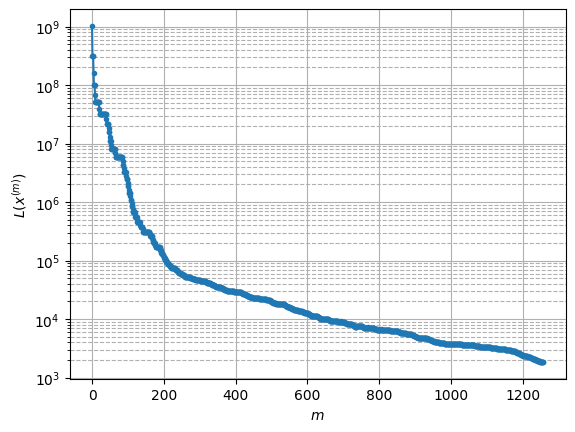

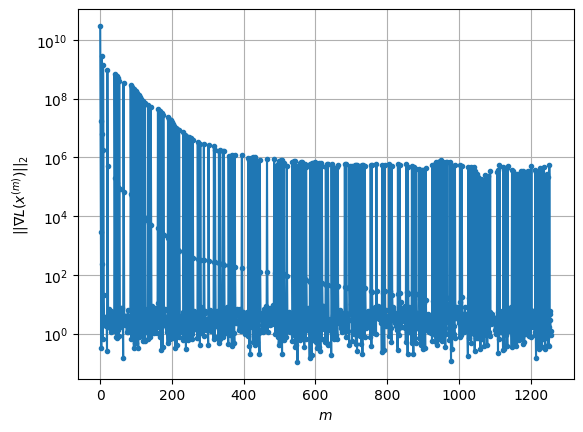

Windows:  32%|███▏      | 94/296 [53:48<41:03, 12.19s/it]


Majorization-Minimization Iteration 1
Before applying the algorithm
Cost function: 1855.2333502477286
Gradient norm: 294824.3142055463
Global relative error: 73.70552657956561
Position relative errors: 0.042171312533675634 m, 43.251924695725236 m, 37.10734341686076 m, 46.742042265813 m

Iteration 1
Cost function: 1843.6947495124255 (-0.62%)
Gradient norm: 4.6401869560004725 (-100.00%)
Global relative error = 73.54566718951436 (-0.22%)
Position relative errors: 0.038684702840510905 m, 43.18378492483739 m, 36.98269125346202 m, 46.6519507319933 m

Iteration 2
Cost function: 1843.6947510442847 (0.00%)
Gradient norm: 3.003133078378421 (-35.28%)
Global relative error = 73.54566722011045 (0.00%)
Position relative errors: 0.03868469736067845 m, 43.18378494695869 m, 36.98269115038555 m, 46.65195084146752 m

STOP on Iteration 3
Cost function = 1843.6947511730402 (0.00%)
Gradient norm = 0.596256951303033 (-80.15%)
Global relative error = 73.54566722055152 (0.00%)
Final position relative errors: 

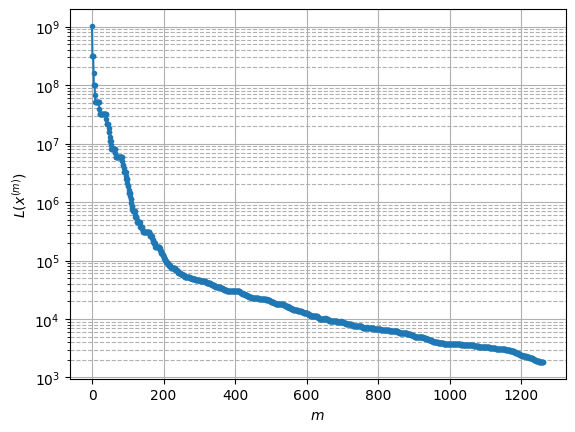

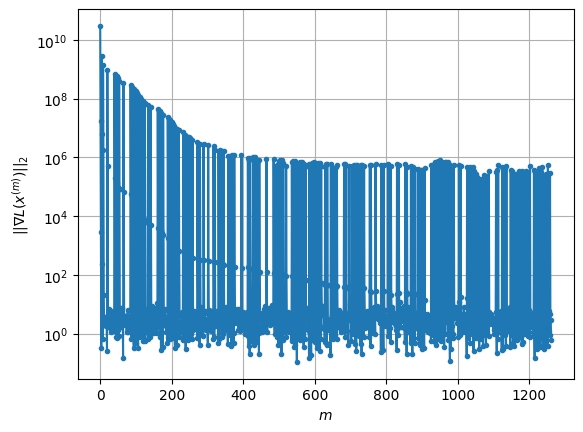

Windows:  32%|███▏      | 95/296 [53:58<39:07, 11.68s/it]


Majorization-Minimization Iteration 1
Before applying the algorithm
Cost function: 1848.6003598423847
Gradient norm: 352590.8281063013
Global relative error: 72.24676765613657
Position relative errors: 0.038997539784354544 m, 42.67165489629131 m, 36.48511991538878 m, 45.470420631126565 m

Iteration 1
Cost function: 1839.538409211554 (-0.49%)
Gradient norm: 4.16414887448972 (-100.00%)
Global relative error = 72.09385789456857 (-0.21%)
Position relative errors: 0.029316242413439747 m, 42.60337439457842 m, 36.366877328612325 m, 45.38640278801719 m

Iteration 2
Cost function: 1839.5384108203398 (0.00%)
Gradient norm: 3.8428276467348184 (-7.72%)
Global relative error = 72.09385792270716 (0.00%)
Position relative errors: 0.029316235779717384 m, 42.60337443085339 m, 36.366877240033034 m, 45.386402869643604 m

Iteration 3
Cost function: 1839.5384101349164 (-0.00%)
Gradient norm: 1.7620551215924478 (-54.15%)
Global relative error = 72.09385792249566 (-0.00%)
Position relative errors: 0.0293162

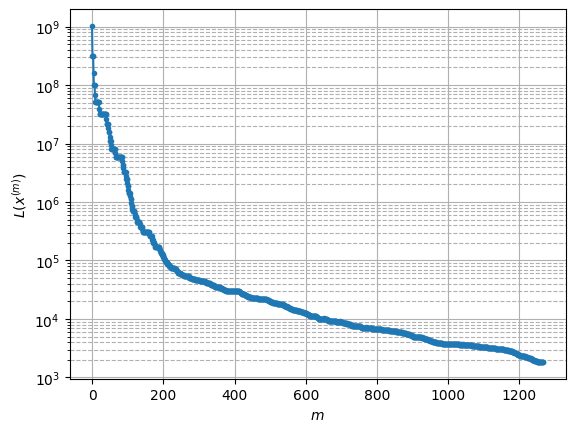

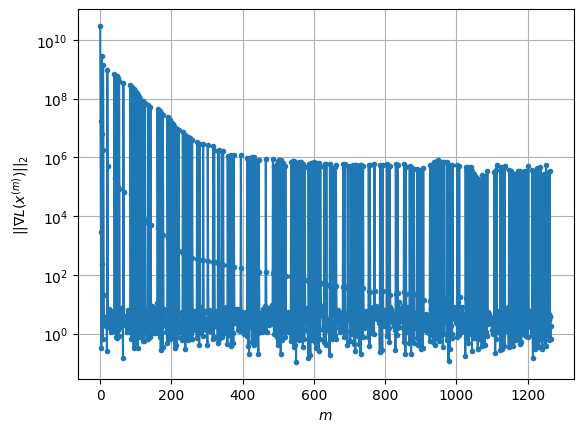

Windows:  32%|███▏      | 96/296 [54:11<40:19, 12.10s/it]


Majorization-Minimization Iteration 1
Before applying the algorithm
Cost function: 1852.9326881288341
Gradient norm: 317582.88627114025
Global relative error: 70.48752415386095
Position relative errors: 0.02998536117125003 m, 41.90480798383183 m, 35.712632527429854 m, 44.01231846336516 m

Iteration 1
Cost function: 1844.4032656086786 (-0.46%)
Gradient norm: 1.4697956539049477 (-100.00%)
Global relative error = 70.33985675205582 (-0.21%)
Position relative errors: 0.02031845285262728 m, 41.83800390699933 m, 35.59881611393828 m, 43.93176333782854 m

STOP on Iteration 2
Cost function = 1844.403265785269 (0.00%)
Gradient norm = 0.42805852801696637 (-70.88%)
Global relative error = 70.33985681505358 (0.00%)
Final position relative errors: 0.02031844747266657 m, 41.838003960800165 m, 35.598816066924186 m, 43.93176342555751 m

Majorization-Minimization converged after 1 iterations


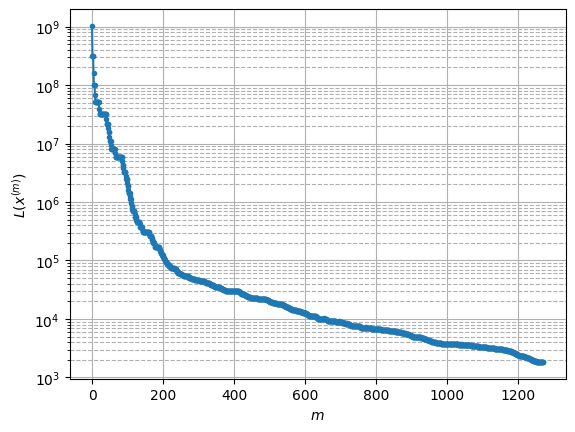

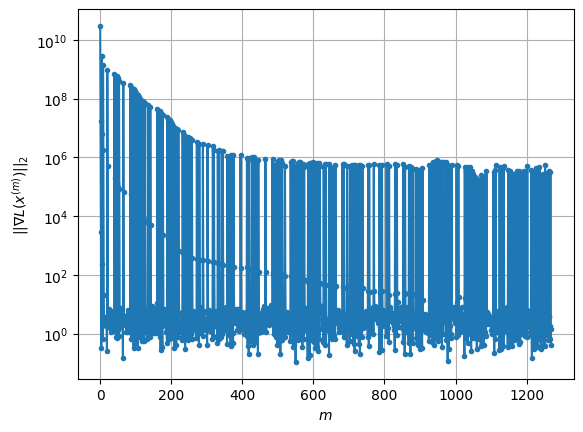

Windows:  33%|███▎      | 97/296 [54:20<36:12, 10.92s/it]


Majorization-Minimization Iteration 1
Before applying the algorithm
Cost function: 1868.9360492743565
Gradient norm: 417462.6521306774
Global relative error: 68.43470215861974
Position relative errors: 0.02105656696506846 m, 40.95661907461314 m, 34.79151568225066 m, 42.37230886746856 m

Iteration 1
Cost function: 1860.1102902825467 (-0.47%)
Gradient norm: 3.607830058557412 (-100.00%)
Global relative error = 68.29105810893422 (-0.21%)
Position relative errors: 0.018123489660715905 m, 40.891554193884 m, 34.68449807731453 m, 42.29105624069259 m

Iteration 2
Cost function: 1860.1102904055938 (0.00%)
Gradient norm: 1.1402936647179365 (-68.39%)
Global relative error = 68.29105815187094 (0.00%)
Position relative errors: 0.018123483922520247 m, 40.891554224152074 m, 34.68449799422106 m, 42.291056348910374 m

Iteration 3
Cost function: 1860.1102894309925 (-0.00%)
Gradient norm: 3.8757630948038613 (239.89%)
Global relative error = 68.29105815131838 (-0.00%)
Position relative errors: 0.018123482

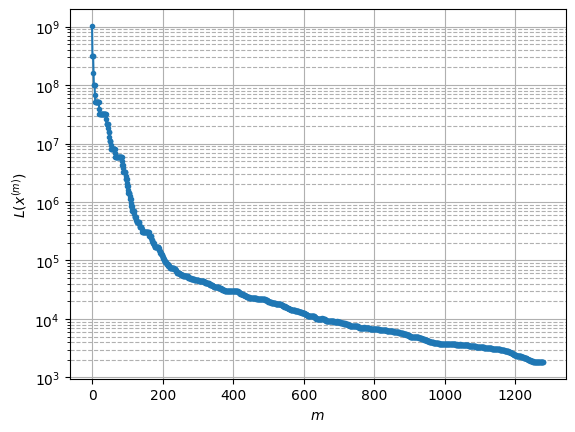

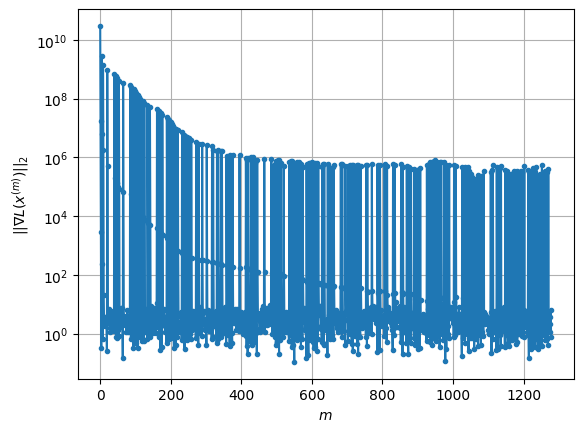

Windows:  33%|███▎      | 98/296 [54:42<47:35, 14.42s/it]


Majorization-Minimization Iteration 1
Before applying the algorithm
Cost function: 1871.957734853577
Gradient norm: 412756.023252989
Global relative error: 66.09732849017455
Position relative errors: 0.018395803142965007 m, 39.831811888126865 m, 33.72901520034549 m, 40.55410202325136 m

Iteration 1
Cost function: 1862.9465164789074 (-0.48%)
Gradient norm: 4.410700833088818 (-100.00%)
Global relative error = 65.95953579605705 (-0.21%)
Position relative errors: 0.019434538025263286 m, 39.7683649988896 m, 33.632611998196616 m, 40.472002058127 m

Iteration 2
Cost function: 1862.9465165401095 (0.00%)
Gradient norm: 3.0093050728838207 (-31.77%)
Global relative error = 65.95953584066552 (0.00%)
Position relative errors: 0.019434537350606632 m, 39.768365018040065 m, 33.63261193264435 m, 40.47200216648532 m

STOP on Iteration 3
Cost function = 1862.9465169521818 (0.00%)
Gradient norm = 0.5093862244733963 (-83.07%)
Global relative error = 65.95953584076456 (0.00%)
Final position relative errors

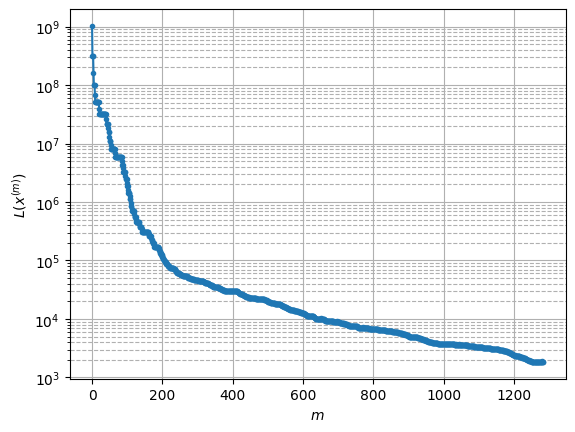

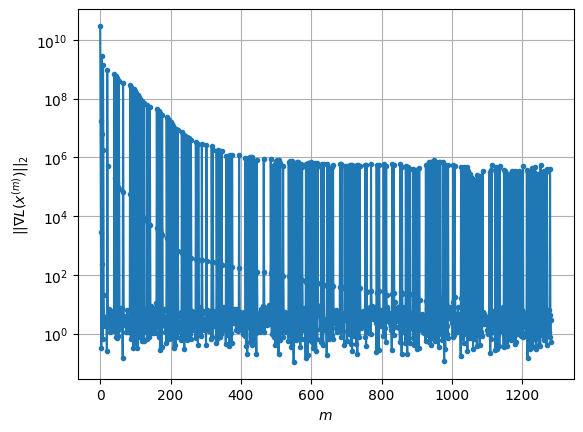

Windows:  33%|███▎      | 99/296 [54:53<43:26, 13.23s/it]


Majorization-Minimization Iteration 1
Before applying the algorithm
Cost function: 1861.343346059983
Gradient norm: 326357.8138230592
Global relative error: 63.48868774613466
Position relative errors: 0.01866352604888722 m, 38.53539042089602 m, 32.53450933017922 m, 38.566054133605896 m

Iteration 1
Cost function: 1854.627189355133 (-0.36%)
Gradient norm: 4.38958075792901 (-100.00%)
Global relative error = 63.35731050921751 (-0.21%)
Position relative errors: 0.019612620106258204 m, 38.47169562660455 m, 32.44633510184815 m, 38.48779568463721 m

Iteration 2
Cost function: 1854.6271902895267 (0.00%)
Gradient norm: 4.144781531760766 (-5.58%)
Global relative error = 63.35731054256436 (0.00%)
Position relative errors: 0.01961262056463256 m, 38.47169565555251 m, 32.446335042670775 m, 38.48779576048383 m

STOP on Iteration 3
Cost function = 1854.6271896032758 (-0.00%)
Gradient norm = 0.6803773326206141 (-83.58%)
Global relative error = 63.35731054171209 (-0.00%)
Final position relative errors:

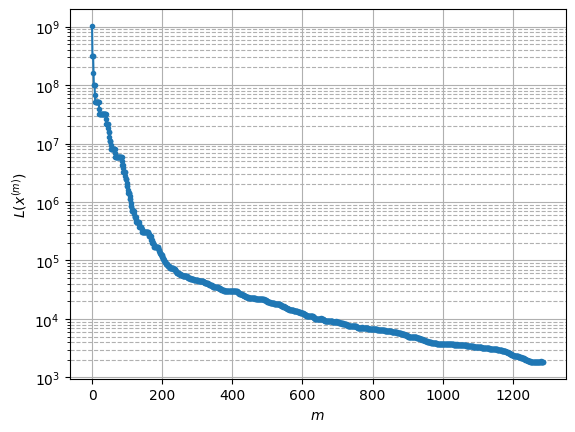

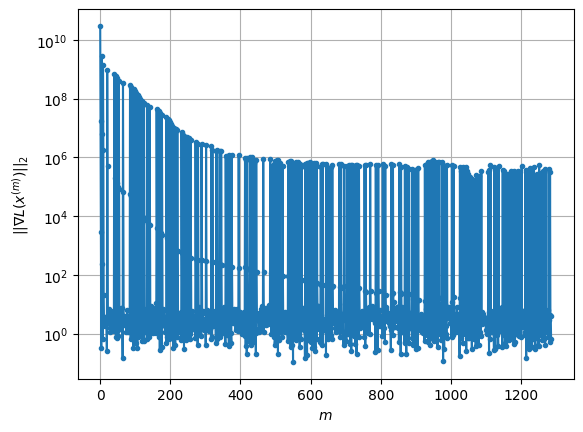

Windows:  34%|███▍      | 100/296 [55:03<40:26, 12.38s/it]


Majorization-Minimization Iteration 1
Before applying the algorithm
Cost function: 1856.5257467583813
Gradient norm: 435270.90631158196
Global relative error: 60.62190003976764
Position relative errors: 0.018426265232325403 m, 37.07140990158927 m, 31.21156041079432 m, 36.42198660596777 m

STOP on Iteration 1
Cost function = 1849.8611887324457 (-0.36%)
Gradient norm = 0.8396481963967353 (-100.00%)
Global relative error = 60.497167595616105 (-0.21%)
Final position relative errors: 0.02621055341127092 m, 37.00709316211472 m, 31.131602238424833 m, 36.34835114155482 m

Majorization-Minimization converged after 1 iterations


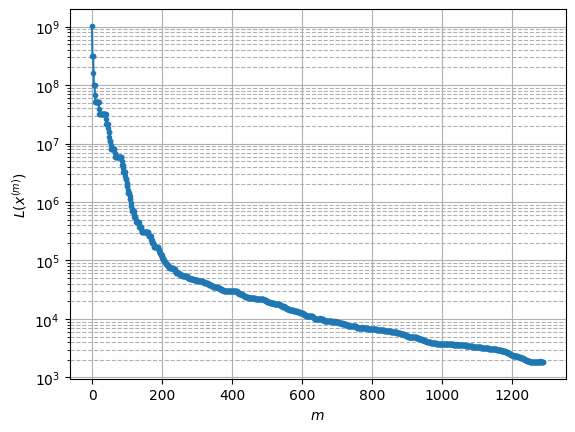

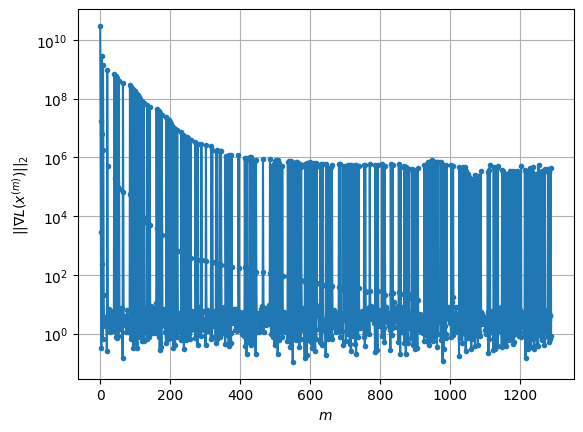

Windows:  34%|███▍      | 101/296 [55:09<33:39, 10.36s/it]


Majorization-Minimization Iteration 1
Before applying the algorithm
Cost function: 1845.0522527642997
Gradient norm: 339382.8253007996
Global relative error: 57.511061288039876
Position relative errors: 0.024203587220326707 m, 35.44629125833587 m, 29.76686417633926 m, 34.13228707775421 m

STOP on Iteration 1
Cost function = 1837.7689110879805 (-0.39%)
Gradient norm = 0.9964447956310367 (-100.00%)
Global relative error = 57.39406904969247 (-0.20%)
Final position relative errors: 0.023724477105308537 m, 35.38485668171801 m, 29.69538072747556 m, 34.06129914914201 m

Majorization-Minimization converged after 1 iterations


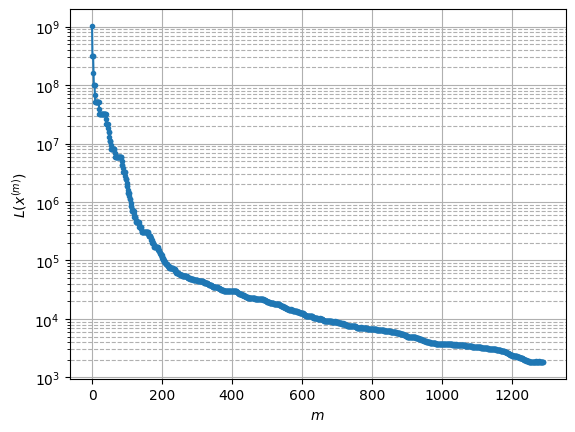

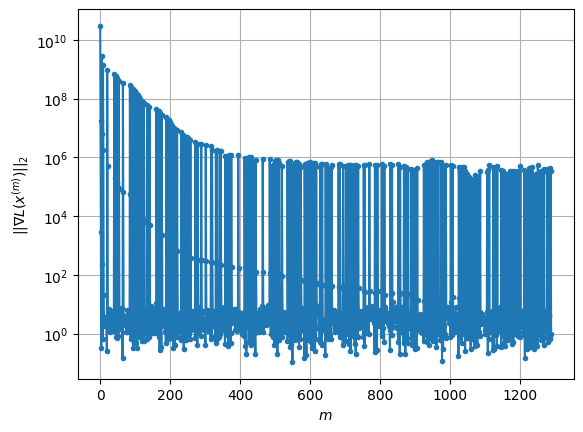

Windows:  34%|███▍      | 102/296 [55:14<28:52,  8.93s/it]


Majorization-Minimization Iteration 1
Before applying the algorithm
Cost function: 1837.7684403420938
Gradient norm: 340089.1543443642
Global relative error: 54.17235067526372
Position relative errors: 0.022046621611755194 m, 33.67117093551563 m, 28.207910435026854 m, 31.704982414396333 m

Iteration 1
Cost function: 1831.166464335556 (-0.36%)
Gradient norm: 2.56162760047441 (-100.00%)
Global relative error = 54.0626496720486 (-0.20%)
Position relative errors: 0.02237171489500427 m, 33.61097045674398 m, 28.142916814906474 m, 31.639299720605436 m

STOP on Iteration 2
Cost function = 1831.1664647549019 (0.00%)
Gradient norm = 0.7861319745866676 (-69.31%)
Global relative error = 54.0626497089233 (0.00%)
Final position relative errors: 0.022371723156261656 m, 33.61097048647526 m, 28.142916786222354 m, 31.639299777538326 m

Majorization-Minimization converged after 1 iterations


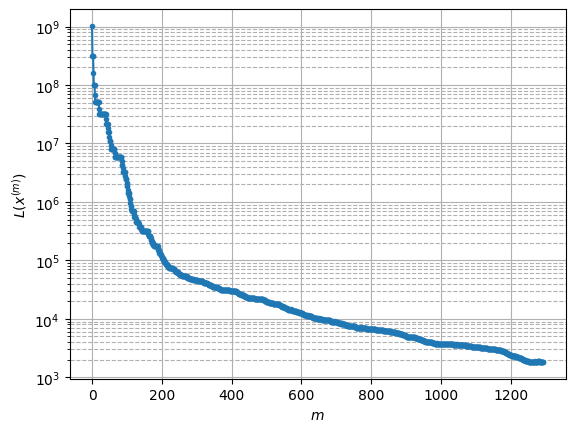

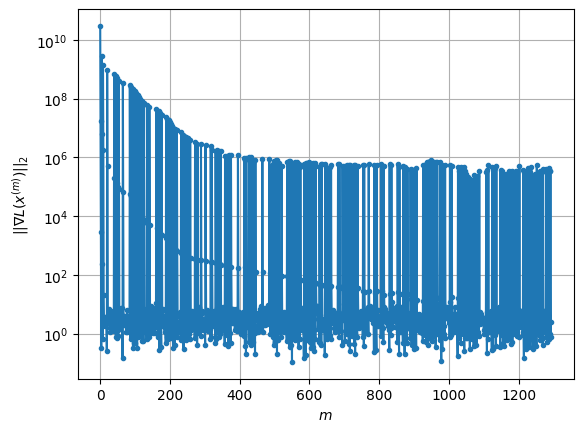

Windows:  35%|███▍      | 103/296 [55:23<28:01,  8.71s/it]


Majorization-Minimization Iteration 1
Before applying the algorithm
Cost function: 1808.9158314094082
Gradient norm: 281532.78746190947
Global relative error: 50.62161611554884
Position relative errors: 0.020561122197034695 m, 31.752710522006968 m, 26.54037735892077 m, 29.15334801641006 m

Iteration 1
Cost function: 1801.9084180854063 (-0.39%)
Gradient norm: 4.648104831765064 (-100.00%)
Global relative error = 50.521999723791296 (-0.20%)
Position relative errors: 0.02225556674751862 m, 31.693301642742572 m, 26.48169807157683 m, 29.098498928275507 m

Iteration 2
Cost function: 1801.9084172021257 (-0.00%)
Gradient norm: 1.7531976384187526 (-62.28%)
Global relative error = 50.52199974581677 (0.00%)
Position relative errors: 0.022255558530093845 m, 31.693301672400555 m, 26.4816980369725 m, 29.098498965713052 m

Iteration 3
Cost function: 1801.9084176218416 (0.00%)
Gradient norm: 3.1234571504652187 (78.16%)
Global relative error = 50.52199974549466 (-0.00%)
Position relative errors: 0.0222

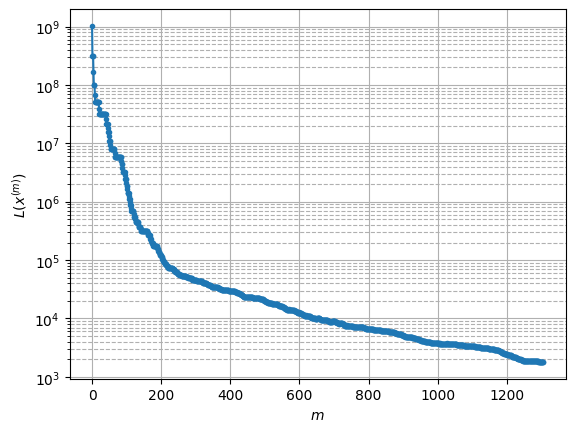

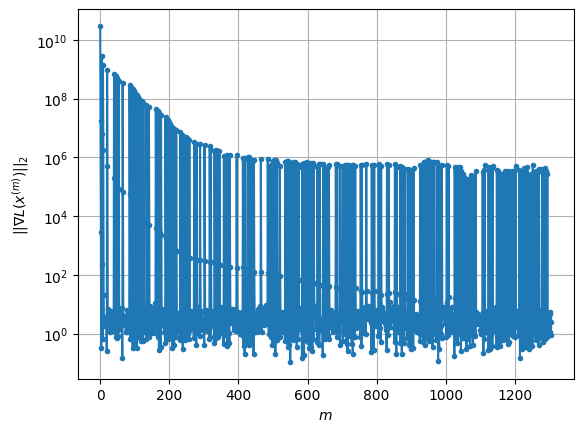

Windows:  35%|███▌      | 104/296 [55:53<48:18, 15.09s/it]


Majorization-Minimization Iteration 1
Before applying the algorithm
Cost function: 1774.971863239744
Gradient norm: 293781.1635615898
Global relative error: 46.879279502554354
Position relative errors: 0.02049572929412783 m, 29.699475968960677 m, 24.77262770428269 m, 26.49378077031071 m

Iteration 1
Cost function: 1766.395380209134 (-0.48%)
Gradient norm: 3.575664862516617 (-100.00%)
Global relative error = 46.7924542191625 (-0.19%)
Position relative errors: 0.016928472953352463 m, 29.644194906115946 m, 24.72264390758148 m, 26.44885710455101 m

Iteration 2
Cost function: 1766.3953791902895 (-0.00%)
Gradient norm: 1.7713775814576493 (-50.46%)
Global relative error = 46.7924542264929 (0.00%)
Position relative errors: 0.016928476602689597 m, 29.644194917681926 m, 24.72264386880552 m, 26.448857140799323 m

Iteration 3
Cost function: 1766.3953800374477 (0.00%)
Gradient norm: 2.5975200730888552 (46.64%)
Global relative error = 46.7924542260127 (-0.00%)
Position relative errors: 0.0169284794

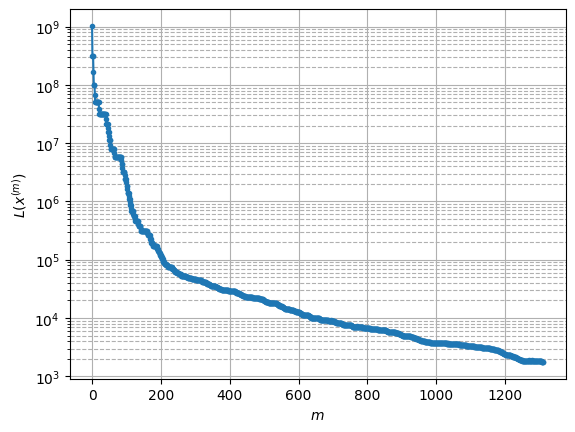

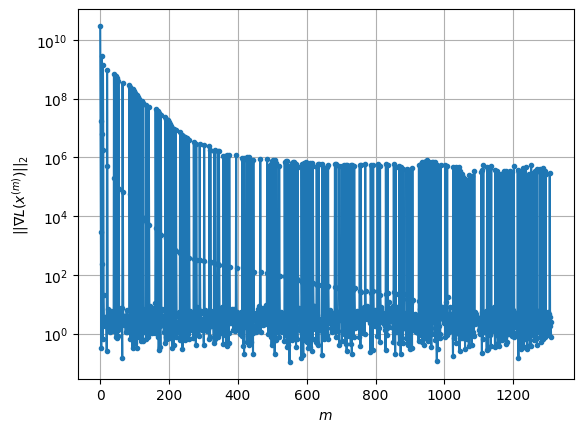

Windows:  35%|███▌      | 105/296 [56:05<45:58, 14.44s/it]


Majorization-Minimization Iteration 1
Before applying the algorithm
Cost function: 1748.9716820766155
Gradient norm: 309254.37895565404
Global relative error: 42.96721732261377
Position relative errors: 0.015919111258455392 m, 27.524392182660694 m, 22.916481011238243 m, 23.736465549930113 m

Iteration 1
Cost function: 1741.379394513303 (-0.43%)
Gradient norm: 6.628967568567397 (-100.00%)
Global relative error = 42.89315253621009 (-0.17%)
Position relative errors: 0.013463586037555885 m, 27.468513666449855 m, 22.878698911913997 m, 23.70366683761299 m

Iteration 2
Cost function: 1741.379395383348 (0.00%)
Gradient norm: 3.6638061623101317 (-44.73%)
Global relative error = 42.89315255163398 (0.00%)
Position relative errors: 0.013463577236649074 m, 27.468513686804485 m, 22.87869888501009 m, 23.703666867908392 m

Iteration 3
Cost function: 1741.3793940265648 (-0.00%)
Gradient norm: 5.089531285170089 (38.91%)
Global relative error = 42.89315255177412 (0.00%)
Position relative errors: 0.01346

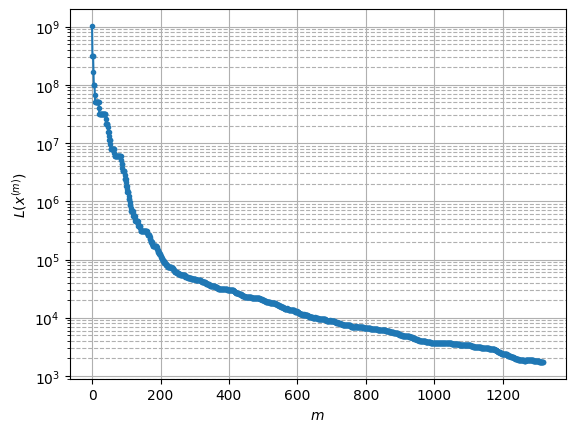

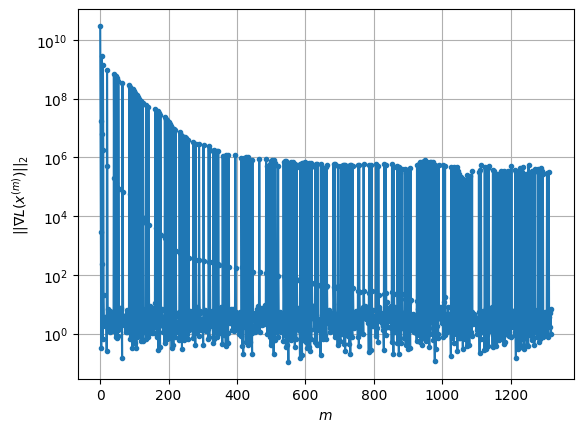

Windows:  36%|███▌      | 106/296 [56:28<53:18, 16.84s/it]


Majorization-Minimization Iteration 1
Before applying the algorithm
Cost function: 1702.0191712516885
Gradient norm: 344377.96181846265
Global relative error: 38.90649173038655
Position relative errors: 0.013273373224698586 m, 25.2327723989613 m, 20.98564865328831 m, 20.8954504438232 m

Iteration 1
Cost function: 1693.7844968887603 (-0.48%)
Gradient norm: 2.944665960043108 (-100.00%)
Global relative error = 38.84679353682057 (-0.15%)
Position relative errors: 0.015410510843011701 m, 25.179231138046987 m, 20.957665932583573 m, 20.877042201154534 m

Iteration 2
Cost function: 1693.784497489245 (0.00%)
Gradient norm: 6.610676559139966 (124.50%)
Global relative error = 38.84679355775222 (0.00%)
Position relative errors: 0.015410496609702 m, 25.179231163217967 m, 20.95766590373259 m, 20.877042238717724 m

Iteration 3
Cost function: 1693.7844967782237 (-0.00%)
Gradient norm: 1.6451127846615456 (-75.11%)
Global relative error = 38.846793557883366 (0.00%)
Position relative errors: 0.015410501

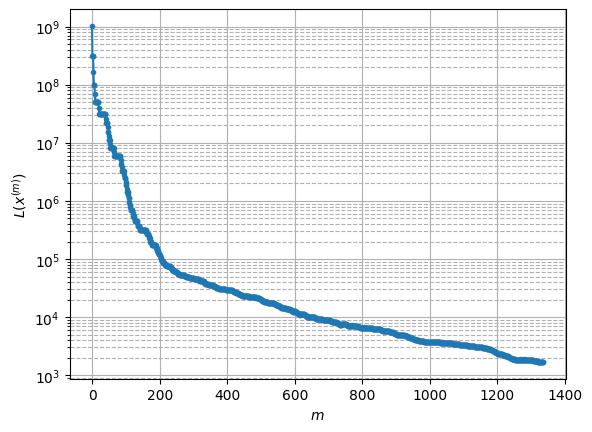

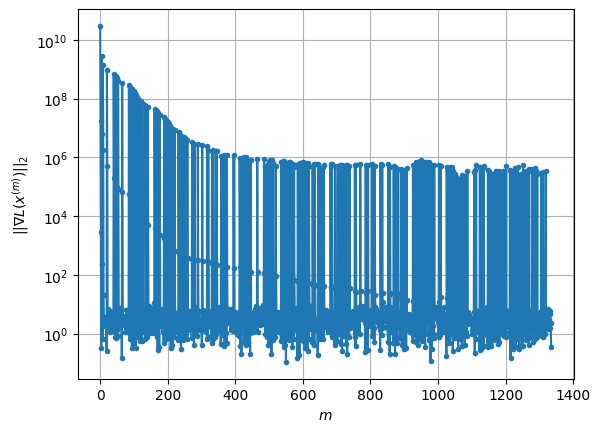

Windows:  36%|███▌      | 107/296 [57:10<1:17:17, 24.54s/it]


Majorization-Minimization Iteration 1
Before applying the algorithm
Cost function: 1653.9648743128557
Gradient norm: 247362.5186382035
Global relative error: 34.72204977223599
Position relative errors: 0.015410360901753118 m, 22.83804724849054 m, 18.988613407473153 m, 17.985313334540848 m

Iteration 1
Cost function: 1646.391684922981 (-0.46%)
Gradient norm: 4.611898649836394 (-100.00%)
Global relative error = 34.674169703302205 (-0.14%)
Position relative errors: 0.012958087762781107 m, 22.787550385452715 m, 18.966117730644303 m, 17.980730268038464 m

STOP on Iteration 2
Cost function = 1646.3916842100243 (-0.00%)
Gradient norm = 0.6801064356537998 (-85.25%)
Global relative error = 34.67416972244938 (0.00%)
Final position relative errors: 0.01295807896188198 m, 22.787550398318643 m, 18.966117710194524 m, 17.980730310233326 m

Majorization-Minimization converged after 1 iterations


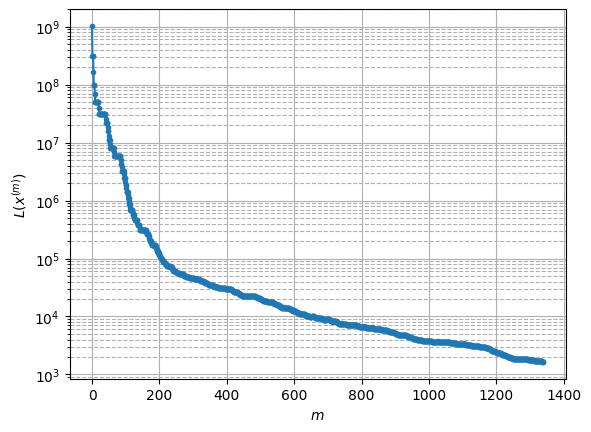

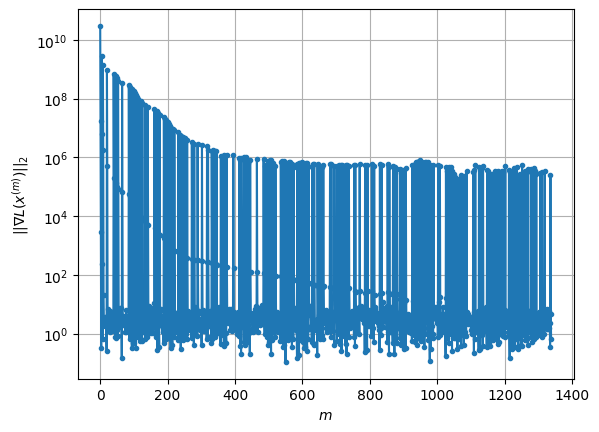

Windows:  36%|███▋      | 108/296 [57:19<1:01:27, 19.61s/it]


Majorization-Minimization Iteration 1
Before applying the algorithm
Cost function: 1623.3809763691147
Gradient norm: 348124.6635116546
Global relative error: 30.43791799358712
Position relative errors: 0.01239800717836145 m, 20.352042020705778 m, 16.931905041397982 m, 15.018861455208986 m

Iteration 1
Cost function: 1615.9063613665965 (-0.46%)
Gradient norm: 3.521175689548776 (-100.00%)
Global relative error = 30.403365228853104 (-0.11%)
Position relative errors: 0.019734769367719757 m, 20.304450412394537 m, 16.916960219441904 m, 15.030120672298457 m

Iteration 2
Cost function: 1615.9063620821685 (0.00%)
Gradient norm: 1.8760435867327065 (-46.72%)
Global relative error = 30.403365246653124 (0.00%)
Position relative errors: 0.019734747332666353 m, 20.304450430535525 m, 16.916960187840377 m, 15.030120719395462 m

Iteration 3
Cost function: 1615.9063616719745 (-0.00%)
Gradient norm: 4.379230660970904 (133.43%)
Global relative error = 30.40336524707435 (0.00%)
Position relative errors: 0.

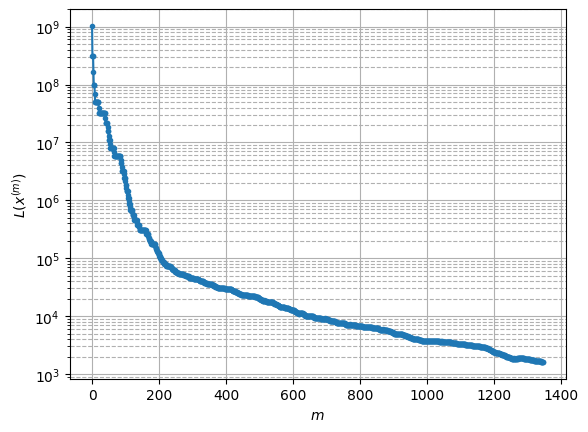

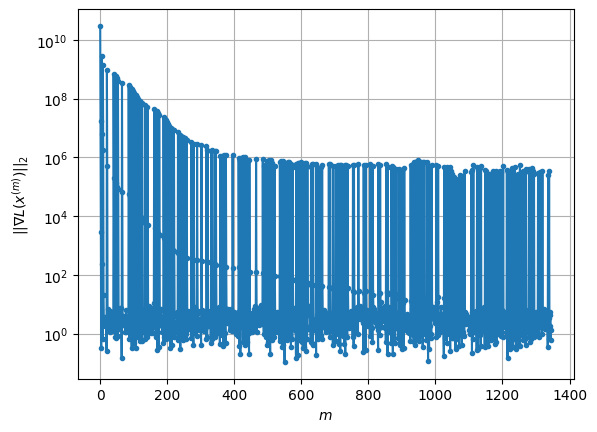

Windows:  37%|███▋      | 109/296 [57:37<59:45, 19.17s/it]  


Majorization-Minimization Iteration 1
Before applying the algorithm
Cost function: 1589.184805569619
Gradient norm: 139011.749156104
Global relative error: 26.088874680108898
Position relative errors: 0.019874220495388336 m, 17.78589950028608 m, 14.831094876866487 m, 12.01347763152141 m

Iteration 1
Cost function: 1582.624475210535 (-0.41%)
Gradient norm: 2.8066614168537716 (-100.00%)
Global relative error = 26.068189681939064 (-0.08%)
Position relative errors: 0.013282070145011062 m, 17.741325951473378 m, 14.82317046491811 m, 12.044234615095862 m

Iteration 2
Cost function: 1582.6244752232053 (0.00%)
Gradient norm: 3.74421577191068 (33.40%)
Global relative error = 26.068189714297286 (0.00%)
Position relative errors: 0.013282057862534646 m, 17.741325988168025 m, 14.823170433406503 m, 12.044234669874877 m

Iteration 3
Cost function: 1582.6244754523182 (0.00%)
Gradient norm: 2.8442275412123292 (-24.04%)
Global relative error = 26.068189714123577 (-0.00%)
Position relative errors: 0.0132

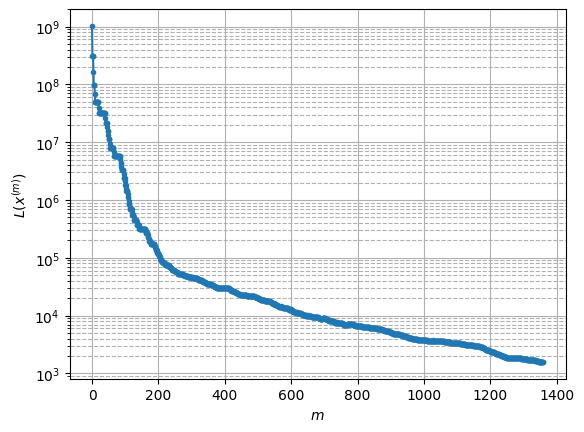

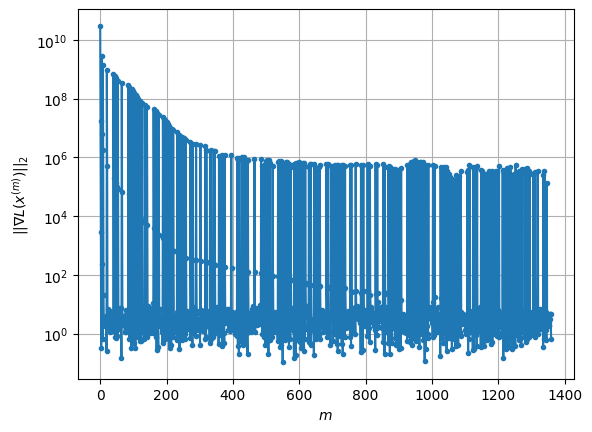

Windows:  37%|███▋      | 110/296 [58:13<1:14:58, 24.19s/it]


Majorization-Minimization Iteration 1
Before applying the algorithm
Cost function: 1554.5846829174025
Gradient norm: 190388.60540175048
Global relative error: 21.720603454606366
Position relative errors: 0.013456280674870136 m, 15.151816407488012 m, 12.701588869149898 m, 8.992806095354945 m

Iteration 1
Cost function: 1548.2263418066243 (-0.41%)
Gradient norm: 2.908838593516712 (-100.00%)
Global relative error = 21.716961154723297 (-0.02%)
Position relative errors: 0.01696173482323325 m, 15.112935097152784 m, 12.69999765835101 m, 9.051487205502559 m

STOP on Iteration 2
Cost function = 1548.2263413368632 (-0.00%)
Gradient norm = 0.255969911663889 (-91.20%)
Global relative error = 21.716961181188694 (0.00%)
Final position relative errors: 0.01696172013595891 m, 15.112935124738984 m, 12.699997620699616 m, 9.051487275796022 m

Majorization-Minimization converged after 1 iterations


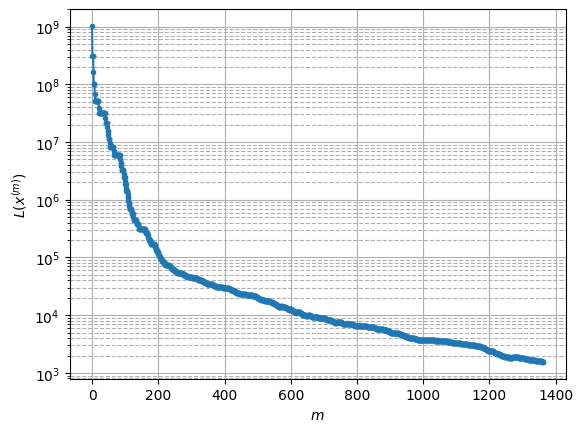

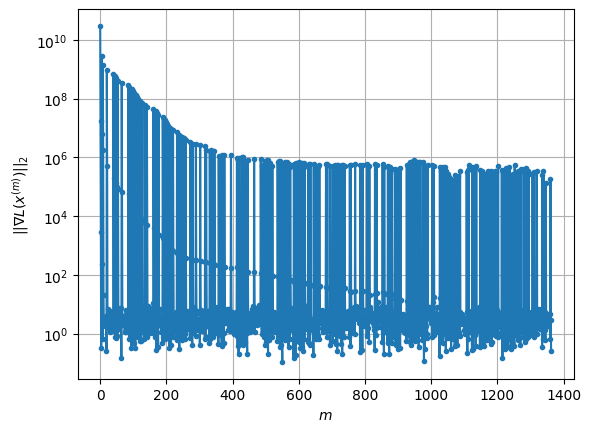

Windows:  38%|███▊      | 111/296 [58:21<59:48, 19.40s/it]  


Majorization-Minimization Iteration 1
Before applying the algorithm
Cost function: 1537.9094056855458
Gradient norm: 255621.01134059418
Global relative error: 17.407623369369468
Position relative errors: 0.016812298443569202 m, 12.46517937188626 m, 10.56414081235775 m, 6.003095157879893 m

Iteration 1
Cost function: 1532.0566281392726 (-0.38%)
Gradient norm: 6.558409979619537 (-100.00%)
Global relative error = 17.415223307233333 (0.04%)
Position relative errors: 0.02462244835598499 m, 12.429374997525958 m, 10.573806563668745 m, 6.081819248820035 m

Iteration 2
Cost function: 1532.0566277830249 (-0.00%)
Gradient norm: 6.318139104859892 (-3.66%)
Global relative error = 17.41522333515019 (0.00%)
Position relative errors: 0.024622437484483648 m, 12.429375045675028 m, 10.573806513914908 m, 6.081819316903577 m

Iteration 3
Cost function: 1532.0566273750785 (-0.00%)
Gradient norm: 1.6370955608985585 (-74.09%)
Global relative error = 17.41522333190419 (-0.00%)
Position relative errors: 0.0246

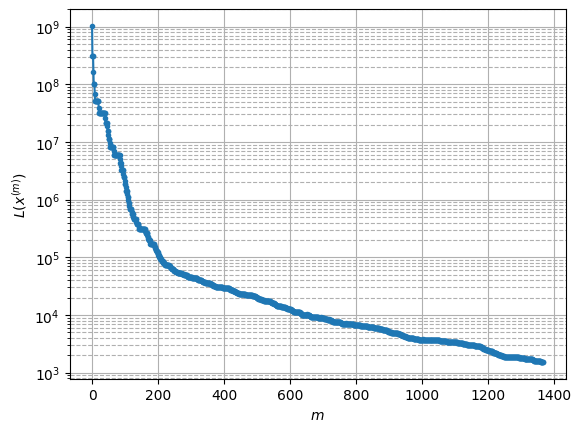

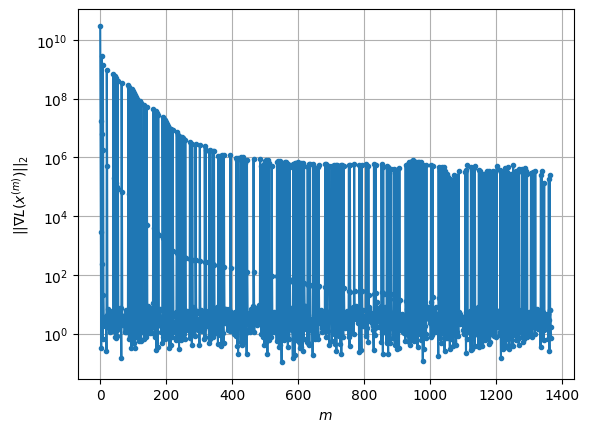

Windows:  38%|███▊      | 112/296 [58:34<53:36, 17.48s/it]


Majorization-Minimization Iteration 1
Before applying the algorithm
Cost function: 1517.9048241282976
Gradient norm: 293939.93521069223
Global relative error: 13.280638243837762
Position relative errors: 0.024088156288604976 m, 9.736003287683802 m, 8.457557103248366 m, 3.1699311704563256 m

Iteration 1
Cost function: 1511.9598752401218 (-0.39%)
Gradient norm: 1.7967620433991143 (-100.00%)
Global relative error = 13.304997927356482 (0.18%)
Position relative errors: 0.031956201470084815 m, 9.704449877359425 m, 8.473599668514614 m, 3.3222672417508474 m

Iteration 2
Cost function: 1511.9598761818688 (0.00%)
Gradient norm: 3.8711070368329947 (115.45%)
Global relative error = 13.304997954745721 (0.00%)
Position relative errors: 0.03195619565847978 m, 9.70444992056464 m, 8.47359961179995 m, 3.3222673699447283 m

Iteration 3
Cost function: 1511.9598746753804 (-0.00%)
Gradient norm: 2.061227595467635 (-46.75%)
Global relative error = 13.304997956371905 (0.00%)
Position relative errors: 0.03195

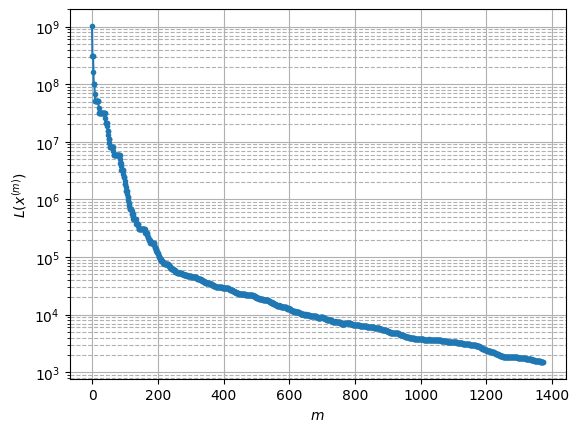

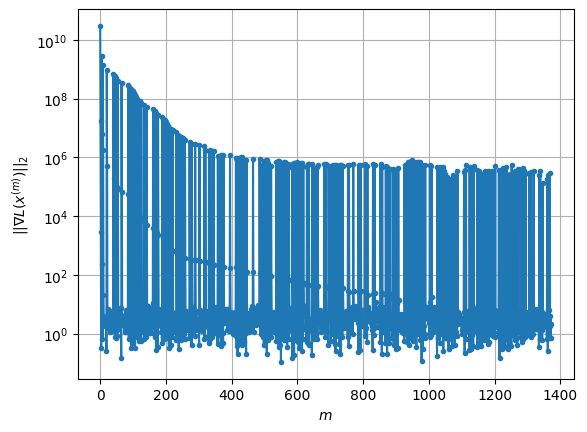

Windows:  38%|███▊      | 113/296 [58:47<49:14, 16.15s/it]


Majorization-Minimization Iteration 1
Before applying the algorithm
Cost function: 1516.1075542744827
Gradient norm: 320743.45015832776
Global relative error: 9.672974040925844
Position relative errors: 0.030945815502126574 m, 6.98165889321686 m, 6.441281705616767 m, 1.823581024130888 m

Iteration 1
Cost function: 1510.3295639253213 (-0.38%)
Gradient norm: 6.260165027753858 (-100.00%)
Global relative error = 9.709442535235354 (0.38%)
Position relative errors: 0.024172510701776062 m, 6.954983624128852 m, 6.4696079437995895 m, 2.0096618964717967 m

Iteration 2
Cost function: 1510.32956415696 (0.00%)
Gradient norm: 1.5311609573463651 (-75.54%)
Global relative error = 9.70944254677121 (0.00%)
Position relative errors: 0.02417249613221014 m, 6.954983673175037 m, 6.469607857336689 m, 2.0096620609899674 m

Iteration 3
Cost function: 1510.3295640751276 (-0.00%)
Gradient norm: 1.2400395658789458 (-19.01%)
Global relative error = 9.709442547731104 (0.00%)
Position relative errors: 0.02417249208

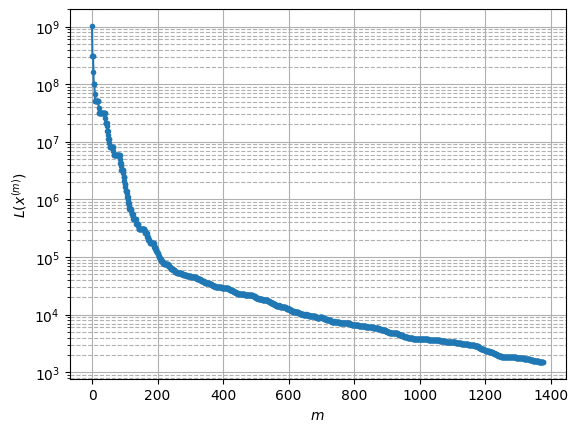

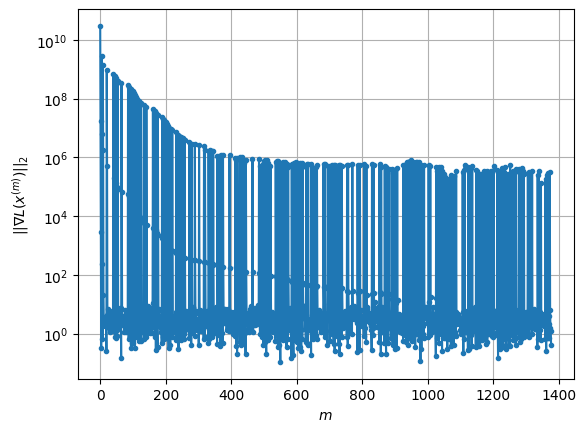

Windows:  39%|███▊      | 114/296 [59:00<45:52, 15.12s/it]


Majorization-Minimization Iteration 1
Before applying the algorithm
Cost function: 1518.8655915914255
Gradient norm: 433481.1141745094
Global relative error: 7.436009803410268
Position relative errors: 0.023164201550712263 m, 4.229278627231288 m, 4.675419278549934 m, 3.9422063430342726 m

Iteration 1
Cost function: 1513.2069825599594 (-0.37%)
Gradient norm: 4.603714659845488 (-100.00%)
Global relative error = 7.459209517253708 (0.31%)
Position relative errors: 0.03156430230845045 m, 4.201738626993986 m, 4.712526695984323 m, 3.9711394971012157 m

Iteration 2
Cost function: 1513.2069811158672 (-0.00%)
Gradient norm: 1.6394119635848852 (-64.39%)
Global relative error = 7.459209476642687 (-0.00%)
Position relative errors: 0.03156429410065344 m, 4.201738668052064 m, 4.712526582986446 m, 3.971139511536671 m

Iteration 3
Cost function: 1513.2069818472803 (0.00%)
Gradient norm: 8.598836463339213 (424.51%)
Global relative error = 7.459209476137354 (-0.00%)
Position relative errors: 0.031564282

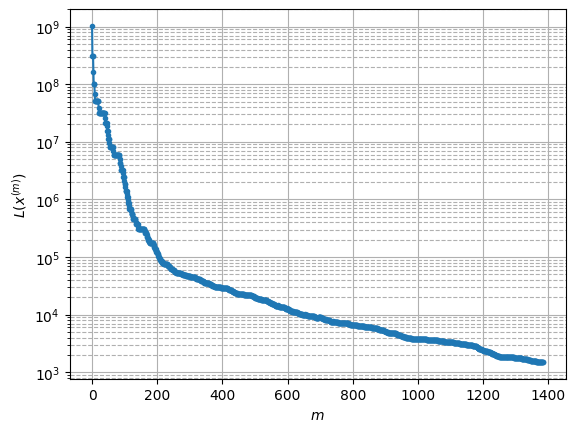

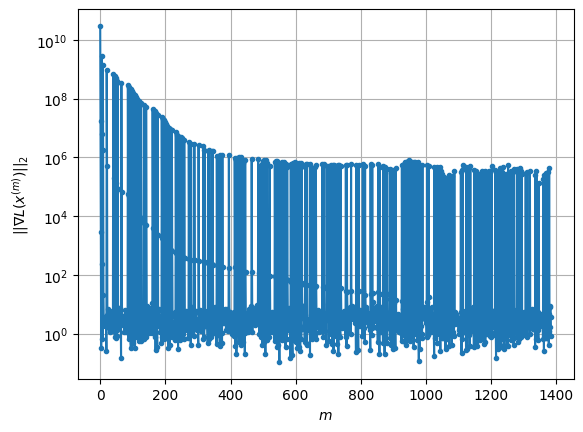

Windows:  39%|███▉      | 115/296 [59:19<49:20, 16.36s/it]


Majorization-Minimization Iteration 1
Before applying the algorithm
Cost function: 1529.4738023447994
Gradient norm: 329914.98996488616
Global relative error: 7.838139153519383
Position relative errors: 0.030032882815379528 m, 1.5910334489450286 m, 3.5688765880238242 m, 6.794182640302583 m

Iteration 1
Cost function: 1523.7868751427156 (-0.37%)
Gradient norm: 1.7391351662221954 (-100.00%)
Global relative error = 7.850787767008625 (0.16%)
Position relative errors: 0.029612588665358004 m, 1.5485442729527297 m, 3.6370152595142713 m, 6.782463296851436 m

Iteration 2
Cost function: 1523.7868767163682 (0.00%)
Gradient norm: 4.67905410557036 (169.04%)
Global relative error = 7.850787689913392 (-0.00%)
Position relative errors: 0.029612570281161234 m, 1.548544274300681 m, 3.637015094103408 m, 6.782463296085434 m

Iteration 3
Cost function: 1523.7868757382048 (-0.00%)
Gradient norm: 2.687307322346353 (-42.57%)
Global relative error = 7.850787693348148 (0.00%)
Position relative errors: 0.029612

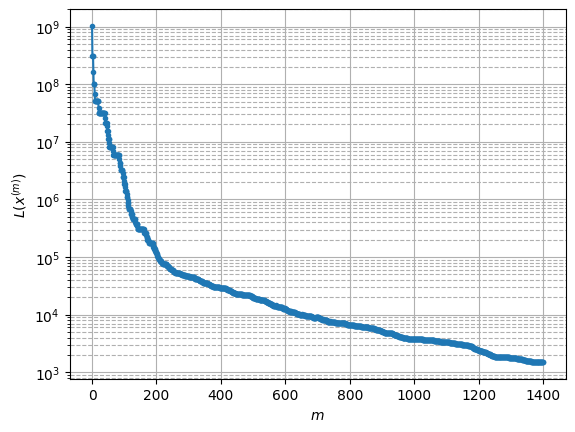

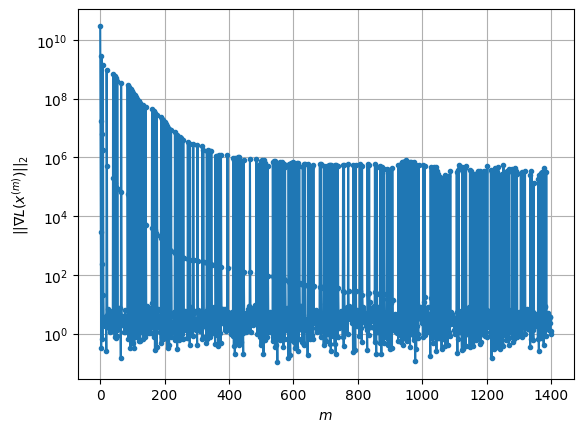

Windows:  39%|███▉      | 116/296 [59:59<1:10:34, 23.53s/it]


Majorization-Minimization Iteration 1
Before applying the algorithm
Cost function: 1537.4184112908813
Gradient norm: 443486.65486265137
Global relative error: 10.568480667888304
Position relative errors: 0.028027159368947688 m, 1.6624337508112885 m, 3.782615784400462 m, 9.726966513507866 m

Iteration 1
Cost function: 1531.7866095029271 (-0.37%)
Gradient norm: 2.03350223226929 (-100.00%)
Global relative error = 10.529991944244205 (-0.36%)
Position relative errors: 0.03381596340166782 m, 1.6127100612999108 m, 3.825326736963043 m, 9.676745314190905 m

Iteration 2
Cost function: 1531.7866079029795 (-0.00%)
Gradient norm: 2.9590093943872073 (45.51%)
Global relative error = 10.529991858303253 (-0.00%)
Position relative errors: 0.03381595990275193 m, 1.6127099284559114 m, 3.8253265923553177 m, 9.676745299989403 m

Iteration 3
Cost function: 1531.7866087948241 (0.00%)
Gradient norm: 4.6041153793578 (55.60%)
Global relative error = 10.529991858320145 (0.00%)
Position relative errors: 0.0338159

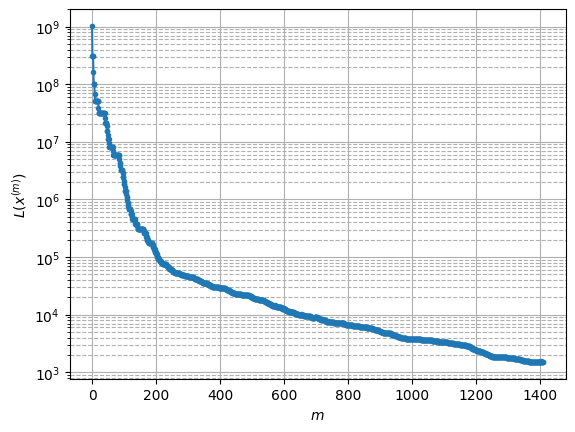

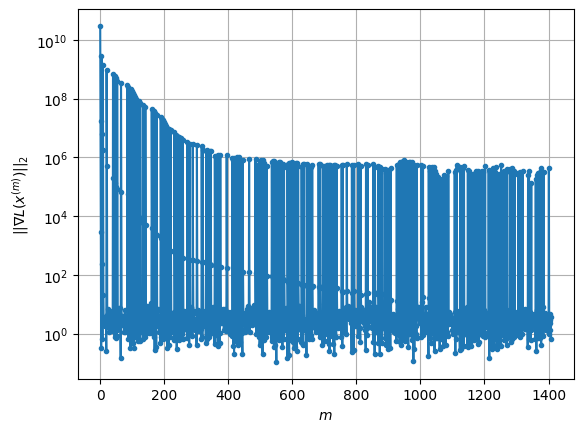

Windows:  40%|███▉      | 117/296 [1:00:19<1:07:13, 22.53s/it]


Majorization-Minimization Iteration 1
Before applying the algorithm
Cost function: 1551.8673917703716
Gradient norm: 366631.3382796438
Global relative error: 14.283369379045656
Position relative errors: 0.03197478164492762 m, 4.2804105388796305 m, 5.111303073667278 m, 12.631712866820386 m

Iteration 1
Cost function: 1545.4027564068517 (-0.42%)
Gradient norm: 3.909564032862678 (-100.00%)
Global relative error = 14.223676653953316 (-0.42%)
Position relative errors: 0.041657988166472475 m, 4.244444081216732 m, 5.135455436507115 m, 12.566500784909445 m

Iteration 2
Cost function: 1545.4027577329007 (0.00%)
Gradient norm: 1.5427849330854357 (-60.54%)
Global relative error = 14.223676554848984 (-0.00%)
Position relative errors: 0.041657965179895486 m, 4.244443971523936 m, 5.135455297486268 m, 12.566500766674709 m

STOP on Iteration 3
Cost function = 1545.4027576168796 (-0.00%)
Gradient norm = 0.3914965383153859 (-74.62%)
Global relative error = 14.223676554750819 (-0.00%)
Final position rel

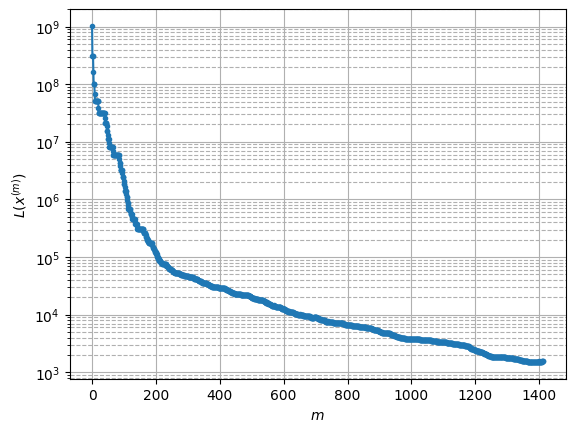

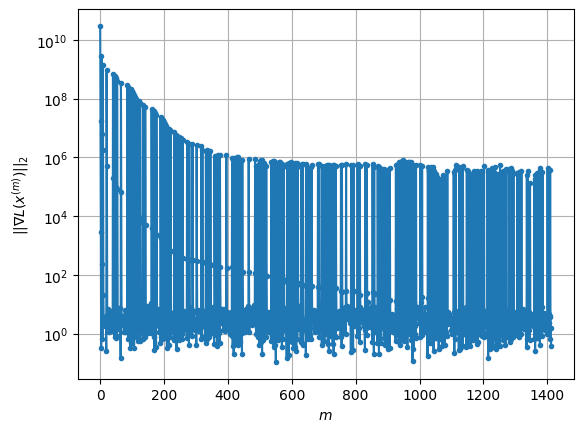

Windows:  40%|███▉      | 118/296 [1:00:29<55:52, 18.83s/it]  


Majorization-Minimization Iteration 1
Before applying the algorithm
Cost function: 1573.6216980525146
Gradient norm: 513986.89040291356
Global relative error: 18.345607871572625
Position relative errors: 0.039509667261933716 m, 6.978506154447578 m, 6.924674911533925 m, 15.488807815268254 m

STOP on Iteration 1
Cost function = 1566.9317992433762 (-0.43%)
Gradient norm = 0.655426737508237 (-100.00%)
Global relative error = 18.26299450931135 (-0.45%)
Final position relative errors: 0.05309623098421093 m, 6.941556543489626 m, 6.90969972227878 m, 15.414249418138356 m

Majorization-Minimization converged after 1 iterations


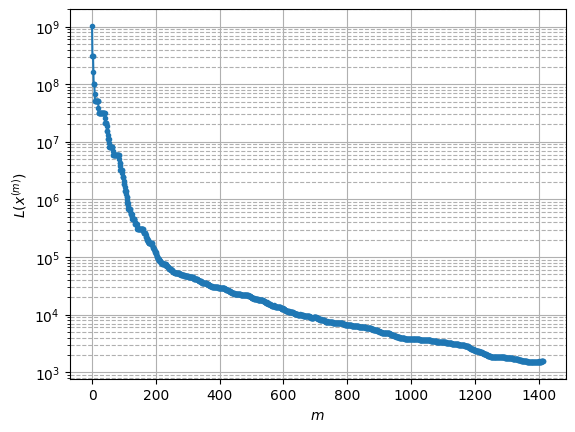

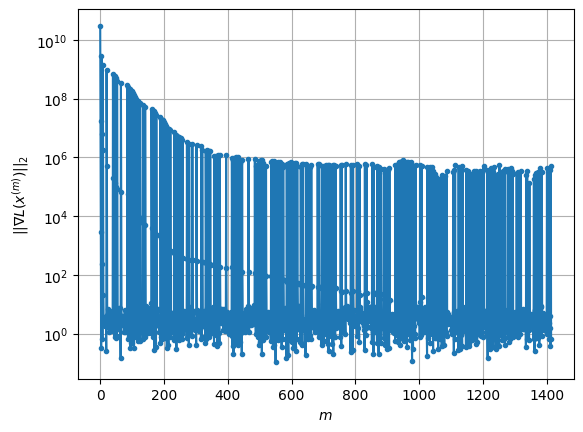

Windows:  40%|████      | 119/296 [1:00:35<43:54, 14.89s/it]


Majorization-Minimization Iteration 1
Before applying the algorithm
Cost function: 1597.3385631907145
Gradient norm: 435978.7031650375
Global relative error: 22.50062786253751
Position relative errors: 0.05019982867788073 m, 9.653033441629182 m, 8.883362778365656 m, 18.28044989604671 m

Iteration 1
Cost function: 1590.1262651846728 (-0.45%)
Gradient norm: 1.02866226433175 (-100.00%)
Global relative error = 22.402305008823756 (-0.44%)
Position relative errors: 0.04779312757199226 m, 9.609279935117137 m, 8.850294966410939 m, 18.19860786196812 m

Iteration 2
Cost function: 1590.1262649126359 (-0.00%)
Gradient norm: 1.3769118532803077 (33.85%)
Global relative error = 22.402304943878686 (-0.00%)
Position relative errors: 0.04779311250093655 m, 9.609279842621977 m, 8.85029491589452 m, 18.198607855467703 m

Iteration 3
Cost function: 1590.1262644462706 (-0.00%)
Gradient norm: 4.850356114116215 (252.26%)
Global relative error = 22.40230494480965 (0.00%)
Position relative errors: 0.04779311669

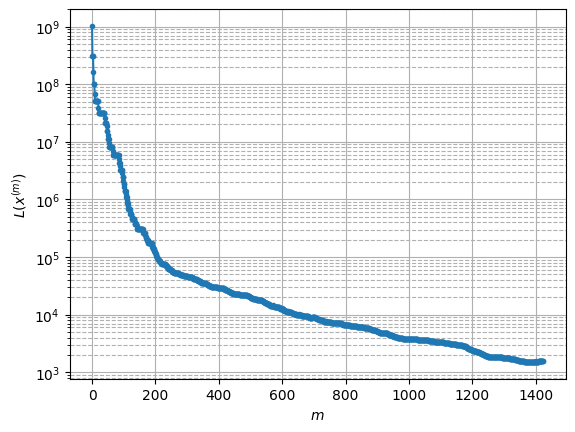

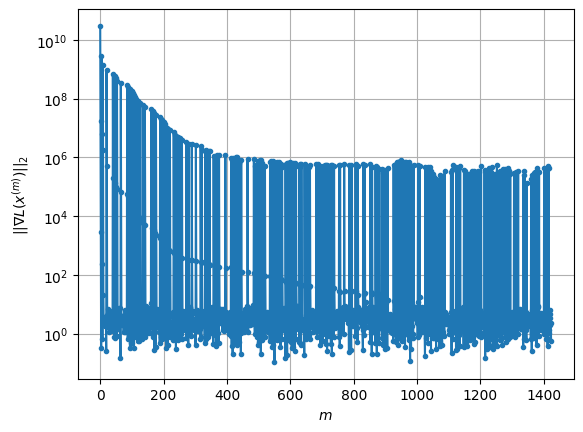

Windows:  41%|████      | 120/296 [1:00:57<50:12, 17.12s/it]


Majorization-Minimization Iteration 1
Before applying the algorithm
Cost function: 1606.3458485730243
Gradient norm: 438730.22632121074
Global relative error: 26.64275603184231
Position relative errors: 0.045042921308459626 m, 12.27864682755595 m, 10.882961649815616 m, 20.991068924418936 m

Iteration 1
Cost function: 1598.5832108467343 (-0.48%)
Gradient norm: 3.281502678090012 (-100.00%)
Global relative error = 26.538272734673 (-0.39%)
Position relative errors: 0.053878014307563046 m, 12.22446518735153 m, 10.85161807611791 m, 20.906373415533473 m

Iteration 2
Cost function: 1598.5832117428226 (0.00%)
Gradient norm: 5.471321894285234 (66.73%)
Global relative error = 26.538272651948233 (-0.00%)
Position relative errors: 0.05387799257138146 m, 12.224465094303772 m, 10.85161799265488 m, 20.90637340830938 m

STOP on Iteration 3
Cost function = 1598.583210761215 (-0.00%)
Gradient norm = 0.8986501789572857 (-83.58%)
Global relative error = 26.53827265308174 (0.00%)
Final position relative er

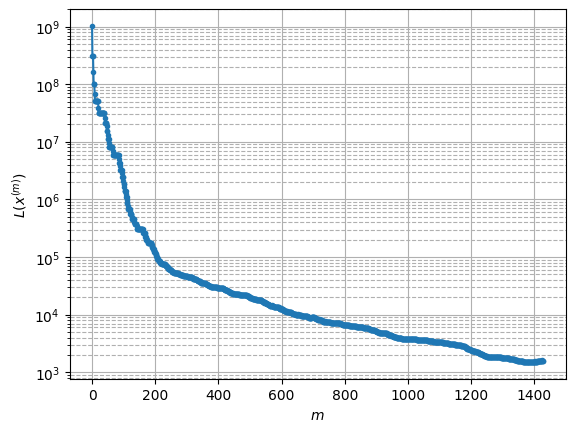

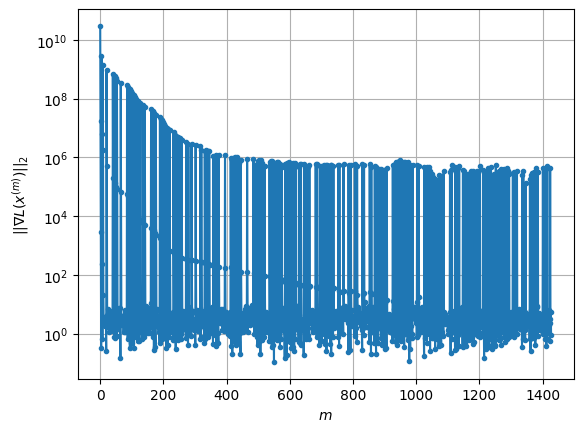

Windows:  41%|████      | 121/296 [1:01:08<44:08, 15.13s/it]


Majorization-Minimization Iteration 1
Before applying the algorithm
Cost function: 1636.9232741059282
Gradient norm: 623812.7185791235
Global relative error: 30.71856279726534
Position relative errors: 0.050661414733655284 m, 14.838681233180225 m, 12.885518889772317 m, 23.609306693754082 m

Iteration 1
Cost function: 1627.854989175989 (-0.55%)
Gradient norm: 1.0232189549345792 (-100.00%)
Global relative error = 30.604260966606148 (-0.37%)
Position relative errors: 0.06399224263534843 m, 14.776720343574741 m, 12.855375953131908 m, 23.515940217184156 m

STOP on Iteration 2
Cost function = 1627.85498930737 (0.00%)
Gradient norm = 0.5742793402519941 (-43.88%)
Global relative error = 30.604260882704377 (-0.00%)
Final position relative errors: 0.06399221732161459 m, 14.776720247136856 m, 12.855375898312936 m, 23.515940198627625 m

Majorization-Minimization converged after 1 iterations


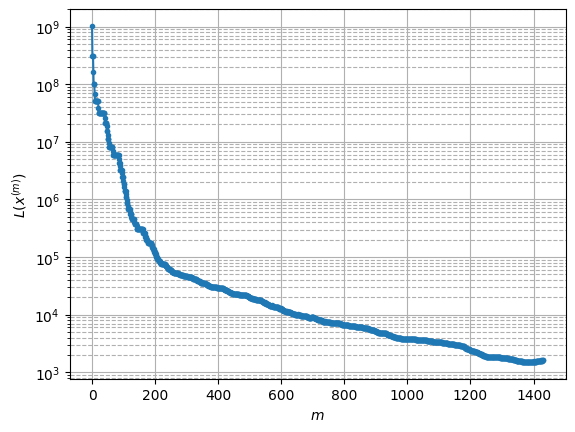

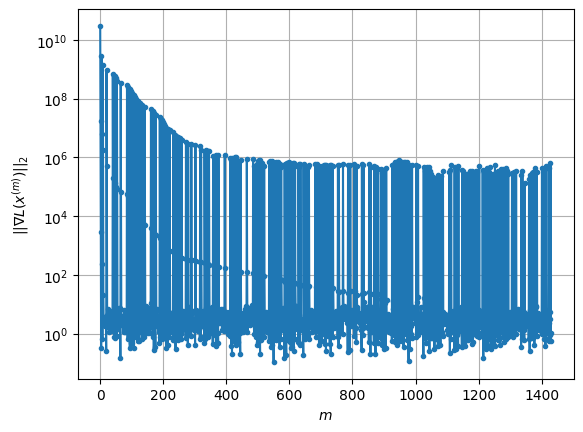

Windows:  41%|████      | 122/296 [1:01:16<37:33, 12.95s/it]


Majorization-Minimization Iteration 1
Before applying the algorithm
Cost function: 1700.7656806303783
Gradient norm: 485408.7315988911
Global relative error: 34.68398426646445
Position relative errors: 0.060144282067810764 m, 17.3240629815317 m, 14.859317525552635 m, 26.116046782587016 m

Iteration 1
Cost function: 1691.1800142272607 (-0.56%)
Gradient norm: 1.29142448099627 (-100.00%)
Global relative error = 34.55176879356682 (-0.38%)
Position relative errors: 0.05283709032513908 m, 17.255120444101706 m, 14.801558798748585 m, 26.019067157283583 m

Iteration 2
Cost function: 1691.180014481413 (0.00%)
Gradient norm: 4.312889483952535 (233.96%)
Global relative error = 34.55176872195476 (-0.00%)
Position relative errors: 0.052837069091567594 m, 17.255120355796596 m, 14.801558766827897 m, 26.019067138950614 m

Iteration 3
Cost function: 1691.18001441751 (-0.00%)
Gradient norm: 5.591248355987394 (29.64%)
Global relative error = 34.551768722495055 (0.00%)
Position relative errors: 0.05283708

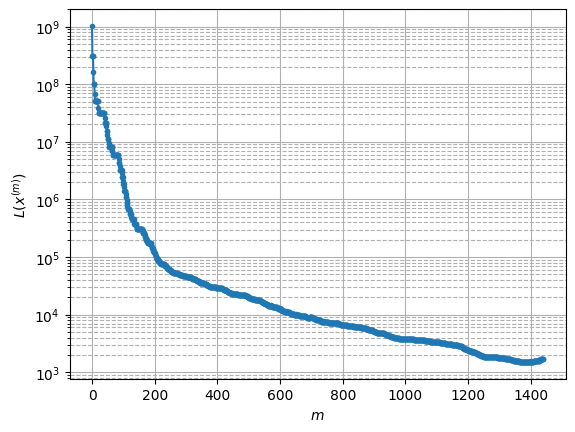

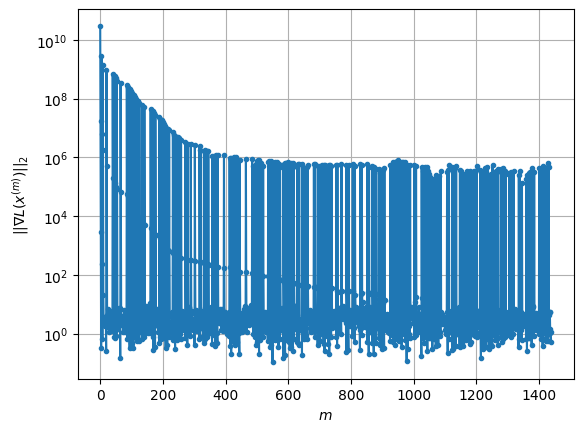

Windows:  42%|████▏     | 123/296 [1:01:39<45:48, 15.89s/it]


Majorization-Minimization Iteration 1
Before applying the algorithm
Cost function: 1745.9071737170132
Gradient norm: 521717.2059341241
Global relative error: 38.50177806543066
Position relative errors: 0.04951703996050306 m, 19.724646005540645 m, 16.75747275776543 m, 28.504482170490235 m

Iteration 1
Cost function: 1734.6886659306251 (-0.64%)
Gradient norm: 4.071332502667717 (-100.00%)
Global relative error = 38.3484251057349 (-0.40%)
Position relative errors: 0.0469963147870093 m, 19.6494246910843 m, 16.663496850933882 m, 28.404631541293632 m

Iteration 2
Cost function: 1734.6886668461466 (0.00%)
Gradient norm: 3.785982576893559 (-7.01%)
Global relative error = 38.348425036746825 (-0.00%)
Position relative errors: 0.04699628722306922 m, 19.649424607008566 m, 16.663496802867524 m, 28.404631534559098 m

Iteration 3
Cost function: 1734.6886672484313 (0.00%)
Gradient norm: 2.7679615458705533 (-26.89%)
Global relative error = 38.34842503644617 (-0.00%)
Position relative errors: 0.04699628

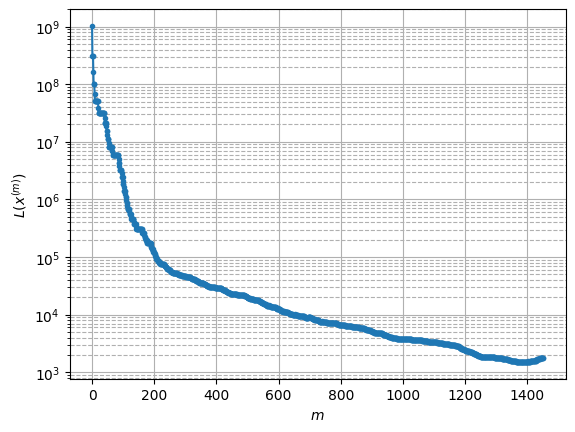

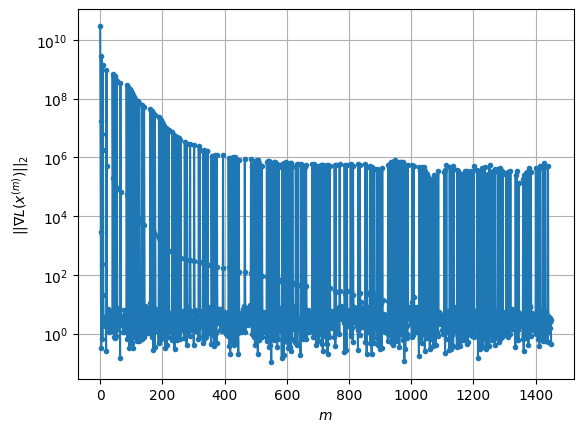

Windows:  42%|████▏     | 124/296 [1:02:06<55:51, 19.49s/it]


Majorization-Minimization Iteration 1
Before applying the algorithm
Cost function: 1773.6651198405164
Gradient norm: 524552.0162146465
Global relative error: 42.146055462109736
Position relative errors: 0.044061921063544625 m, 22.030907802597426 m, 18.55944625545381 m, 30.7647539814888 m

Iteration 1
Cost function: 1761.8971615981277 (-0.66%)
Gradient norm: 1.6786969927332578 (-100.00%)
Global relative error = 41.98098215661494 (-0.39%)
Position relative errors: 0.045057856029941994 m, 21.95260546271707 m, 18.441821770026447 m, 30.665602115285257 m

Iteration 2
Cost function: 1761.8971633486526 (0.00%)
Gradient norm: 2.7217712045078457 (62.14%)
Global relative error = 41.98098206405263 (-0.00%)
Position relative errors: 0.04505783323929198 m, 21.95260531911559 m, 18.4418217257467 m, 30.665602118031025 m

Iteration 3
Cost function: 1761.8971636126473 (0.00%)
Gradient norm: 1.7417206552206612 (-36.01%)
Global relative error = 41.980982064546836 (0.00%)
Position relative errors: 0.045057

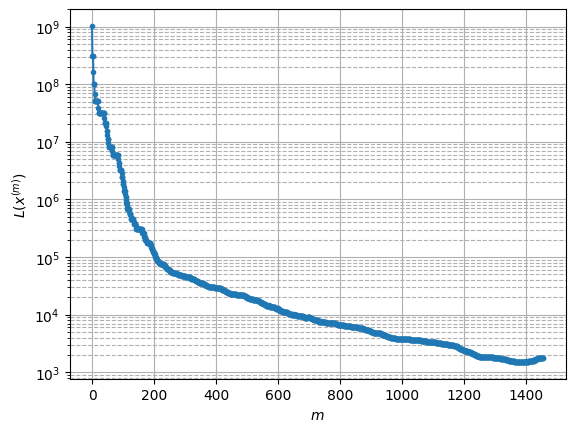

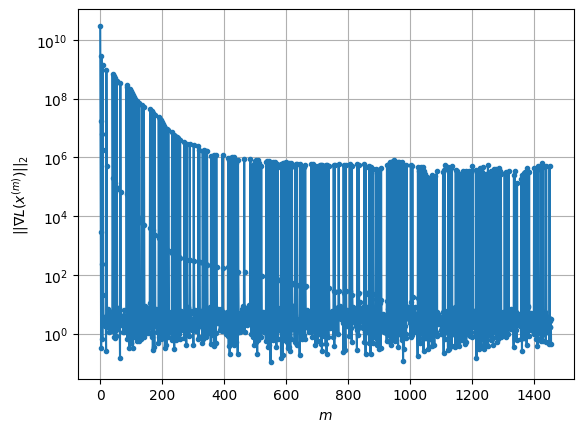

Windows:  42%|████▏     | 125/296 [1:02:24<54:07, 18.99s/it]


Majorization-Minimization Iteration 1
Before applying the algorithm
Cost function: 1853.2419801296505
Gradient norm: 690942.6827921724
Global relative error: 45.60526373052116
Position relative errors: 0.04216496827602028 m, 24.23646146452457 m, 20.265076027393413 m, 32.890048846618754 m

Iteration 1
Cost function: 1840.691622368151 (-0.68%)
Gradient norm: 4.487511654225606 (-100.00%)
Global relative error = 45.423589924667716 (-0.40%)
Position relative errors: 0.05290724126429628 m, 24.1532488043662 m, 20.114757927871988 m, 32.79196859106919 m

STOP on Iteration 2
Cost function = 1840.691622595268 (0.00%)
Gradient norm = 0.58988484061237 (-86.85%)
Global relative error = 45.42358984474465 (-0.00%)
Final position relative errors: 0.0529072138461624 m, 24.153248680914007 m, 20.11475789785331 m, 32.79196858974728 m

Majorization-Minimization converged after 1 iterations


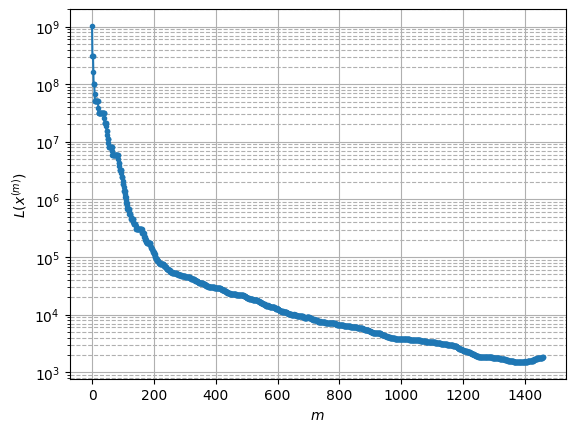

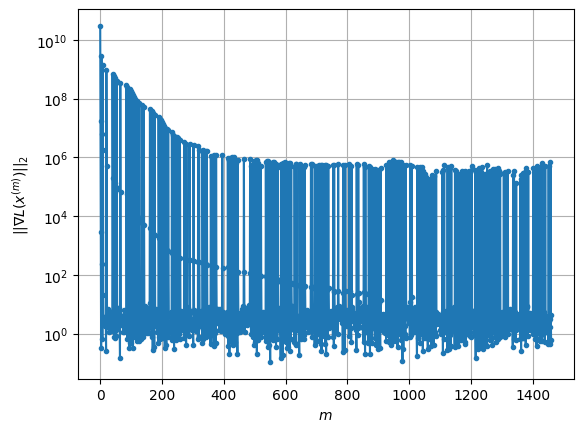

Windows:  43%|████▎     | 126/296 [1:02:32<44:22, 15.66s/it]


Majorization-Minimization Iteration 1
Before applying the algorithm
Cost function: 1935.3105295417747
Gradient norm: 504096.600783462
Global relative error: 48.85628828934501
Position relative errors: 0.04943168773754283 m, 26.32994544507403 m, 21.855575850028227 m, 34.87117759643813 m

STOP on Iteration 1
Cost function = 1921.1519315951155 (-0.73%)
Gradient norm = 0.8864067089544467 (-100.00%)
Global relative error = 48.65621770714285 (-0.41%)
Final position relative errors: 0.05109341782521579 m, 26.24990321742704 m, 21.659729185534555 m, 34.77384684730973 m

Majorization-Minimization converged after 1 iterations


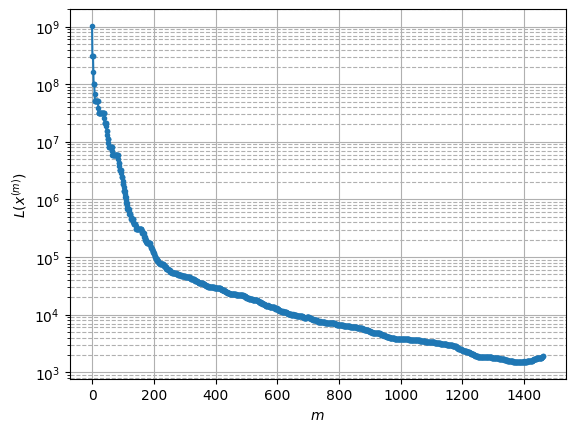

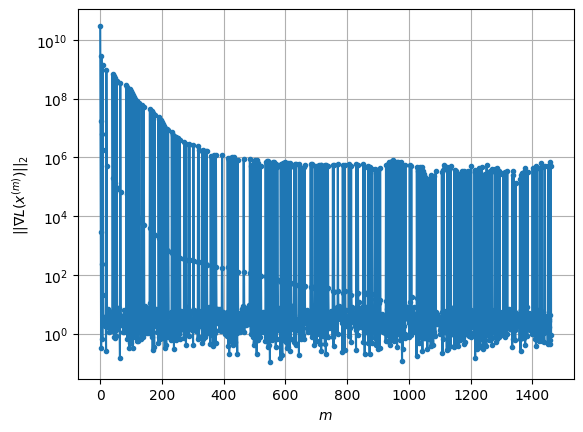

Windows:  43%|████▎     | 127/296 [1:02:38<35:44, 12.69s/it]


Majorization-Minimization Iteration 1
Before applying the algorithm
Cost function: 2030.4221340063013
Gradient norm: 501316.9808852661
Global relative error: 51.8811627562857
Position relative errors: 0.04783486552551784 m, 28.310602505763523 m, 23.309375688822062 m, 36.699219951593705 m

Iteration 1
Cost function: 2013.7387788159851 (-0.82%)
Gradient norm: 2.391637079099704 (-100.00%)
Global relative error = 51.66263133121143 (-0.42%)
Position relative errors: 0.046123975275329875 m, 28.23284637204366 m, 23.066863546541153 m, 36.60394440068284 m

Iteration 2
Cost function: 2013.7387772010932 (-0.00%)
Gradient norm: 5.139363914716049 (114.89%)
Global relative error = 51.66263131845582 (-0.00%)
Position relative errors: 0.046123926867165994 m, 28.232846260940537 m, 23.066863644986622 m, 36.6039444063975 m

Iteration 3
Cost function: 2013.7387770126277 (-0.00%)
Gradient norm: 8.216199215710368 (59.87%)
Global relative error = 51.66263131917387 (0.00%)
Position relative errors: 0.0461239

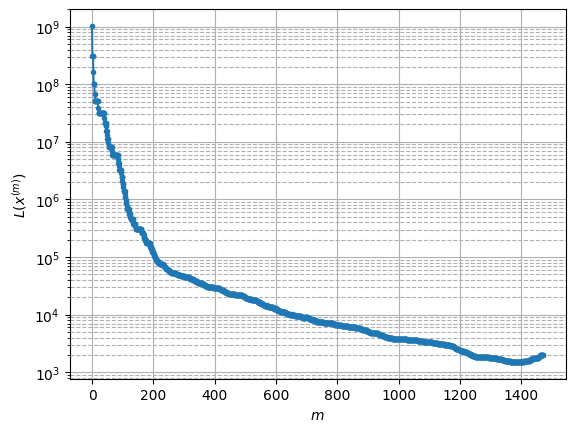

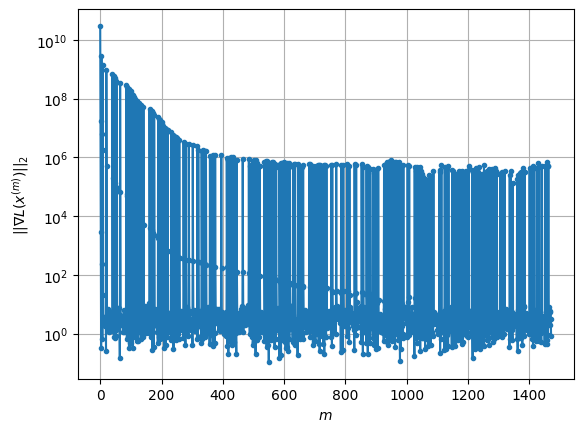

Windows:  43%|████▎     | 128/296 [1:03:03<45:45, 16.34s/it]


Majorization-Minimization Iteration 1
Before applying the algorithm
Cost function: 2139.0887348143488
Gradient norm: 666550.9663619905
Global relative error: 54.665091614790846
Position relative errors: 0.04308045975143288 m, 30.16907791628906 m, 24.617601524136113 m, 38.36754370544417 m

Iteration 1
Cost function: 2119.743856396014 (-0.90%)
Gradient norm: 3.0719165443309233 (-100.00%)
Global relative error = 54.42834031476411 (-0.43%)
Position relative errors: 0.036854374993503844 m, 30.09287297016791 m, 24.326760316959593 m, 38.27620934668525 m

Iteration 2
Cost function: 2119.74385513435 (-0.00%)
Gradient norm: 2.9703458101749485 (-3.31%)
Global relative error = 54.428340358702044 (0.00%)
Position relative errors: 0.03685433252569504 m, 30.092872803814526 m, 24.326760611147712 m, 38.27620935301945 m

Iteration 3
Cost function: 2119.7438545704817 (-0.00%)
Gradient norm: 8.923600555439258 (200.42%)
Global relative error = 54.42834035916248 (0.00%)
Position relative errors: 0.03685434

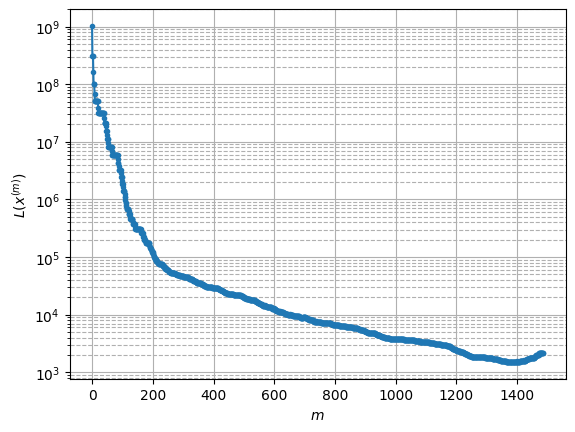

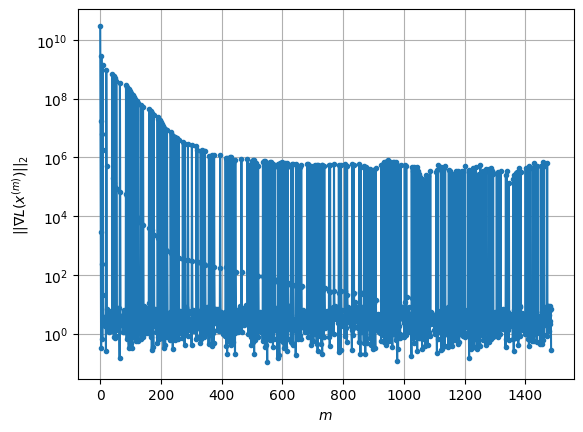

Windows:  44%|████▎     | 129/296 [1:03:39<1:02:02, 22.29s/it]


Majorization-Minimization Iteration 1
Before applying the algorithm
Cost function: 2313.794807771604
Gradient norm: 464080.4736196588
Global relative error: 57.1947914712425
Position relative errors: 0.03463130600563115 m, 31.89670776609588 m, 25.771169436830196 m, 39.87088922358201 m

Iteration 1
Cost function: 2291.4896988959445 (-0.96%)
Gradient norm: 3.9825957571611945 (-100.00%)
Global relative error = 56.93393898543257 (-0.46%)
Position relative errors: 0.031882629476339325 m, 31.827420709833003 m, 25.42076866408647 m, 39.77775996431334 m

Iteration 2
Cost function: 2291.489698629226 (-0.00%)
Gradient norm: 4.6040077248135205 (15.60%)
Global relative error = 56.933939266424495 (0.00%)
Position relative errors: 0.03188259094935779 m, 31.827420518468692 m, 25.420769537975833 m, 39.777759961168535 m

Iteration 3
Cost function: 2291.489698463021 (-0.00%)
Gradient norm: 4.527708969122348 (-1.66%)
Global relative error = 56.933939266549174 (0.00%)
Position relative errors: 0.031882589

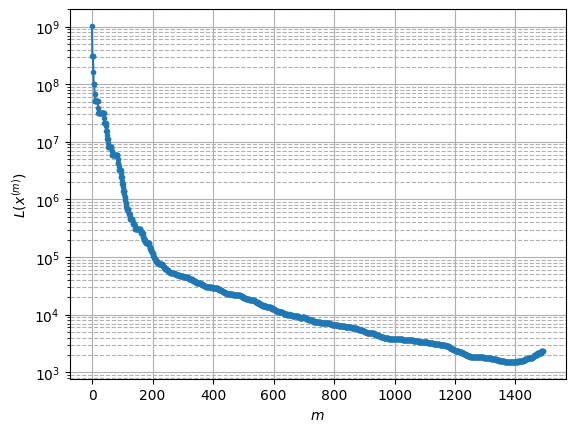

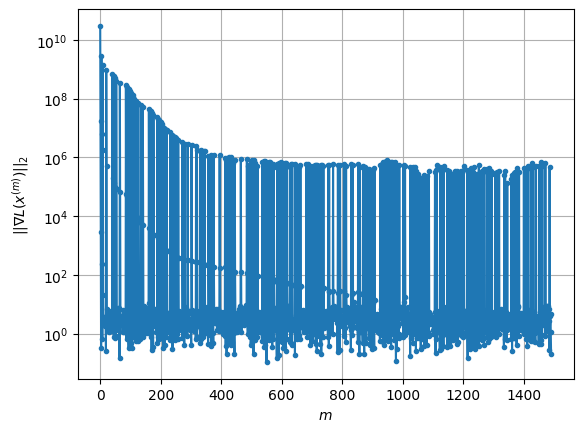

Windows:  44%|████▍     | 130/296 [1:03:54<55:58, 20.23s/it]  


Majorization-Minimization Iteration 1
Before applying the algorithm
Cost function: 2523.6229873892294
Gradient norm: 422697.8633020573
Global relative error: 59.452309396040086
Position relative errors: 0.030876780911268203 m, 33.49152241329011 m, 26.751943309032598 m, 41.197402031184005 m

Iteration 1
Cost function: 2493.6821701759113 (-1.19%)
Gradient norm: 2.4001170422908324 (-100.00%)
Global relative error = 59.16019141315085 (-0.49%)
Position relative errors: 0.027635467136697935 m, 33.421892800121704 m, 26.32303956210572 m, 41.10961567666612 m

Iteration 2
Cost function: 2493.6821707133245 (0.00%)
Gradient norm: 1.5082789377328634 (-37.16%)
Global relative error = 59.16019186060103 (0.00%)
Position relative errors: 0.02763543439928524 m, 33.42189262422241 m, 26.323040780378157 m, 41.109615683535786 m

Iteration 3
Cost function: 2493.682171633346 (0.00%)
Gradient norm: 1.623084998475144 (7.61%)
Global relative error = 59.16019186104066 (0.00%)
Position relative errors: 0.02763543

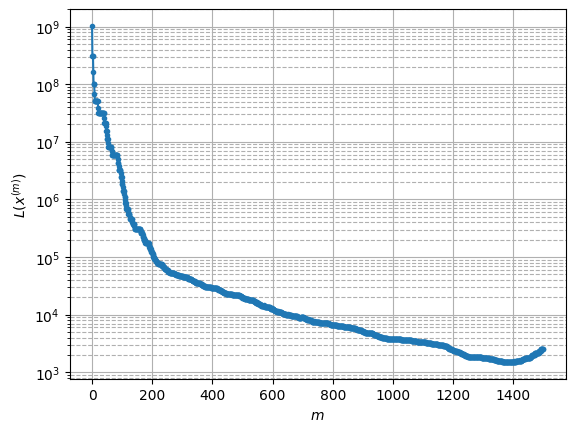

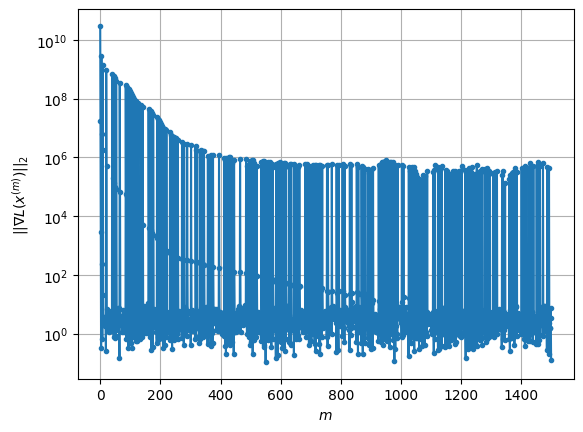

Windows:  44%|████▍     | 131/296 [1:04:15<55:58, 20.35s/it]


Majorization-Minimization Iteration 1
Before applying the algorithm
Cost function: 2782.2521692810355
Gradient norm: 354182.4046540467
Global relative error: 61.420259515114466
Position relative errors: 0.027642403789771612 m, 34.93952209844162 m, 27.536767008904818 m, 42.3485826200282 m

Iteration 1
Cost function: 2744.82494630791 (-1.35%)
Gradient norm: 3.291967762810065 (-100.00%)
Global relative error = 61.094581968846825 (-0.53%)
Position relative errors: 0.029303988837258446 m, 34.87175978868663 m, 27.022280814495982 m, 42.26467176177624 m

Iteration 2
Cost function: 2744.8249443447203 (-0.00%)
Gradient norm: 2.8822890857453096 (-12.44%)
Global relative error = 61.09458285911972 (0.00%)
Position relative errors: 0.029303931849808982 m, 34.87175962621683 m, 27.022283024803514 m, 42.26467176959818 m

Iteration 3
Cost function: 2744.824946076952 (0.00%)
Gradient norm: 5.741042963738268 (99.18%)
Global relative error = 61.09458285937681 (0.00%)
Position relative errors: 0.0293039283

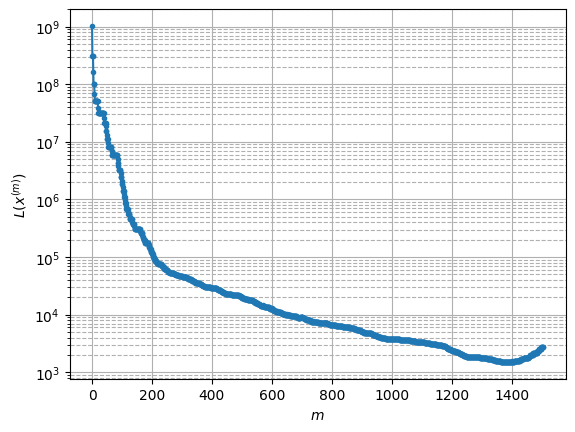

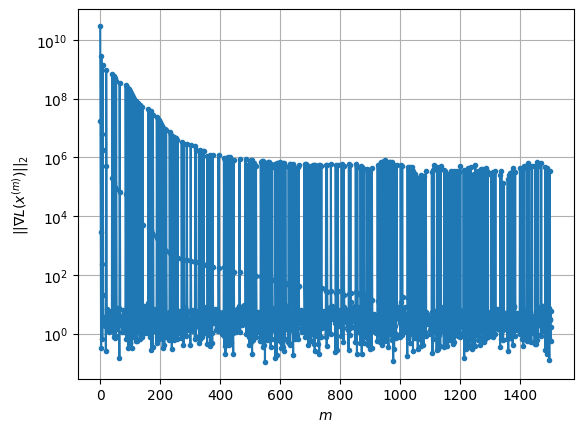

Windows:  45%|████▍     | 132/296 [1:04:30<51:25, 18.81s/it]


Majorization-Minimization Iteration 1
Before applying the algorithm
Cost function: 3077.5570121569444
Gradient norm: 300104.87198413536
Global relative error: 63.08722469045801
Position relative errors: 0.02940565780047215 m, 36.23674246362401 m, 28.114246405421294 m, 43.31839888366748 m

Iteration 1
Cost function: 3027.9600754126445 (-1.61%)
Gradient norm: 8.48464783115062 (-100.00%)
Global relative error = 62.72331102080588 (-0.58%)
Position relative errors: 0.03456976462161605 m, 36.1701208401633 m, 27.501108868598415 m, 43.2391362917956 m

Iteration 2
Cost function: 3027.9600791226285 (0.00%)
Gradient norm: 1.048526334962307 (-87.64%)
Global relative error = 62.72331260672659 (0.00%)
Position relative errors: 0.03456966967061647 m, 36.17012069201296 m, 27.501112670887228 m, 43.23913629801571 m

Iteration 3
Cost function: 3027.9600775149843 (-0.00%)
Gradient norm: 3.657970607919151 (248.87%)
Global relative error = 62.723312606324434 (-0.00%)
Position relative errors: 0.03456966626

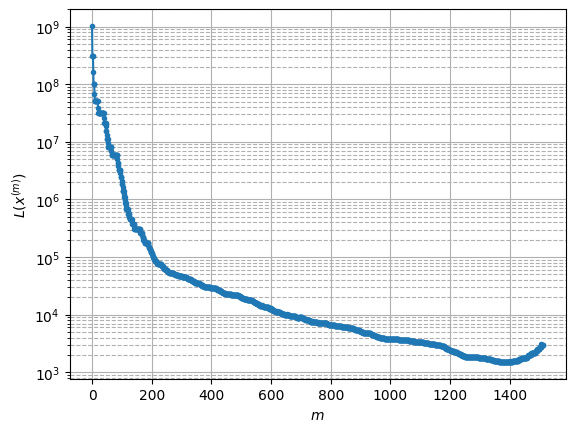

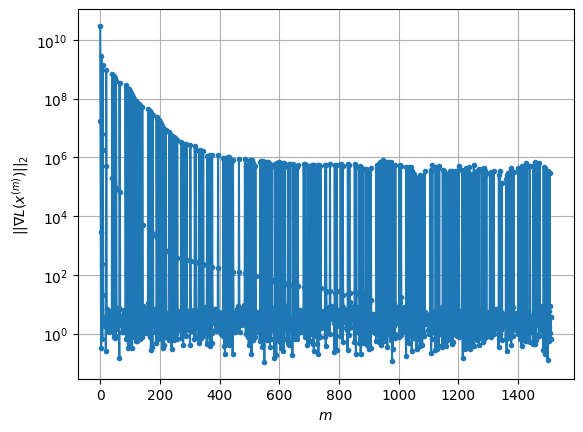

Windows:  45%|████▍     | 133/296 [1:04:45<48:09, 17.72s/it]


Majorization-Minimization Iteration 1
Before applying the algorithm
Cost function: 3399.3010790364942
Gradient norm: 329605.3167815222
Global relative error: 64.44074668761127
Position relative errors: 0.0351295065135303 m, 37.37695036970829 m, 28.468179080490145 m, 44.10367572493473 m

Iteration 1
Cost function: 3334.6425994060755 (-1.90%)
Gradient norm: 16.22387268856952 (-100.00%)
Global relative error = 64.03485668426079 (-0.63%)
Position relative errors: 0.03686888554854866 m, 37.31411559224657 m, 27.744394539869692 m, 44.02687947058661 m

STOP on Iteration 2
Cost function = 3334.6425995095115 (0.00%)
Gradient norm = 0.9926125319766322 (-93.88%)
Global relative error = 64.03485922657518 (0.00%)
Final position relative errors: 0.03686874703483716 m, 37.31411544371062 m, 27.74440059985762 m, 44.02687947543925 m

Majorization-Minimization converged after 1 iterations


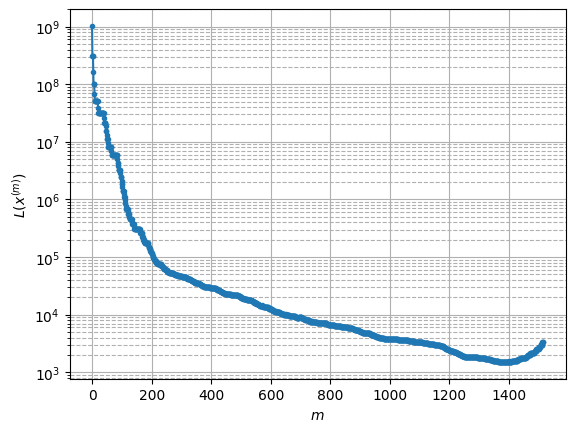

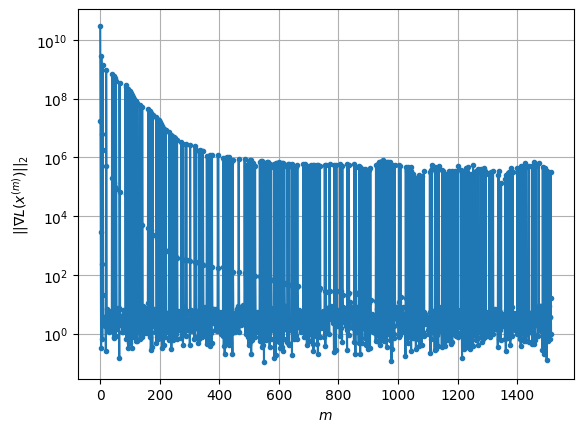

Windows:  45%|████▌     | 134/296 [1:04:53<39:55, 14.79s/it]


Majorization-Minimization Iteration 1
Before applying the algorithm
Cost function: 3691.901731456594
Gradient norm: 353690.9440410694
Global relative error: 65.4709170649081
Position relative errors: 0.03796447940482529 m, 38.35790907966798 m, 28.58474591833753 m, 44.69924084982304 m

Iteration 1
Cost function: 3611.547154932631 (-2.18%)
Gradient norm: 14.231782453080259 (-100.00%)
Global relative error = 65.02666490503793 (-0.68%)
Position relative errors: 0.041214204483751266 m, 38.29893007092918 m, 27.751417237976984 m, 44.626401711598554 m

STOP on Iteration 2
Cost function = 3611.5471555957342 (0.00%)
Gradient norm = 0.8428168153522786 (-94.08%)
Global relative error = 65.02666834989472 (0.00%)
Final position relative errors: 0.0412139973476851 m, 38.29892995652759 m, 27.751425445636254 m, 44.626401725567284 m

Majorization-Minimization converged after 1 iterations


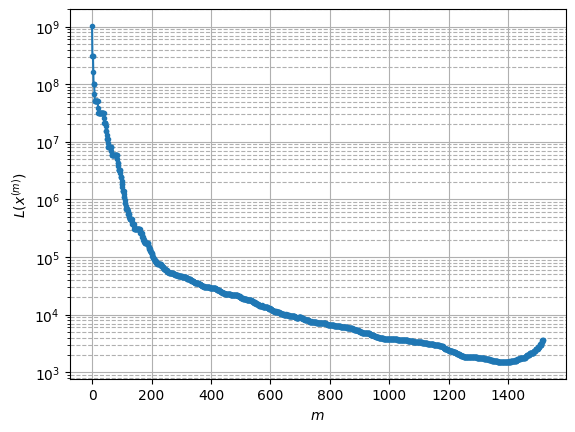

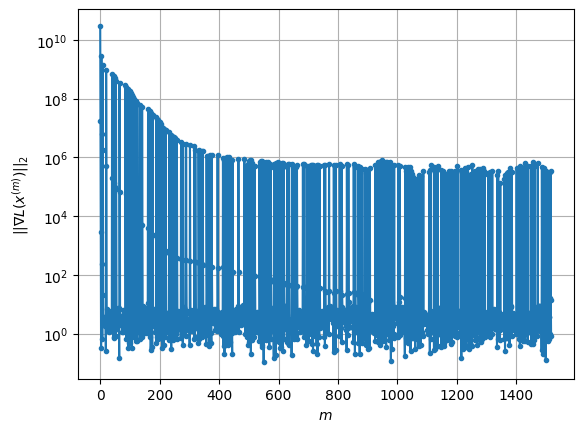

Windows:  46%|████▌     | 135/296 [1:05:02<34:20, 12.80s/it]


Majorization-Minimization Iteration 1
Before applying the algorithm
Cost function: 3823.3709006281993
Gradient norm: 159666.57073770592
Global relative error: 66.17691682364092
Position relative errors: 0.04230131123436882 m, 39.1753328316059 m, 28.465032190964028 m, 45.10451680889528 m

Iteration 1
Cost function: 3734.1436511326233 (-2.33%)
Gradient norm: 11.670046149695596 (-99.99%)
Global relative error = 65.71416013479242 (-0.70%)
Position relative errors: 0.04851042490689358 m, 39.116028914034175 m, 27.57501855094781 m, 45.0322416675825 m

Iteration 2
Cost function: 3734.1436522841814 (0.00%)
Gradient norm: 1.0378174219717877 (-91.11%)
Global relative error = 65.71416475020894 (0.00%)
Position relative errors: 0.048510072743982925 m, 39.11602883688981 m, 27.575029644000328 m, 45.03224167739186 m

Iteration 3
Cost function: 3734.143652359253 (0.00%)
Gradient norm: 4.6991313669718755 (352.79%)
Global relative error = 65.71416475020538 (-0.00%)
Position relative errors: 0.0485100728

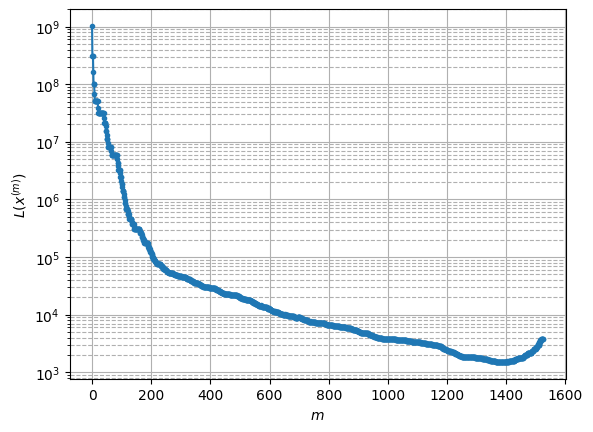

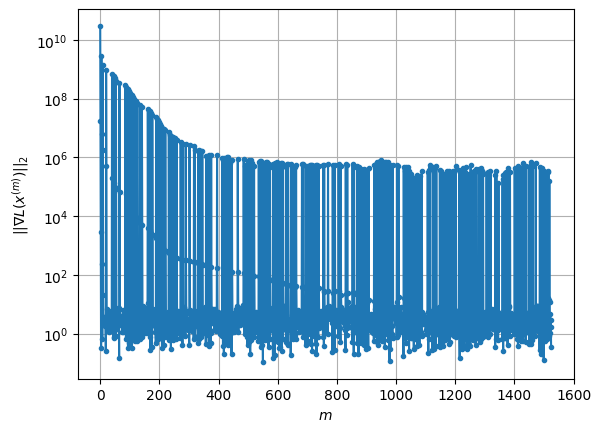

Windows:  46%|████▌     | 136/296 [1:05:21<39:35, 14.85s/it]


Majorization-Minimization Iteration 1
Before applying the algorithm
Cost function: 3780.1201156327893
Gradient norm: 150975.86716175545
Global relative error: 66.57648709567175
Position relative errors: 0.049534541634483696 m, 39.82148097307228 m, 28.16436139082042 m, 45.314946605430215 m

Iteration 1
Cost function: 3690.891755260645 (-2.36%)
Gradient norm: 6.843033257885692 (-100.00%)
Global relative error = 66.11820334588492 (-0.69%)
Position relative errors: 0.04893598825813549 m, 39.76282931147223 m, 27.268949459757298 m, 45.24307708657822 m

Iteration 2
Cost function: 3690.8917537943958 (-0.00%)
Gradient norm: 4.688971615545242 (-31.48%)
Global relative error = 66.1182087532492 (0.00%)
Position relative errors: 0.04893556912267378 m, 39.76282925251254 m, 27.268962636590157 m, 45.24307709921421 m

Iteration 3
Cost function: 3690.891754552889 (0.00%)
Gradient norm: 2.576030305917177 (-45.06%)
Global relative error = 66.11820875321429 (-0.00%)
Position relative errors: 0.04893556932

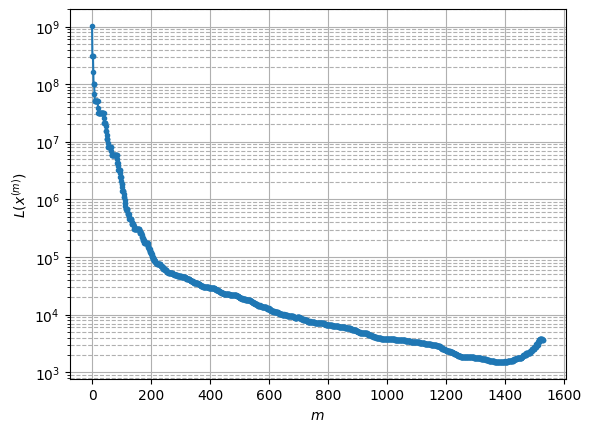

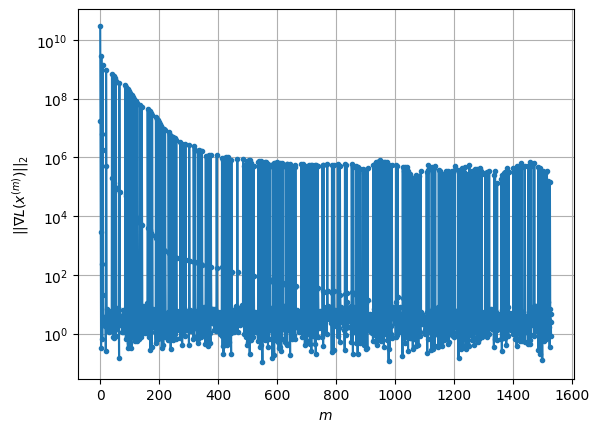

Windows:  46%|████▋     | 137/296 [1:05:33<37:13, 14.04s/it]


Majorization-Minimization Iteration 1
Before applying the algorithm
Cost function: 3607.831089856549
Gradient norm: 193856.47945688697
Global relative error: 66.6924534976794
Position relative errors: 0.04984019708175246 m, 40.29463297515825 m, 27.738329693700255 m, 45.329994329550594 m

Iteration 1
Cost function: 3523.6585482803625 (-2.33%)
Gradient norm: 6.655615277449472 (-100.00%)
Global relative error = 66.25340178701998 (-0.66%)
Position relative errors: 0.05291665978337969 m, 40.23513849708209 m, 26.873225837505125 m, 45.26006747302241 m

Iteration 2
Cost function: 3523.6585480790527 (-0.00%)
Gradient norm: 1.8113342626251117 (-72.78%)
Global relative error = 66.2534071462263 (0.00%)
Position relative errors: 0.05291627848287619 m, 40.235138415079035 m, 26.8732391443926 m, 45.26006749039285 m

STOP on Iteration 3
Cost function = 3523.658547939755 (-0.00%)
Gradient norm = 0.5703558278159966 (-68.51%)
Global relative error = 66.25340714642093 (0.00%)
Final position relative error

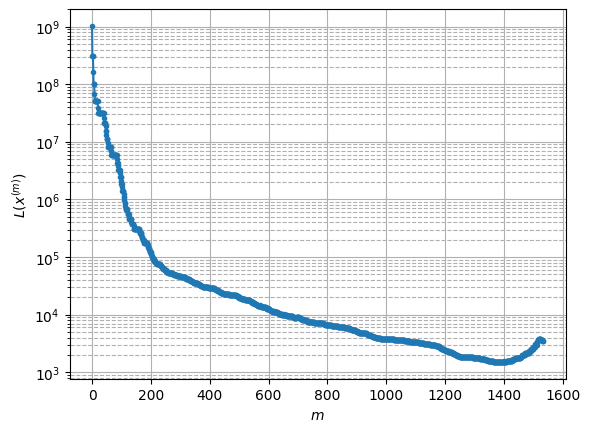

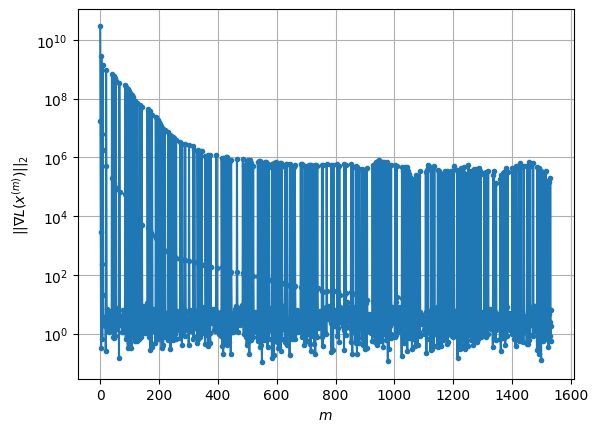

Windows:  47%|████▋     | 138/296 [1:05:43<33:54, 12.88s/it]


Majorization-Minimization Iteration 1
Before applying the algorithm
Cost function: 3457.628461941177
Gradient norm: 257268.63041173588
Global relative error: 66.54084948075797
Position relative errors: 0.05365774957108265 m, 40.591357554162244 m, 27.22798311758322 m, 45.15152644448114 m

Iteration 1
Cost function: 3379.5434149841335 (-2.26%)
Gradient norm: 15.747319071319087 (-99.99%)
Global relative error = 66.12191442358191 (-0.63%)
Position relative errors: 0.05371283431627453 m, 40.5306796527918 m, 26.400524351527125 m, 45.08193589817065 m

Iteration 2
Cost function: 3379.5434143618345 (-0.00%)
Gradient norm: 5.275992585576881 (-66.50%)
Global relative error = 66.1219192543292 (0.00%)
Position relative errors: 0.053712629488558594 m, 40.53067963056111 m, 26.40053645881012 m, 45.08193591351214 m

STOP on Iteration 3
Cost function = 3379.5434148295108 (0.00%)
Gradient norm = 0.38405332128442526 (-92.72%)
Global relative error = 66.12191925424302 (-0.00%)
Final position relative erro

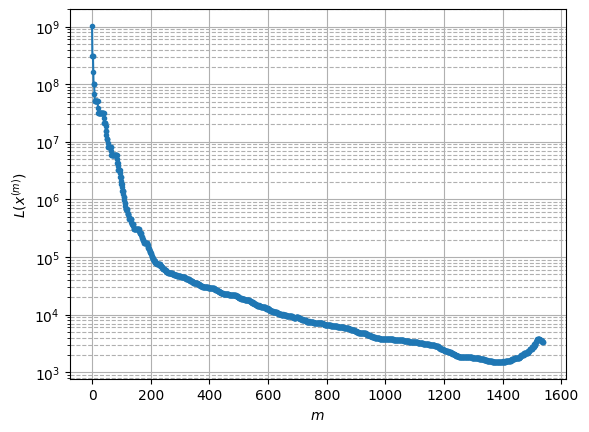

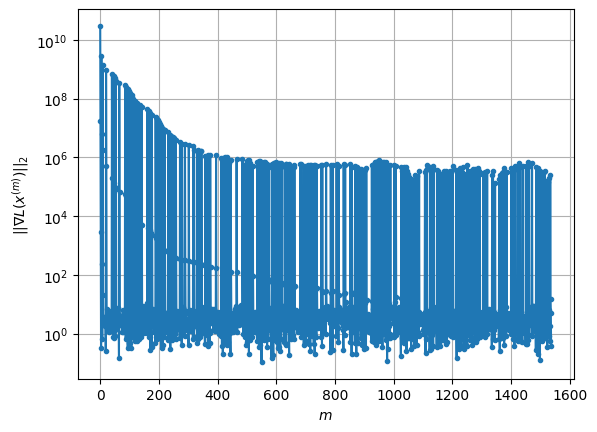

Windows:  47%|████▋     | 139/296 [1:05:54<31:37, 12.09s/it]


Majorization-Minimization Iteration 1
Before applying the algorithm
Cost function: 3312.009740338237
Gradient norm: 430810.2579349151
Global relative error: 66.12505504765714
Position relative errors: 0.05411679254761534 m, 40.710101860640066 m, 26.64619483047444 m, 44.7793236435501 m

Iteration 1
Cost function: 3238.8761023671036 (-2.21%)
Gradient norm: 15.598753212898458 (-100.00%)
Global relative error = 65.72706741206072 (-0.60%)
Position relative errors: 0.04891000636898994 m, 40.64926436020233 m, 25.857224064428774 m, 44.71114190520426 m

Iteration 2
Cost function: 3238.876102865785 (0.00%)
Gradient norm: 5.798814018417888 (-62.83%)
Global relative error = 65.7270718312983 (0.00%)
Position relative errors: 0.04890976328379322 m, 40.64926437607589 m, 25.857235236266238 m, 44.71114192661781 m

STOP on Iteration 3
Cost function = 3238.8761037989498 (0.00%)
Gradient norm = 0.6159552208685033 (-89.38%)
Global relative error = 65.72707183143802 (0.00%)
Final position relative errors: 

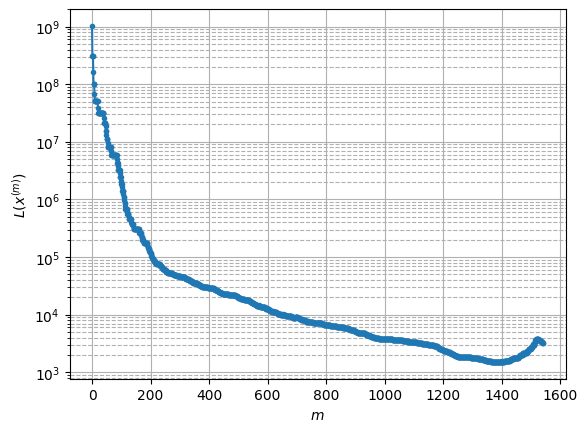

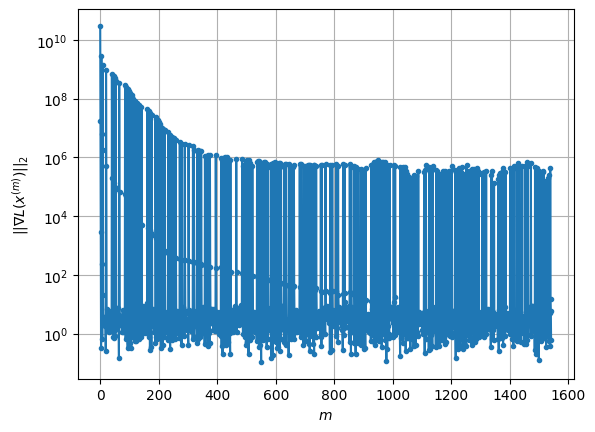

Windows:  47%|████▋     | 140/296 [1:06:04<29:46, 11.45s/it]


Majorization-Minimization Iteration 1
Before applying the algorithm
Cost function: 3179.0449931489975
Gradient norm: 434306.78216201544
Global relative error: 65.44939212679711
Position relative errors: 0.049134539846816185 m, 40.65155078166397 m, 25.999371910802534 m, 44.21656354869133 m

Iteration 1
Cost function: 3109.8990705856736 (-2.18%)
Gradient norm: 16.20896972417157 (-100.00%)
Global relative error = 65.07205413867862 (-0.58%)
Position relative errors: 0.056028927518739995 m, 40.588735775581476 m, 25.252990188715977 m, 44.14985846812752 m

STOP on Iteration 2
Cost function = 3109.899070177897 (-0.00%)
Gradient norm = 0.21284292058460152 (-98.69%)
Global relative error = 65.07205780790979 (0.00%)
Final position relative errors: 0.05602885125740414 m, 40.58873581529282 m, 25.252999537226582 m, 44.14985849256635 m

Majorization-Minimization converged after 1 iterations


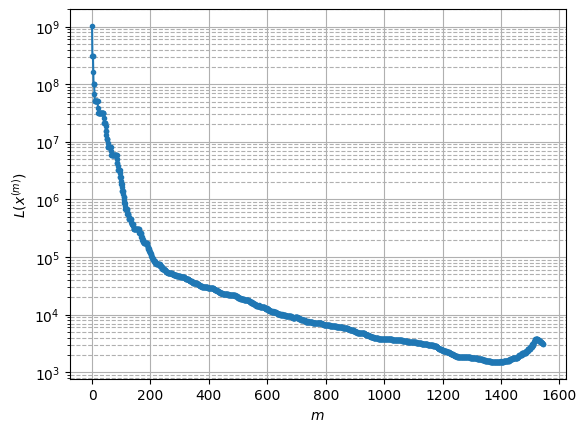

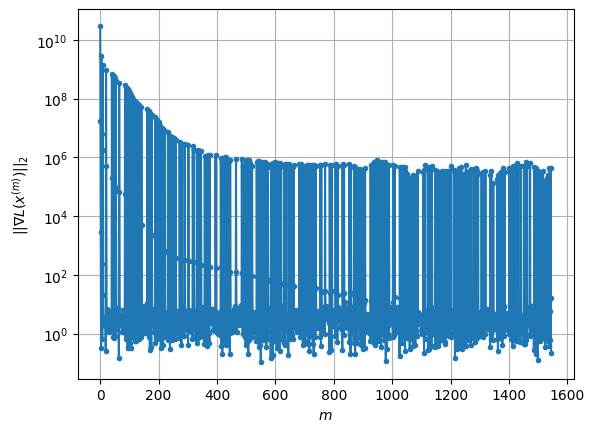

Windows:  48%|████▊     | 141/296 [1:06:11<26:41, 10.33s/it]


Majorization-Minimization Iteration 1
Before applying the algorithm
Cost function: 3043.566416775034
Gradient norm: 498550.9770007414
Global relative error: 64.51804687379837
Position relative errors: 0.05569333503877942 m, 40.41433036044866 m, 25.297125604835554 m, 43.46622158283575 m

Iteration 1
Cost function: 2977.841532878908 (-2.16%)
Gradient norm: 19.97873097359344 (-100.00%)
Global relative error = 64.16191292327372 (-0.55%)
Position relative errors: 0.07082377772503054 m, 40.35012166742177 m, 24.59397242598569 m, 43.40218966374435 m

Iteration 2
Cost function: 2977.8415323237878 (-0.00%)
Gradient norm: 3.3408517460976856 (-83.28%)
Global relative error = 64.16191606595154 (0.00%)
Position relative errors: 0.07082379797366221 m, 40.350121734984214 m, 24.593980469430452 m, 43.4021896889123 m

Iteration 3
Cost function: 2977.8415320761437 (-0.00%)
Gradient norm: 4.187945508588763 (25.36%)
Global relative error = 64.16191606618288 (0.00%)
Position relative errors: 0.0708237958697

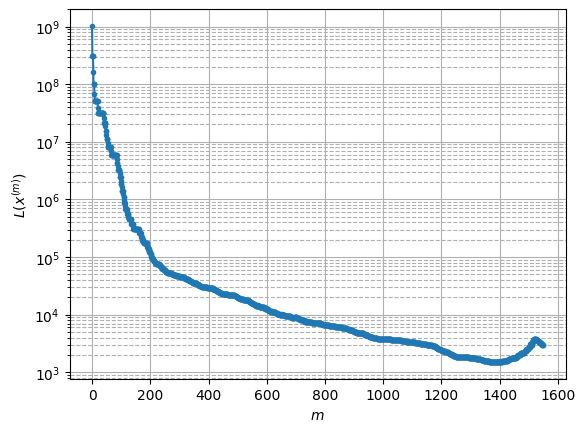

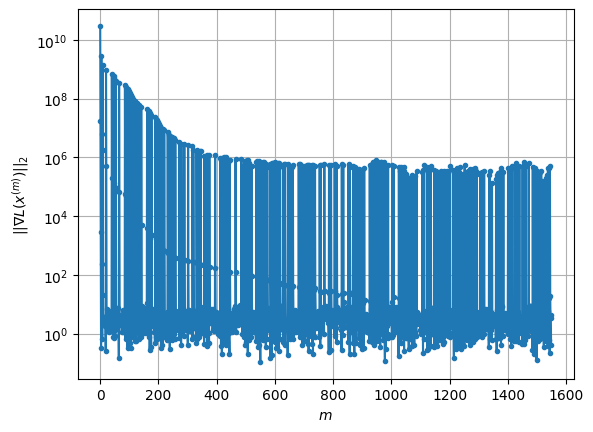

Windows:  48%|████▊     | 142/296 [1:06:24<28:22, 11.05s/it]


Majorization-Minimization Iteration 1
Before applying the algorithm
Cost function: 2941.8480111065487
Gradient norm: 464791.9609603072
Global relative error: 63.33702104001022
Position relative errors: 0.06971215023768042 m, 40.00028607043291 m, 24.545498995347817 m, 42.53314768616065 m

Iteration 1
Cost function: 2879.9164099372 (-2.11%)
Gradient norm: 17.42372159000988 (-100.00%)
Global relative error = 62.998271000208135 (-0.53%)
Position relative errors: 0.0747341012497752 m, 39.93535605396654 m, 23.878059571168723 m, 42.47095312510067 m

Iteration 2
Cost function: 2879.916410008989 (0.00%)
Gradient norm: 1.938125339966128 (-88.88%)
Global relative error = 62.9982738060141 (0.00%)
Position relative errors: 0.07473418586337674 m, 39.93535611236581 m, 23.878066826240698 m, 42.4709531530098 m

Iteration 3
Cost function: 2879.916410026416 (0.00%)
Gradient norm: 1.8094040953537942 (-6.64%)
Global relative error = 62.998273805907196 (-0.00%)
Position relative errors: 0.07473418701097641

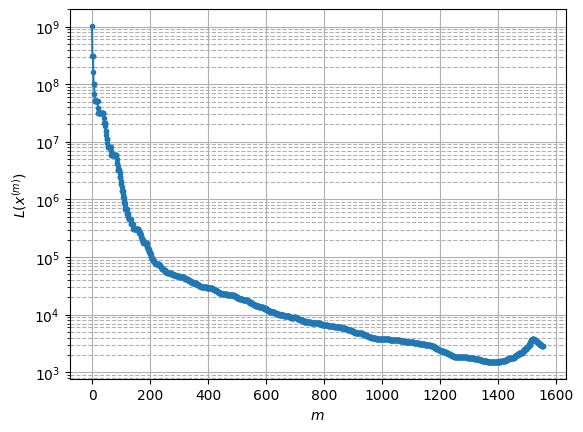

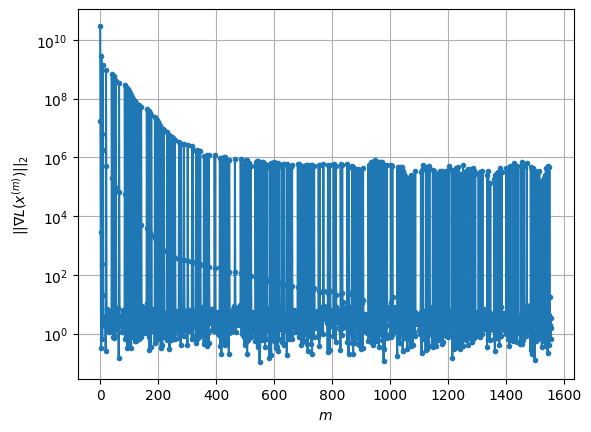

Windows:  48%|████▊     | 143/296 [1:06:41<32:52, 12.89s/it]


Majorization-Minimization Iteration 1
Before applying the algorithm
Cost function: 2849.344127787975
Gradient norm: 576601.1482211621
Global relative error: 61.90903874830274
Position relative errors: 0.07315457140425345 m, 39.41215781153087 m, 23.74227690229142 m, 41.42112207295084 m

Iteration 1
Cost function: 2789.983060444688 (-2.08%)
Gradient norm: 14.03104134573334 (-100.00%)
Global relative error = 61.58783999133201 (-0.52%)
Position relative errors: 0.06895049548808667 m, 39.34605005549906 m, 23.114565010513736 m, 41.36015035922894 m

Iteration 2
Cost function: 2789.9830585989916 (-0.00%)
Gradient norm: 3.981714052881417 (-71.62%)
Global relative error = 61.58784245791809 (0.00%)
Position relative errors: 0.06895059456120714 m, 39.346050137757004 m, 23.114571374670515 m, 41.36015039703333 m

STOP on Iteration 3
Cost function = 2789.98305854604 (-0.00%)
Gradient norm = 0.7702812812800218 (-80.65%)
Global relative error = 61.587842458355354 (0.00%)
Final position relative errors

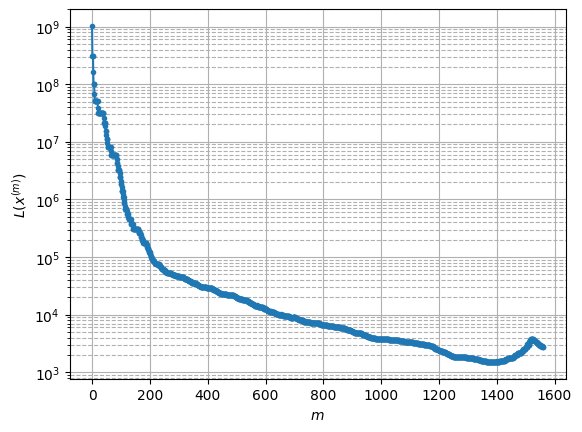

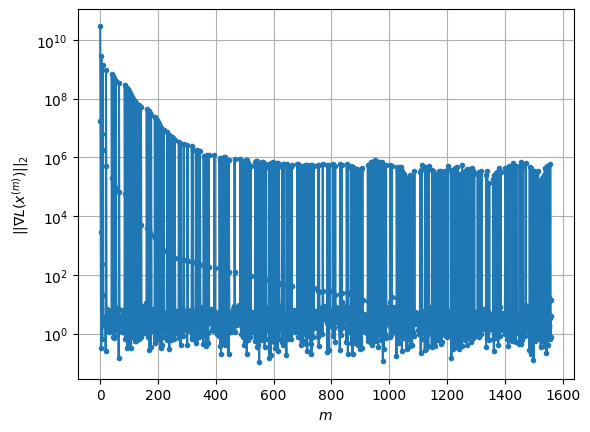

Windows:  49%|████▊     | 144/296 [1:06:51<30:35, 12.08s/it]


Majorization-Minimization Iteration 1
Before applying the algorithm
Cost function: 2764.9507896644523
Gradient norm: 553397.2807005133
Global relative error: 60.24183724841876
Position relative errors: 0.06732999497934332 m, 38.6523274965968 m, 22.89682500951702 m, 40.134856846367654 m

Iteration 1
Cost function: 2708.186447759738 (-2.05%)
Gradient norm: 13.20778463653151 (-100.00%)
Global relative error = 59.93836097894549 (-0.50%)
Position relative errors: 0.05942617598905969 m, 38.58651117081318 m, 22.308360404917583 m, 40.07519348796717 m

Iteration 2
Cost function: 2708.1864479051583 (0.00%)
Gradient norm: 1.3591636104270475 (-89.71%)
Global relative error = 59.93836313946958 (0.00%)
Position relative errors: 0.059426270624130105 m, 38.5865112620207 m, 22.30836597659322 m, 40.075193529845286 m

STOP on Iteration 3
Cost function = 2708.186447460753 (-0.00%)
Gradient norm = 0.30622317625858486 (-77.47%)
Global relative error = 59.93836313953953 (0.00%)
Final position relative error

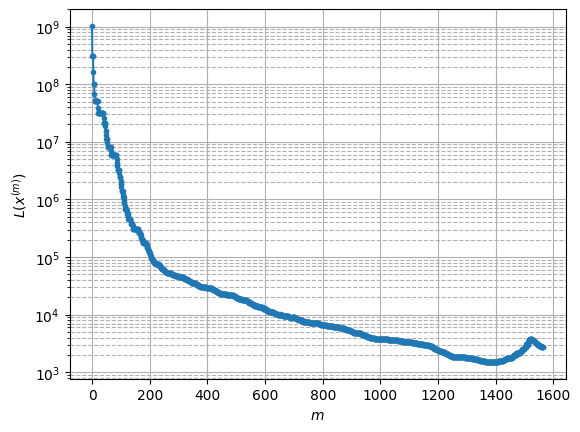

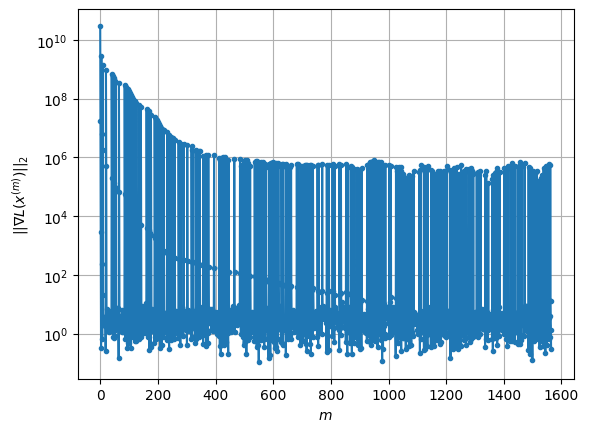

Windows:  49%|████▉     | 145/296 [1:07:02<28:55, 11.50s/it]


Majorization-Minimization Iteration 1
Before applying the algorithm
Cost function: 2685.3738946378985
Gradient norm: 609730.7563399756
Global relative error: 58.34412676657251
Position relative errors: 0.05794288972037738 m, 37.725854440531656 m, 22.01397260830813 m, 38.68045753063406 m

Iteration 1
Cost function: 2630.3057544634858 (-2.05%)
Gradient norm: 10.739398275414056 (-100.00%)
Global relative error = 58.05904418686513 (-0.49%)
Position relative errors: 0.059785967733484914 m, 37.66045183076869 m, 21.469053078576128 m, 38.62147436314494 m

Iteration 2
Cost function: 2630.3057551699935 (0.00%)
Gradient norm: 2.1759160394242283 (-79.74%)
Global relative error = 58.05904590876911 (0.00%)
Position relative errors: 0.05978607357176872 m, 37.66045191789439 m, 21.46905748822758 m, 38.62147441527879 m

Iteration 3
Cost function: 2630.3057532954804 (-0.00%)
Gradient norm: 5.842566725124707 (168.51%)
Global relative error = 58.059045908559185 (-0.00%)
Position relative errors: 0.0597860

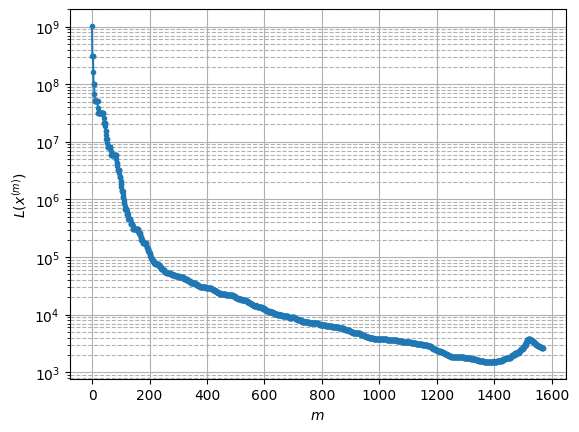

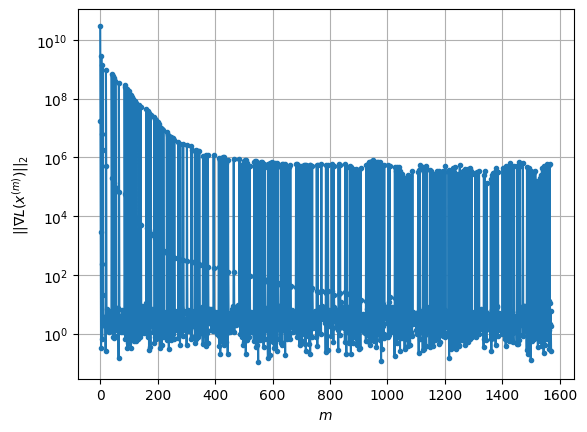

Windows:  49%|████▉     | 146/296 [1:07:16<31:01, 12.41s/it]


Majorization-Minimization Iteration 1
Before applying the algorithm
Cost function: 2619.067557661288
Gradient norm: 631998.6523698712
Global relative error: 56.22610884227738
Position relative errors: 0.058142858358428695 m, 36.63726411909186 m, 21.103106250526235 m, 37.06400655613916 m

Iteration 1
Cost function: 2566.3237869220106 (-2.01%)
Gradient norm: 11.032203434193486 (-100.00%)
Global relative error = 55.958792594317686 (-0.48%)
Position relative errors: 0.06360977918172411 m, 36.57398425160727 m, 20.598473454272067 m, 37.00578149304123 m

Iteration 2
Cost function: 2566.323787871844 (0.00%)
Gradient norm: 6.8173903286067645 (-38.20%)
Global relative error = 55.95879405381013 (0.00%)
Position relative errors: 0.06360989708565785 m, 36.57398435777443 m, 20.598477135303288 m, 37.00578154593296 m

Iteration 3
Cost function: 2566.3237875206837 (-0.00%)
Gradient norm: 5.3275255402782005 (-21.85%)
Global relative error = 55.95879405339257 (-0.00%)
Position relative errors: 0.0636098

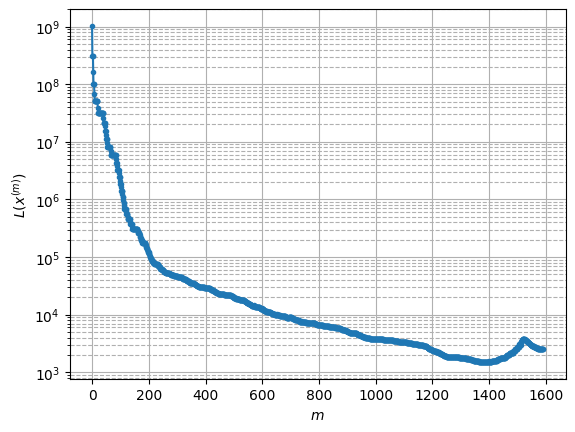

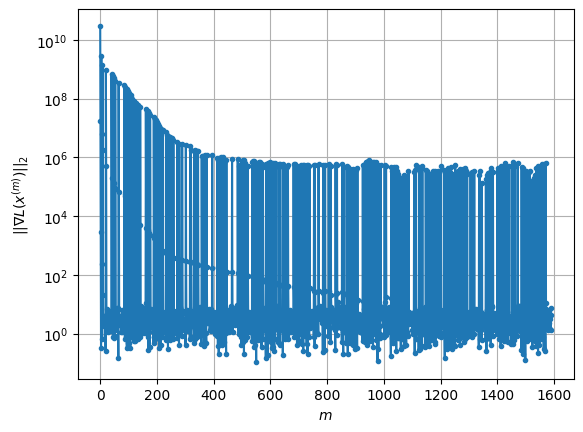

Windows:  50%|████▉     | 147/296 [1:08:06<58:32, 23.57s/it]


Majorization-Minimization Iteration 1
Before applying the algorithm
Cost function: 2543.7859396031527
Gradient norm: 775872.2050939592
Global relative error: 53.89763235561853
Position relative errors: 0.06167507237456336 m, 35.393269913229666 m, 20.166057259209794 m, 35.29300424841759 m

Iteration 1
Cost function: 2493.44794098011 (-1.98%)
Gradient norm: 11.23329435052258 (-100.00%)
Global relative error = 53.64860014881068 (-0.46%)
Position relative errors: 0.07633753189871051 m, 35.33297764176694 m, 19.69992314003299 m, 35.23717927633269 m

Iteration 2
Cost function: 2493.447939951768 (-0.00%)
Gradient norm: 3.0116852646123706 (-73.19%)
Global relative error = 53.64860137474468 (0.00%)
Position relative errors: 0.07633768133267022 m, 35.332977746185826 m, 19.699926193529908 m, 35.237179330681265 m

Iteration 3
Cost function: 2493.4479397350656 (-0.00%)
Gradient norm: 1.7740886604339872 (-41.09%)
Global relative error = 53.64860137475373 (0.00%)
Position relative errors: 0.076337676

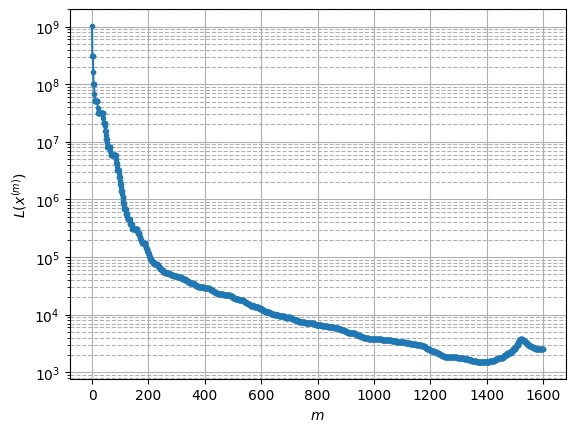

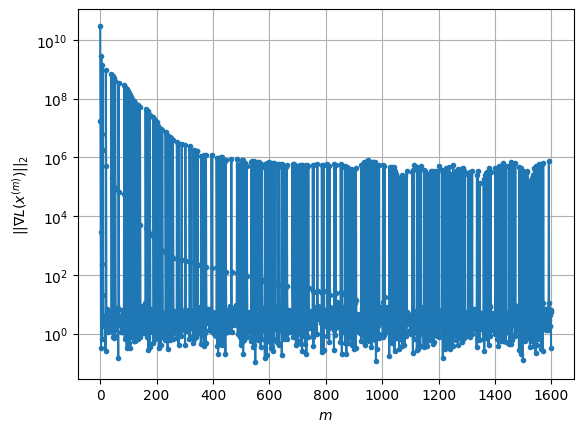

Windows:  50%|█████     | 148/296 [1:08:27<56:32, 22.92s/it]


Majorization-Minimization Iteration 1
Before applying the algorithm
Cost function: 2442.1156176971986
Gradient norm: 651949.0560946767
Global relative error: 51.37073928198133
Position relative errors: 0.07373895916230112 m, 34.00049150863457 m, 19.205958997744627 m, 33.37728953697679 m

Iteration 1
Cost function: 2395.4676039180445 (-1.91%)
Gradient norm: 9.95715654172102 (-100.00%)
Global relative error = 51.14213357252165 (-0.45%)
Position relative errors: 0.09582127467141256 m, 33.94336442882333 m, 18.778736323687408 m, 33.32737700310151 m

Iteration 2
Cost function: 2395.467603673295 (-0.00%)
Gradient norm: 5.400364643301097 (-45.76%)
Global relative error = 51.14213458958503 (0.00%)
Position relative errors: 0.09582142486031574 m, 33.94336453472517 m, 18.778738813292094 m, 33.32737705273165 m

Iteration 3
Cost function: 2395.4676031536587 (-0.00%)
Gradient norm: 1.3652762418177435 (-74.72%)
Global relative error = 51.14213458964011 (0.00%)
Position relative errors: 0.09582142681

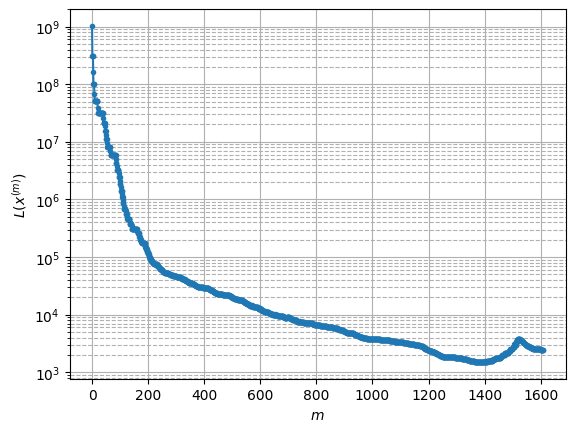

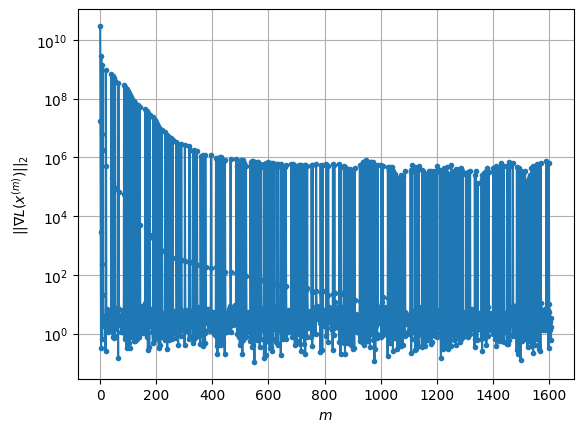

Windows:  50%|█████     | 149/296 [1:08:49<55:17, 22.57s/it]


Majorization-Minimization Iteration 1
Before applying the algorithm
Cost function: 2359.1435988284857
Gradient norm: 657415.9761056852
Global relative error: 48.66012979250762
Position relative errors: 0.09237105101784722 m, 32.46548667696411 m, 18.228178190834115 m, 31.329274387471482 m

Iteration 1
Cost function: 2315.5216365947663 (-1.85%)
Gradient norm: 7.622732649437644 (-100.00%)
Global relative error = 48.449197327823434 (-0.43%)
Position relative errors: 0.09406451622103179 m, 32.411759354357926 m, 17.835802895185047 m, 31.283796488263153 m

Iteration 2
Cost function: 2315.52163673159 (0.00%)
Gradient norm: 2.5903048206411503 (-66.02%)
Global relative error = 48.44919828638384 (0.00%)
Position relative errors: 0.09406464844214131 m, 32.411759438437215 m, 17.8358052450368 m, 31.28379654555572 m

Iteration 3
Cost function: 2315.5216390089536 (0.00%)
Gradient norm: 2.649596407507464 (2.29%)
Global relative error = 48.44919828681676 (0.00%)
Position relative errors: 0.094064647083

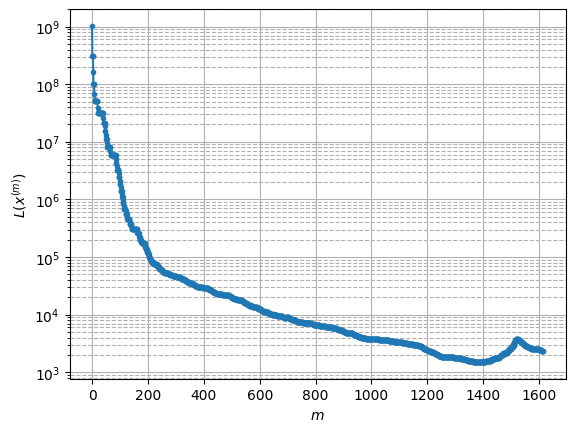

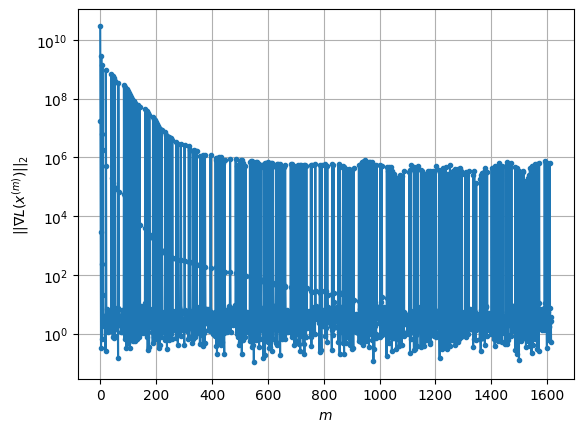

Windows:  51%|█████     | 150/296 [1:09:04<49:19, 20.27s/it]


Majorization-Minimization Iteration 1
Before applying the algorithm
Cost function: 2270.2297050402353
Gradient norm: 589401.0972264177
Global relative error: 45.77663311104766
Position relative errors: 0.09035632614445072 m, 30.795608750678397 m, 17.233756654053593 m, 29.156780372553712 m

Iteration 1
Cost function: 2229.060199862359 (-1.81%)
Gradient norm: 5.804573782416421 (-100.00%)
Global relative error = 45.5853703800979 (-0.42%)
Position relative errors: 0.09446497058811408 m, 30.7466428547088 m, 16.87344121580551 m, 29.119508546357626 m

Iteration 2
Cost function: 2229.0602020243823 (0.00%)
Gradient norm: 2.8008522478866786 (-51.75%)
Global relative error = 45.58537126584095 (0.00%)
Position relative errors: 0.09446507245488439 m, 30.746642939896496 m, 16.87344335416503 m, 29.119508603587825 m

Iteration 3
Cost function: 2229.0602004926436 (-0.00%)
Gradient norm: 5.451043045888086 (94.62%)
Global relative error = 45.58537126561132 (-0.00%)
Position relative errors: 0.0944650850

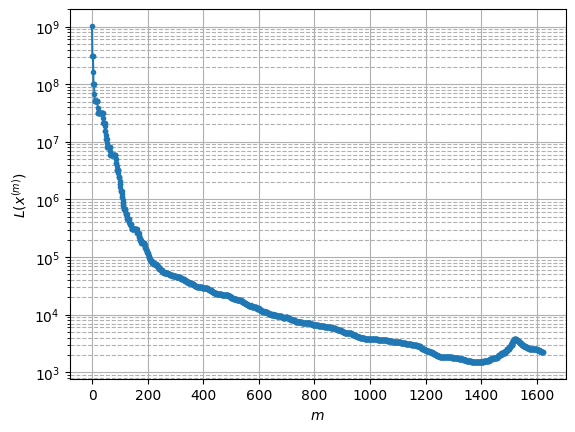

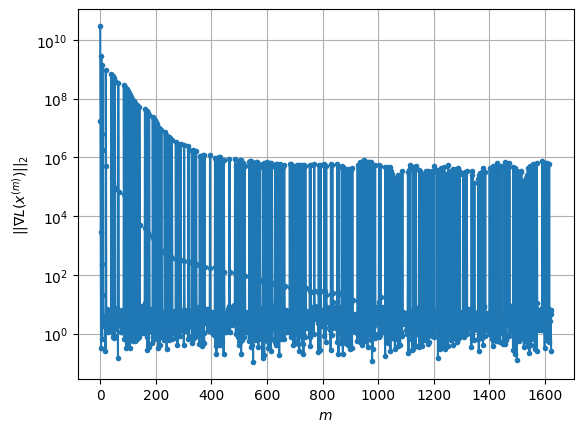

Windows:  51%|█████     | 151/296 [1:09:23<48:25, 20.04s/it]


Majorization-Minimization Iteration 1
Before applying the algorithm
Cost function: 2188.9561350217296
Gradient norm: 550717.3944371289
Global relative error: 42.73684607631027
Position relative errors: 0.09082205181975188 m, 28.999822074990504 m, 16.224856554894597 m, 26.8736224427432 m

Iteration 1
Cost function: 2151.3603787267107 (-1.72%)
Gradient norm: 7.346555169793154 (-100.00%)
Global relative error = 42.56418872902806 (-0.40%)
Position relative errors: 0.09780180336143073 m, 28.960700041095404 m, 15.897665006827209 m, 26.837291027769194 m

Iteration 2
Cost function: 2151.360378818578 (0.00%)
Gradient norm: 1.5356558016295805 (-79.10%)
Global relative error = 42.56418945411751 (0.00%)
Position relative errors: 0.09780190670207231 m, 28.96070011362898 m, 15.89766672469712 m, 26.837291081497646 m

Iteration 3
Cost function: 2151.360378012404 (-0.00%)
Gradient norm: 1.283545032593968 (-16.42%)
Global relative error = 42.56418945388769 (-0.00%)
Position relative errors: 0.097801910

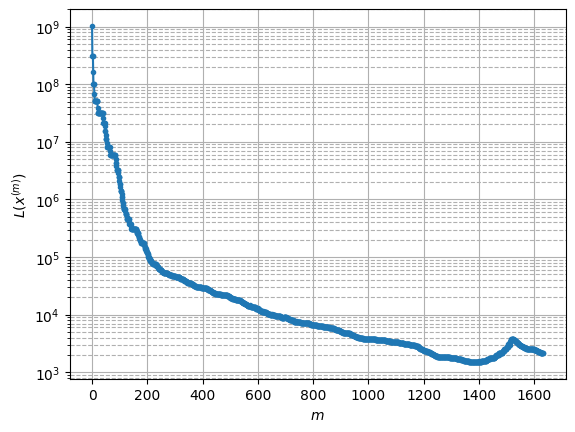

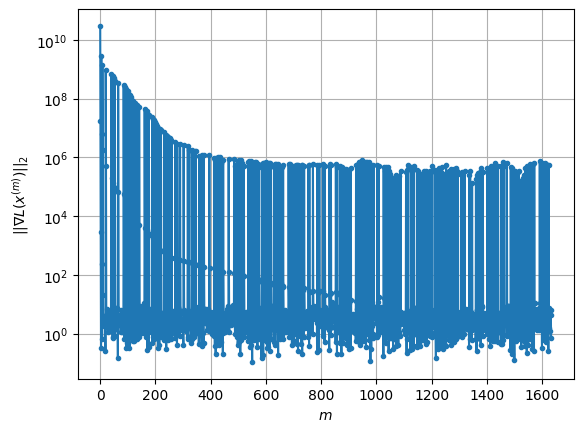

Windows:  51%|█████▏    | 152/296 [1:09:47<50:45, 21.15s/it]


Majorization-Minimization Iteration 1
Before applying the algorithm
Cost function: 2114.6800433464377
Gradient norm: 508753.42357499764
Global relative error: 39.55537072038132
Position relative errors: 0.093980381399219 m, 27.091400399635205 m, 15.207289930571271 m, 24.482852601279937 m

Iteration 1
Cost function: 2079.469118383354 (-1.67%)
Gradient norm: 7.3997934105338725 (-100.00%)
Global relative error = 39.40275967043335 (-0.39%)
Position relative errors: 0.08586751787967653 m, 27.05738419178503 m, 14.910783793370465 m, 24.456774142579608 m

STOP on Iteration 2
Cost function = 2079.4691193449657 (0.00%)
Gradient norm = 0.9600612910023751 (-87.03%)
Global relative error = 39.40276027472702 (0.00%)
Final position relative errors: 0.08586760349853662 m, 27.05738422574036 m, 14.910785242365733 m, 24.45677419487689 m

Majorization-Minimization converged after 1 iterations


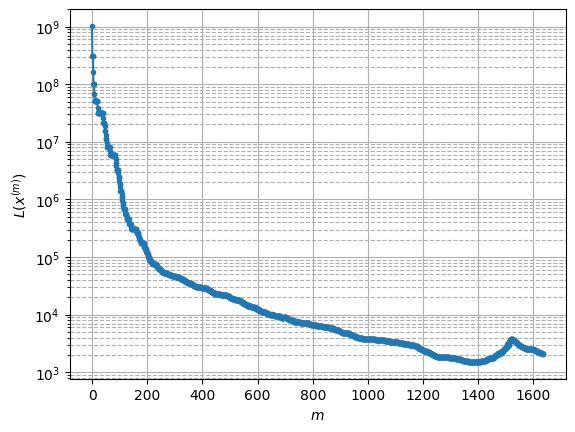

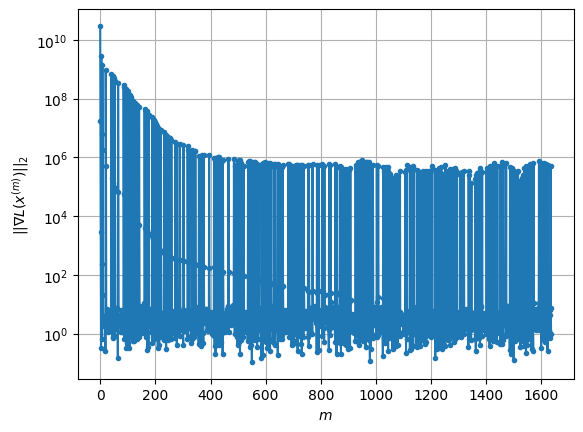

Windows:  52%|█████▏    | 153/296 [1:09:55<40:41, 17.07s/it]


Majorization-Minimization Iteration 1
Before applying the algorithm
Cost function: 2046.5407913410402
Gradient norm: 524042.2250164652
Global relative error: 36.25090796096387
Position relative errors: 0.08224763555933202 m, 25.074301150913676 m, 14.183260212798617 m, 22.00529582939557 m

Iteration 1
Cost function: 2013.095364593233 (-1.63%)
Gradient norm: 7.565611388996614 (-100.00%)
Global relative error = 36.11871730610463 (-0.36%)
Position relative errors: 0.06658294232398262 m, 25.049031654681716 m, 13.917884775171776 m, 21.986194716989285 m

Iteration 2
Cost function: 2013.095364818566 (0.00%)
Gradient norm: 2.2698613441983513 (-70.00%)
Global relative error = 36.11871789324178 (0.00%)
Position relative errors: 0.066583011459551 m, 25.04903170388849 m, 13.917886131096356 m, 21.98619476691997 m

Iteration 3
Cost function: 2013.0953642061334 (-0.00%)
Gradient norm: 4.715310935405917 (107.74%)
Global relative error = 36.118717892166536 (-0.00%)
Position relative errors: 0.066583012

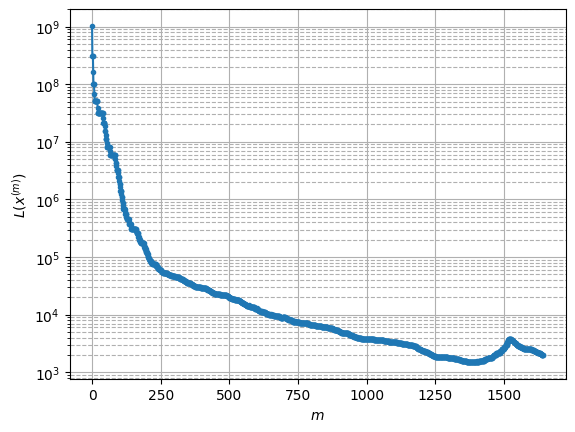

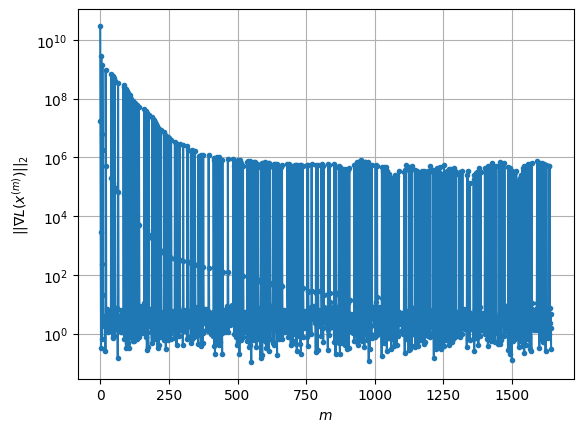

Windows:  52%|█████▏    | 154/296 [1:10:12<40:36, 17.16s/it]


Majorization-Minimization Iteration 1
Before applying the algorithm
Cost function: 1971.3908745823883
Gradient norm: 468017.8029921716
Global relative error: 32.842864681665226
Position relative errors: 0.06365558059040306 m, 22.961222203750207 m, 13.157897335228645 m, 19.449894692474583 m

Iteration 1
Cost function: 1939.844665028739 (-1.60%)
Gradient norm: 5.209442048388165 (-100.00%)
Global relative error = 32.73296948649245 (-0.33%)
Position relative errors: 0.06246338614940463 m, 22.940917940280688 m, 12.921600378087483 m, 19.447021012394504 m

Iteration 2
Cost function: 1939.844664086162 (-0.00%)
Gradient norm: 3.954331673547927 (-24.09%)
Global relative error = 32.73296994309705 (0.00%)
Position relative errors: 0.062463464189847225 m, 22.940917976900327 m, 12.921601394637383 m, 19.447021062044513 m

Iteration 3
Cost function: 1939.8446638017385 (-0.00%)
Gradient norm: 3.192362485503337 (-19.27%)
Global relative error = 32.732969943030035 (-0.00%)
Position relative errors: 0.06

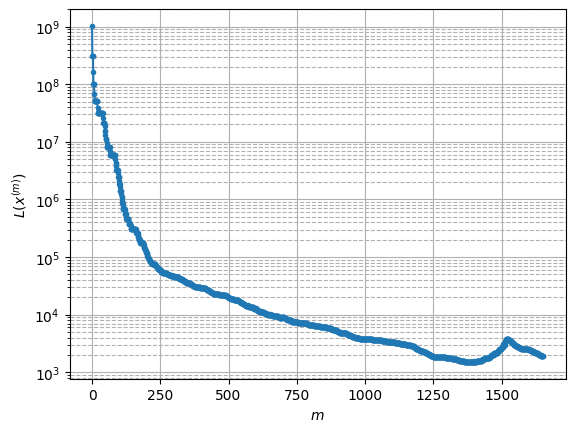

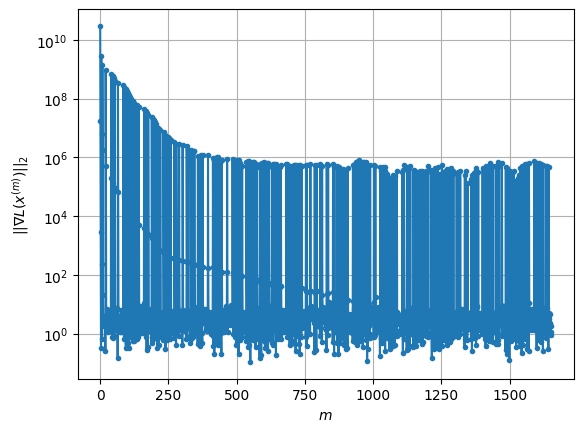

Windows:  52%|█████▏    | 155/296 [1:10:38<46:25, 19.76s/it]


Majorization-Minimization Iteration 1
Before applying the algorithm
Cost function: 1891.9427305426825
Gradient norm: 469641.21852496284
Global relative error: 29.35493966570384
Position relative errors: 0.0595950276766893 m, 20.757953949773047 m, 12.13350144423931 m, 16.84015670251123 m

Iteration 1
Cost function: 1862.0437210166194 (-1.58%)
Gradient norm: 8.065754366937034 (-100.00%)
Global relative error = 29.268351746346962 (-0.29%)
Position relative errors: 0.059860941588938475 m, 20.746379719636632 m, 11.926616756575566 m, 16.851494145368335 m

STOP on Iteration 2
Cost function = 1862.0437215206887 (0.00%)
Gradient norm = 0.9917578312147738 (-87.70%)
Global relative error = 29.268352151068843 (0.00%)
Final position relative errors: 0.059861005226776065 m, 20.746379779442346 m, 11.92661758474533 m, 16.851494188311264 m

Majorization-Minimization converged after 1 iterations


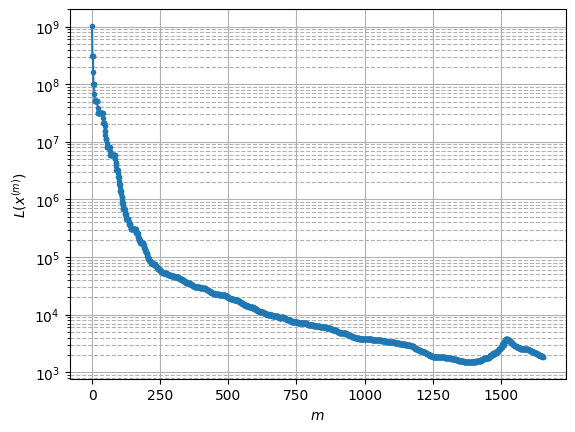

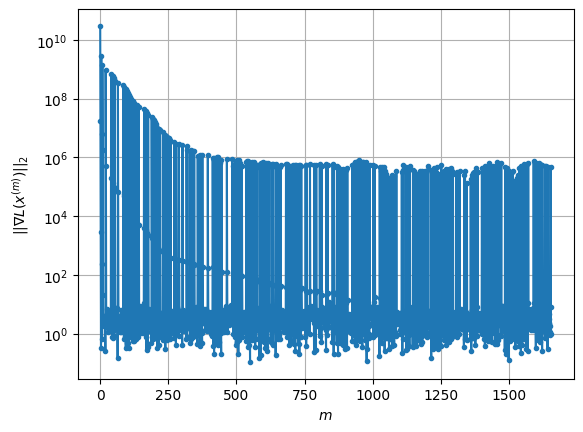

Windows:  53%|█████▎    | 156/296 [1:10:45<37:36, 16.12s/it]


Majorization-Minimization Iteration 1
Before applying the algorithm
Cost function: 1819.4555819724894
Gradient norm: 432729.325418844
Global relative error: 25.814213242732393
Position relative errors: 0.05689807536168485 m, 18.47827399986488 m, 11.114795492532403 m, 14.190889090379285 m

Iteration 1
Cost function: 1791.6977145348658 (-1.53%)
Gradient norm: 10.436196808979037 (-100.00%)
Global relative error = 25.751744338439252 (-0.24%)
Position relative errors: 0.05411636338706615 m, 18.472757751269526 m, 10.942263186545494 m, 14.21864222711004 m

Iteration 2
Cost function: 1791.6977158472887 (0.00%)
Gradient norm: 10.629049146146137 (1.85%)
Global relative error = 25.751744578049152 (0.00%)
Position relative errors: 0.05411642564720328 m, 18.472757786598258 m, 10.942263634775806 m, 14.218642269988239 m

Iteration 3
Cost function: 1791.6977151017275 (-0.00%)
Gradient norm: 3.030651301044763 (-71.49%)
Global relative error = 25.751744578634607 (0.00%)
Position relative errors: 0.0541

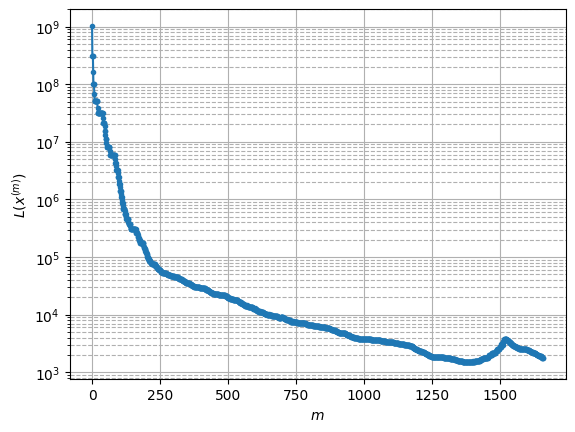

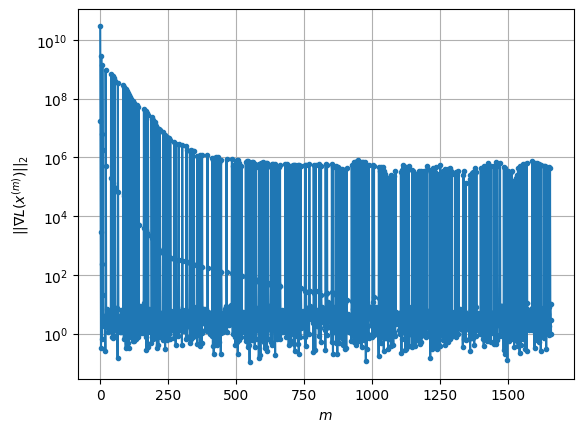

Windows:  53%|█████▎    | 157/296 [1:10:58<34:41, 14.98s/it]


Majorization-Minimization Iteration 1
Before applying the algorithm
Cost function: 1746.8222816557516
Gradient norm: 378497.5620848574
Global relative error: 22.255054659031064
Position relative errors: 0.051354626278655814 m, 16.130113381435343 m, 10.110760718060272 m, 11.527049077162006 m

Iteration 1
Cost function: 1721.277941313808 (-1.46%)
Gradient norm: 5.197401839714687 (-100.00%)
Global relative error = 22.21763284857597 (-0.17%)
Position relative errors: 0.05050859195763093 m, 16.130874576382173 m, 9.97166096133409 m, 11.574870576039416 m

Iteration 2
Cost function: 1721.2779417572895 (0.00%)
Gradient norm: 2.6124158839847267 (-49.74%)
Global relative error = 22.217632939334923 (0.00%)
Position relative errors: 0.05050866731147057 m, 16.130874614967087 m, 9.971661058874803 m, 11.574870612111965 m

STOP on Iteration 3
Cost function = 1721.2779412312427 (-0.00%)
Gradient norm = 0.28362999399143207 (-89.14%)
Global relative error = 22.21763293933961 (0.00%)
Final position relati

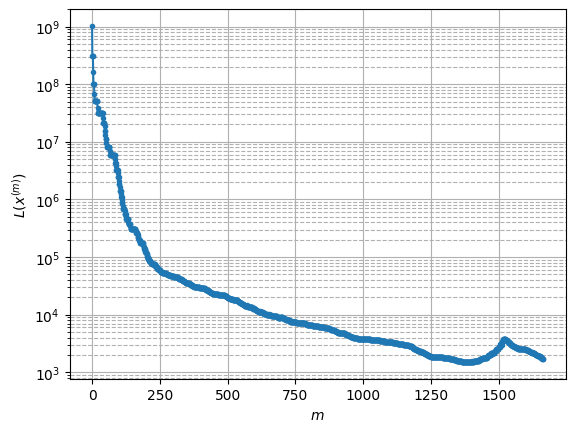

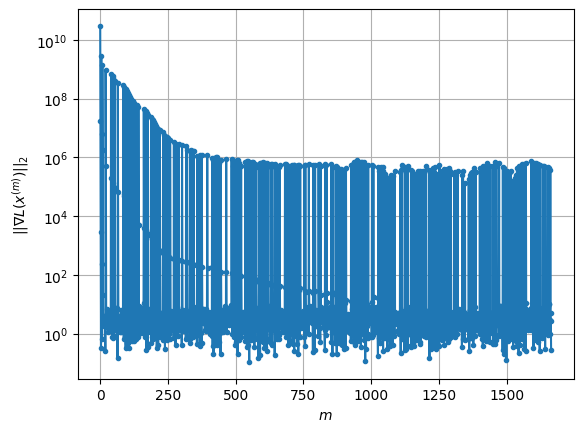

Windows:  53%|█████▎    | 158/296 [1:11:08<31:02, 13.50s/it]


Majorization-Minimization Iteration 1
Before applying the algorithm
Cost function: 1684.7091759360733
Gradient norm: 374560.7425688453
Global relative error: 18.726014529667154
Position relative errors: 0.047670923260964976 m, 13.724932438815737 m, 9.1244391014943 m, 8.88977640285553 m

Iteration 1
Cost function: 1661.0362939367035 (-1.41%)
Gradient norm: 11.302562109783898 (-100.00%)
Global relative error = 18.715777158421442 (-0.05%)
Position relative errors: 0.04486554033249555 m, 13.729255943162912 m, 9.020550286668277 m, 8.967244239353278 m

Iteration 2
Cost function: 1661.036295575795 (0.00%)
Gradient norm: 1.1673480885550318 (-89.67%)
Global relative error = 18.715777147706973 (-0.00%)
Position relative errors: 0.044865594591820906 m, 13.729255965863238 m, 9.02055019611184 m, 8.967244273052877 m

Iteration 3
Cost function: 1661.0362957332395 (0.00%)
Gradient norm: 1.7846763345055086 (52.88%)
Global relative error = 18.715777149873446 (0.00%)
Position relative errors: 0.04486559

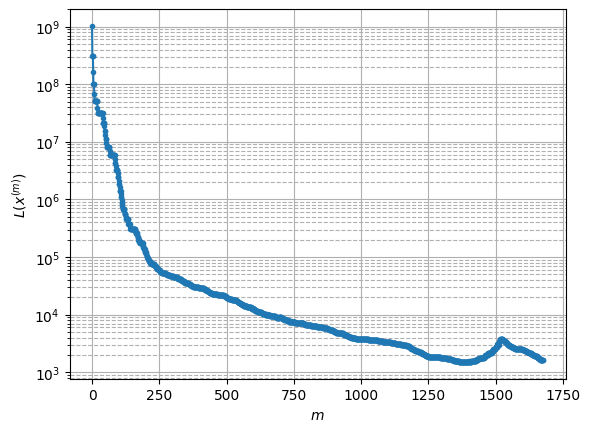

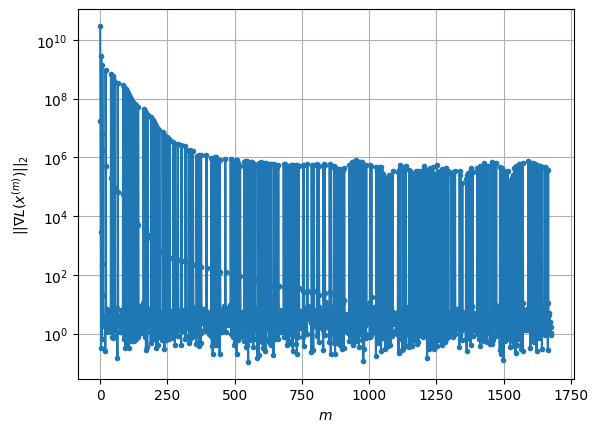

Windows:  54%|█████▎    | 159/296 [1:11:37<41:19, 18.10s/it]


Majorization-Minimization Iteration 1
Before applying the algorithm
Cost function: 1629.8018450674274
Gradient norm: 259690.4224132486
Global relative error: 15.306396642785527
Position relative errors: 0.04197837695229261 m, 11.272182216213196 m, 8.161549489508191 m, 6.372351157889158 m

Iteration 1
Cost function: 1608.3087381828477 (-1.32%)
Gradient norm: 4.613111593616742 (-100.00%)
Global relative error = 15.322256043466279 (0.10%)
Position relative errors: 0.048707753531952655 m, 11.282398909432636 m, 8.092176391819095 m, 6.479904828007283 m

Iteration 2
Cost function: 1608.308737363683 (-0.00%)
Gradient norm: 3.808080940266811 (-17.45%)
Global relative error = 15.322255942129262 (-0.00%)
Position relative errors: 0.048707809836265936 m, 11.282398935236554 m, 8.092176134773316 m, 6.4799048640302015 m

Iteration 3
Cost function: 1608.3087380251704 (0.00%)
Gradient norm: 1.9679372811069409 (-48.32%)
Global relative error = 15.322255942804807 (0.00%)
Position relative errors: 0.0487

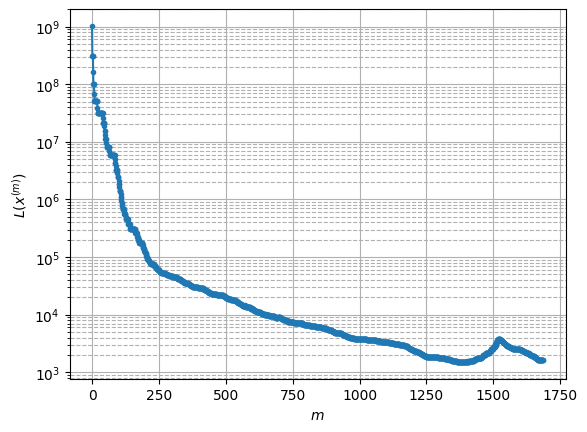

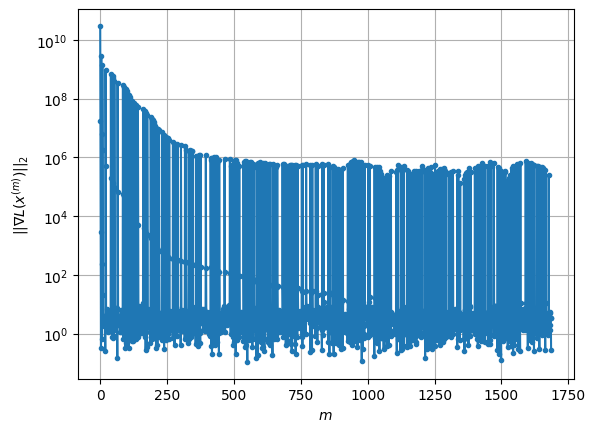

Windows:  54%|█████▍    | 160/296 [1:12:01<45:00, 19.86s/it]


Majorization-Minimization Iteration 1
Before applying the algorithm
Cost function: 1582.7647575512185
Gradient norm: 199972.07819266946
Global relative error: 12.1379287694136
Position relative errors: 0.04564206872799621 m, 8.788771436130698 m, 7.22520346645122 m, 4.228109741801647 m

Iteration 1
Cost function: 1563.6150611076225 (-1.21%)
Gradient norm: 4.138630564157368 (-100.00%)
Global relative error = 12.17703009065228 (0.32%)
Position relative errors: 0.04232589716973201 m, 8.809141844368302 m, 7.191797664526907 m, 4.353287585258247 m

Iteration 2
Cost function: 1563.615061613598 (0.00%)
Gradient norm: 1.4777277899686987 (-64.29%)
Global relative error = 12.177029875048822 (-0.00%)
Position relative errors: 0.0423259578799964 m, 8.809141870676411 m, 7.191797246475384 m, 4.353287618971486 m

STOP on Iteration 3
Cost function = 1563.615061190026 (-0.00%)
Gradient norm = 0.2968863746655261 (-79.91%)
Global relative error = 12.177029873766033 (-0.00%)
Final position relative errors:

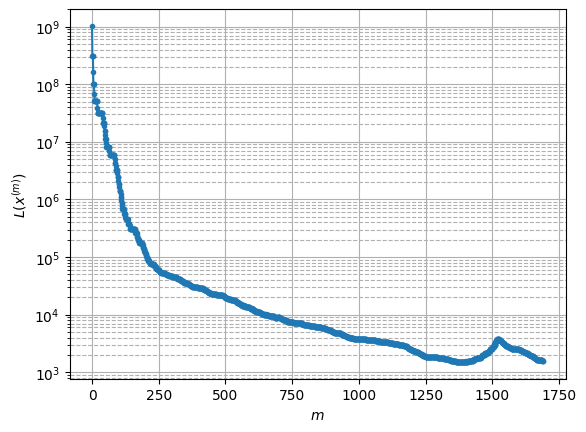

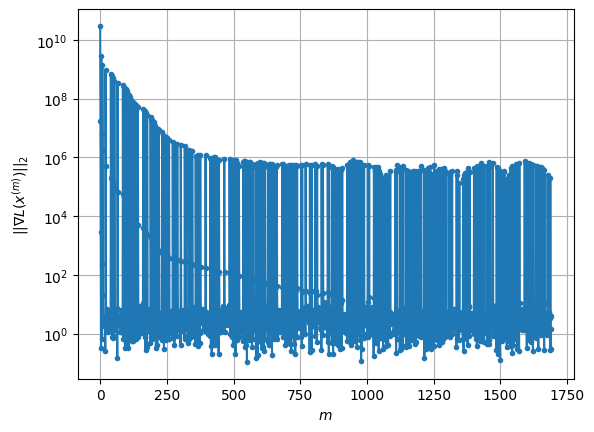

Windows:  54%|█████▍    | 161/296 [1:12:11<38:09, 16.96s/it]


Majorization-Minimization Iteration 1
Before applying the algorithm
Cost function: 1532.9675463510935
Gradient norm: 234719.83761936554
Global relative error: 9.512242696479348
Position relative errors: 0.039443722313402416 m, 6.300744902144442 m, 6.320443906879304 m, 3.29082300885538 m

Iteration 1
Cost function: 1513.9643769124275 (-1.24%)
Gradient norm: 5.395699441818202 (-100.00%)
Global relative error = 9.596112468539646 (0.88%)
Position relative errors: 0.0447819497061162 m, 6.329360321074799 m, 6.315384132195028 m, 3.483421432055891 m

Iteration 2
Cost function: 1513.9643765083188 (-0.00%)
Gradient norm: 1.3791153477555202 (-74.44%)
Global relative error = 9.596112109522716 (-0.00%)
Position relative errors: 0.04478199233293115 m, 6.329360351816107 m, 6.315383539423338 m, 3.4834214613063894 m

Iteration 3
Cost function: 1513.9643759538894 (-0.00%)
Gradient norm: 2.6554637991041252 (92.55%)
Global relative error = 9.596112105108071 (-0.00%)
Position relative errors: 0.0447819933

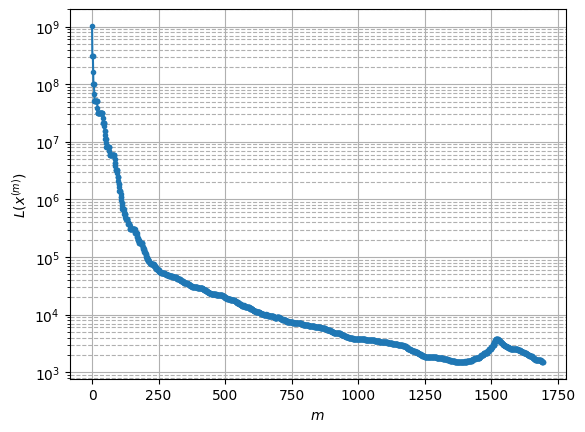

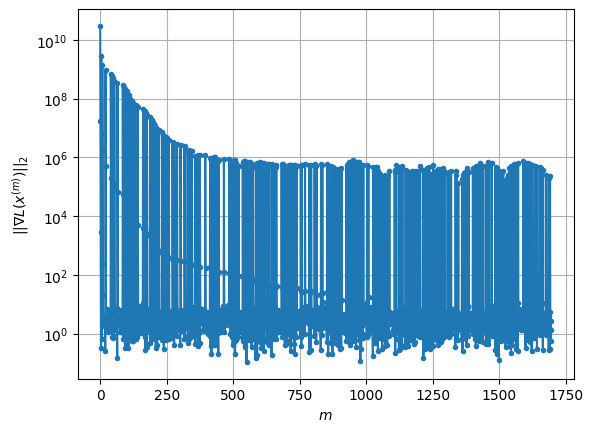

Windows:  55%|█████▍    | 162/296 [1:12:23<34:52, 15.62s/it]


Majorization-Minimization Iteration 1
Before applying the algorithm
Cost function: 1495.769374332463
Gradient norm: 460103.3064120767
Global relative error: 8.029442199022522
Position relative errors: 0.041772169034689347 m, 3.8568155443820893 m, 5.443644420965822 m, 4.467394062448172 m

Iteration 1
Cost function: 1477.7064635192723 (-1.21%)
Gradient norm: 3.369154646015513 (-100.00%)
Global relative error = 8.126122731747726 (1.20%)
Position relative errors: 0.03819062592329534 m, 3.9106834699348094 m, 5.466270826071783 m, 4.566681412730678 m

Iteration 2
Cost function: 1477.7064632492975 (-0.00%)
Gradient norm: 1.662824576558161 (-50.65%)
Global relative error = 8.126122298580444 (-0.00%)
Position relative errors: 0.03819066336913435 m, 3.910683508892961 m, 5.466270148321025 m, 4.566681419514178 m

Iteration 3
Cost function: 1477.7064632423644 (-0.00%)
Gradient norm: 4.447098334468658 (167.44%)
Global relative error = 8.12612229472614 (-0.00%)
Position relative errors: 0.03819066162

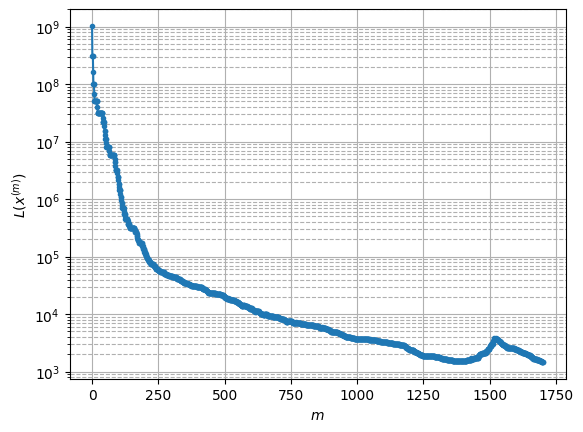

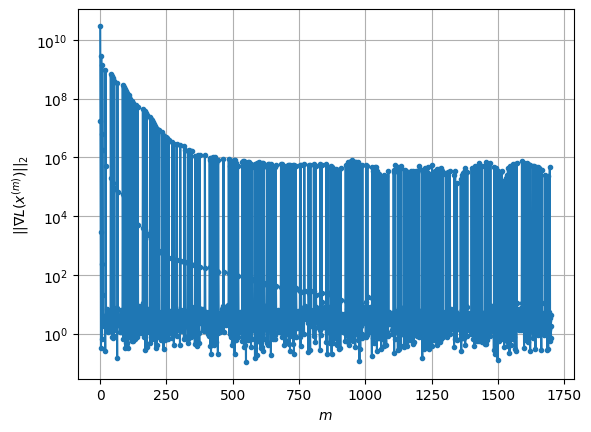

Windows:  55%|█████▌    | 163/296 [1:12:38<33:48, 15.25s/it]


Majorization-Minimization Iteration 1
Before applying the algorithm
Cost function: 1462.6301695790642
Gradient norm: 213593.95354541476
Global relative error: 8.286426729479373
Position relative errors: 0.03618124474212372 m, 1.7772565402987421 m, 4.5983314826968 m, 6.660030024190659 m

Iteration 1
Cost function: 1445.7280980812395 (-1.16%)
Gradient norm: 2.7765652905273557 (-100.00%)
Global relative error = 8.373447922500937 (1.05%)
Position relative errors: 0.03989999120415645 m, 1.8745573698663476 m, 4.648748634001758 m, 6.707008856329452 m

Iteration 2
Cost function: 1445.7280978974156 (-0.00%)
Gradient norm: 3.952464567410216 (42.35%)
Global relative error = 8.373447510165349 (-0.00%)
Position relative errors: 0.03990002981879175 m, 1.8745574617306147 m, 4.648747860900791 m, 6.707008851484214 m

Iteration 3
Cost function: 1445.7280975345261 (-0.00%)
Gradient norm: 4.505705463627795 (14.00%)
Global relative error = 8.373447509536597 (-0.00%)
Position relative errors: 0.03990002793

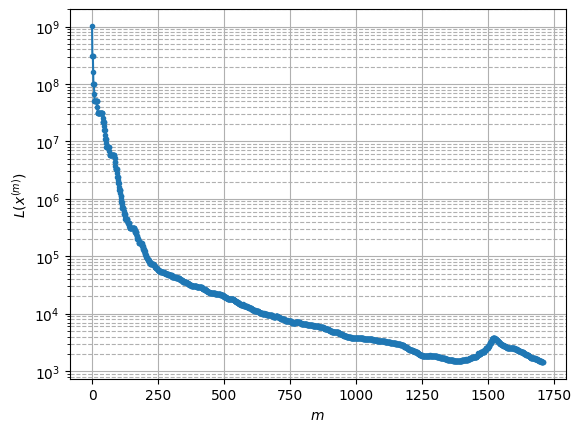

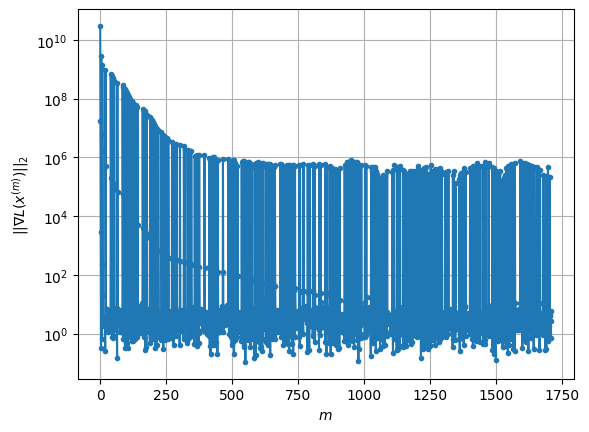

Windows:  55%|█████▌    | 164/296 [1:12:54<34:30, 15.69s/it]


Majorization-Minimization Iteration 1
Before applying the algorithm
Cost function: 1443.5582807436726
Gradient norm: 250284.23545487423
Global relative error: 10.125544285659451
Position relative errors: 0.037916993078855404 m, 2.133427072690512 m, 3.7898527837738922 m, 9.143659797172505 m

Iteration 1
Cost function: 1427.7744973995757 (-1.09%)
Gradient norm: 4.33170017278925 (-100.00%)
Global relative error = 10.162135451550146 (0.36%)
Position relative errors: 0.04039794607702209 m, 2.176097655208273 m, 3.8559736619061695 m, 9.146543344833605 m

Iteration 2
Cost function: 1427.7744987270032 (0.00%)
Gradient norm: 3.8361833192422066 (-11.44%)
Global relative error = 10.162135130796708 (-0.00%)
Position relative errors: 0.040397983529873546 m, 2.1760977014536214 m, 3.8559728199564844 m, 9.146543332240983 m

Iteration 3
Cost function: 1427.7744983854452 (-0.00%)
Gradient norm: 2.5087962208842804 (-34.60%)
Global relative error = 10.162135133309466 (0.00%)
Position relative errors: 0.04

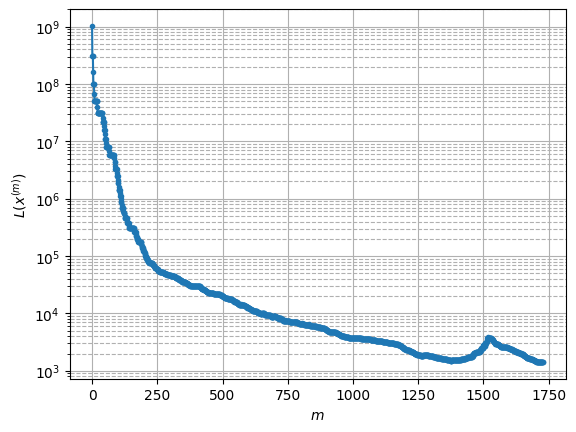

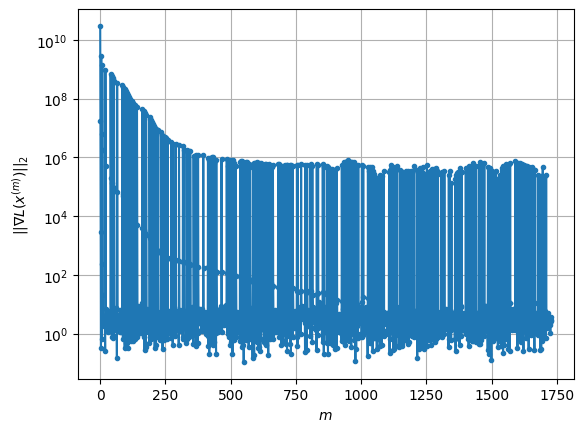

Windows:  56%|█████▌    | 165/296 [1:13:44<56:23, 25.83s/it]


Majorization-Minimization Iteration 1
Before applying the algorithm
Cost function: 1425.0152132533392
Gradient norm: 539013.9789279994
Global relative error: 12.82732227936274
Position relative errors: 0.03859218717382395 m, 4.342166987207626 m, 3.011921745561164 m, 11.687964799232805 m

Iteration 1
Cost function: 1410.0618268297883 (-1.05%)
Gradient norm: 3.918195046403418 (-100.00%)
Global relative error = 12.828671743025511 (0.01%)
Position relative errors: 0.040896657809451745 m, 4.3380328059890445 m, 3.090399112307757 m, 11.670474453528662 m

Iteration 2
Cost function: 1410.0618270286186 (0.00%)
Gradient norm: 5.534986342451978 (41.26%)
Global relative error = 12.828671535073035 (-0.00%)
Position relative errors: 0.0408966934677738 m, 4.338032813259576 m, 3.090398285765294 m, 11.670474440981627 m

Iteration 3
Cost function: 1410.0618268152791 (-0.00%)
Gradient norm: 1.4629351303363334 (-73.57%)
Global relative error = 12.828671537313882 (0.00%)
Position relative errors: 0.0408966

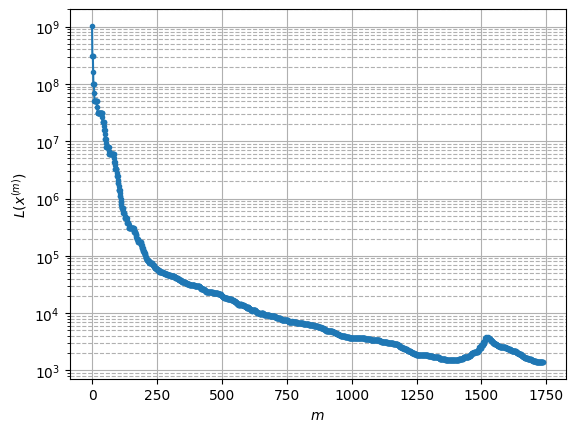

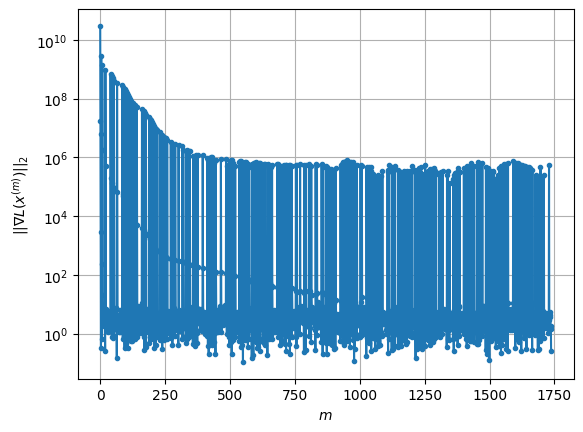

Windows:  56%|█████▌    | 166/296 [1:14:05<53:08, 24.53s/it]


Majorization-Minimization Iteration 1
Before applying the algorithm
Cost function: 1422.3785778251427
Gradient norm: 448601.5283933154
Global relative error: 15.915208162754269
Position relative errors: 0.038843678978975955 m, 6.759243156308421 m, 2.2701792009325823 m, 14.228397412951452 m

Iteration 1
Cost function: 1407.6971429136222 (-1.03%)
Gradient norm: 1.7096114596776137 (-100.00%)
Global relative error = 15.883773919395468 (-0.20%)
Position relative errors: 0.04029776533388012 m, 6.746826274885787 m, 2.346803793027139 m, 14.186668089495127 m

Iteration 2
Cost function: 1407.6971437381756 (0.00%)
Gradient norm: 3.1182454254224803 (82.39%)
Global relative error = 15.883773785267662 (-0.00%)
Position relative errors: 0.040297799895676015 m, 6.7468262770303715 m, 2.3468030126931048 m, 14.186668067287904 m

Iteration 3
Cost function: 1407.6971447545764 (0.00%)
Gradient norm: 6.198272040823031 (98.77%)
Global relative error = 15.883773786365644 (0.00%)
Position relative errors: 0.04

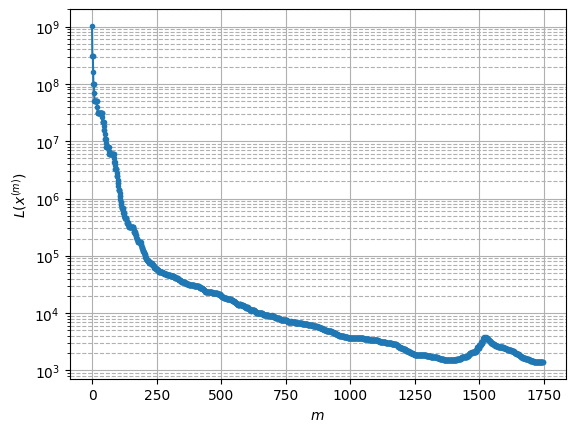

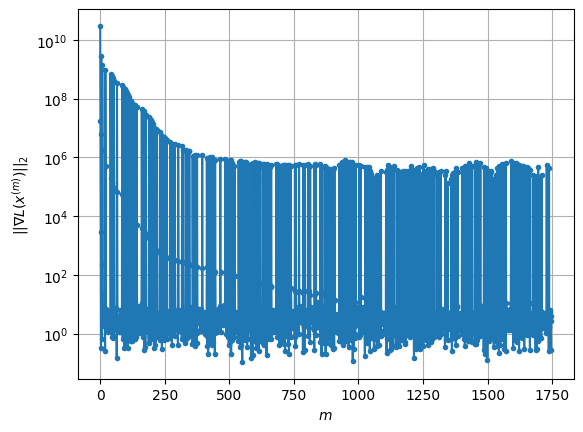

Windows:  56%|█████▋    | 167/296 [1:14:26<50:31, 23.50s/it]


Majorization-Minimization Iteration 1
Before applying the algorithm
Cost function: 1406.4779240896833
Gradient norm: 327016.0917794125
Global relative error: 19.147146581825766
Position relative errors: 0.03817069079256323 m, 9.19779499112437 m, 1.5664411535461544 m, 16.719892022759655 m

Iteration 1
Cost function: 1393.0994897190708 (-0.95%)
Gradient norm: 1.0850040787560082 (-100.00%)
Global relative error = 19.094825327691435 (-0.27%)
Position relative errors: 0.04031580591829994 m, 9.17697249104654 m, 1.632510803767164 m, 16.66508411077619 m

Iteration 2
Cost function: 1393.0994891425676 (-0.00%)
Gradient norm: 1.1521165415088153 (6.19%)
Global relative error = 19.09482525468732 (-0.00%)
Position relative errors: 0.040315841939616945 m, 9.176972488759628 m, 1.6325101563283484 m, 16.66508409172243 m

STOP on Iteration 3
Cost function = 1393.099489319673 (0.00%)
Gradient norm = 0.412164260161983 (-64.23%)
Global relative error = 19.094825254987352 (0.00%)
Final position relative err

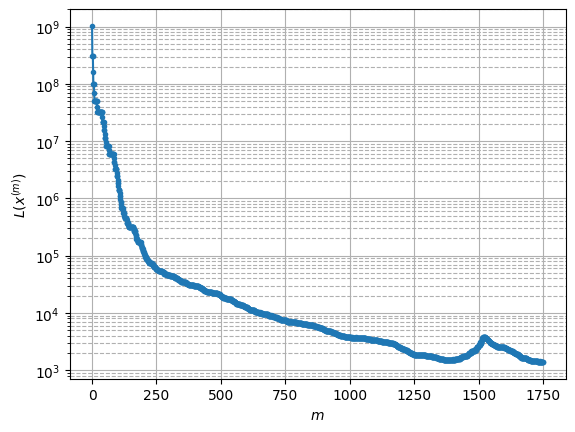

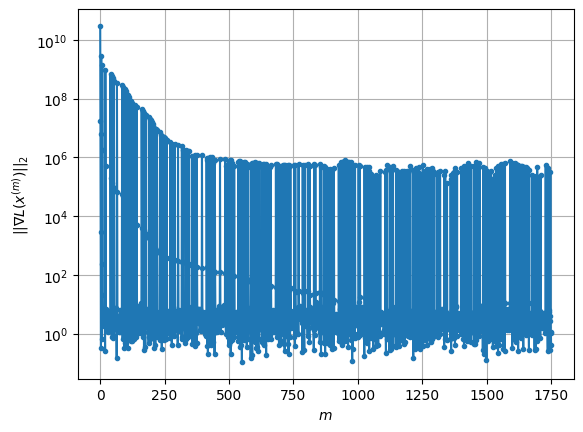

Windows:  57%|█████▋    | 168/296 [1:14:36<41:15, 19.34s/it]


Majorization-Minimization Iteration 1
Before applying the algorithm
Cost function: 1397.1178534658259
Gradient norm: 373546.85348136985
Global relative error: 22.411492708115777
Position relative errors: 0.03807939234701076 m, 11.60864657708415 m, 0.9420248599626807 m, 19.147371954295508 m

Iteration 1
Cost function: 1384.3561008516108 (-0.91%)
Gradient norm: 1.3397919691646516 (-100.00%)
Global relative error = 22.34138974391466 (-0.31%)
Position relative errors: 0.03872569477139693 m, 11.582994644989233 m, 0.9756272074858344 m, 19.079176750983287 m

Iteration 2
Cost function: 1384.3561004998787 (-0.00%)
Gradient norm: 3.1179891009149734 (132.72%)
Global relative error = 22.34138970420637 (-0.00%)
Position relative errors: 0.03872572954316353 m, 11.582994637637784 m, 0.975626787300456 m, 19.07917673036372 m

Iteration 3
Cost function: 1384.3561004089192 (-0.00%)
Gradient norm: 3.940355007331899 (26.37%)
Global relative error = 22.341389704902884 (0.00%)
Position relative errors: 0.03

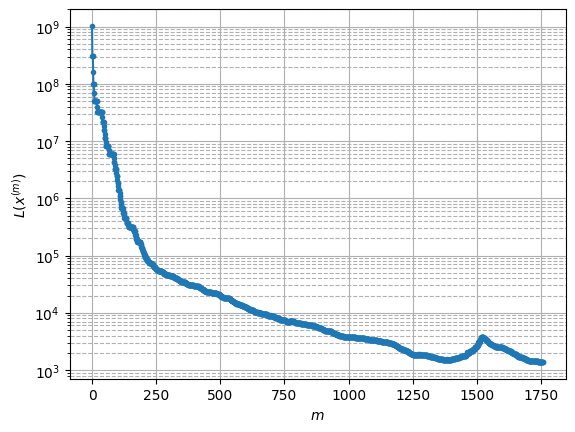

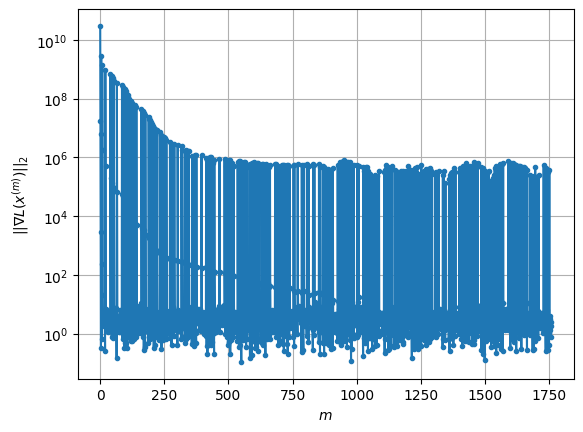

Windows:  57%|█████▋    | 169/296 [1:14:55<40:39, 19.21s/it]


Majorization-Minimization Iteration 1
Before applying the algorithm
Cost function: 1394.996006382418
Gradient norm: 364290.10042056174
Global relative error: 25.642204085987164
Position relative errors: 0.036747631494550966 m, 13.972721731501748 m, 0.6134332473902538 m, 21.49196648452246 m

Iteration 1
Cost function: 1382.0272549075887 (-0.93%)
Gradient norm: 3.998187851380622 (-100.00%)
Global relative error = 25.555189141754514 (-0.34%)
Position relative errors: 0.03383730706582025 m, 13.944507360745519 m, 0.5086592655546077 m, 21.409230296404026 m

Iteration 2
Cost function: 1382.0272544624152 (-0.00%)
Gradient norm: 3.5856603785219168 (-10.32%)
Global relative error = 25.55518913046992 (-0.00%)
Position relative errors: 0.03383734391094945 m, 13.944507351936862 m, 0.5086596038377433 m, 21.40923028057534 m

Iteration 3
Cost function: 1382.0272548649014 (0.00%)
Gradient norm: 3.1473388495444 (-12.22%)
Global relative error = 25.55518913019925 (-0.00%)
Position relative errors: 0.033

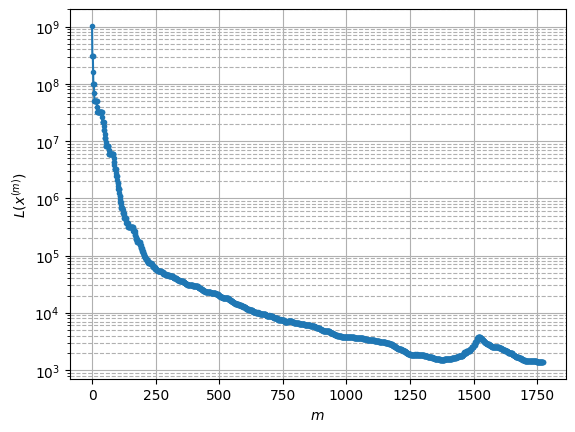

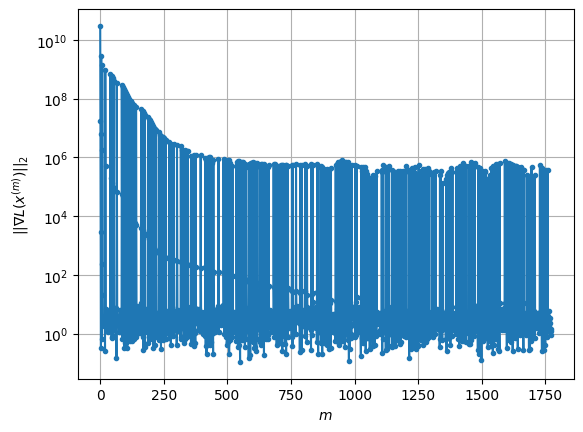

Windows:  57%|█████▋    | 170/296 [1:15:30<50:14, 23.92s/it]


Majorization-Minimization Iteration 1
Before applying the algorithm
Cost function: 1389.0346303260376
Gradient norm: 337473.27259607776
Global relative error: 28.796435586052162
Position relative errors: 0.031694213556005116 m, 16.27668333856644 m, 0.8946754109948392 m, 23.73814783667953 m

Iteration 1
Cost function: 1376.7401869464093 (-0.89%)
Gradient norm: 3.1488545057193758 (-100.00%)
Global relative error = 28.700703413371848 (-0.33%)
Position relative errors: 0.031894150131382075 m, 16.238809530700333 m, 0.72144248438012 m, 23.6538958958354 m

Iteration 2
Cost function: 1376.7401866360385 (-0.00%)
Gradient norm: 7.620270654894331 (142.00%)
Global relative error = 28.700703418586325 (0.00%)
Position relative errors: 0.03189418315480084 m, 16.238809525571885 m, 0.7214434235756241 m, 23.653895876992788 m

Iteration 3
Cost function: 1376.7401873788253 (0.00%)
Gradient norm: 12.120232246250396 (59.05%)
Global relative error = 28.700703419213074 (0.00%)
Position relative errors: 0.031

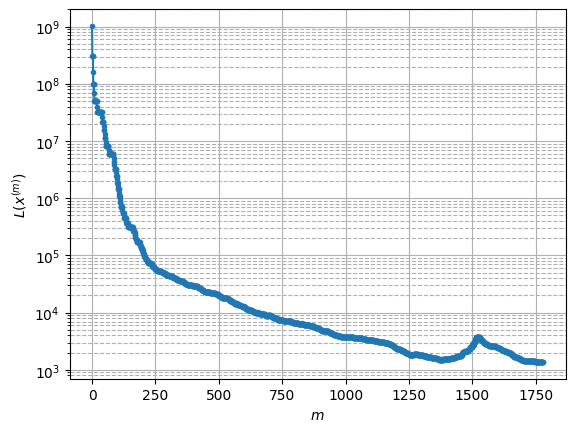

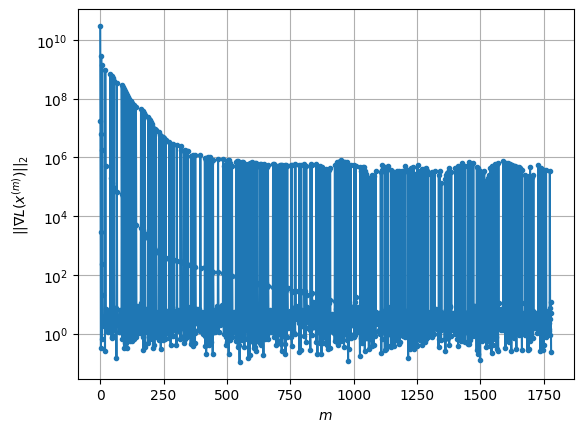

Windows:  58%|█████▊    | 171/296 [1:15:46<45:11, 21.69s/it]


Majorization-Minimization Iteration 1
Before applying the algorithm
Cost function: 1378.5480801171545
Gradient norm: 455263.51827828673
Global relative error: 31.850306473757534
Position relative errors: 0.02962033256935272 m, 18.502156405156306 m, 1.4467510106958164 m, 25.884654592581278 m

Iteration 1
Cost function: 1366.2519710364425 (-0.89%)
Gradient norm: 5.082963591952541 (-100.00%)
Global relative error = 31.743282551585075 (-0.34%)
Position relative errors: 0.03334757008406571 m, 18.461868944423454 m, 1.2804340561127192 m, 25.79053804772318 m

Iteration 2
Cost function: 1366.251970161079 (-0.00%)
Gradient norm: 4.555796588606261 (-10.37%)
Global relative error = 31.74328257621805 (0.00%)
Position relative errors: 0.033347603249866874 m, 18.461868937856448 m, 1.2804349221863347 m, 25.790538039701012 m

Iteration 3
Cost function: 1366.2519706440048 (0.00%)
Gradient norm: 2.5959119369606976 (-43.02%)
Global relative error = 31.74328257681456 (0.00%)
Position relative errors: 0.03

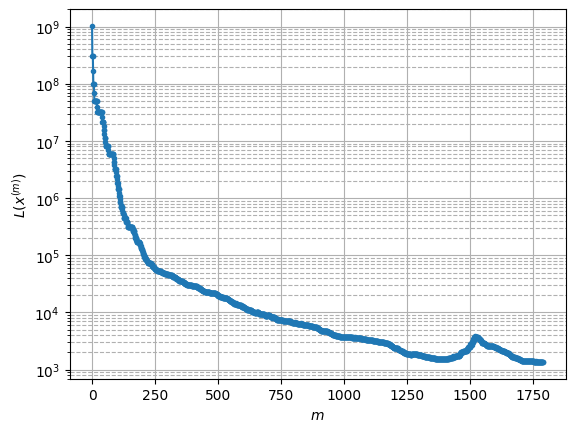

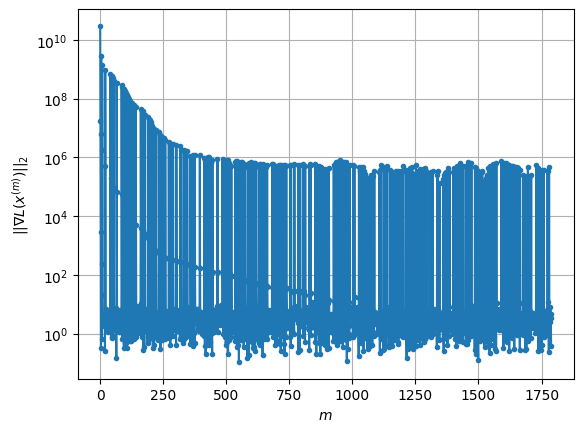

Windows:  58%|█████▊    | 172/296 [1:16:08<44:29, 21.53s/it]


Majorization-Minimization Iteration 1
Before applying the algorithm
Cost function: 1367.1839308620793
Gradient norm: 361486.66394496424
Global relative error: 34.777451590000844
Position relative errors: 0.031362391495630415 m, 20.645097502088216 m, 2.037120109412437 m, 27.912319608172574 m

Iteration 1
Cost function: 1356.0182454845963 (-0.82%)
Gradient norm: 3.8985665200180684 (-100.00%)
Global relative error = 34.66558011444941 (-0.32%)
Position relative errors: 0.03549842082541104 m, 20.60039982194066 m, 1.8830048524827165 m, 27.816835874839274 m

Iteration 2
Cost function: 1356.0182443885549 (-0.00%)
Gradient norm: 2.4494408007290165 (-37.17%)
Global relative error = 34.66558015182829 (0.00%)
Position relative errors: 0.03549845050882936 m, 20.600399828813373 m, 1.8830056395513626 m, 27.816835863014127 m

STOP on Iteration 3
Cost function = 1356.0182482381638 (0.00%)
Gradient norm = 0.5582115070724407 (-77.21%)
Global relative error = 34.665580151174765 (-0.00%)
Final position re

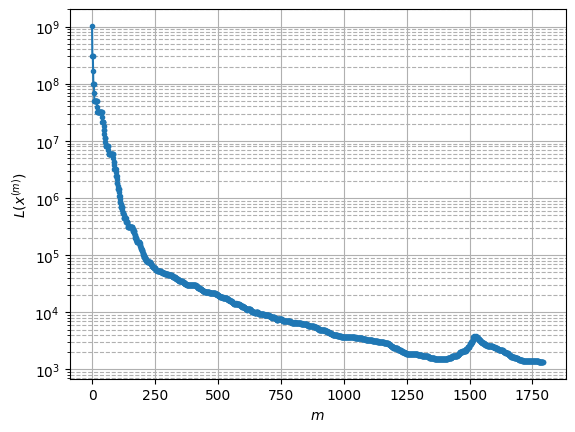

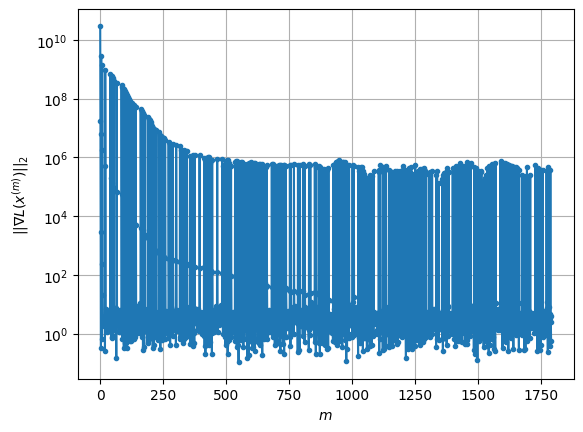

Windows:  58%|█████▊    | 173/296 [1:16:17<36:45, 17.93s/it]


Majorization-Minimization Iteration 1
Before applying the algorithm
Cost function: 1347.315678001333
Gradient norm: 290244.51626333984
Global relative error: 37.564027587048514
Position relative errors: 0.03396600604697155 m, 22.6937296184401 m, 2.626367539848684 m, 29.81860916782923 m

STOP on Iteration 1
Cost function = 1337.1562344691006 (-0.75%)
Gradient norm = 0.9628984859333977 (-100.00%)
Global relative error = 37.44901783060279 (-0.31%)
Final position relative errors: 0.03941373863048894 m, 22.64618932906856 m, 2.475445241440972 m, 29.722841106983182 m

Majorization-Minimization converged after 1 iterations


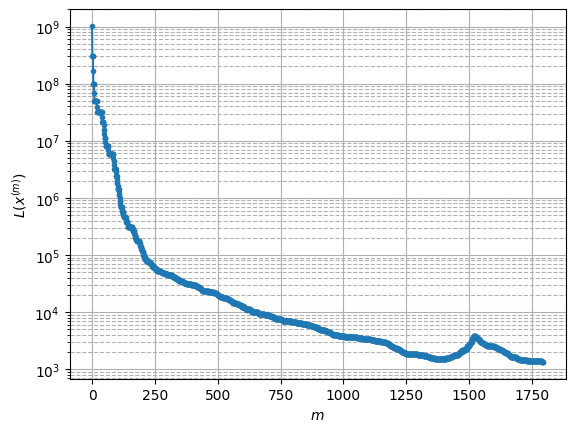

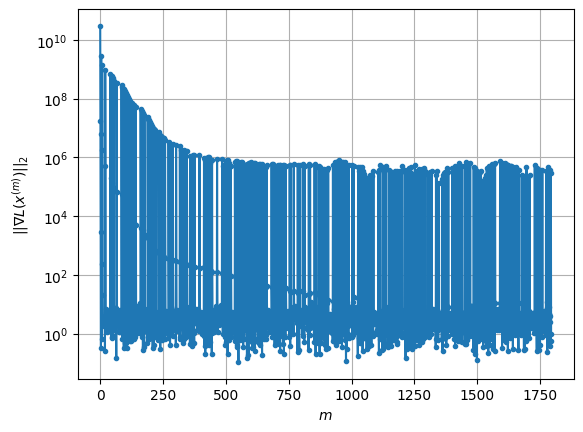

Windows:  59%|█████▉    | 174/296 [1:16:22<28:40, 14.10s/it]


Majorization-Minimization Iteration 1
Before applying the algorithm
Cost function: 1340.2400875018118
Gradient norm: 412474.2204502474
Global relative error: 40.194619565974044
Position relative errors: 0.03850332234798306 m, 24.640051985794248 m, 3.197250083038613 m, 31.59508299554483 m

STOP on Iteration 1
Cost function = 1329.8458926755231 (-0.78%)
Gradient norm = 0.8898283228069118 (-100.00%)
Global relative error = 40.0734853681547 (-0.30%)
Final position relative errors: 0.046855801836073366 m, 24.590925406723315 m, 3.0474439964378197 m, 31.4941168771906 m

Majorization-Minimization converged after 1 iterations


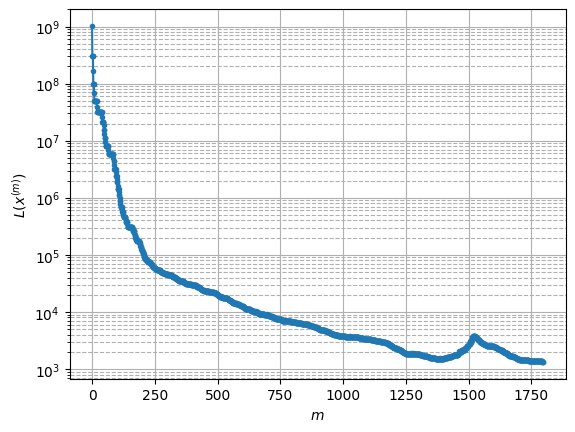

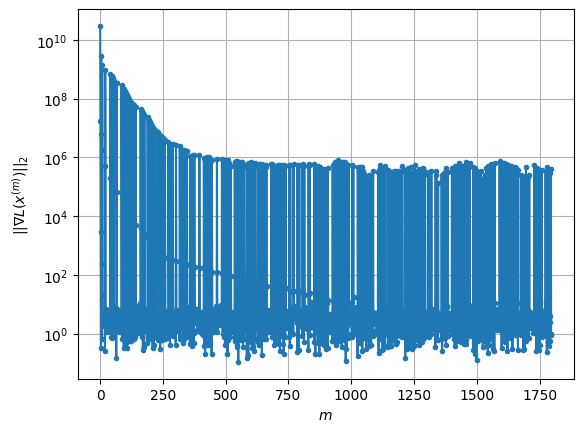

Windows:  59%|█████▉    | 175/296 [1:16:27<23:03, 11.43s/it]


Majorization-Minimization Iteration 1
Before applying the algorithm
Cost function: 1338.3049418139717
Gradient norm: 388824.48036638065
Global relative error: 42.651729578157
Position relative errors: 0.04583044087724067 m, 26.475911792824732 m, 3.7446956314633093 m, 33.22904505493801 m

Iteration 1
Cost function: 1327.8086695401507 (-0.78%)
Gradient norm: 3.86487229315533 (-100.00%)
Global relative error = 42.526934290738566 (-0.29%)
Position relative errors: 0.05992696943777596 m, 26.426904116135425 m, 3.593488537150487 m, 33.12461755159308 m

STOP on Iteration 2
Cost function = 1327.8086699997464 (0.00%)
Gradient norm = 0.3059858921871964 (-92.08%)
Global relative error = 42.52693435829978 (0.00%)
Final position relative errors: 0.05992697558962887 m, 26.426904115527087 m, 3.5934892556258666 m, 33.1246175608623 m

Majorization-Minimization converged after 1 iterations


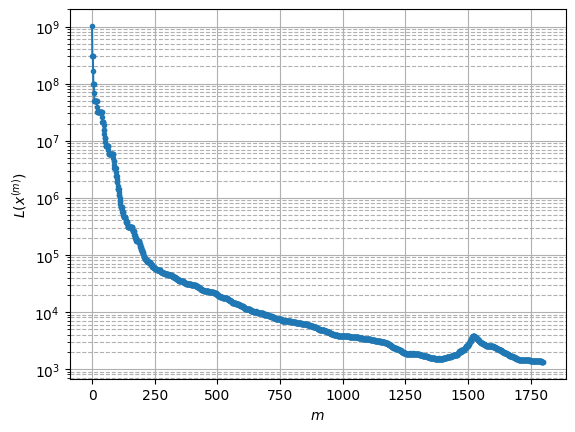

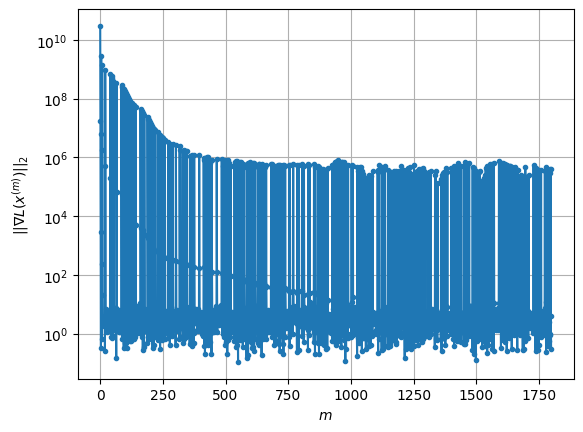

Windows:  59%|█████▉    | 176/296 [1:16:35<20:27, 10.23s/it]


Majorization-Minimization Iteration 1
Before applying the algorithm
Cost function: 1314.1793122342056
Gradient norm: 409653.81344351894
Global relative error: 44.92481407745912
Position relative errors: 0.058978593474216884 m, 28.19476430145037 m, 4.2651899861371945 m, 34.714511039148555 m

STOP on Iteration 1
Cost function = 1302.7795127130335 (-0.87%)
Gradient norm = 0.8236236190572626 (-100.00%)
Global relative error = 44.79610703217646 (-0.29%)
Final position relative errors: 0.0717866083844898 m, 28.142935757715893 m, 4.112302010513449 m, 34.608504946642555 m

Majorization-Minimization converged after 1 iterations


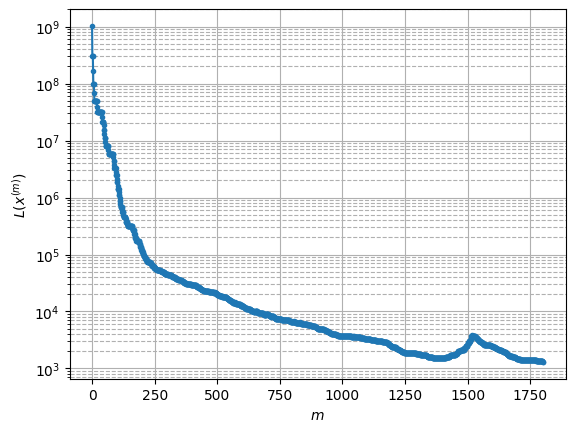

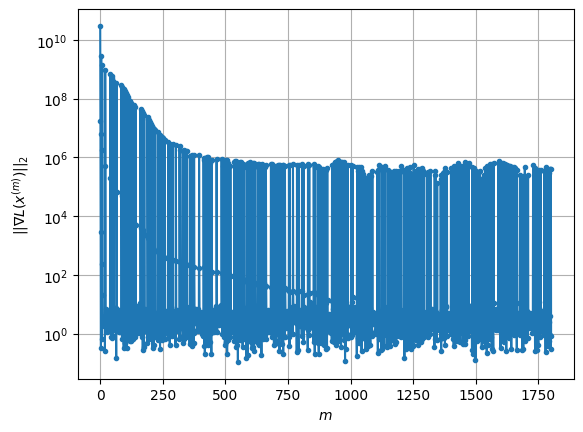

Windows:  60%|█████▉    | 177/296 [1:16:40<17:15,  8.70s/it]


Majorization-Minimization Iteration 1
Before applying the algorithm
Cost function: 1297.240530819131
Gradient norm: 487189.9632065356
Global relative error: 47.00243846745798
Position relative errors: 0.07043677535302821 m, 29.78634922394718 m, 4.757686705679443 m, 36.046646825641716 m

Iteration 1
Cost function: 1286.6966697859384 (-0.81%)
Gradient norm: 5.405958766358719 (-100.00%)
Global relative error = 46.87406185223142 (-0.27%)
Position relative errors: 0.06647567434151487 m, 29.731713733215297 m, 4.603929620534487 m, 35.94441490623151 m

STOP on Iteration 2
Cost function = 1286.6966684912106 (-0.00%)
Gradient norm = 0.5706691469508276 (-89.44%)
Global relative error = 46.874061930676525 (0.00%)
Final position relative errors: 0.06647569019338558 m, 29.73171373174793 m, 4.603930184705014 m, 35.944414937452166 m

Majorization-Minimization converged after 1 iterations


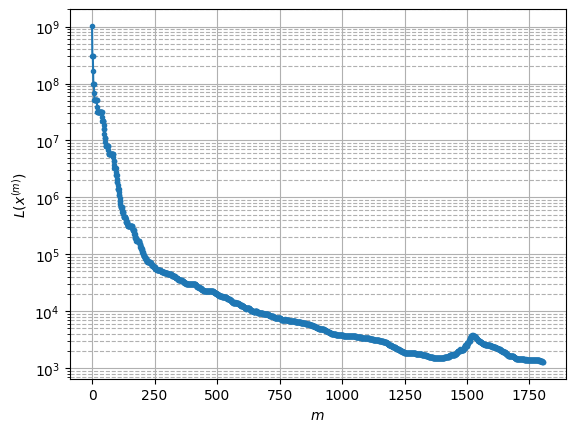

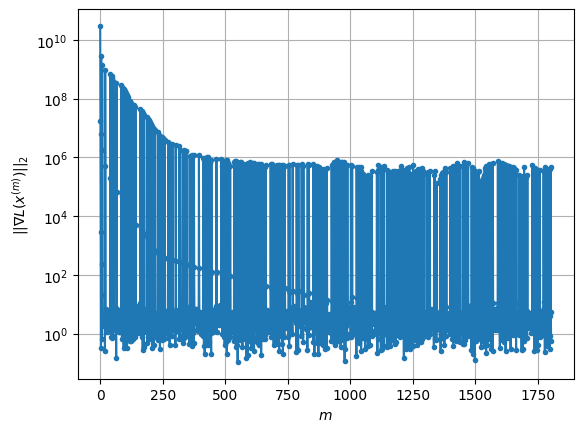

Windows:  60%|██████    | 178/296 [1:16:47<16:21,  8.32s/it]


Majorization-Minimization Iteration 1
Before applying the algorithm
Cost function: 1264.154315483762
Gradient norm: 298474.7419370247
Global relative error: 48.878425005425484
Position relative errors: 0.06484415210675445 m, 31.243881486220552 m, 5.222166428450972 m, 37.224239196940765 m

Iteration 1
Cost function: 1255.1787172606953 (-0.71%)
Gradient norm: 3.151232078195954 (-100.00%)
Global relative error = 48.75264642211153 (-0.26%)
Position relative errors: 0.07386712366841532 m, 31.187208114903964 m, 5.065709167058437 m, 37.12829962837109 m

Iteration 2
Cost function: 1255.1787171280694 (-0.00%)
Gradient norm: 2.983292672307326 (-5.33%)
Global relative error = 48.7526465235933 (0.00%)
Position relative errors: 0.07386712944726062 m, 31.187208121468085 m, 5.065709759872944 m, 37.12829967521759 m

Iteration 3
Cost function: 1255.1787159131661 (-0.00%)
Gradient norm: 7.390270070477046 (147.72%)
Global relative error = 48.75264652365694 (0.00%)
Position relative errors: 0.07386712736

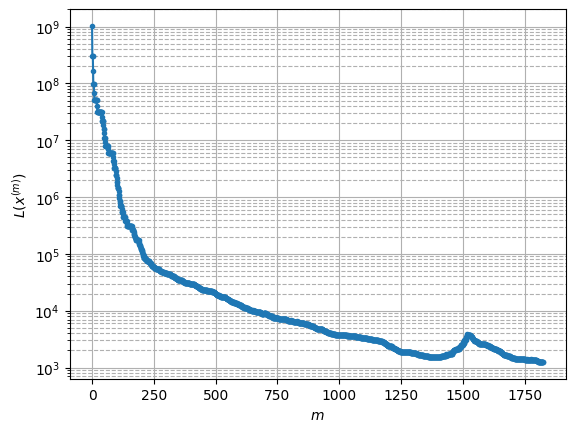

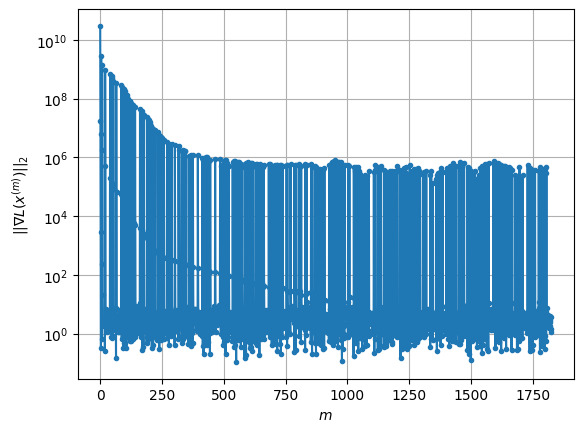

Windows:  60%|██████    | 179/296 [1:17:34<38:51, 19.93s/it]


Majorization-Minimization Iteration 1
Before applying the algorithm
Cost function: 1230.1371201787388
Gradient norm: 353869.659633275
Global relative error: 50.545910582073475
Position relative errors: 0.07219677366247403 m, 32.561863008125826 m, 5.656069007552601 m, 38.24417546785816 m

Iteration 1
Cost function: 1221.3808135839295 (-0.71%)
Gradient norm: 2.349763694435456 (-100.00%)
Global relative error = 50.42202474856651 (-0.25%)
Position relative errors: 0.07441826373756895 m, 32.50403534748446 m, 5.4971659033997495 m, 38.152890212114876 m

Iteration 2
Cost function: 1221.3808126643046 (-0.00%)
Gradient norm: 2.918393484576991 (24.20%)
Global relative error = 50.422024851920064 (0.00%)
Position relative errors: 0.07441827625795334 m, 32.50403535431307 m, 5.497166479706962 m, 38.15289025982678 m

Iteration 3
Cost function: 1221.3808121565028 (-0.00%)
Gradient norm: 1.283277554430934 (-56.03%)
Global relative error = 50.42202485232564 (0.00%)
Position relative errors: 0.0744182740

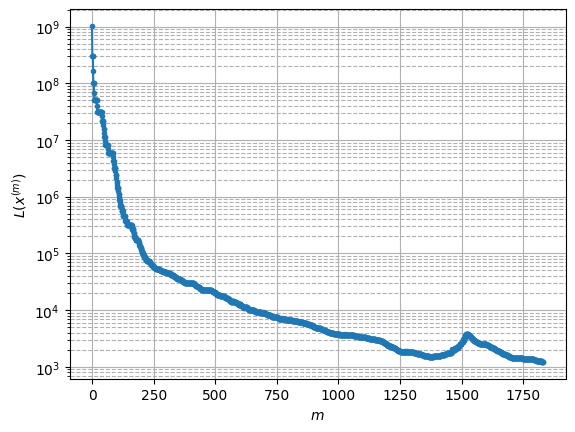

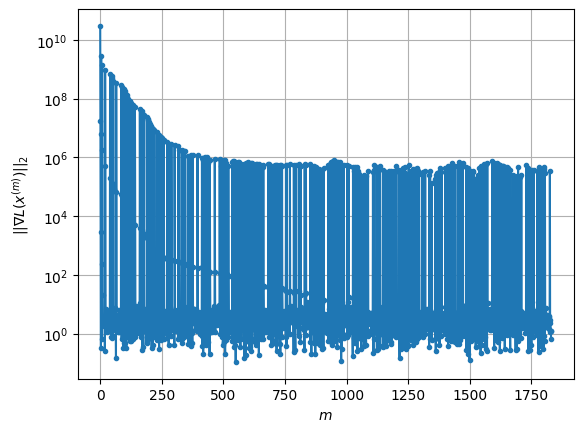

Windows:  61%|██████    | 180/296 [1:17:49<35:15, 18.24s/it]


Majorization-Minimization Iteration 1
Before applying the algorithm
Cost function: 1204.20481495256
Gradient norm: 310067.61921424593
Global relative error: 51.9964173434781
Position relative errors: 0.07268433980820986 m, 33.73545661221852 m, 6.0590229457207485 m, 39.100238800863245 m

Iteration 1
Cost function: 1195.1029458807839 (-0.76%)
Gradient norm: 2.9634123514753155 (-100.00%)
Global relative error = 51.87459202800742 (-0.23%)
Position relative errors: 0.08398814615762852 m, 33.67858179485711 m, 5.901772620924882 m, 39.011380240689476 m

Iteration 2
Cost function: 1195.1029470267638 (0.00%)
Gradient norm: 6.786797754778399 (129.02%)
Global relative error = 51.87459213656126 (0.00%)
Position relative errors: 0.08398814518059171 m, 33.67858180850689 m, 5.90177321806298 m, 39.011380282917834 m

Iteration 3
Cost function: 1195.1029454812883 (-0.00%)
Gradient norm: 7.518958570556992 (10.79%)
Global relative error = 51.87459213685002 (0.00%)
Position relative errors: 0.0839881551870

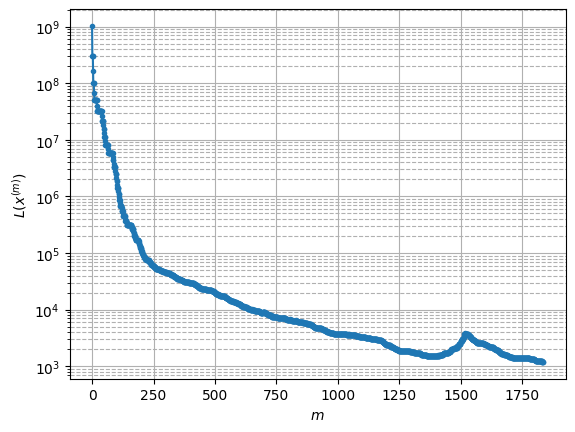

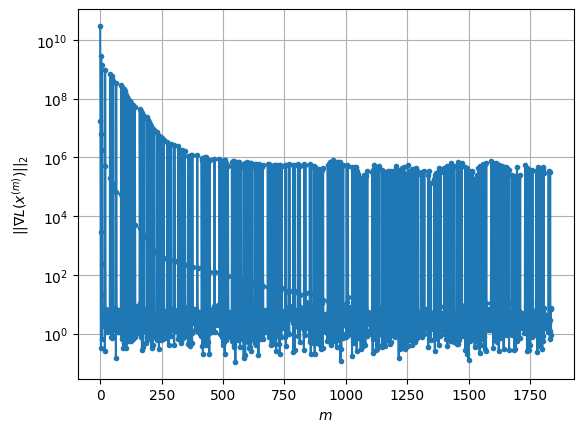

Windows:  61%|██████    | 181/296 [1:18:01<31:41, 16.54s/it]


Majorization-Minimization Iteration 1
Before applying the algorithm
Cost function: 1170.7495212395656
Gradient norm: 235956.22013576687
Global relative error: 53.2235558230591
Position relative errors: 0.08194234988175188 m, 34.76174989458022 m, 6.434023352852584 m, 39.78647730002836 m

Iteration 1
Cost function: 1162.310683415141 (-0.72%)
Gradient norm: 2.603878435926062 (-100.00%)
Global relative error = 53.10499184272367 (-0.22%)
Position relative errors: 0.09045317215546071 m, 34.706798860129865 m, 6.273223383272554 m, 39.70159025468846 m

Iteration 2
Cost function: 1162.310683930905 (0.00%)
Gradient norm: 3.4721417256904155 (33.35%)
Global relative error = 53.10499196005519 (0.00%)
Position relative errors: 0.09045317191659467 m, 34.70679887421775 m, 6.273223994351124 m, 39.70159030276037 m

Iteration 3
Cost function: 1162.310685288213 (0.00%)
Gradient norm: 1.4157450320232365 (-59.23%)
Global relative error = 53.10499196028368 (0.00%)
Position relative errors: 0.0904531628458963

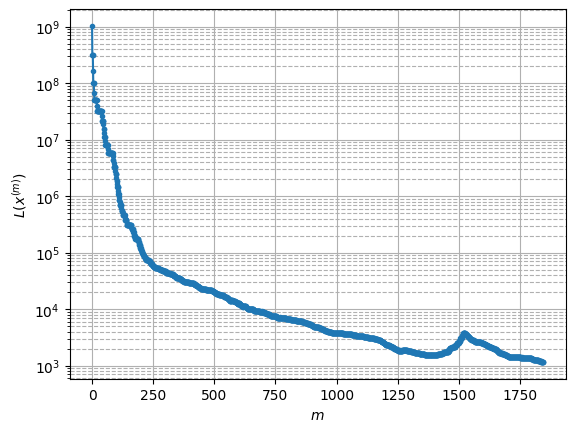

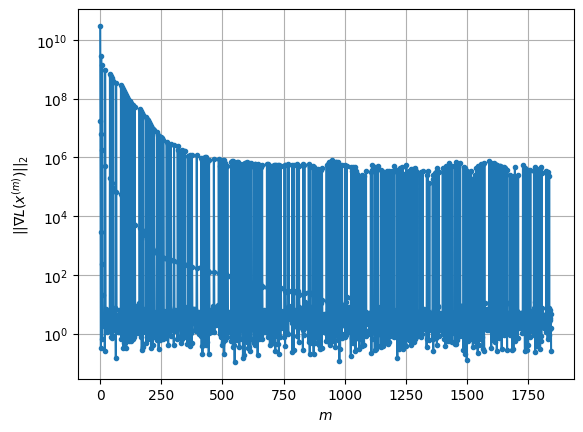

Windows:  61%|██████▏   | 182/296 [1:18:24<35:06, 18.48s/it]


Majorization-Minimization Iteration 1
Before applying the algorithm
Cost function: 1139.9827260707254
Gradient norm: 189514.90131183912
Global relative error: 54.22307456809452
Position relative errors: 0.0882591014535559 m, 35.63716870107595 m, 6.775636458611943 m, 40.30157118520423 m

Iteration 1
Cost function: 1131.9157031293698 (-0.71%)
Gradient norm: 2.142250812280005 (-100.00%)
Global relative error = 54.108365752656425 (-0.21%)
Position relative errors: 0.10105432478235002 m, 35.582872462328666 m, 6.619161746020675 m, 40.22127018732141 m

STOP on Iteration 2
Cost function = 1131.9157021518279 (-0.00%)
Gradient norm = 0.3376661691870411 (-84.24%)
Global relative error = 54.108365873517336 (0.00%)
Final position relative errors: 0.1010543305511648 m, 35.58287247910459 m, 6.619162351615675 m, 40.22127023539387 m

Majorization-Minimization converged after 1 iterations


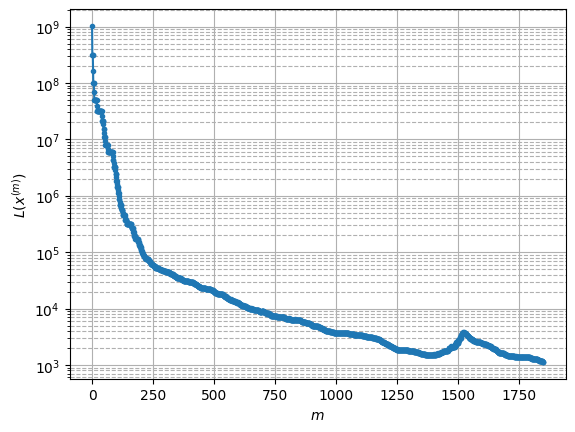

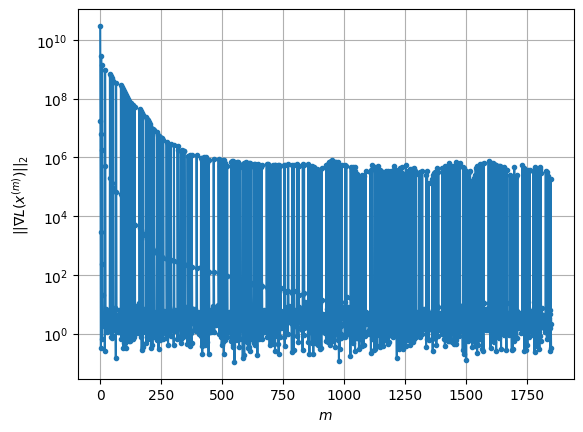

Windows:  62%|██████▏   | 183/296 [1:18:32<28:33, 15.16s/it]


Majorization-Minimization Iteration 1
Before applying the algorithm
Cost function: 1109.4484877105872
Gradient norm: 298107.8249042226
Global relative error: 54.99123128072618
Position relative errors: 0.09851580126062479 m, 36.35668088466266 m, 7.090272699236939 m, 40.64413088683635 m

Iteration 1
Cost function: 1101.3812107867286 (-0.73%)
Gradient norm: 1.899194470631675 (-100.00%)
Global relative error = 54.879787875305446 (-0.20%)
Position relative errors: 0.08528758852130648 m, 36.303388972793 m, 6.933160106683352 m, 40.56820009652893 m

STOP on Iteration 2
Cost function = 1101.381210586466 (-0.00%)
Gradient norm = 0.49718162871467325 (-73.82%)
Global relative error = 54.87978798869816 (0.00%)
Final position relative errors: 0.08528758321152011 m, 36.30338898236062 m, 6.933160690120069 m, 40.56820014166338 m

Majorization-Minimization converged after 1 iterations


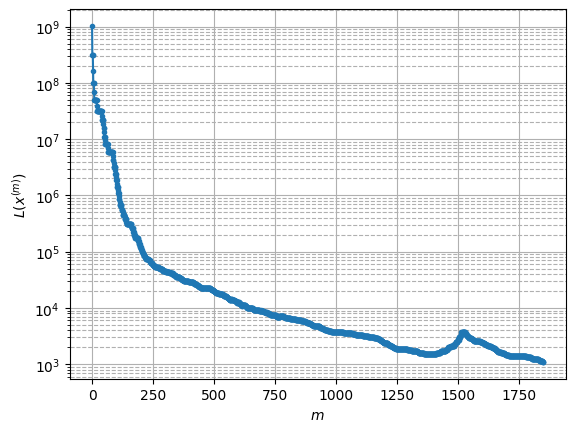

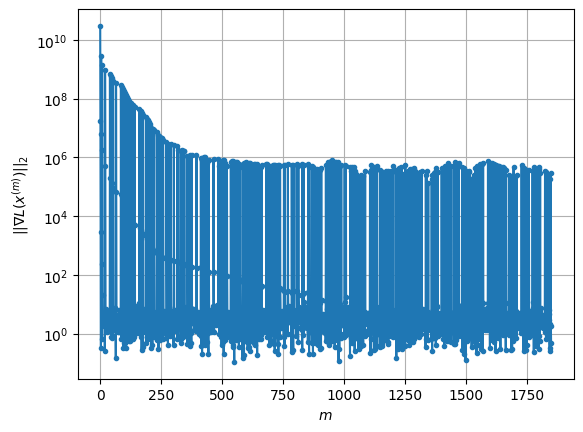

Windows:  62%|██████▏   | 184/296 [1:18:39<24:07, 12.93s/it]


Majorization-Minimization Iteration 1
Before applying the algorithm
Cost function: 1088.0665377951966
Gradient norm: 297902.1343081729
Global relative error: 55.524333749234
Position relative errors: 0.08376762113290792 m, 36.917539990832715 m, 7.372667335918629 m, 40.81278599918865 m

Iteration 1
Cost function: 1080.5334824096103 (-0.69%)
Gradient norm: 2.9939737804076807 (-100.00%)
Global relative error = 55.4157831982503 (-0.20%)
Position relative errors: 0.08083964090704138 m, 36.86531186936548 m, 7.215001081157634 m, 40.740580447441076 m

Iteration 2
Cost function: 1080.5334835205404 (0.00%)
Gradient norm: 4.134202382915936 (38.08%)
Global relative error = 55.41578328677616 (0.00%)
Position relative errors: 0.08083963667788055 m, 36.86531186640495 m, 7.215001568354898 m, 40.74058048426146 m

Iteration 3
Cost function: 1080.533484232302 (0.00%)
Gradient norm: 1.2148302793404484 (-70.62%)
Global relative error = 55.41578328715831 (0.00%)
Position relative errors: 0.0808396490749110

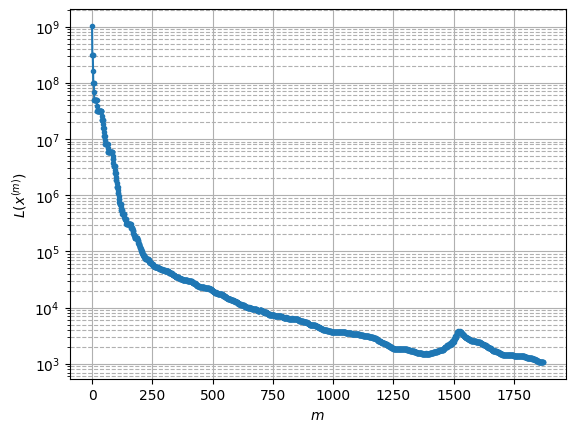

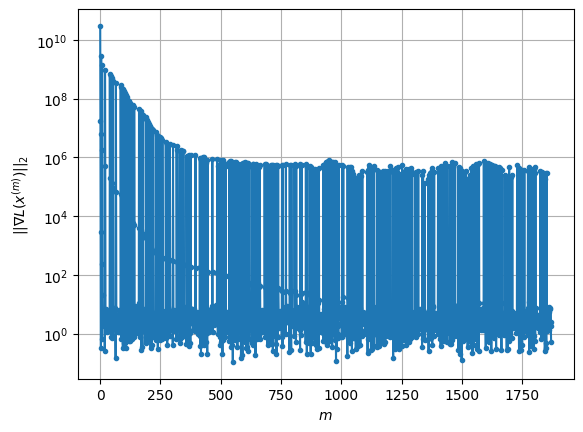

Windows:  62%|██████▎   | 185/296 [1:19:26<42:35, 23.02s/it]


Majorization-Minimization Iteration 1
Before applying the algorithm
Cost function: 1065.5322956142727
Gradient norm: 198681.89017307066
Global relative error: 55.8200294281771
Position relative errors: 0.07933138562555539 m, 37.317424323012396 m, 7.622681223944584 m, 40.80654214842991 m

Iteration 1
Cost function: 1058.2913547096762 (-0.68%)
Gradient norm: 6.869330950168932 (-100.00%)
Global relative error = 55.71501668670504 (-0.19%)
Position relative errors: 0.0889240598003861 m, 37.26532277211261 m, 7.466283383903743 m, 40.73948238930492 m

Iteration 2
Cost function: 1058.2913540096772 (-0.00%)
Gradient norm: 4.986552839787897 (-27.41%)
Global relative error = 55.715016795347836 (0.00%)
Position relative errors: 0.08892405153627661 m, 37.26532278288338 m, 7.466283910952073 m, 40.73948243145819 m

Iteration 3
Cost function: 1058.291354650431 (0.00%)
Gradient norm: 1.2515299587407782 (-74.90%)
Global relative error = 55.71501679576649 (0.00%)
Position relative errors: 0.0889240528591

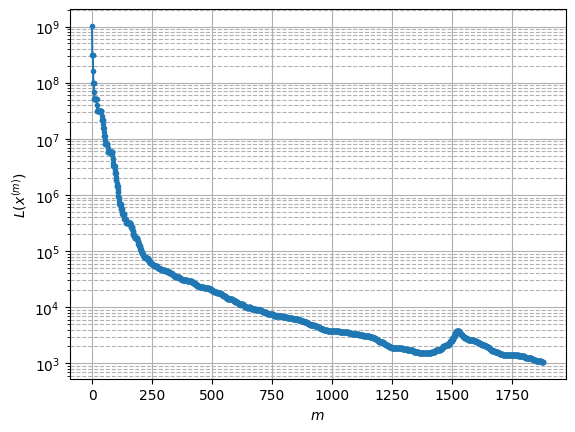

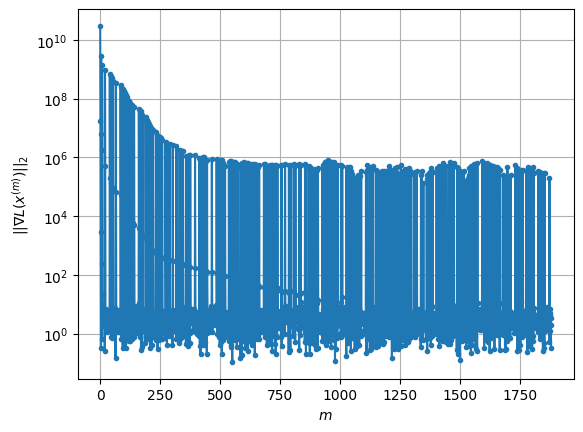

Windows:  63%|██████▎   | 186/296 [1:19:45<40:06, 21.87s/it]


Majorization-Minimization Iteration 1
Before applying the algorithm
Cost function: 1042.1118369959322
Gradient norm: 156275.03379123588
Global relative error: 55.87809768333616
Position relative errors: 0.08745840783614045 m, 37.55374372765881 m, 7.841821914131326 m, 40.6272845808428 m

Iteration 1
Cost function: 1035.7844490467762 (-0.61%)
Gradient norm: 2.464099860659061 (-100.00%)
Global relative error = 55.77616041260024 (-0.18%)
Position relative errors: 0.0945220471804426 m, 37.50241574937106 m, 7.68743207819702 m, 40.56406385417061 m

STOP on Iteration 2
Cost function = 1035.7844489405707 (-0.00%)
Gradient norm = 0.8850428729620023 (-64.08%)
Global relative error = 55.77616049532999 (0.00%)
Final position relative errors: 0.09452204772951082 m, 37.50241575895636 m, 7.687432475954665 m, 40.564063883681726 m

Majorization-Minimization converged after 1 iterations


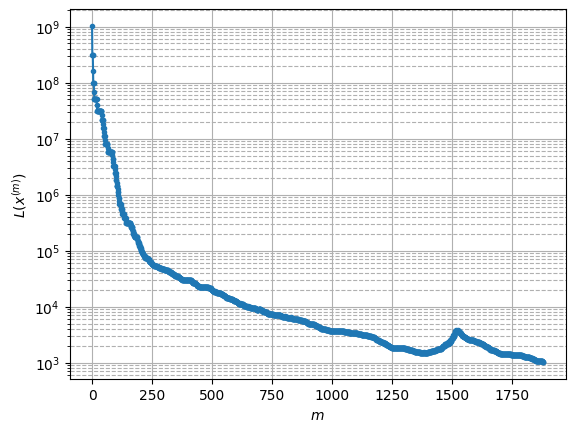

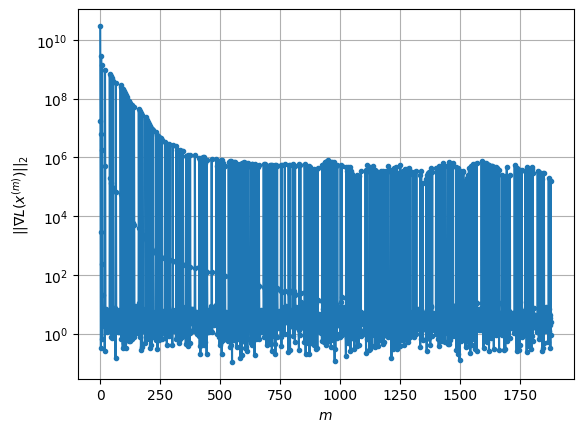

Windows:  63%|██████▎   | 187/296 [1:19:53<32:04, 17.66s/it]


Majorization-Minimization Iteration 1
Before applying the algorithm
Cost function: 1046.3884096785268
Gradient norm: 306506.2158659004
Global relative error: 55.69837977044568
Position relative errors: 0.09292687916269352 m, 37.62628305726078 m, 8.030615655385017 m, 40.27496540231523 m

STOP on Iteration 1
Cost function = 1039.5251291727932 (-0.66%)
Gradient norm = 0.7512229365868013 (-100.00%)
Global relative error = 55.59945775490104 (-0.18%)
Final position relative errors: 0.08004663985191293 m, 37.57643088094732 m, 7.879281880596889 m, 40.21469859926433 m

Majorization-Minimization converged after 1 iterations


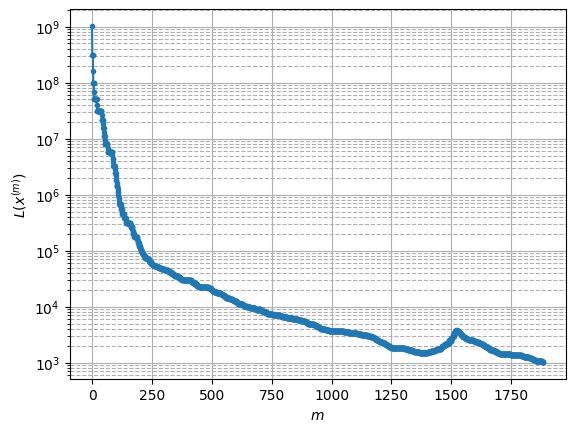

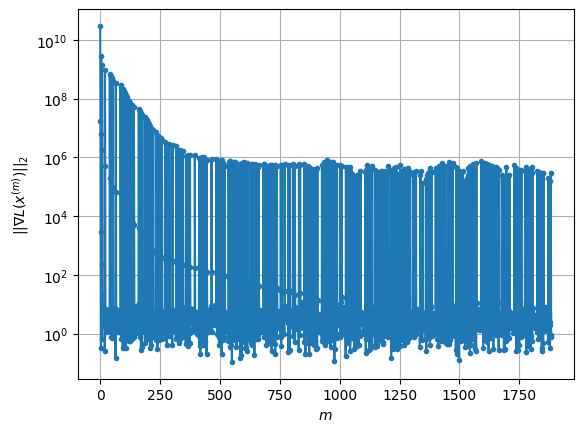

Windows:  64%|██████▎   | 188/296 [1:19:58<25:05, 13.94s/it]


Majorization-Minimization Iteration 1
Before applying the algorithm
Cost function: 1041.6092958032834
Gradient norm: 275809.41045053425
Global relative error: 55.282219656766976
Position relative errors: 0.07928423150736892 m, 37.53554291334127 m, 8.189836419569732 m, 39.75081141514797 m

Iteration 1
Cost function: 1035.227253069449 (-0.61%)
Gradient norm: 4.5397079298654495 (-100.00%)
Global relative error = 55.1850272845392 (-0.18%)
Position relative errors: 0.08046203230655972 m, 37.48529920967497 m, 8.043061844054662 m, 39.69309950383871 m

Iteration 2
Cost function: 1035.2272531078884 (0.00%)
Gradient norm: 2.4523498182443038 (-45.98%)
Global relative error = 55.18502735954976 (0.00%)
Position relative errors: 0.08046202219256292 m, 37.48529922183015 m, 8.043062138401297 m, 39.69309953702297 m

Iteration 3
Cost function: 1035.227253529247 (0.00%)
Gradient norm: 1.5613076336245526 (-36.33%)
Global relative error = 55.185027359469075 (-0.00%)
Position relative errors: 0.08046202459

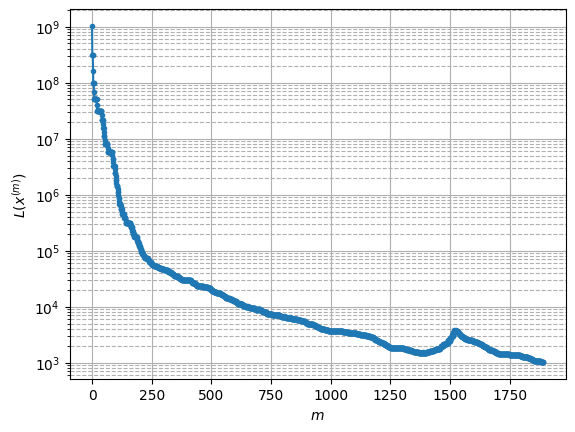

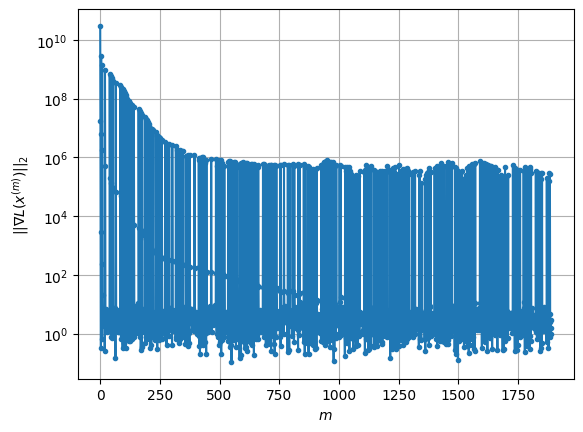

Windows:  64%|██████▍   | 189/296 [1:20:13<25:00, 14.03s/it]


Majorization-Minimization Iteration 1
Before applying the algorithm
Cost function: 1037.7060519526808
Gradient norm: 186178.59902044974
Global relative error: 54.630935345096134
Position relative errors: 0.07976047527672016 m, 37.28034038123178 m, 8.320740911304904 m, 39.05731736168489 m

Iteration 1
Cost function: 1032.650066495311 (-0.49%)
Gradient norm: 1.1788320026780597 (-100.00%)
Global relative error = 54.53542734695221 (-0.17%)
Position relative errors: 0.0701737631047973 m, 37.22961921555567 m, 8.183250932087798 m, 39.00125103589187 m

Iteration 2
Cost function: 1032.65006567947 (-0.00%)
Gradient norm: 2.5805206424656646 (118.90%)
Global relative error = 54.53542741169801 (0.00%)
Position relative errors: 0.07017375787250293 m, 37.22961923221074 m, 8.18325117456616 m, 39.00125105965995 m

Iteration 3
Cost function: 1032.6500668484534 (0.00%)
Gradient norm: 2.5687083470299332 (-0.46%)
Global relative error = 54.53542741211631 (0.00%)
Position relative errors: 0.070173754551493

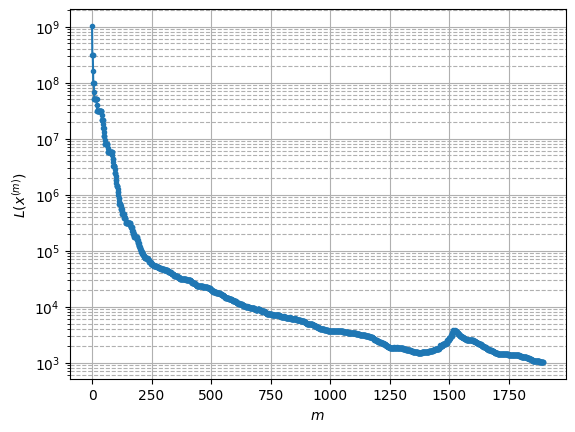

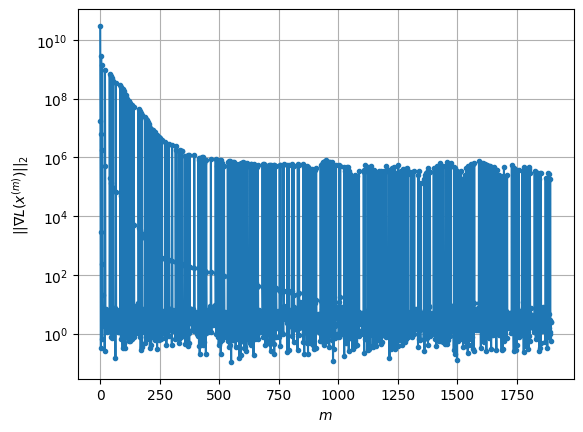

Windows:  64%|██████▍   | 190/296 [1:20:25<23:49, 13.49s/it]


Majorization-Minimization Iteration 1
Before applying the algorithm
Cost function: 1030.0653323193824
Gradient norm: 191321.59644787558
Global relative error: 53.748084105299824
Position relative errors: 0.0703469253291789 m, 36.861914373588256 m, 8.427300969142868 m, 38.197266570048725 m

STOP on Iteration 1
Cost function = 1025.2605262745792 (-0.47%)
Gradient norm = 0.6489847188818976 (-100.00%)
Global relative error = 53.656101836336646 (-0.17%)
Final position relative errors: 0.07040860436587922 m, 36.81295285318079 m, 8.299205629560332 m, 38.143173784317014 m

Majorization-Minimization converged after 1 iterations


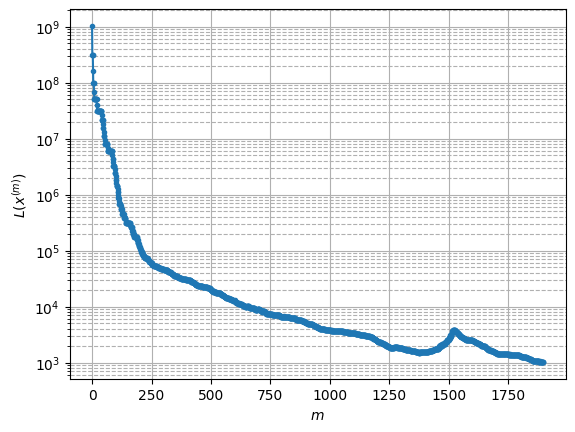

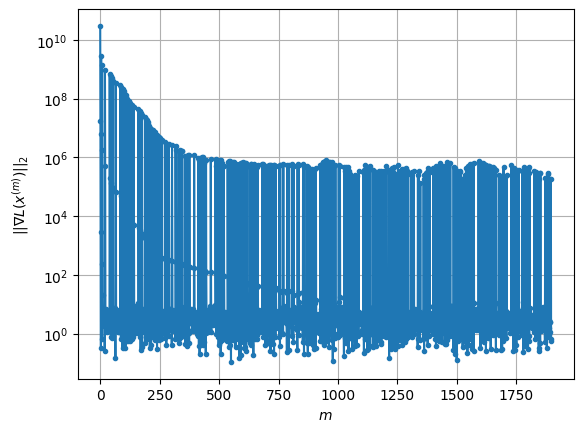

Windows:  65%|██████▍   | 191/296 [1:20:30<19:22, 11.07s/it]


Majorization-Minimization Iteration 1
Before applying the algorithm
Cost function: 1036.3541035943344
Gradient norm: 374054.74707019445
Global relative error: 52.64001107251639
Position relative errors: 0.07044817483516945 m, 36.28449349241525 m, 8.50890375063142 m, 37.175253487359896 m

Iteration 1
Cost function: 1031.5837912938046 (-0.46%)
Gradient norm: 5.391104569742245 (-100.00%)
Global relative error = 52.55019021860585 (-0.17%)
Position relative errors: 0.07021796078707744 m, 36.23696482518107 m, 8.387541403358233 m, 37.122077973319264 m

Iteration 2
Cost function: 1031.5837912722131 (-0.00%)
Gradient norm: 5.485812012349505 (1.76%)
Global relative error = 52.55019028068619 (0.00%)
Position relative errors: 0.07021795555971803 m, 36.23696485129833 m, 8.387541560623948 m, 37.122078000182476 m

Iteration 3
Cost function: 1031.5837916538949 (0.00%)
Gradient norm: 1.0044084186514495 (-81.69%)
Global relative error = 52.55019028028556 (-0.00%)
Position relative errors: 0.07021796029

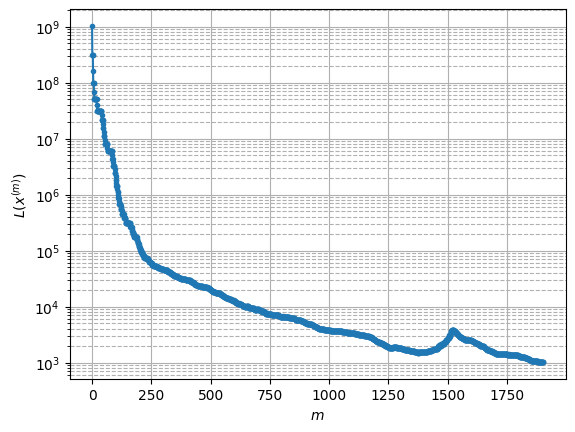

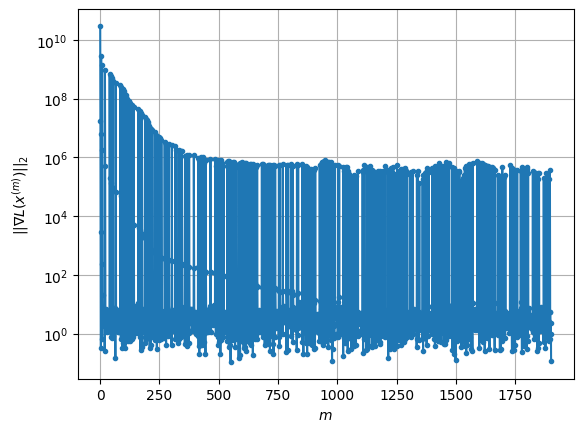

Windows:  65%|██████▍   | 192/296 [1:20:46<21:43, 12.53s/it]


Majorization-Minimization Iteration 1
Before applying the algorithm
Cost function: 1050.320672730441
Gradient norm: 315351.53672125266
Global relative error: 51.31108058395386
Position relative errors: 0.07003891357121271 m, 35.550561158078274 m, 8.562693716415529 m, 35.99526897709162 m

STOP on Iteration 1
Cost function = 1045.3232117222 (-0.48%)
Gradient norm = 0.5221493666616662 (-100.00%)
Global relative error = 51.222700273410545 (-0.17%)
Final position relative errors: 0.06614347562976992 m, 35.50436128312969 m, 8.448719496966177 m, 35.941891239302805 m

Majorization-Minimization converged after 1 iterations


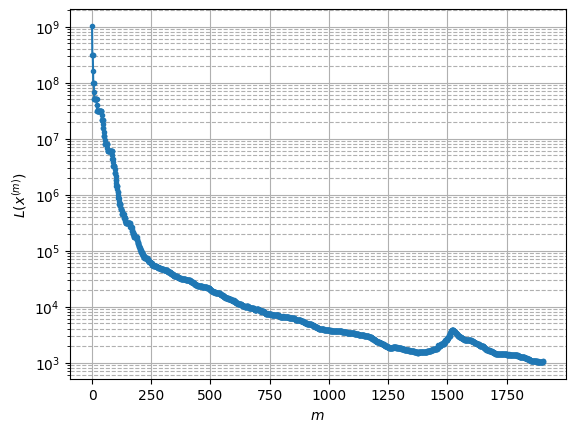

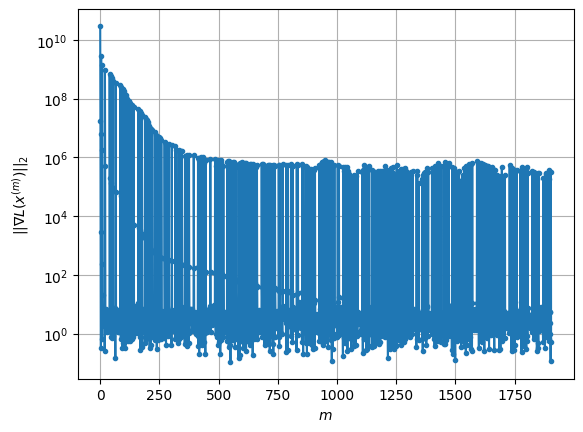

Windows:  65%|██████▌   | 193/296 [1:20:51<17:44, 10.34s/it]


Majorization-Minimization Iteration 1
Before applying the algorithm
Cost function: 1047.8719337803059
Gradient norm: 248027.57177735548
Global relative error: 49.76736840665029
Position relative errors: 0.06576472305360005 m, 34.663617742647354 m, 8.589224365812237 m, 34.66186251706896 m

Iteration 1
Cost function: 1044.0008129638513 (-0.37%)
Gradient norm: 2.821775368639406 (-100.00%)
Global relative error = 49.68243141943782 (-0.17%)
Position relative errors: 0.05321921777410201 m, 34.61846614669483 m, 8.482635955353715 m, 34.61137244463853 m

Iteration 2
Cost function: 1044.0008134174075 (0.00%)
Gradient norm: 2.742434023851148 (-2.81%)
Global relative error = 49.68243146827525 (0.00%)
Position relative errors: 0.05321921269740228 m, 34.61846617170123 m, 8.482636052859993 m, 34.61137246584078 m

Iteration 3
Cost function: 1044.0008135295366 (0.00%)
Gradient norm: 4.670926541081896 (70.32%)
Global relative error = 49.68243146863594 (0.00%)
Position relative errors: 0.053219212823891

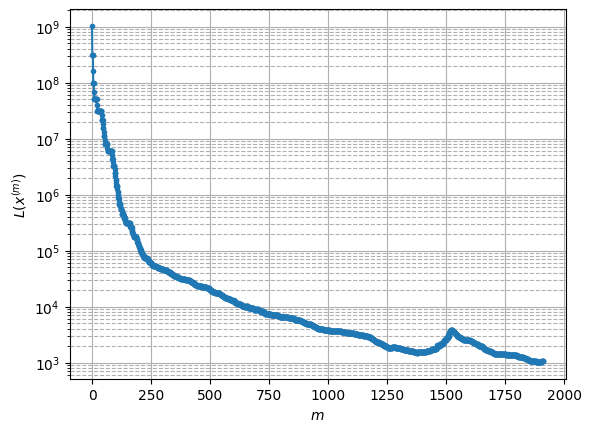

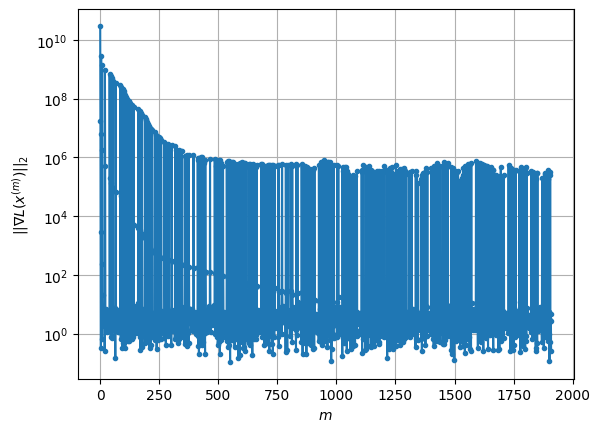

Windows:  66%|██████▌   | 194/296 [1:21:04<18:32, 10.91s/it]


Majorization-Minimization Iteration 1
Before applying the algorithm
Cost function: 1060.0799285659484
Gradient norm: 246772.05645339575
Global relative error: 48.01859332760871
Position relative errors: 0.053904201595982554 m, 33.627617559013466 m, 8.588475764656119 m, 33.18437700965736 m

Iteration 1
Cost function: 1055.7707795007188 (-0.41%)
Gradient norm: 1.2171167988672402 (-100.00%)
Global relative error = 47.93496660363038 (-0.17%)
Position relative errors: 0.05385923445638068 m, 33.5815419473567 m, 8.491230603819625 m, 33.13512075334568 m

STOP on Iteration 2
Cost function = 1055.7707785098041 (-0.00%)
Gradient norm = 0.459043264870953 (-62.28%)
Global relative error = 47.934966646063174 (0.00%)
Final position relative errors: 0.053859232447117905 m, 33.58154196799017 m, 8.491230661071665 m, 33.13512077915147 m

Majorization-Minimization converged after 1 iterations


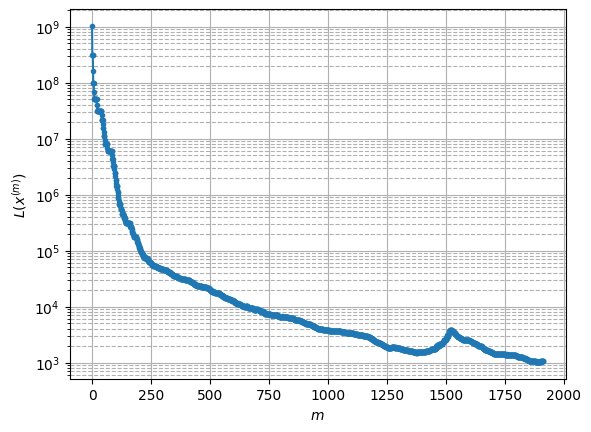

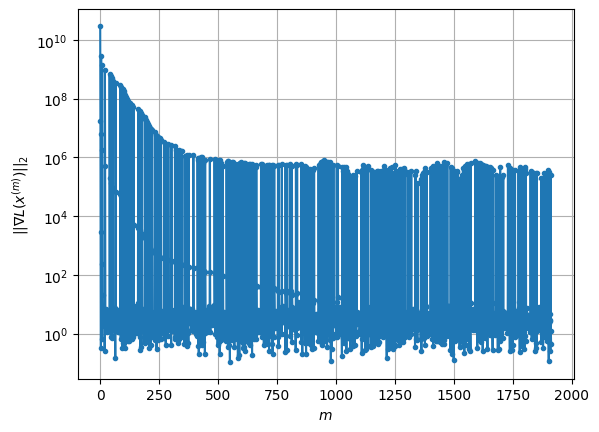

Windows:  66%|██████▌   | 195/296 [1:21:11<16:40,  9.90s/it]


Majorization-Minimization Iteration 1
Before applying the algorithm
Cost function: 1082.819745433309
Gradient norm: 341091.60769476887
Global relative error: 46.07144697976547
Position relative errors: 0.054186055908312006 m, 32.44555903193631 m, 8.562739922164383 m, 31.568011080670214 m

Iteration 1
Cost function: 1077.5449886537717 (-0.49%)
Gradient norm: 4.405801722981636 (-100.00%)
Global relative error = 45.989299815152016 (-0.18%)
Position relative errors: 0.049710097119283425 m, 32.40131268912115 m, 8.476055525311892 m, 31.5170350734569 m

Iteration 2
Cost function: 1077.544989276785 (0.00%)
Gradient norm: 2.0198639755317047 (-54.15%)
Global relative error = 45.989299861922 (0.00%)
Position relative errors: 0.049710095697020985 m, 32.40131270619314 m, 8.476055573447653 m, 31.517035111208944 m

Iteration 3
Cost function: 1077.5449886255772 (-0.00%)
Gradient norm: 2.2173690044355694 (9.78%)
Global relative error = 45.98929986200999 (0.00%)
Position relative errors: 0.049710096813

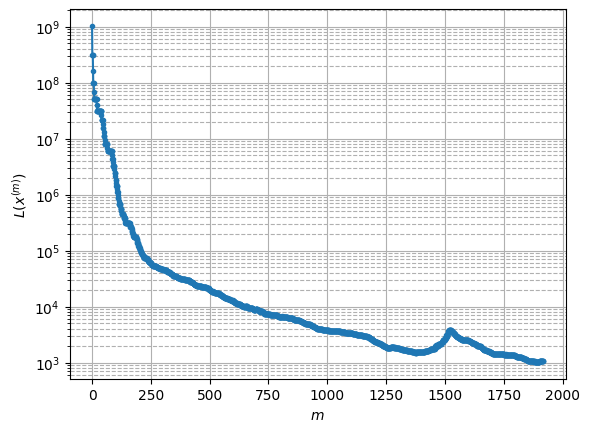

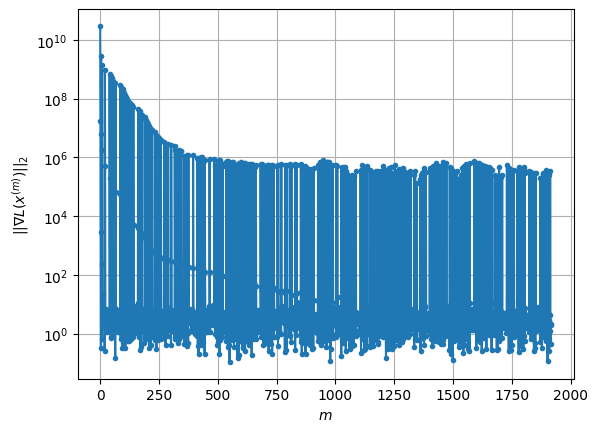

Windows:  66%|██████▌   | 196/296 [1:21:24<17:42, 10.63s/it]


Majorization-Minimization Iteration 1
Before applying the algorithm
Cost function: 1093.2965422186232
Gradient norm: 479714.3832307237
Global relative error: 43.935768570496585
Position relative errors: 0.05032748542509915 m, 31.125686026307555 m, 8.513335070182588 m, 29.81715366598334 m

Iteration 1
Cost function: 1087.601550032863 (-0.52%)
Gradient norm: 2.1264674301801025 (-100.00%)
Global relative error = 43.856630937256696 (-0.18%)
Position relative errors: 0.046740904729117135 m, 31.082792256541854 m, 8.43720279984147 m, 29.76699790292136 m

Iteration 2
Cost function: 1087.6015512645588 (0.00%)
Gradient norm: 4.633017938945573 (117.87%)
Global relative error = 43.85663098168228 (0.00%)
Position relative errors: 0.04674090067296307 m, 31.082792275300744 m, 8.437202831303479 m, 29.766997939875527 m

STOP on Iteration 3
Cost function = 1087.601549692034 (-0.00%)
Gradient norm = 0.9037814020711981 (-80.49%)
Global relative error = 43.856630981970305 (0.00%)
Final position relative e

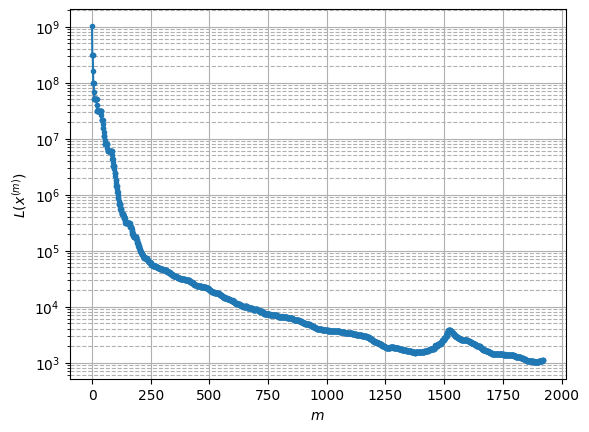

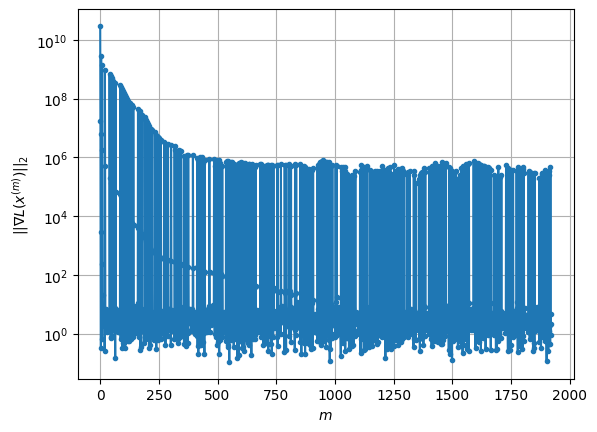

Windows:  67%|██████▋   | 197/296 [1:21:33<17:04, 10.34s/it]


Majorization-Minimization Iteration 1
Before applying the algorithm
Cost function: 1083.6774949012704
Gradient norm: 297980.5010667165
Global relative error: 41.623849881577755
Position relative errors: 0.047416008780105934 m, 29.673599037993533 m, 8.440600441844571 m, 27.94234815469513 m

Iteration 1
Cost function: 1077.7039845128418 (-0.55%)
Gradient norm: 3.5046637244892063 (-100.00%)
Global relative error = 41.55043829601594 (-0.18%)
Position relative errors: 0.03976413965660338 m, 29.631990924449084 m, 8.374958559030071 m, 27.89697004114906 m

Iteration 2
Cost function: 1077.7039856261931 (0.00%)
Gradient norm: 2.496441902997748 (-28.77%)
Global relative error = 41.55043833662483 (0.00%)
Position relative errors: 0.03976413494960228 m, 29.631990946803214 m, 8.374958590659881 m, 27.896970068399593 m

STOP on Iteration 3
Cost function = 1077.703985143249 (-0.00%)
Gradient norm = 0.9136579671044988 (-63.40%)
Global relative error = 41.550438336448025 (-0.00%)
Final position relative

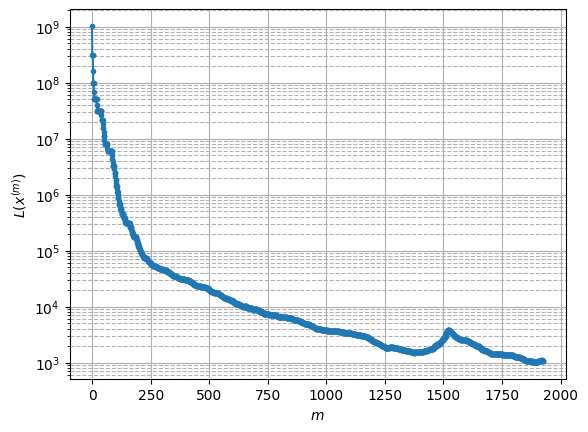

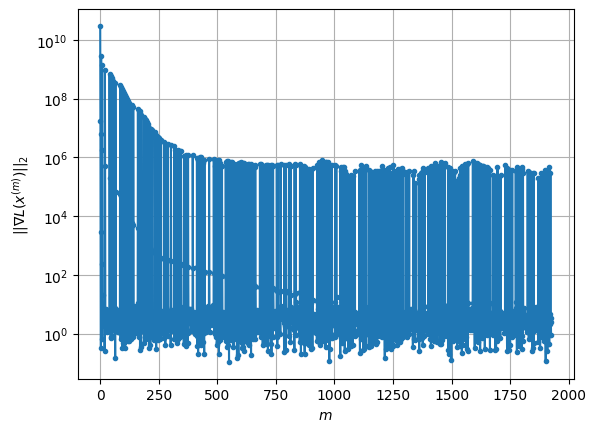

Windows:  67%|██████▋   | 198/296 [1:21:43<16:32, 10.13s/it]


Majorization-Minimization Iteration 1
Before applying the algorithm
Cost function: 1083.5666464135297
Gradient norm: 447788.59822008165
Global relative error: 39.15008785580499
Position relative errors: 0.04037772759448963 m, 28.09581250198826 m, 8.345008193134772 m, 25.955964337261136 m

Iteration 1
Cost function: 1076.2170264649158 (-0.68%)
Gradient norm: 3.575446690070765 (-100.00%)
Global relative error = 39.08264439110307 (-0.17%)
Position relative errors: 0.03774386400498556 m, 28.056325406040287 m, 8.290829388925369 m, 25.914370662634752 m

Iteration 2
Cost function: 1076.2170267542595 (0.00%)
Gradient norm: 1.2359304772161384 (-65.43%)
Global relative error = 39.08264443671485 (0.00%)
Position relative errors: 0.037743862048140855 m, 28.056325431331068 m, 8.29082942396809 m, 25.914370692834282 m

Iteration 3
Cost function: 1076.2170264701113 (-0.00%)
Gradient norm: 2.2091296487754764 (78.74%)
Global relative error = 39.082644436445996 (-0.00%)
Position relative errors: 0.03774

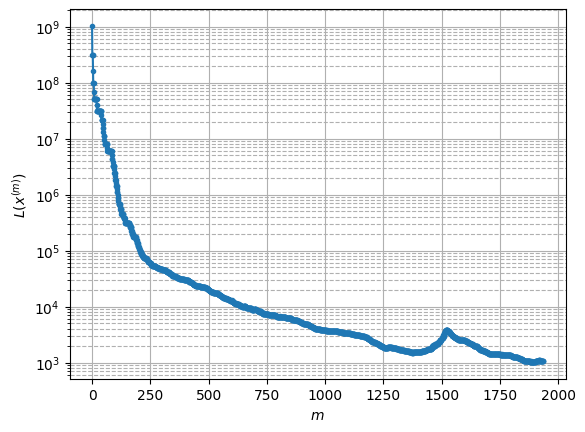

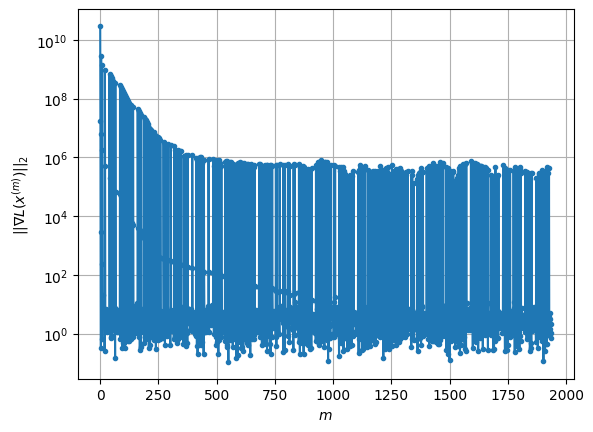

Windows:  67%|██████▋   | 199/296 [1:22:06<22:47, 14.10s/it]


Majorization-Minimization Iteration 1
Before applying the algorithm
Cost function: 1084.9055149519759
Gradient norm: 326086.49389589357
Global relative error: 36.52755507638821
Position relative errors: 0.03831146148302959 m, 26.400398200125576 m, 8.228255310930871 m, 23.86574015220693 m

Iteration 1
Cost function: 1077.8988814507104 (-0.65%)
Gradient norm: 3.3706537102099414 (-100.00%)
Global relative error = 36.46490851150132 (-0.17%)
Position relative errors: 0.04182751619715214 m, 26.364749708741325 m, 8.182289253998503 m, 23.825110261255915 m

Iteration 2
Cost function: 1077.898883515685 (0.00%)
Gradient norm: 3.3021731564928136 (-2.03%)
Global relative error = 36.46490855792804 (0.00%)
Position relative errors: 0.04182751513777509 m, 26.364749731682927 m, 8.182289284086634 m, 23.825110296594644 m

STOP on Iteration 3
Cost function = 1077.898882177256 (-0.00%)
Gradient norm = 0.4029076276724692 (-87.80%)
Global relative error = 36.46490855812633 (0.00%)
Final position relative er

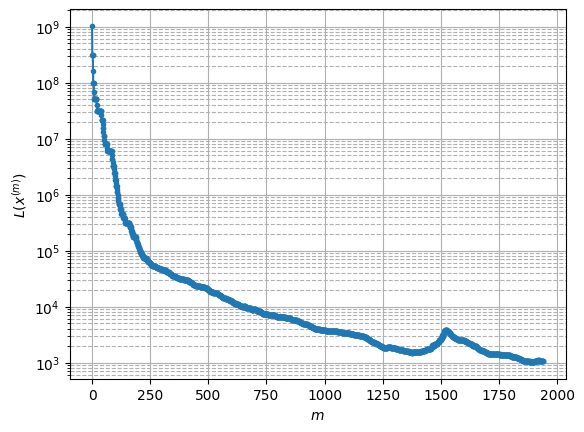

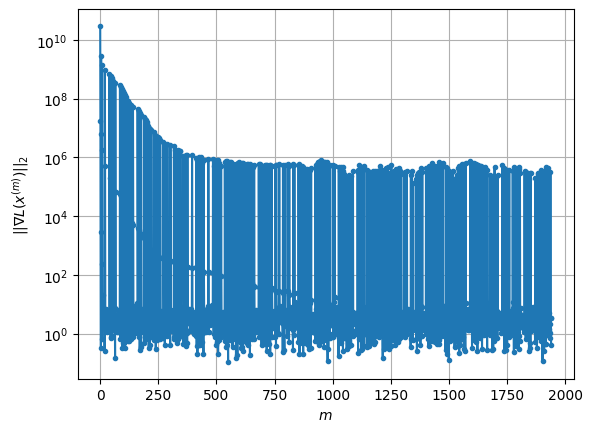

Windows:  68%|██████▊   | 200/296 [1:22:16<20:36, 12.88s/it]


Majorization-Minimization Iteration 1
Before applying the algorithm
Cost function: 1061.3903130762926
Gradient norm: 279925.60797868867
Global relative error: 33.76913023084425
Position relative errors: 0.04217759598830917 m, 24.59674942269107 m, 8.087949575166189 m, 21.677986477312995 m

Iteration 1
Cost function: 1055.6077458858524 (-0.54%)
Gradient norm: 1.5010717266216527 (-100.00%)
Global relative error = 33.71478091129244 (-0.16%)
Position relative errors: 0.05070154031646993 m, 24.564692664650394 m, 8.050388949652929 m, 21.643676524038728 m

STOP on Iteration 2
Cost function = 1055.6077465202163 (0.00%)
Gradient norm = 0.9018129401068318 (-39.92%)
Global relative error = 33.71478095261905 (0.00%)
Final position relative errors: 0.050701537792087824 m, 24.564692690369558 m, 8.050388976725653 m, 21.643676549159913 m

Majorization-Minimization converged after 1 iterations


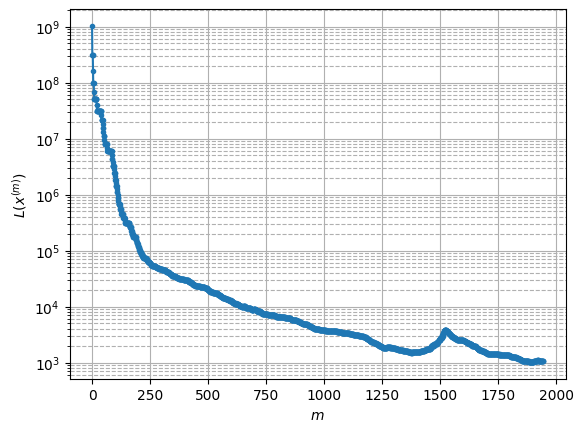

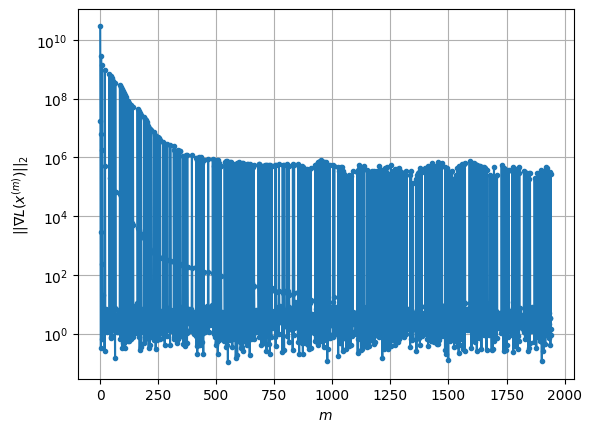

Windows:  68%|██████▊   | 201/296 [1:22:24<17:48, 11.24s/it]


Majorization-Minimization Iteration 1
Before applying the algorithm
Cost function: 1039.3077662214762
Gradient norm: 233173.47457849223
Global relative error: 30.894095380429224
Position relative errors: 0.050484321098103385 m, 22.69273682424467 m, 7.92529843435916 m, 19.40797361868987 m

Iteration 1
Cost function: 1033.2246253815356 (-0.59%)
Gradient norm: 1.6929161722298358 (-100.00%)
Global relative error = 30.85093249308605 (-0.14%)
Position relative errors: 0.05424319872144096 m, 22.66152454892626 m, 7.901413074475802 m, 19.385499708074146 m

Iteration 2
Cost function: 1033.2246251275217 (-0.00%)
Gradient norm: 1.037807254769174 (-38.70%)
Global relative error = 30.850932538907017 (0.00%)
Position relative errors: 0.054243199403561725 m, 22.66152457701896 m, 7.901413117487563 m, 19.385499730622136 m

Iteration 3
Cost function: 1033.224625151386 (0.00%)
Gradient norm: 4.3417199163215034 (318.36%)
Global relative error = 30.85093253898574 (0.00%)
Position relative errors: 0.0542432

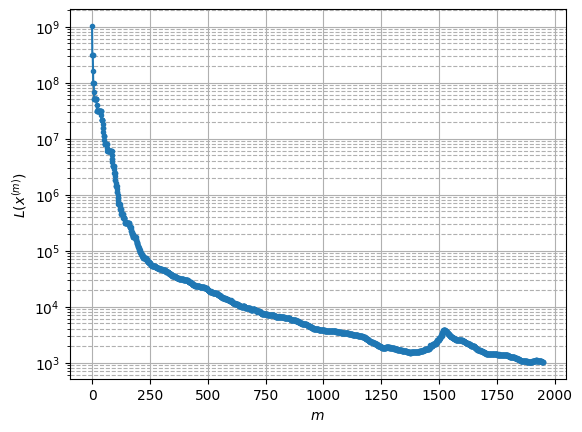

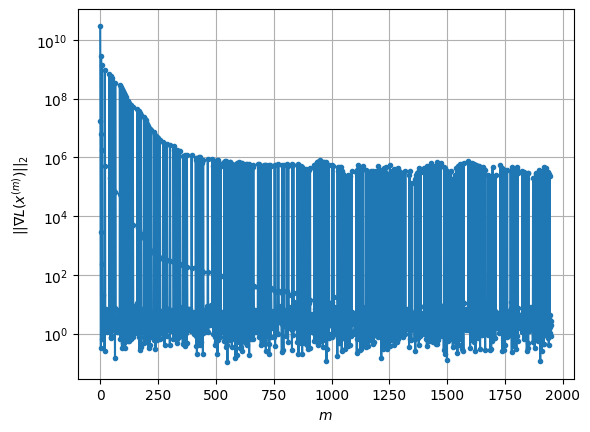

Windows:  68%|██████▊   | 202/296 [1:22:40<20:02, 12.79s/it]


Majorization-Minimization Iteration 1
Before applying the algorithm
Cost function: 1020.6336598027906
Gradient norm: 241610.2089225571
Global relative error: 27.92326271986949
Position relative errors: 0.054002950946711155 m, 20.69409298931702 m, 7.746549629049532 m, 17.071862501045082 m

Iteration 1
Cost function: 1014.6596511360217 (-0.59%)
Gradient norm: 1.2176954100860176 (-100.00%)
Global relative error = 27.8900258700516 (-0.12%)
Position relative errors: 0.05280267068252385 m, 20.66623642771911 m, 7.7290104224729745 m, 17.059224934762078 m

Iteration 2
Cost function: 1014.6596499151625 (-0.00%)
Gradient norm: 4.773891835737527 (292.04%)
Global relative error = 27.890025919157498 (0.00%)
Position relative errors: 0.05280267631736874 m, 20.666236457025068 m, 7.729010465628921 m, 17.059224959972422 m

Iteration 3
Cost function: 1014.6596503061704 (0.00%)
Gradient norm: 3.6370442874459186 (-23.81%)
Global relative error = 27.890025918711114 (-0.00%)
Position relative errors: 0.0528

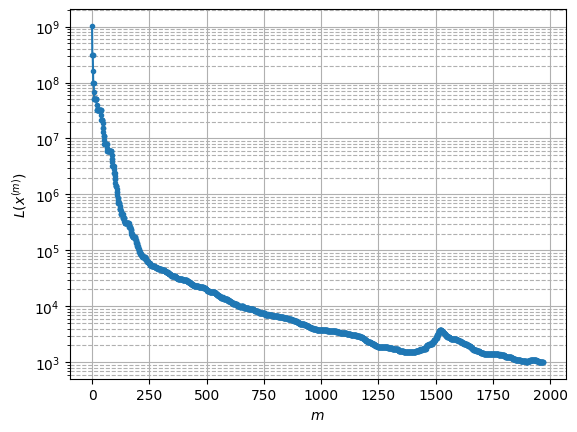

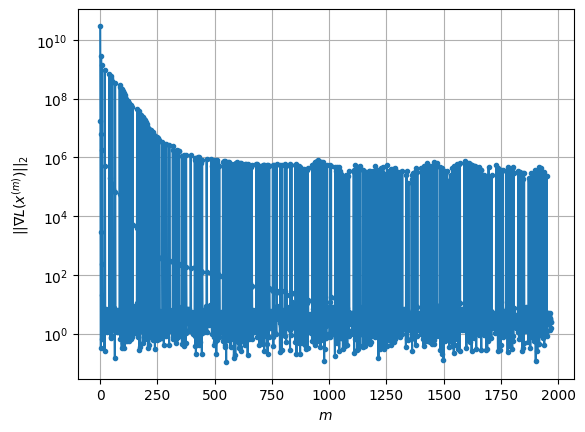

Windows:  69%|██████▊   | 203/296 [1:23:28<36:05, 23.29s/it]


Majorization-Minimization Iteration 1
Before applying the algorithm
Cost function: 1017.019836928613
Gradient norm: 253032.27034571546
Global relative error: 24.876381013277395
Position relative errors: 0.0523447471806177 m, 18.61220121393185 m, 7.54575503898102 m, 14.679110235656276 m

STOP on Iteration 1
Cost function = 1011.252281549345 (-0.57%)
Gradient norm = 0.489049996285659 (-100.00%)
Global relative error = 24.850131182789575 (-0.11%)
Final position relative errors: 0.0535521809728251 m, 18.585659821353854 m, 7.5302042190696294 m, 14.676258860480337 m

Majorization-Minimization converged after 1 iterations


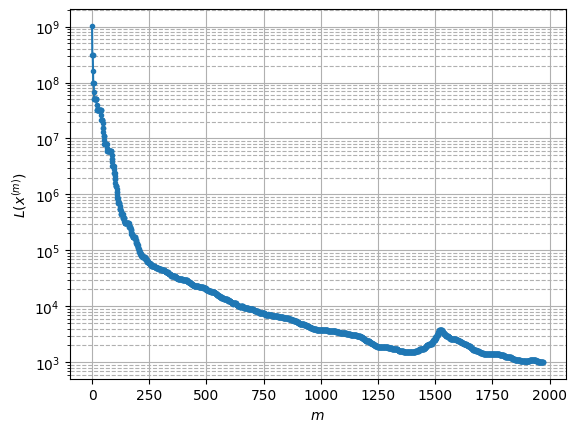

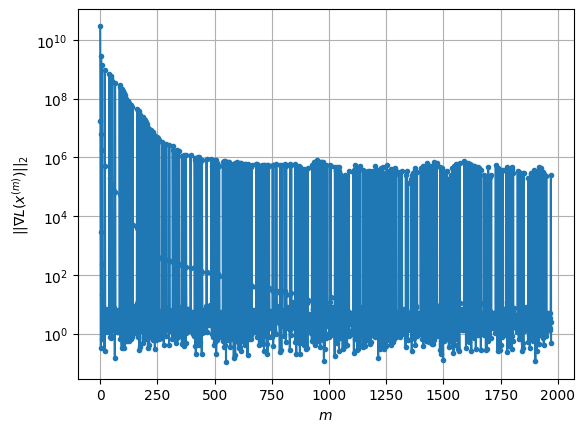

Windows:  69%|██████▉   | 204/296 [1:23:33<27:31, 17.96s/it]


Majorization-Minimization Iteration 1
Before applying the algorithm
Cost function: 991.8376098855946
Gradient norm: 222292.93385653212
Global relative error: 21.776419779505105
Position relative errors: 0.05285487679811174 m, 16.4542951762336 m, 7.320036580948597 m, 12.24254364377239 m

Iteration 1
Cost function: 986.2101769989721 (-0.57%)
Gradient norm: 1.2907206454208004 (-100.00%)
Global relative error = 21.766421060981706 (-0.05%)
Position relative errors: 0.05900750361454104 m, 16.432118303035722 m, 7.308320569641509 m, 12.26150596454703 m

Iteration 2
Cost function: 986.2101770450558 (0.00%)
Gradient norm: 4.65198676272113 (260.42%)
Global relative error = 21.766421105862655 (0.00%)
Position relative errors: 0.05900751496464429 m, 16.432118330192885 m, 7.308320583767605 m, 12.261505999350126 m

Iteration 3
Cost function: 986.2101759413084 (-0.00%)
Gradient norm: 3.619963019455741 (-22.18%)
Global relative error = 21.76642110646962 (0.00%)
Position relative errors: 0.059007507223

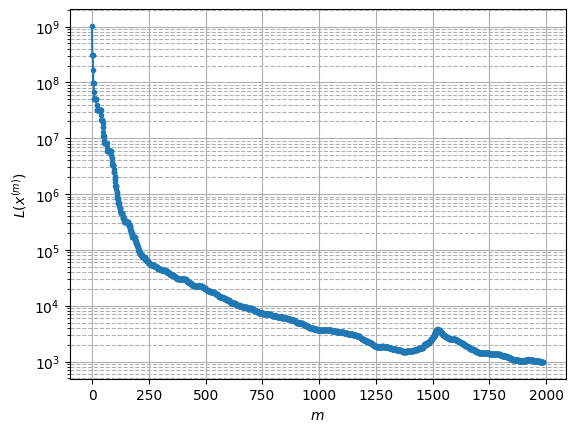

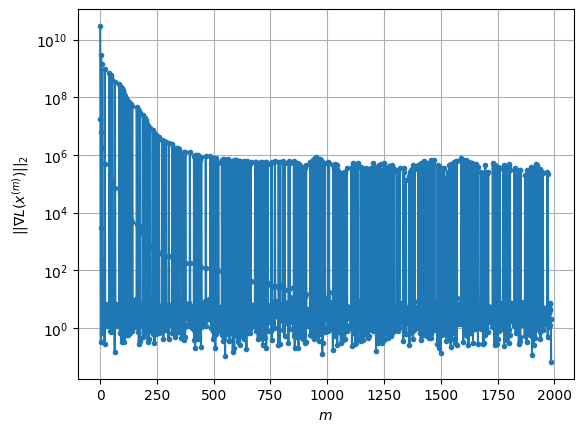

Windows:  69%|██████▉   | 205/296 [1:24:09<35:08, 23.17s/it]


Majorization-Minimization Iteration 1
Before applying the algorithm
Cost function: 973.9550290323832
Gradient norm: 374868.35181401885
Global relative error: 18.66786787737151
Position relative errors: 0.05797012157591922 m, 14.23305466782793 m, 7.072621754847307 m, 9.791881414694595 m

Iteration 1
Cost function: 968.5592935303832 (-0.55%)
Gradient norm: 1.5710184042056814 (-100.00%)
Global relative error = 18.672891259900588 (0.03%)
Position relative errors: 0.06185259388839566 m, 14.216863477317352 m, 7.071600779158998 m, 9.825637031764593 m

Iteration 2
Cost function: 968.5592915787832 (-0.00%)
Gradient norm: 3.094629614596542 (96.98%)
Global relative error = 18.67289131163752 (0.00%)
Position relative errors: 0.0618525993935998 m, 14.216863507209023 m, 7.071600808404033 m, 9.82563706575336 m

Iteration 3
Cost function: 968.5592934800026 (0.00%)
Gradient norm: 4.4651497800212345 (44.29%)
Global relative error = 18.67289131165298 (0.00%)
Position relative errors: 0.06185259370488388

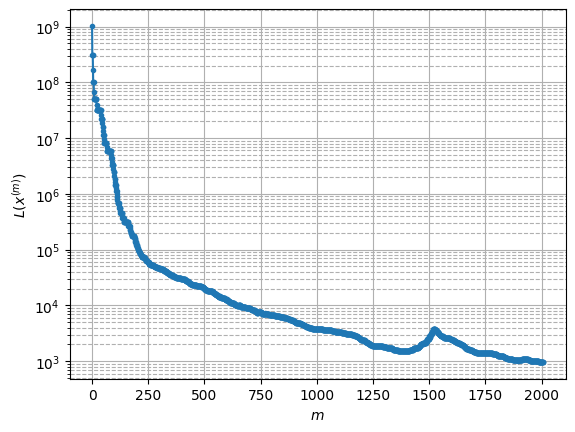

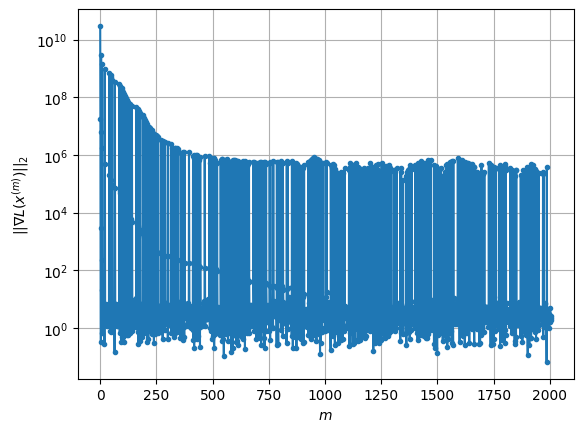

Windows:  70%|██████▉   | 206/296 [1:24:55<45:15, 30.18s/it]


Majorization-Minimization Iteration 1
Before applying the algorithm
Cost function: 946.1863419991181
Gradient norm: 142829.29314704475
Global relative error: 15.602425079194242
Position relative errors: 0.06017280568217425 m, 11.96036176234832 m, 6.811856731830435 m, 7.346912320565183 m

Iteration 1
Cost function: 940.5789760837387 (-0.59%)
Gradient norm: 3.458610226498061 (-100.00%)
Global relative error = 15.630520987614753 (0.18%)
Position relative errors: 0.07803363858968067 m, 11.949854613847565 m, 6.821728676073025 m, 7.414095958320562 m

STOP on Iteration 2
Cost function = 940.5789765842612 (0.00%)
Gradient norm = 0.9392748799604981 (-72.84%)
Global relative error = 15.630521047154888 (0.00%)
Final position relative errors: 0.07803365549751083 m, 11.949854645802738 m, 6.821728700242871 m, 7.414096009922717 m

Majorization-Minimization converged after 1 iterations


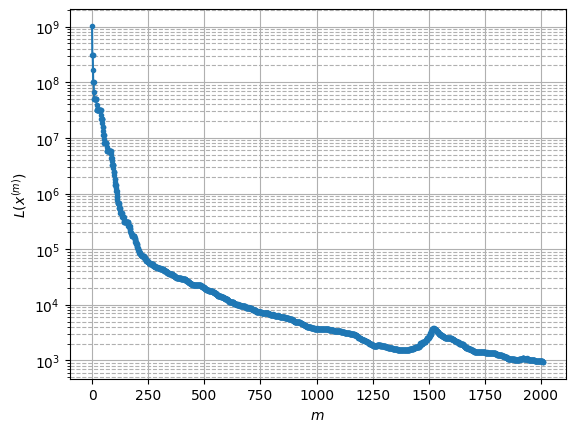

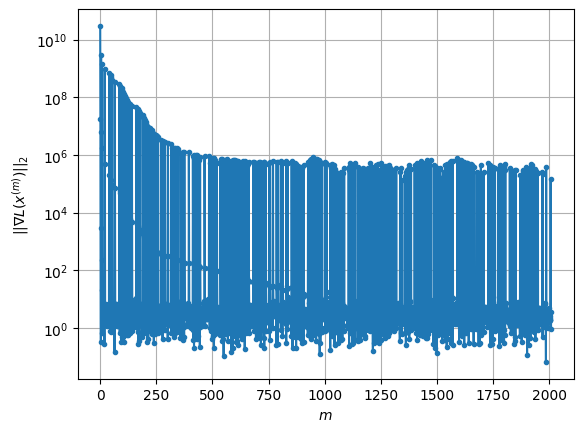

Windows:  70%|██████▉   | 207/296 [1:25:03<34:45, 23.44s/it]


Majorization-Minimization Iteration 1
Before applying the algorithm
Cost function: 941.0944248390895
Gradient norm: 474020.4035777946
Global relative error: 12.679021543843305
Position relative errors: 0.07576735674350718 m, 9.64684186897395 m, 6.539479905098037 m, 4.99220592175154 m

Iteration 1
Cost function: 935.8744304474835 (-0.55%)
Gradient norm: 3.5264561868657966 (-100.00%)
Global relative error = 12.722601748337798 (0.34%)
Position relative errors: 0.07146434691237016 m, 9.64068144532942 m, 6.555169978000161 m, 5.09344043291077 m

Iteration 2
Cost function: 935.8744315054755 (0.00%)
Gradient norm: 3.8017820238312328 (7.81%)
Global relative error = 12.722601810099004 (0.00%)
Position relative errors: 0.07146434698791375 m, 9.64068147069596 m, 6.555170019966898 m, 5.093440485155864 m

Iteration 3
Cost function: 935.8744302272656 (-0.00%)
Gradient norm: 2.315724966810985 (-39.09%)
Global relative error = 12.72260180875854 (-0.00%)
Position relative errors: 0.07146434996499292 m,

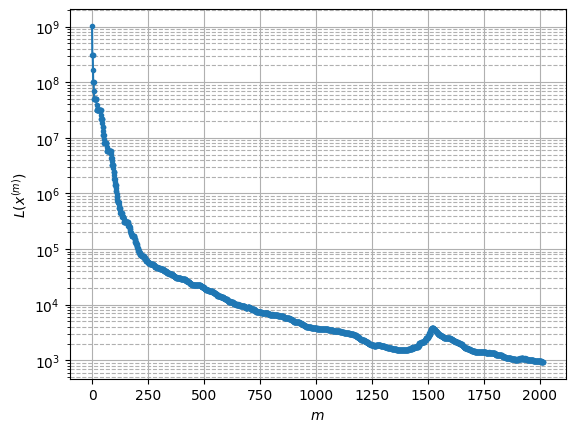

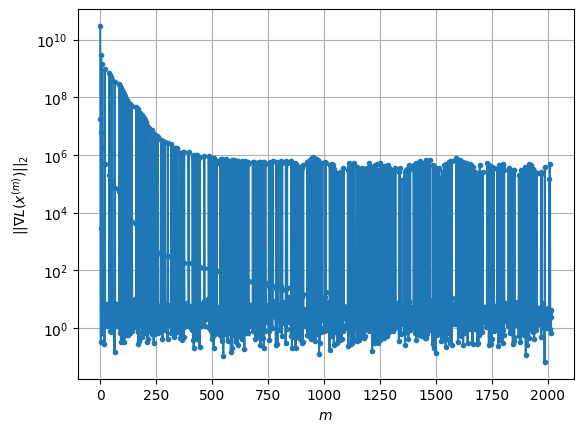

Windows:  70%|███████   | 208/296 [1:25:18<30:43, 20.95s/it]


Majorization-Minimization Iteration 1
Before applying the algorithm
Cost function: 924.7525252090179
Gradient norm: 305740.32218271965
Global relative error: 10.063336496985002
Position relative errors: 0.06962457627322613 m, 7.303525212550528 m, 6.2526347632488495 m, 2.9707808629564463 m

Iteration 1
Cost function: 920.3254561416577 (-0.48%)
Gradient norm: 1.1167732872664455 (-100.00%)
Global relative error = 10.129635783279722 (0.66%)
Position relative errors: 0.06376266312904227 m, 7.30612682622197 m, 6.2716590894158415 m, 3.1446519816696195 m

Iteration 2
Cost function: 920.3254553221284 (-0.00%)
Gradient norm: 2.8111071159369208 (151.72%)
Global relative error = 10.129635838470858 (0.00%)
Position relative errors: 0.06376266326626462 m, 7.3061268525447325 m, 6.271659112884948 m, 3.1446520514862706 m

Iteration 3
Cost function: 920.3254549972037 (-0.00%)
Gradient norm: 7.867104190553708 (179.86%)
Global relative error = 10.129635837980565 (-0.00%)
Position relative errors: 0.06376

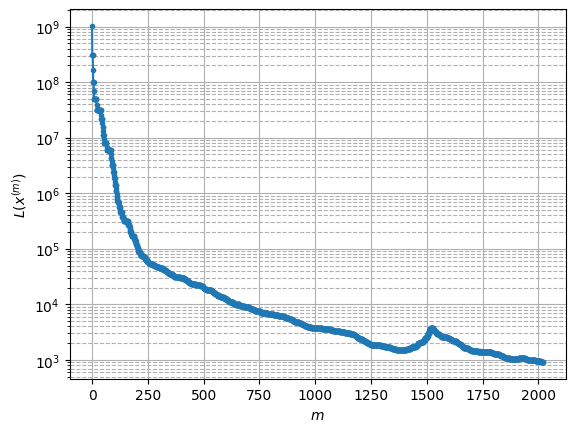

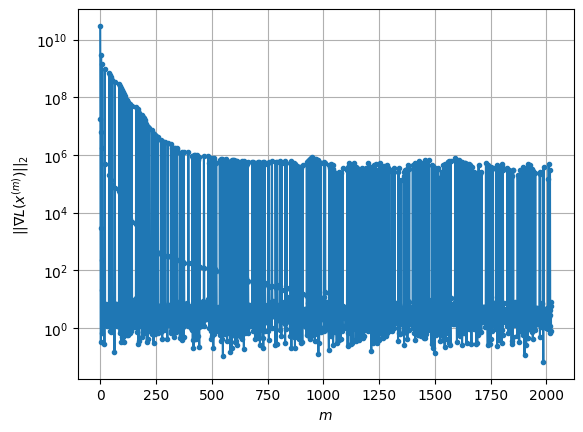

Windows:  71%|███████   | 209/296 [1:25:35<28:30, 19.66s/it]


Majorization-Minimization Iteration 1
Before applying the algorithm
Cost function: 913.7373006325479
Gradient norm: 216782.41578386043
Global relative error: 8.11402318712284
Position relative errors: 0.06217899412214162 m, 4.952883314786344 m, 5.950629196011432 m, 2.4267260277210596 m

Iteration 1
Cost function: 909.7729948118094 (-0.43%)
Gradient norm: 4.236522823180411 (-100.00%)
Global relative error = 8.19046191490342 (0.94%)
Position relative errors: 0.07229161202781959 m, 4.97630817436415 m, 5.96971727078536 m, 2.583373299964492 m

Iteration 2
Cost function: 909.772993262623 (-0.00%)
Gradient norm: 6.297780126691119 (48.65%)
Global relative error = 8.190461951222732 (0.00%)
Position relative errors: 0.07229160924130741 m, 4.976308218656026 m, 5.9697172571864545 m, 2.583373361297177 m

Iteration 3
Cost function: 909.7729936710696 (0.00%)
Gradient norm: 4.801833962912952 (-23.75%)
Global relative error = 8.19046194912846 (-0.00%)
Position relative errors: 0.07229161297624925 m, 4

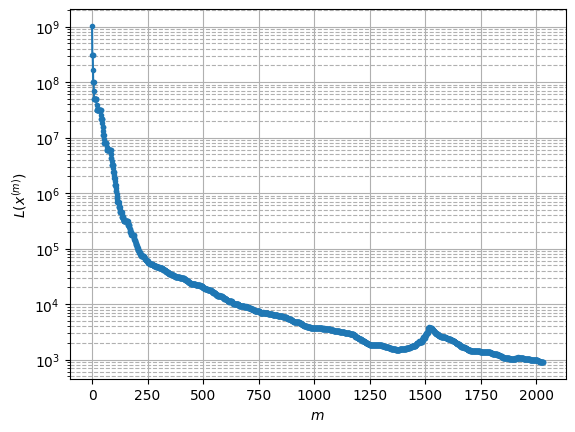

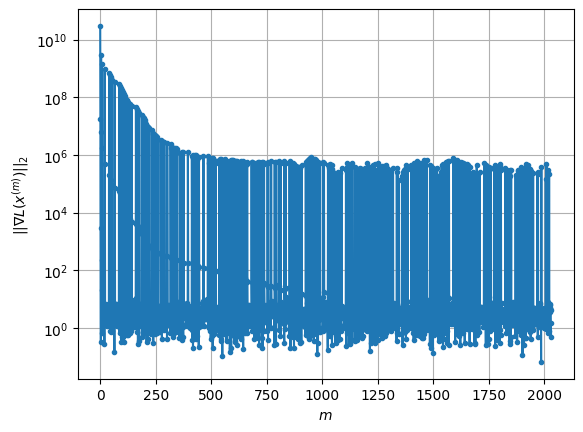

Windows:  71%|███████   | 210/296 [1:25:58<29:49, 20.81s/it]


Majorization-Minimization Iteration 1
Before applying the algorithm
Cost function: 915.3810527840327
Gradient norm: 260301.56599820039
Global relative error: 7.389087367089618
Position relative errors: 0.07020125994907465 m, 2.6607098177823096 m, 5.632608049294852 m, 3.972979280540754 m

Iteration 1
Cost function: 912.1667110202369 (-0.35%)
Gradient norm: 7.450620670686465 (-100.00%)
Global relative error = 7.442925522046306 (0.73%)
Position relative errors: 0.0705710841663373 m, 2.7077550286747067 m, 5.651168970096493 m, 4.015103154703461 m

Iteration 2
Cost function: 912.1667119247913 (0.00%)
Gradient norm: 1.6956794569679017 (-77.24%)
Global relative error = 7.44292551043856 (-0.00%)
Position relative errors: 0.07057108160315967 m, 2.707755067853952 m, 5.651168936879917 m, 4.015103153560331 m

Iteration 3
Cost function: 912.1667132663546 (0.00%)
Gradient norm: 1.1813917525109465 (-30.33%)
Global relative error = 7.44292551362494 (0.00%)
Position relative errors: 0.07057108895456271

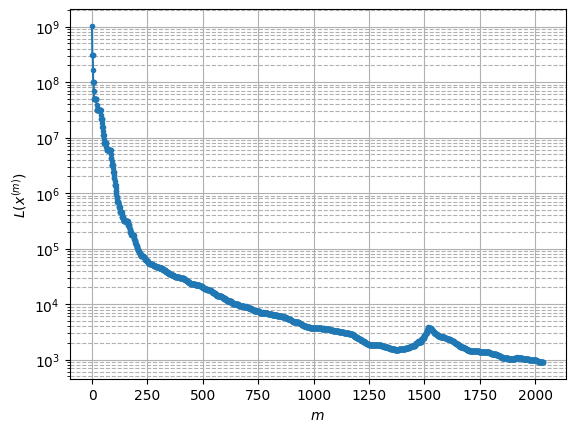

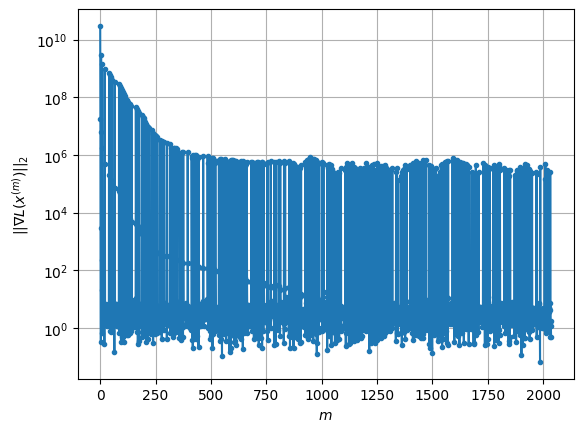

Windows:  71%|███████▏  | 211/296 [1:26:11<25:54, 18.29s/it]


Majorization-Minimization Iteration 1
Before applying the algorithm
Cost function: 914.5836339089279
Gradient norm: 154039.66728028015
Global relative error: 8.201571982343928
Position relative errors: 0.0686080859903282 m, 1.025369113675548 m, 5.300150122063076 m, 6.173707115657307 m

Iteration 1
Cost function: 911.7747340218305 (-0.31%)
Gradient norm: 2.2557002430569106 (-100.00%)
Global relative error = 8.23992910599983 (0.47%)
Position relative errors: 0.07168730700026996 m, 1.138289311062248 m, 5.332907308545375 m, 6.176751318570237 m

Iteration 2
Cost function: 911.7747334171147 (-0.00%)
Gradient norm: 2.8420930358383316 (26.00%)
Global relative error = 8.239929093668088 (-0.00%)
Position relative errors: 0.07168731055459653 m, 1.1382893658417437 m, 5.332907279419096 m, 6.1767513171302255 m

Iteration 3
Cost function: 911.7747343596313 (0.00%)
Gradient norm: 3.1321180298898477 (10.20%)
Global relative error = 8.239929094601791 (0.00%)
Position relative errors: 0.0716873126282292

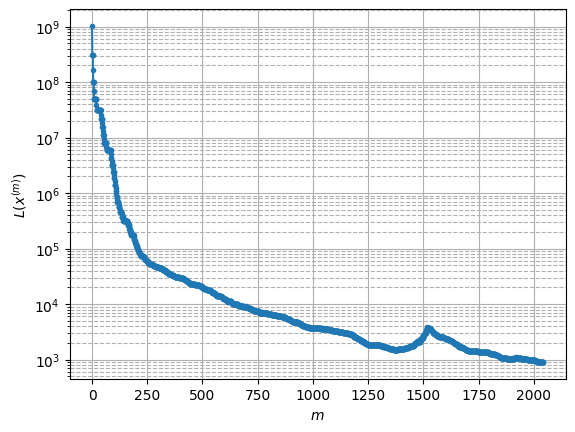

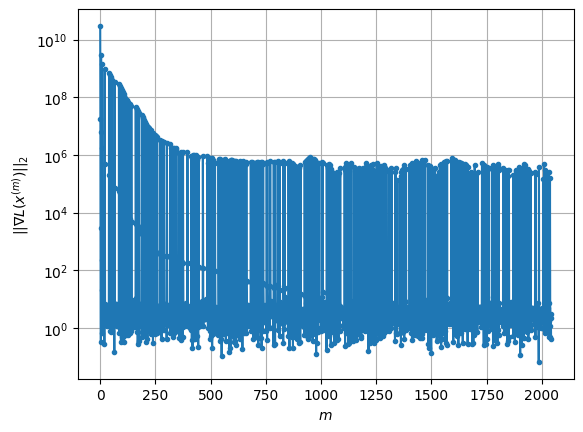

Windows:  72%|███████▏  | 212/296 [1:26:24<23:44, 16.96s/it]


Majorization-Minimization Iteration 1
Before applying the algorithm
Cost function: 922.1577144696789
Gradient norm: 235703.64510580568
Global relative error: 10.185307744948739
Position relative errors: 0.06957347009785421 m, 2.5417949537202174 m, 4.9704211724846745 m, 8.518594765691912 m

Iteration 1
Cost function: 918.9730842599312 (-0.35%)
Gradient norm: 4.219396368636487 (-100.00%)
Global relative error = 10.192675850569373 (0.07%)
Position relative errors: 0.07589455842237441 m, 2.5784483705571817 m, 4.994905379052393 m, 8.502001361979106 m

Iteration 2
Cost function: 918.9730839495626 (-0.00%)
Gradient norm: 4.492514195566903 (6.47%)
Global relative error = 10.192675808617436 (-0.00%)
Position relative errors: 0.0758945582315216 m, 2.5784483747711597 m, 4.9949052949330275 m, 8.502001359828487 m

STOP on Iteration 3
Cost function = 918.9730840771256 (0.00%)
Gradient norm = 0.18131261031886123 (-95.96%)
Global relative error = 10.192675807077402 (-0.00%)
Final position relative er

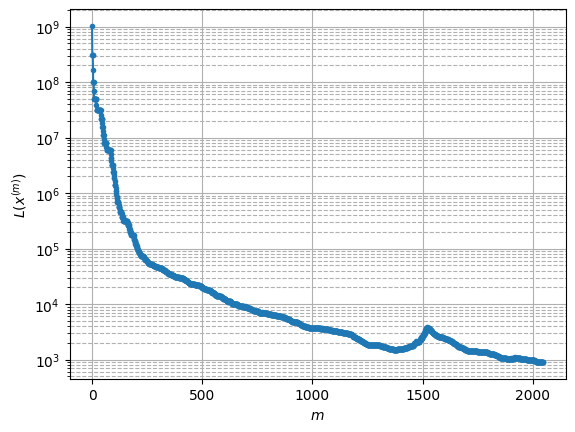

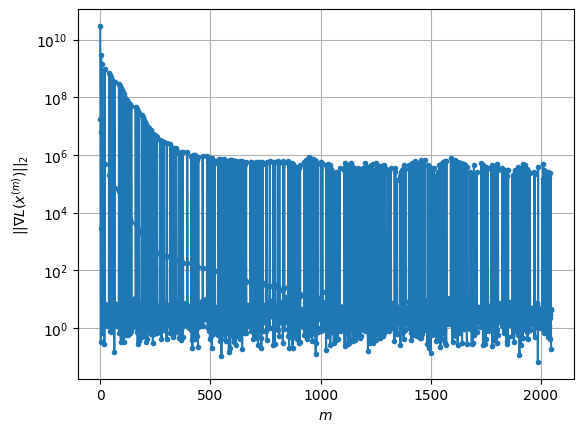

Windows:  72%|███████▏  | 213/296 [1:26:34<20:29, 14.81s/it]


Majorization-Minimization Iteration 1
Before applying the algorithm
Cost function: 927.3452462934177
Gradient norm: 299545.4360508598
Global relative error: 12.764519532501827
Position relative errors: 0.07348546576650339 m, 4.8061320597294355 m, 4.624024011111267 m, 10.883186558985017 m

Iteration 1
Cost function: 923.7370236322699 (-0.39%)
Gradient norm: 1.9298585927514433 (-100.00%)
Global relative error = 12.75541134483261 (-0.07%)
Position relative errors: 0.07352273369602089 m, 4.823714844528079 m, 4.666563885422974 m, 10.846509753908142 m

Iteration 2
Cost function: 923.7370233048166 (-0.00%)
Gradient norm: 3.6092149501121202 (87.02%)
Global relative error = 12.755411317641052 (-0.00%)
Position relative errors: 0.07352274095611447 m, 4.823714836864815 m, 4.666563832686112 m, 10.84650974797927 m

Iteration 3
Cost function: 923.7370238834798 (0.00%)
Gradient norm: 6.956091460975453 (92.73%)
Global relative error = 12.755411316609349 (-0.00%)
Position relative errors: 0.0735227382

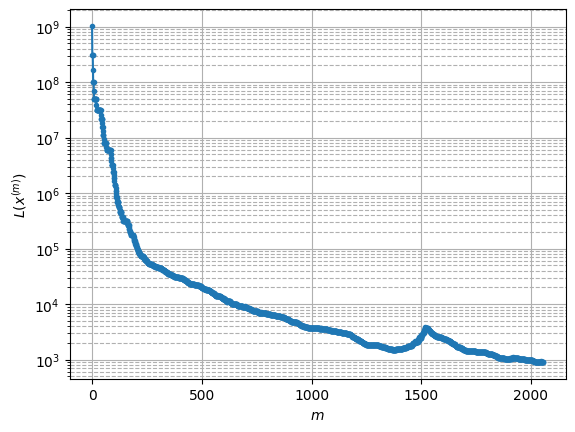

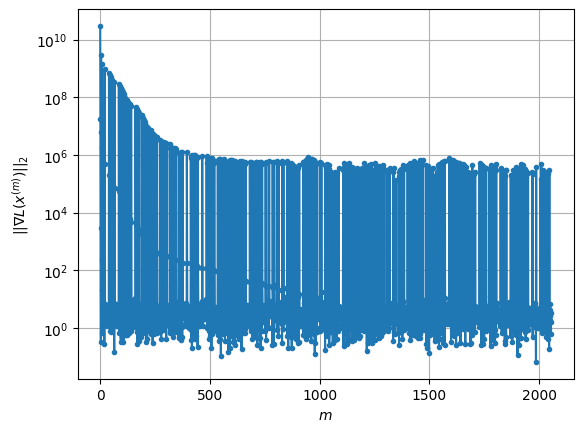

Windows:  72%|███████▏  | 214/296 [1:26:56<22:54, 16.77s/it]


Majorization-Minimization Iteration 1
Before applying the algorithm
Cost function: 930.9758658064434
Gradient norm: 248620.95418346228
Global relative error: 15.612887281428657
Position relative errors: 0.07117291094885307 m, 7.116923998069662 m, 4.291356728584995 m, 13.216945076138549 m

Iteration 1
Cost function: 927.7907259684248 (-0.34%)
Gradient norm: 6.349030451871477 (-100.00%)
Global relative error = 15.586423919607954 (-0.17%)
Position relative errors: 0.0673830058978931 m, 7.120956971629634 m, 4.3273934414829816 m, 13.171731882353479 m

STOP on Iteration 2
Cost function = 927.7907251585376 (-0.00%)
Gradient norm = 0.7385544548557571 (-88.37%)
Global relative error = 15.586423882582807 (-0.00%)
Final position relative errors: 0.06738300320920328 m, 7.120956951807621 m, 4.327393344341027 m, 13.17173188118545 m

Majorization-Minimization converged after 1 iterations


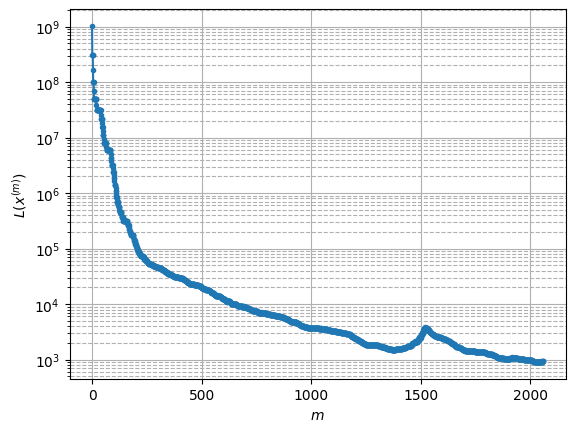

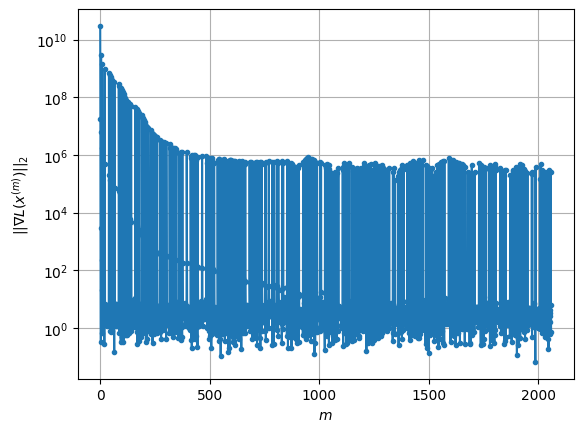

Windows:  73%|███████▎  | 215/296 [1:27:03<18:52, 13.98s/it]


Majorization-Minimization Iteration 1
Before applying the algorithm
Cost function: 937.335434653233
Gradient norm: 407581.11662865104
Global relative error: 18.560274882733463
Position relative errors: 0.06528112415786783 m, 9.40673423544947 m, 3.951465865654701 m, 15.504055828073064 m

Iteration 1
Cost function: 934.3956765007422 (-0.31%)
Gradient norm: 6.407934931896878 (-100.00%)
Global relative error = 18.5208257455767 (-0.21%)
Position relative errors: 0.061105560853461034 m, 9.395726243785097 m, 3.991565103367417 m, 15.453217610329506 m

Iteration 2
Cost function: 934.3956763352306 (-0.00%)
Gradient norm: 7.420577646447527 (15.80%)
Global relative error = 18.520825716618813 (-0.00%)
Position relative errors: 0.061105559821156515 m, 9.39572623293712 m, 3.9915650065499464 m, 15.453217607230922 m

Iteration 3
Cost function: 934.3956761984571 (-0.00%)
Gradient norm: 5.6851187332035105 (-23.39%)
Global relative error = 18.520825715761106 (-0.00%)
Position relative errors: 0.061105559

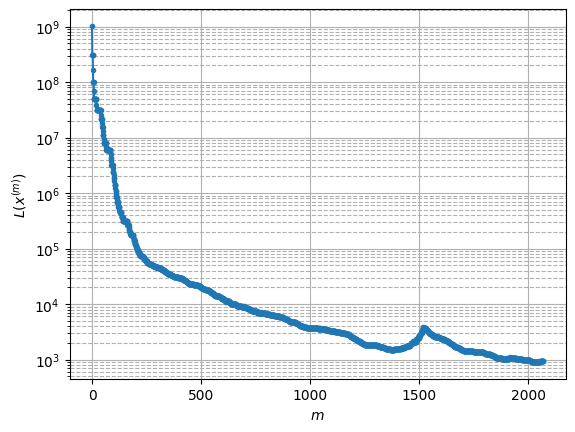

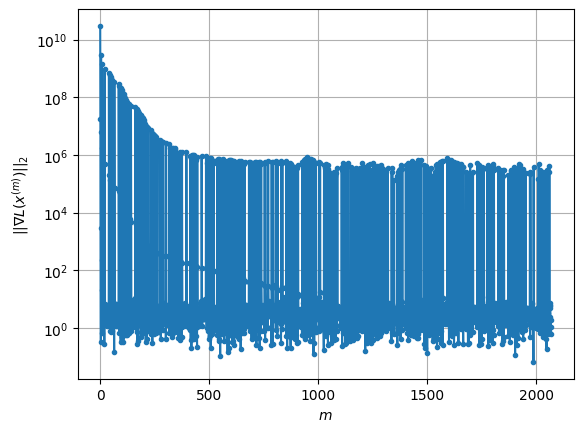

Windows:  73%|███████▎  | 216/296 [1:27:24<21:32, 16.16s/it]


Majorization-Minimization Iteration 1
Before applying the algorithm
Cost function: 958.2135792700279
Gradient norm: 292637.6602768426
Global relative error: 21.5215200181736
Position relative errors: 0.05944809364814074 m, 11.65180474505281 m, 3.6197601168145757 m, 17.728569160078667 m

Iteration 1
Cost function: 954.4052817658743 (-0.40%)
Gradient norm: 8.135671546142735 (-100.00%)
Global relative error = 21.462809847820328 (-0.27%)
Position relative errors: 0.05551091744425047 m, 11.633540811452564 m, 3.627271282414834 m, 17.66776322611142 m

Iteration 2
Cost function: 954.405282129957 (0.00%)
Gradient norm: 8.082144936750396 (-0.66%)
Global relative error = 21.462809817899704 (-0.00%)
Position relative errors: 0.055510910914762346 m, 11.633540799350477 m, 3.6272711325255886 m, 17.667763228526045 m

STOP on Iteration 3
Cost function = 954.4052802323364 (-0.00%)
Gradient norm = 0.5332400561968706 (-93.40%)
Global relative error = 21.462809818427925 (0.00%)
Final position relative err

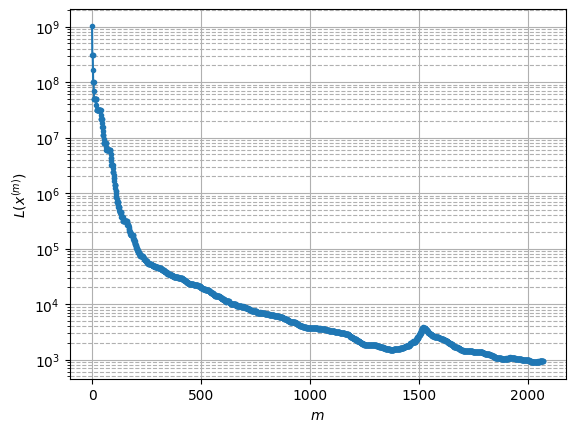

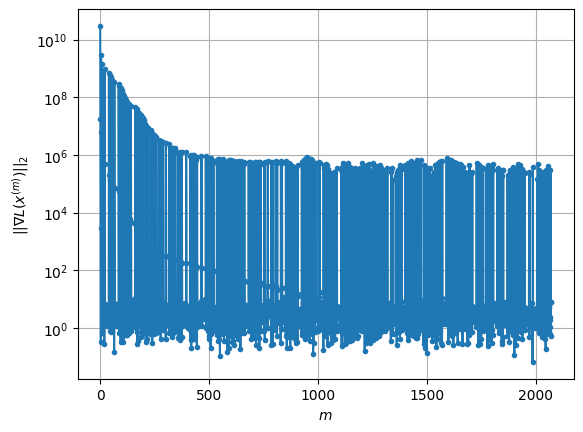

Windows:  73%|███████▎  | 217/296 [1:27:34<18:49, 14.30s/it]


Majorization-Minimization Iteration 1
Before applying the algorithm
Cost function: 965.006872599234
Gradient norm: 283088.0950756895
Global relative error: 24.438820843126745
Position relative errors: 0.053930945464456356 m, 13.844335377577842 m, 3.2644762156310856 m, 19.87279284557407 m

Iteration 1
Cost function: 961.2277421544788 (-0.39%)
Gradient norm: 2.6553604227582923 (-100.00%)
Global relative error = 24.377258381848463 (-0.25%)
Position relative errors: 0.05512696113442061 m, 13.823817830640785 m, 3.2788969070473657 m, 19.80898428610976 m

Iteration 2
Cost function: 961.2277419455962 (-0.00%)
Gradient norm: 1.944405981161469 (-26.77%)
Global relative error = 24.37725835251412 (-0.00%)
Position relative errors: 0.05512695367443878 m, 13.823817805396619 m, 3.278896769550011 m, 19.80898429040736 m

STOP on Iteration 3
Cost function = 961.2277419218354 (-0.00%)
Gradient norm = 0.9010634021701938 (-53.66%)
Global relative error = 24.37725835240878 (-0.00%)
Final position relative 

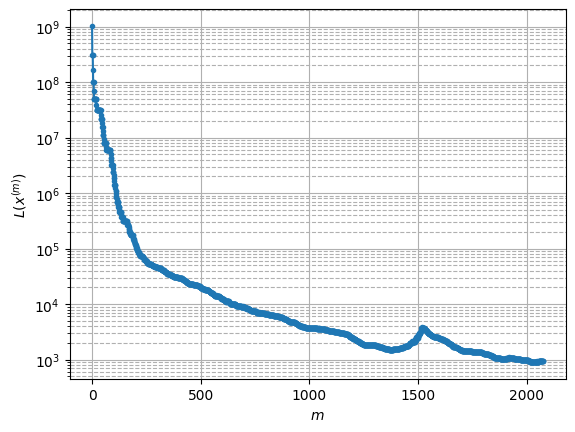

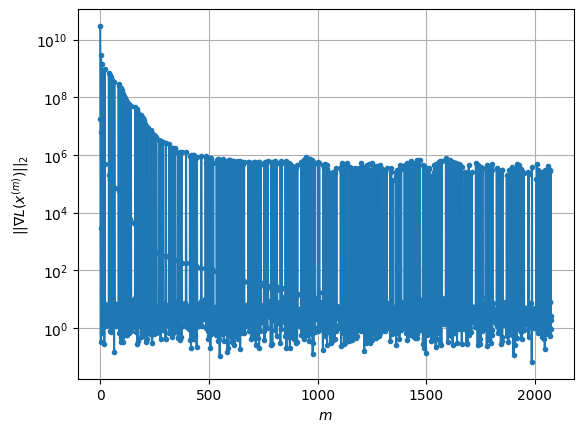

Windows:  74%|███████▎  | 218/296 [1:27:46<17:37, 13.55s/it]


Majorization-Minimization Iteration 1
Before applying the algorithm
Cost function: 973.9437231018655
Gradient norm: 270711.65122102713
Global relative error: 27.291609259236555
Position relative errors: 0.05373789436553937 m, 15.97628804060494 m, 2.932838169956647 m, 21.93132889224545 m

Iteration 1
Cost function: 970.630080300568 (-0.34%)
Gradient norm: 1.3569914352372647 (-100.00%)
Global relative error = 27.225053265404828 (-0.24%)
Position relative errors: 0.052495108580261386 m, 15.949860701326054 m, 2.9310976107366016 m, 21.867986790033026 m

Iteration 2
Cost function: 970.6300793791181 (-0.00%)
Gradient norm: 2.7997974260607226 (106.32%)
Global relative error = 27.22505324667855 (-0.00%)
Position relative errors: 0.05249512246343557 m, 15.949860683211218 m, 2.931097498024042 m, 21.867986795005958 m

Iteration 3
Cost function: 970.6300808942696 (0.00%)
Gradient norm: 2.2769606178360107 (-18.67%)
Global relative error = 27.225053246681355 (0.00%)
Position relative errors: 0.05249

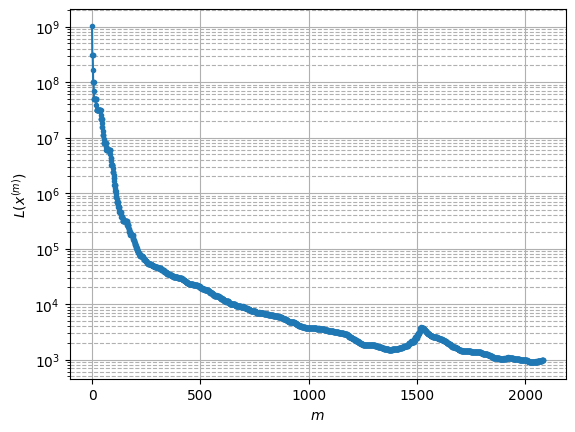

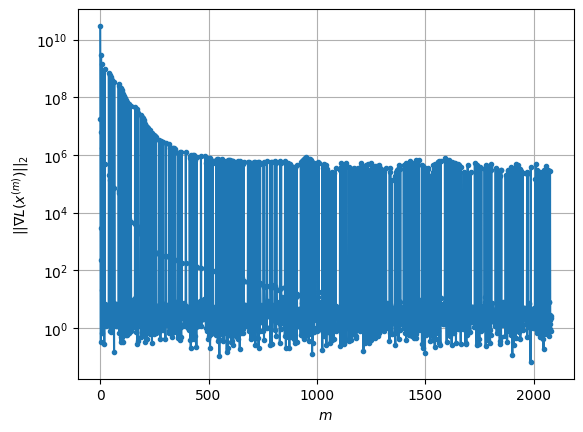

Windows:  74%|███████▍  | 219/296 [1:28:01<17:44, 13.83s/it]


Majorization-Minimization Iteration 1
Before applying the algorithm
Cost function: 982.1426889979188
Gradient norm: 285527.00456736254
Global relative error: 30.051291705808595
Position relative errors: 0.050899668713479916 m, 18.034084976467614 m, 2.6103504228223446 m, 23.89629792389538 m

Iteration 1
Cost function: 978.5309066267233 (-0.37%)
Gradient norm: 3.432336075765898 (-100.00%)
Global relative error = 29.98116062687873 (-0.23%)
Position relative errors: 0.052807823136371584 m, 18.005588075471508 m, 2.5982246386400183 m, 23.830923200735516 m

Iteration 2
Cost function: 978.5309060810386 (-0.00%)
Gradient norm: 4.510648754601075 (31.42%)
Global relative error = 29.98116060835734 (-0.00%)
Position relative errors: 0.052807829809624805 m, 18.005588048247947 m, 2.5982245622120703 m, 23.830923206321046 m

Iteration 3
Cost function: 978.5309063396508 (0.00%)
Gradient norm: 7.040386233700228 (56.08%)
Global relative error = 29.981160608617458 (0.00%)
Position relative errors: 0.05280

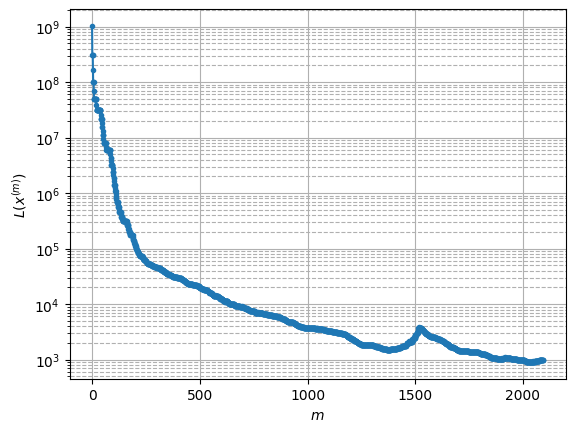

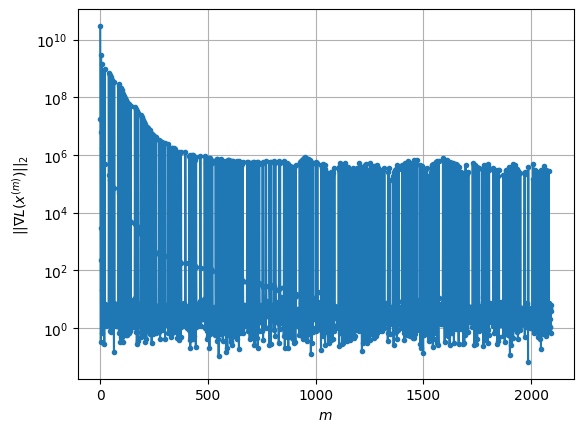

Windows:  74%|███████▍  | 220/296 [1:28:29<22:54, 18.09s/it]


Majorization-Minimization Iteration 1
Before applying the algorithm
Cost function: 977.9291909439353
Gradient norm: 292863.77815118583
Global relative error: 32.69828283140328
Position relative errors: 0.051207460993318826 m, 20.01159932306264 m, 2.3156146851345834 m, 25.755519314694904 m

Iteration 1
Cost function: 973.958969424924 (-0.41%)
Gradient norm: 3.090625023700261 (-100.00%)
Global relative error = 32.62705505193051 (-0.22%)
Position relative errors: 0.046972833695890934 m, 19.982921096552495 m, 2.291121589844283 m, 25.68957033733715 m

STOP on Iteration 2
Cost function = 973.9589697256426 (0.00%)
Gradient norm = 0.7378934168885515 (-76.12%)
Global relative error = 32.62705502878952 (-0.00%)
Final position relative errors: 0.046972844495704776 m, 19.98292105666386 m, 2.291121539007336 m, 25.689570343488903 m

Majorization-Minimization converged after 1 iterations


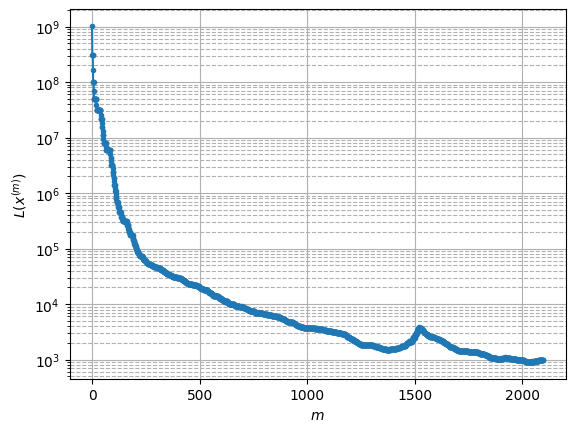

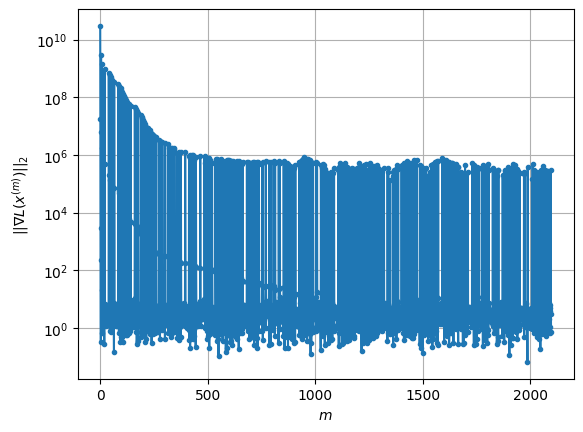

Windows:  75%|███████▍  | 221/296 [1:28:36<18:45, 15.00s/it]


Majorization-Minimization Iteration 1
Before applying the algorithm
Cost function: 975.836368452954
Gradient norm: 237396.80954614494
Global relative error: 35.21721663795161
Position relative errors: 0.04569168642530471 m, 21.9011610111608 m, 2.064077127849666 m, 27.501401555175896 m

Iteration 1
Cost function: 971.77281909377 (-0.42%)
Gradient norm: 2.727721930099203 (-100.00%)
Global relative error = 35.14127131507432 (-0.22%)
Position relative errors: 0.034735646130259916 m, 21.867074299549774 m, 1.9948053279676743 m, 27.436429401450823 m

Iteration 2
Cost function: 971.7728206354088 (0.00%)
Gradient norm: 2.576750431128953 (-5.53%)
Global relative error = 35.141271313990735 (-0.00%)
Position relative errors: 0.03473564075803629 m, 21.867074271641066 m, 1.9948054307524135 m, 27.436429414840102 m

Iteration 3
Cost function: 971.7728202417912 (-0.00%)
Gradient norm: 1.4880857885867322 (-42.25%)
Global relative error = 35.14127131353845 (-0.00%)
Position relative errors: 0.0347356341

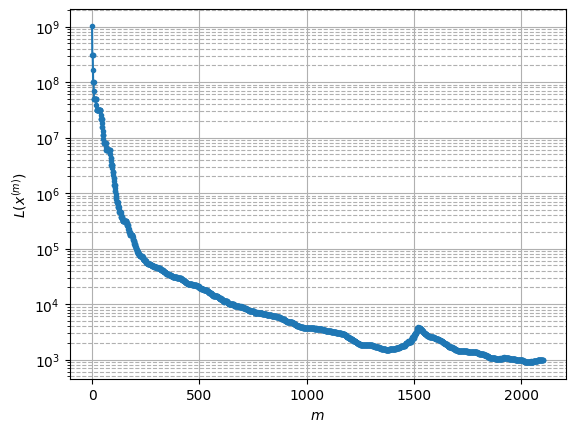

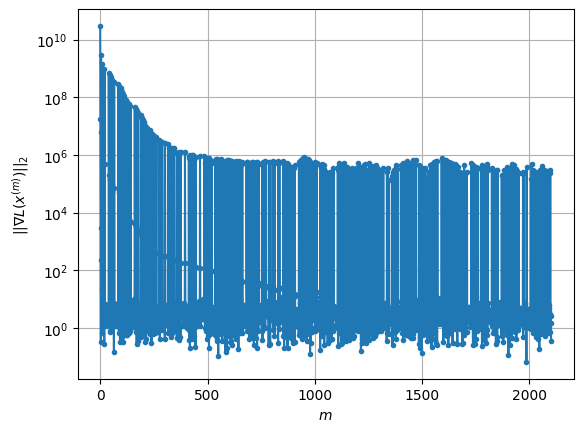

Windows:  75%|███████▌  | 222/296 [1:28:48<17:25, 14.13s/it]


Majorization-Minimization Iteration 1
Before applying the algorithm
Cost function: 972.3731255104537
Gradient norm: 337890.4300431013
Global relative error: 37.590002051232055
Position relative errors: 0.0341484671524037 m, 23.68971444714532 m, 1.8423198032866488 m, 29.12745599336376 m

Iteration 1
Cost function: 968.2473284952141 (-0.42%)
Gradient norm: 1.409740270692632 (-100.00%)
Global relative error = 37.51272179123781 (-0.21%)
Position relative errors: 0.03642446418892211 m, 23.651744973633214 m, 1.7671375420281707 m, 29.06326680235533 m

Iteration 2
Cost function: 968.2473307353005 (0.00%)
Gradient norm: 2.257351984451563 (60.13%)
Global relative error = 37.51272179264564 (0.00%)
Position relative errors: 0.03642445566573605 m, 23.651744947990572 m, 1.7671377385020404 m, 29.06326681310492 m

Iteration 3
Cost function: 968.2473293463947 (-0.00%)
Gradient norm: 1.31281032978132 (-41.84%)
Global relative error = 37.51272179194511 (-0.00%)
Position relative errors: 0.03642445439556

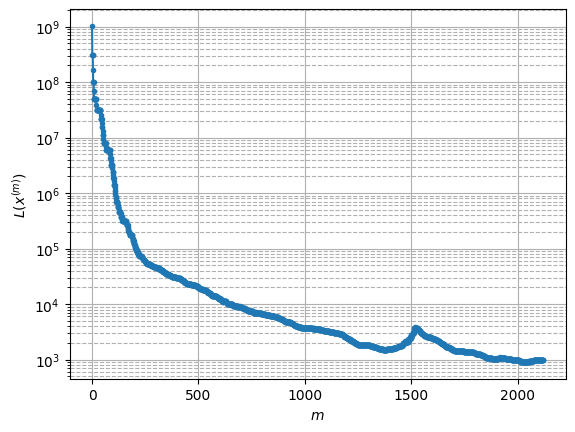

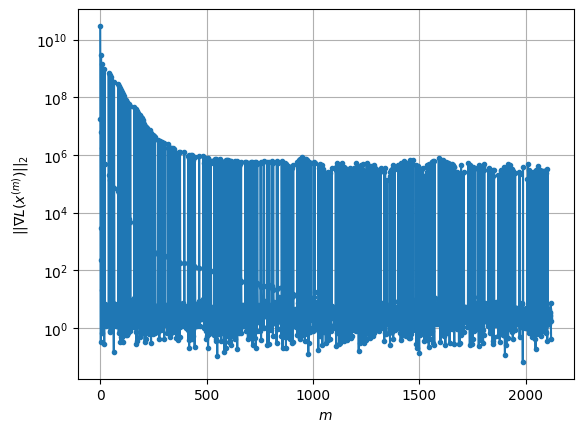

Windows:  75%|███████▌  | 223/296 [1:29:31<27:28, 22.58s/it]


Majorization-Minimization Iteration 1
Before applying the algorithm
Cost function: 954.6949548307134
Gradient norm: 242994.24643851595
Global relative error: 39.80697193008277
Position relative errors: 0.035814565432391934 m, 25.37127961393678 m, 1.7154294889155948 m, 30.625932503382934 m

Iteration 1
Cost function: 950.4785685009301 (-0.44%)
Gradient norm: 1.6159773952414502 (-100.00%)
Global relative error = 39.73046113116068 (-0.19%)
Position relative errors: 0.0381990208653853 m, 25.33281008359571 m, 1.5987097053399573 m, 30.564677094695085 m

STOP on Iteration 2
Cost function = 950.4785687319646 (0.00%)
Gradient norm = 0.634299781743631 (-60.75%)
Global relative error = 39.7304611466591 (0.00%)
Final position relative errors: 0.038199007721291374 m, 25.33281006120076 m, 1.598710142534463 m, 30.56467711055132 m

Majorization-Minimization converged after 1 iterations


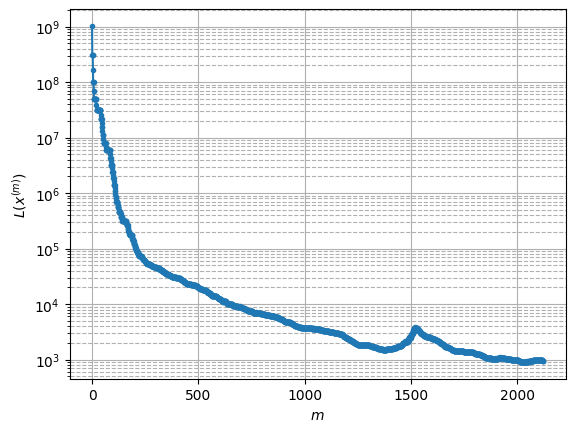

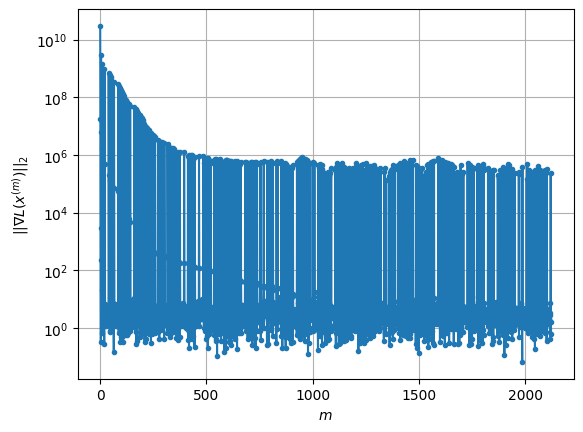

Windows:  76%|███████▌  | 224/296 [1:29:38<21:38, 18.03s/it]


Majorization-Minimization Iteration 1
Before applying the algorithm
Cost function: 945.1436865824697
Gradient norm: 199529.8493399066
Global relative error: 41.85843353247462
Position relative errors: 0.03737950172630194 m, 26.941665278349234 m, 1.6652952292485848 m, 31.992175249583244 m

Iteration 1
Cost function: 941.4538564323938 (-0.39%)
Gradient norm: 5.596666982032189 (-100.00%)
Global relative error = 41.782792664382384 (-0.18%)
Position relative errors: 0.035131761625459904 m, 26.901111520784813 m, 1.5488311722550099 m, 31.933221049891113 m

Iteration 2
Cost function: 941.4538577872935 (0.00%)
Gradient norm: 4.256163895338448 (-23.95%)
Global relative error = 41.78279267215153 (0.00%)
Position relative errors: 0.03513176113039606 m, 26.901111496982892 m, 1.5488315429260682 m, 31.933221062129906 m

STOP on Iteration 3
Cost function = 941.453856147783 (-0.00%)
Gradient norm = 0.9538379765393138 (-77.59%)
Global relative error = 41.782792672149924 (-0.00%)
Final position relative

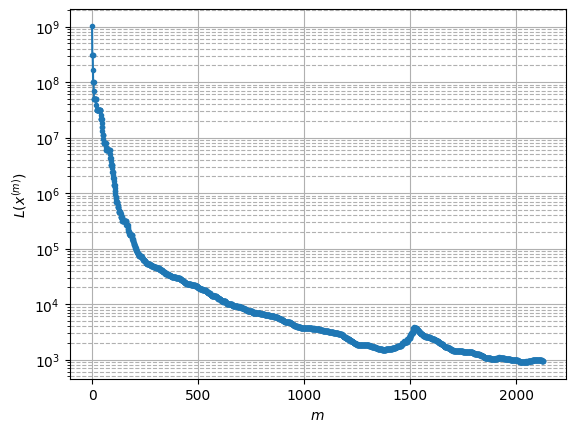

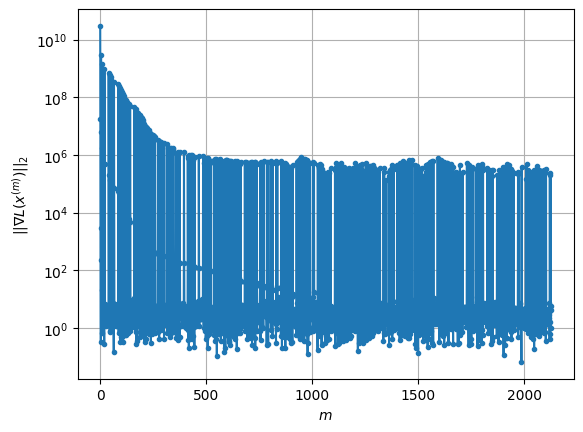

Windows:  76%|███████▌  | 225/296 [1:29:48<18:27, 15.60s/it]


Majorization-Minimization Iteration 1
Before applying the algorithm
Cost function: 933.141853999007
Gradient norm: 491694.3302434571
Global relative error: 43.73397836472161
Position relative errors: 0.03442500983223337 m, 28.39243931812166 m, 1.732405951118327 m, 33.21937381420024 m

Iteration 1
Cost function: 929.3446667689321 (-0.41%)
Gradient norm: 1.5508614580121058 (-100.00%)
Global relative error = 43.6573139720885 (-0.18%)
Position relative errors: 0.027404321576770894 m, 28.350047018019236 m, 1.577399576363844 m, 33.162417276580705 m

STOP on Iteration 2
Cost function = 929.3446682985073 (0.00%)
Gradient norm = 0.8859331205274988 (-42.87%)
Global relative error = 43.65731400179384 (0.00%)
Final position relative errors: 0.02740431719772024 m, 28.350047018302437 m, 1.577400184600437 m, 33.16241728651703 m

Majorization-Minimization converged after 1 iterations


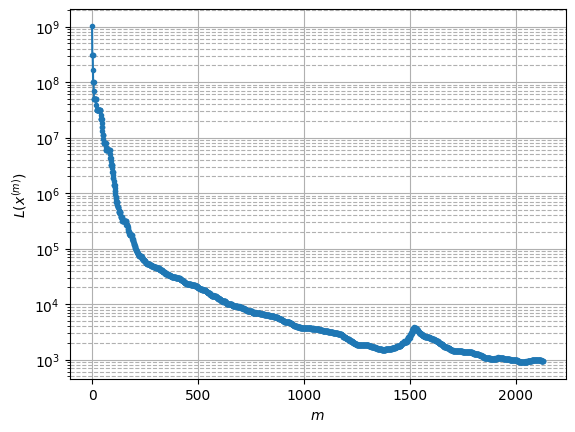

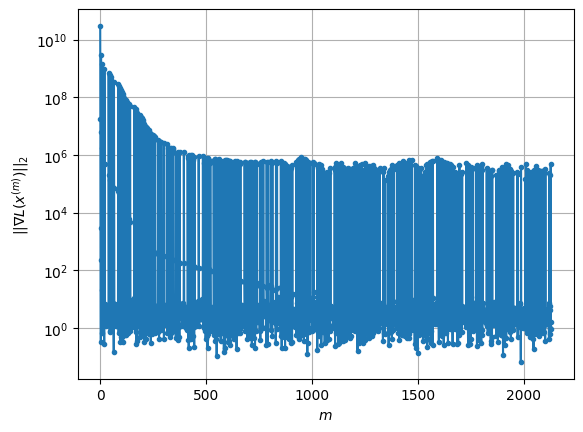

Windows:  76%|███████▋  | 226/296 [1:29:58<16:09, 13.85s/it]


Majorization-Minimization Iteration 1
Before applying the algorithm
Cost function: 919.1531688013188
Gradient norm: 147793.7179244725
Global relative error: 45.42282076348224
Position relative errors: 0.027389783673643007 m, 29.717865180690325 m, 1.8597279232614876 m, 34.30190883889743 m

Iteration 1
Cost function: 915.9823794868813 (-0.34%)
Gradient norm: 7.296977242454765 (-100.00%)
Global relative error = 45.347828475799346 (-0.17%)
Position relative errors: 0.024104608018511012 m, 29.67703421398912 m, 1.7179837943659915 m, 34.24538354834179 m

Iteration 2
Cost function: 915.9823805102773 (0.00%)
Gradient norm: 9.317637981152481 (27.69%)
Global relative error = 45.34782850611868 (0.00%)
Position relative errors: 0.024104605306508306 m, 29.67703421165917 m, 1.7179844540748082 m, 34.2453835574162 m

Iteration 3
Cost function: 915.9823797258653 (-0.00%)
Gradient norm: 5.375246471293245 (-42.31%)
Global relative error = 45.34782850644146 (0.00%)
Position relative errors: 0.024104604498

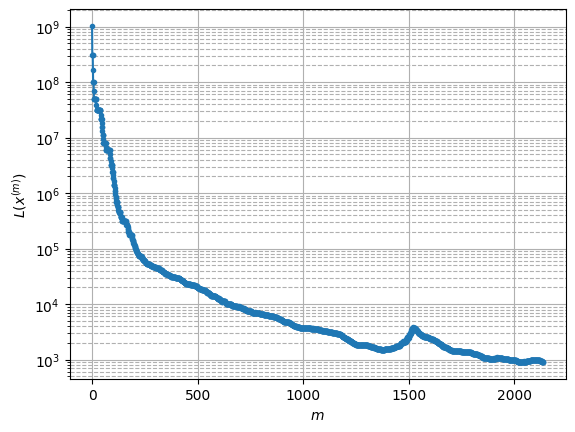

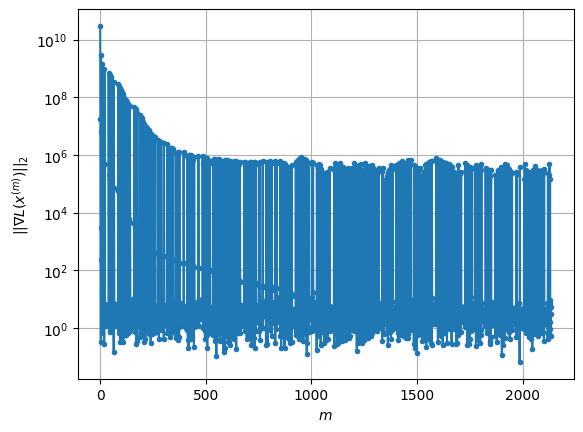

Windows:  77%|███████▋  | 227/296 [1:30:12<16:10, 14.07s/it]


Majorization-Minimization Iteration 1
Before applying the algorithm
Cost function: 894.7340084865393
Gradient norm: 182091.49105713467
Global relative error: 46.9194249009059
Position relative errors: 0.024018700974400967 m, 30.915190009505586 m, 2.065561927195301 m, 35.23372912597393 m

Iteration 1
Cost function: 891.2706283861903 (-0.39%)
Gradient norm: 2.219884018220781 (-100.00%)
Global relative error = 46.84694549960835 (-0.15%)
Position relative errors: 0.02597653506350582 m, 30.877414615540218 m, 1.9206502929039342 m, 35.17856351311458 m

STOP on Iteration 2
Cost function = 891.2706281025321 (-0.00%)
Gradient norm = 0.47547829052680324 (-78.58%)
Global relative error = 46.846945547712906 (0.00%)
Final position relative errors: 0.025976522526224084 m, 30.87741462083335 m, 1.920651207058637 m, 35.17856352262789 m

Majorization-Minimization converged after 1 iterations


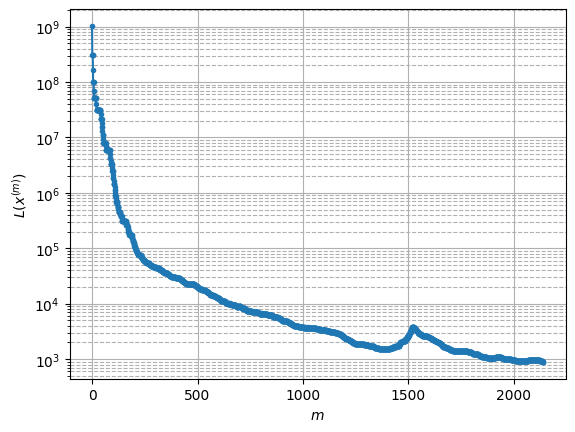

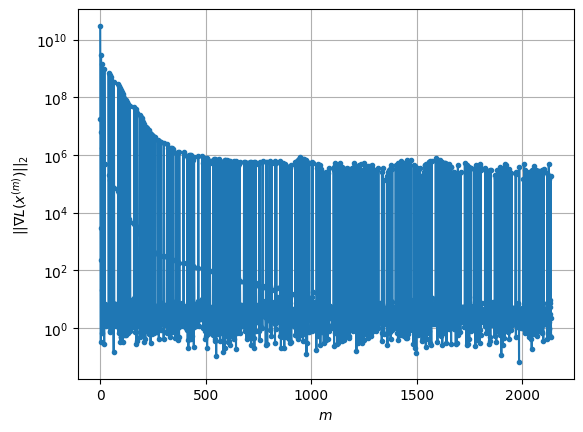

Windows:  77%|███████▋  | 228/296 [1:30:20<13:38, 12.04s/it]


Majorization-Minimization Iteration 1
Before applying the algorithm
Cost function: 878.5120226069141
Gradient norm: 150953.9611400852
Global relative error: 48.21758626822741
Position relative errors: 0.02574880243559679 m, 31.9805488573404 m, 2.3063678700692662 m, 36.011937132920316 m

STOP on Iteration 1
Cost function = 874.3036240593865 (-0.48%)
Gradient norm = 0.41740157570339526 (-100.00%)
Global relative error = 48.146738657109005 (-0.15%)
Final position relative errors: 0.04077521462401374 m, 31.94419776643094 m, 2.1869071699834643 m, 35.95680659076694 m

Majorization-Minimization converged after 1 iterations


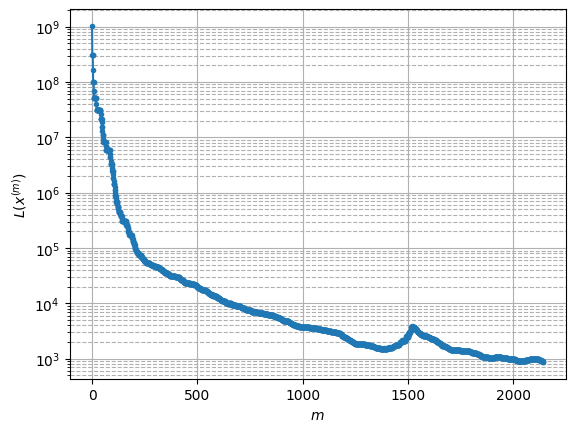

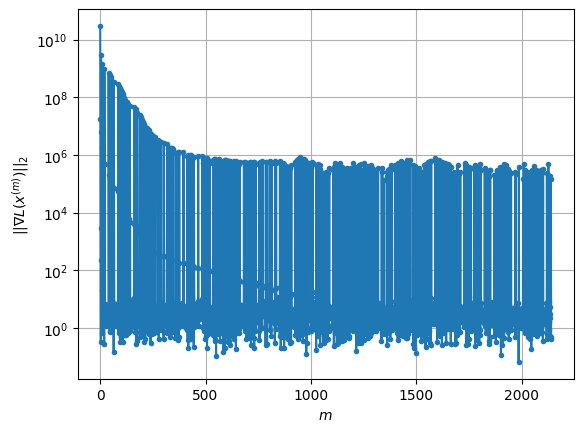

Windows:  77%|███████▋  | 229/296 [1:30:25<11:10, 10.00s/it]


Majorization-Minimization Iteration 1
Before applying the algorithm
Cost function: 854.092820190992
Gradient norm: 125840.608386064
Global relative error: 49.31051440962539
Position relative errors: 0.039938075614422024 m, 32.90765582619244 m, 2.5875806378661013 m, 36.632164574316995 m

Iteration 1
Cost function: 850.979776321296 (-0.36%)
Gradient norm: 1.8978715633372594 (-100.00%)
Global relative error = 49.24343632020596 (-0.14%)
Position relative errors: 0.04262269896055571 m, 32.875637127236345 m, 2.4998718173535304 m, 36.57672703069418 m

STOP on Iteration 2
Cost function = 850.9797761780557 (-0.00%)
Gradient norm = 0.3549006719955934 (-81.30%)
Global relative error = 49.24343636050723 (0.00%)
Final position relative errors: 0.04262272031927526 m, 32.8756371465998 m, 2.4998722711659567 m, 36.5767270365067 m

Majorization-Minimization converged after 1 iterations


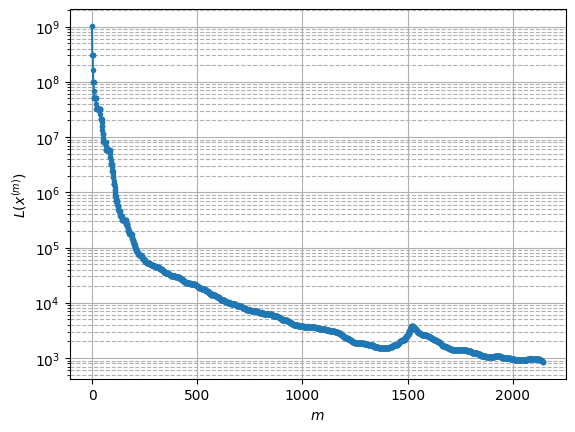

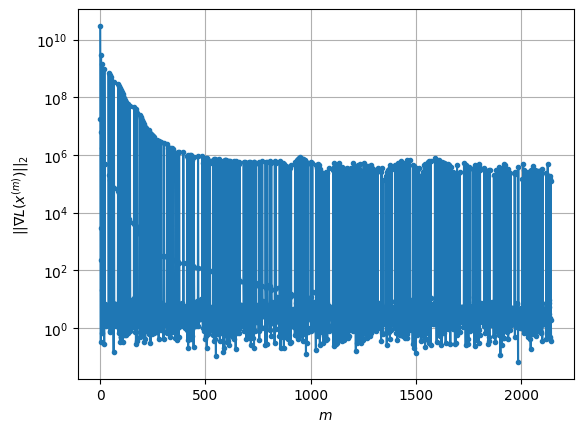

Windows:  78%|███████▊  | 230/296 [1:30:32<10:05,  9.17s/it]


Majorization-Minimization Iteration 1
Before applying the algorithm
Cost function: 826.6026782798632
Gradient norm: 126277.82774930871
Global relative error: 50.19535262416699
Position relative errors: 0.04158901469669615 m, 33.69520309990106 m, 2.900469835395906 m, 37.09167028766886 m

STOP on Iteration 1
Cost function = 822.9269711549176 (-0.44%)
Gradient norm = 0.7469947906076206 (-100.00%)
Global relative error = 50.13216673207239 (-0.13%)
Final position relative errors: 0.046264479307226145 m, 33.66621227790064 m, 2.8258187540428628 m, 37.03825923936536 m

Majorization-Minimization converged after 1 iterations


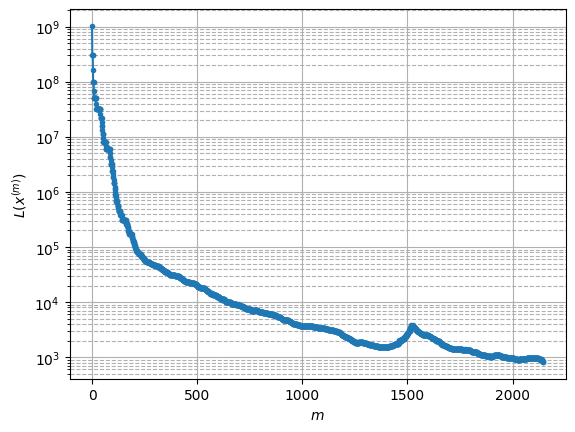

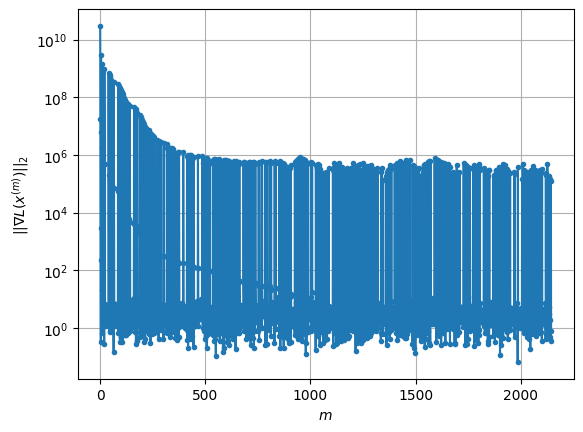

Windows:  78%|███████▊  | 231/296 [1:30:38<08:43,  8.05s/it]


Majorization-Minimization Iteration 1
Before applying the algorithm
Cost function: 807.8846764252002
Gradient norm: 330216.57542586105
Global relative error: 50.868253069147826
Position relative errors: 0.04494762741342822 m, 34.33838324040157 m, 3.219721682227943 m, 37.390985760541845 m

Iteration 1
Cost function: 804.9283522127588 (-0.37%)
Gradient norm: 3.4819709535429464 (-100.00%)
Global relative error = 50.80882237465811 (-0.12%)
Position relative errors: 0.047168158639471276 m, 34.31289220360779 m, 3.168628734665105 m, 37.337906539551106 m

STOP on Iteration 2
Cost function = 804.9283515131203 (-0.00%)
Gradient norm = 0.5739676271530245 (-83.52%)
Global relative error = 50.80882240742343 (0.00%)
Final position relative errors: 0.04716817087249647 m, 34.312892217755035 m, 3.168629035981533 m, 37.33790654555029 m

Majorization-Minimization converged after 1 iterations


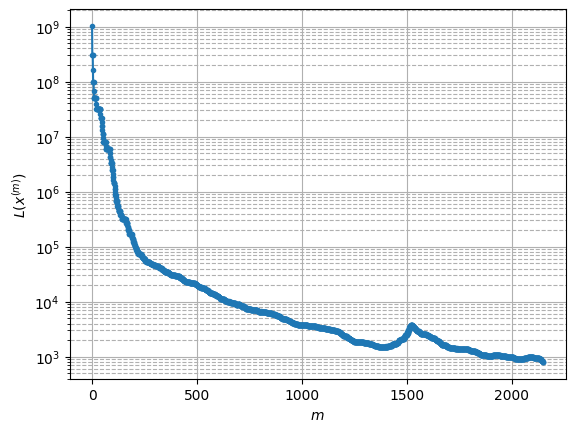

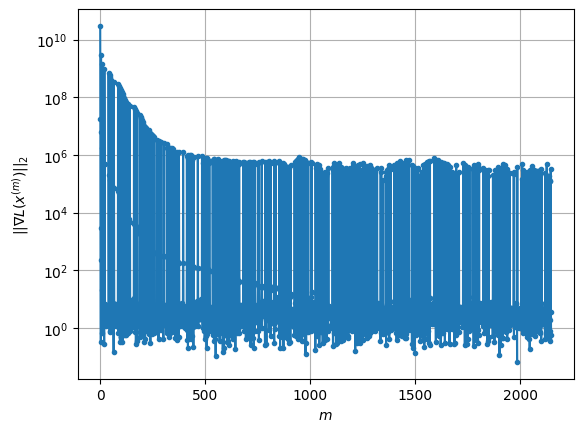

Windows:  78%|███████▊  | 232/296 [1:30:45<08:25,  7.90s/it]


Majorization-Minimization Iteration 1
Before applying the algorithm
Cost function: 792.9919649652871
Gradient norm: 239059.65969145292
Global relative error: 51.32625646141856
Position relative errors: 0.0460209944380387 m, 34.83483129105784 m, 3.5505714678789855 m, 37.527461378599064 m

Iteration 1
Cost function: 789.976998122207 (-0.38%)
Gradient norm: 3.99626696226694 (-100.00%)
Global relative error = 51.271093548820225 (-0.11%)
Position relative errors: 0.04923184774529872 m, 34.8113388766803 m, 3.514374074036939 m, 37.47722471838114 m

Iteration 2
Cost function: 789.9769991554967 (0.00%)
Gradient norm: 3.1421557180881594 (-21.37%)
Global relative error = 51.27109357656614 (0.00%)
Position relative errors: 0.049231859382697175 m, 34.81133888402154 m, 3.514374301661817 m, 37.477224728159676 m

Iteration 3
Cost function: 789.9769994671162 (0.00%)
Gradient norm: 7.176094019638171 (128.38%)
Global relative error = 51.27109357690181 (0.00%)
Position relative errors: 0.0492318592028974

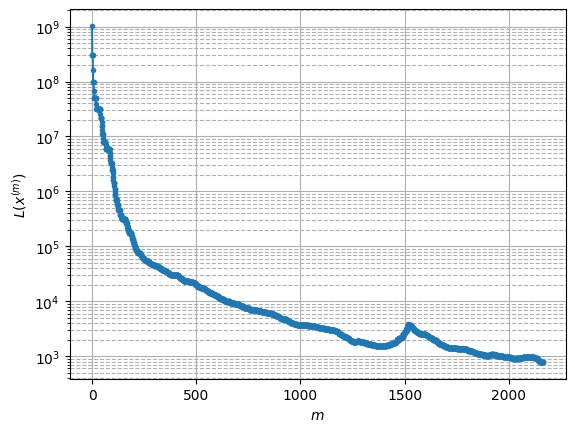

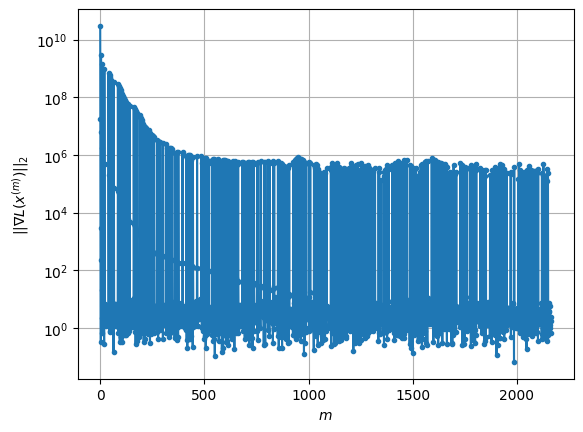

Windows:  79%|███████▊  | 233/296 [1:31:22<17:24, 16.57s/it]


Majorization-Minimization Iteration 1
Before applying the algorithm
Cost function: 771.3625407283635
Gradient norm: 177774.79515248997
Global relative error: 51.567972653901904
Position relative errors: 0.048033240505515905 m, 35.18089660077888 m, 3.8811513570284295 m, 37.503261380490315 m

Iteration 1
Cost function: 767.5649430086378 (-0.49%)
Gradient norm: 2.4342368383972373 (-100.00%)
Global relative error = 51.51743447573997 (-0.10%)
Position relative errors: 0.05074718461570235 m, 35.1597568586753 m, 3.859992110426403 m, 37.455778961158636 m

Iteration 2
Cost function: 767.5649435948742 (0.00%)
Gradient norm: 1.462000963707871 (-39.94%)
Global relative error = 51.517434505740255 (0.00%)
Position relative errors: 0.05074719503958392 m, 35.15975686572213 m, 3.859992352846749 m, 37.45577897081011 m

Iteration 3
Cost function: 767.5649440636332 (0.00%)
Gradient norm: 1.9293434844465565 (31.97%)
Global relative error = 51.51743450574812 (0.00%)
Position relative errors: 0.050747195086

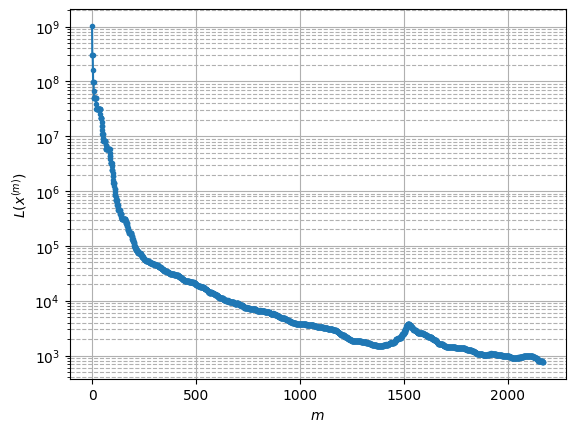

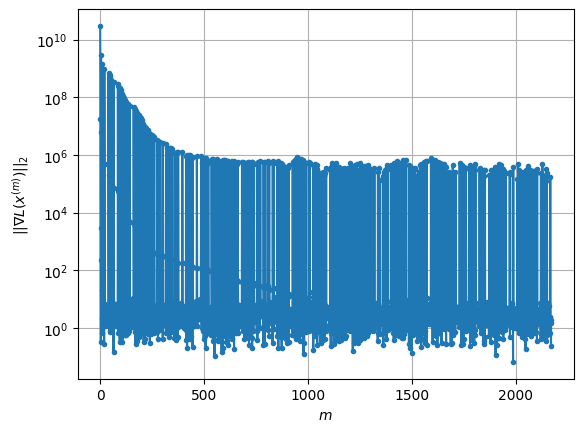

Windows:  79%|███████▉  | 234/296 [1:31:34<15:46, 15.26s/it]


Majorization-Minimization Iteration 1
Before applying the algorithm
Cost function: 758.9231388052257
Gradient norm: 466895.4111021711
Global relative error: 51.592924446249725
Position relative errors: 0.04939936470502642 m, 35.375445162953966 m, 4.208993649694516 m, 37.318756858782635 m

Iteration 1
Cost function: 756.2116439737681 (-0.36%)
Gradient norm: 5.945182683591843 (-100.00%)
Global relative error = 51.54553919728911 (-0.09%)
Position relative errors: 0.04493947617700345 m, 35.35660875019279 m, 4.208921117136509 m, 37.27111135132476 m

Iteration 2
Cost function: 756.2116421940569 (-0.00%)
Gradient norm: 3.554660289156913 (-40.21%)
Global relative error = 51.545539215814436 (0.00%)
Position relative errors: 0.04493947907868427 m, 35.35660876376363 m, 4.208921174251073 m, 37.27111135761806 m

Iteration 3
Cost function: 756.2116424997948 (0.00%)
Gradient norm: 1.4922878995273423 (-58.02%)
Global relative error = 51.54553921609855 (0.00%)
Position relative errors: 0.0449394793535

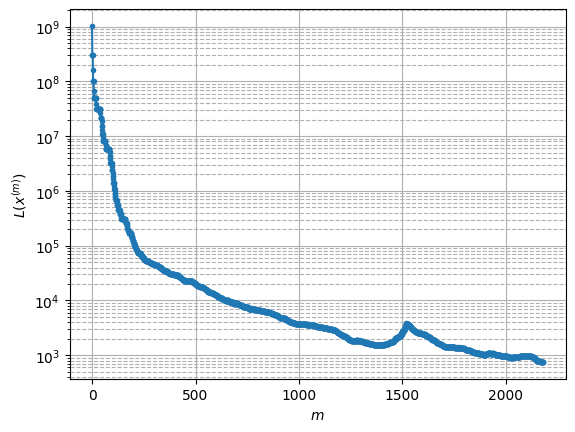

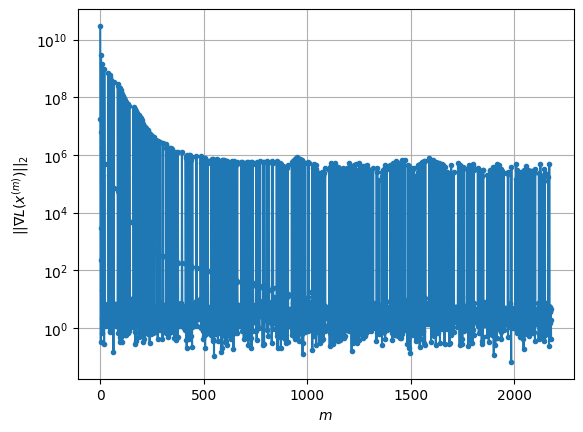

Windows:  79%|███████▉  | 235/296 [1:31:58<18:05, 17.80s/it]


Majorization-Minimization Iteration 1
Before applying the algorithm
Cost function: 745.1461897884798
Gradient norm: 192244.33265984026
Global relative error: 51.39999252293355
Position relative errors: 0.043826539242208584 m, 35.41760643785606 m, 4.538200846881948 m, 36.97235628042061 m

STOP on Iteration 1
Cost function = 742.8884187937267 (-0.30%)
Gradient norm = 0.8918865446323044 (-100.00%)
Global relative error = 51.35543458111025 (-0.09%)
Final position relative errors: 0.03674914024441092 m, 35.39976783331887 m, 4.552105487691939 m, 36.925790646388776 m

Majorization-Minimization converged after 1 iterations


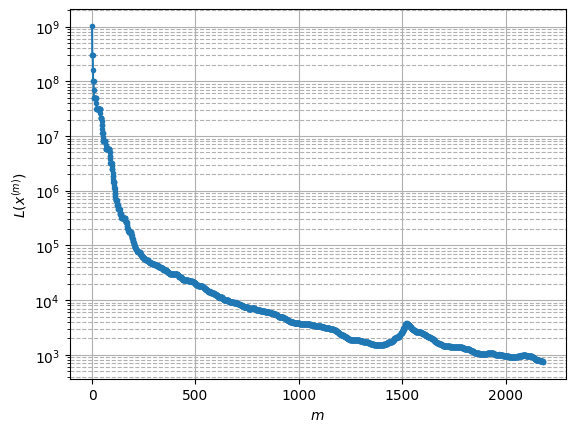

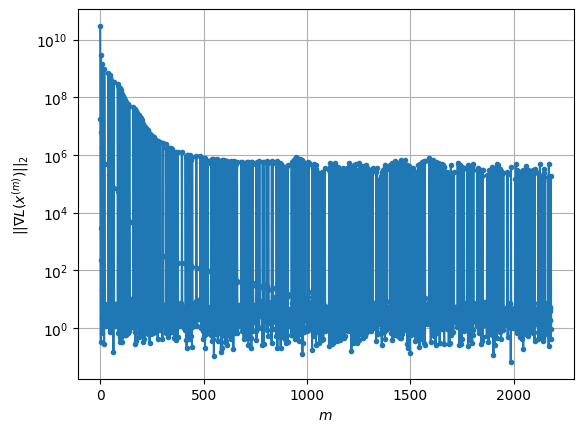

Windows:  80%|███████▉  | 236/296 [1:32:03<14:01, 14.02s/it]


Majorization-Minimization Iteration 1
Before applying the algorithm
Cost function: 739.8249376841426
Gradient norm: 219743.5543243192
Global relative error: 50.99009963435907
Position relative errors: 0.03594497075072706 m, 35.30604789852057 m, 4.859956542102208 m, 36.467144926700975 m

Iteration 1
Cost function: 738.2003329581781 (-0.22%)
Gradient norm: 1.496742847343667 (-100.00%)
Global relative error = 50.94724769286743 (-0.08%)
Position relative errors: 0.038594143083249 m, 35.28857033968156 m, 4.88324509940364 m, 36.421026420399095 m

STOP on Iteration 2
Cost function = 738.2003325636641 (-0.00%)
Gradient norm = 0.31843567351488017 (-78.72%)
Global relative error = 50.94724769832962 (0.00%)
Final position relative errors: 0.03859414633951261 m, 35.288570345176936 m, 4.883245065475356 m, 36.421026427260905 m

Majorization-Minimization converged after 1 iterations


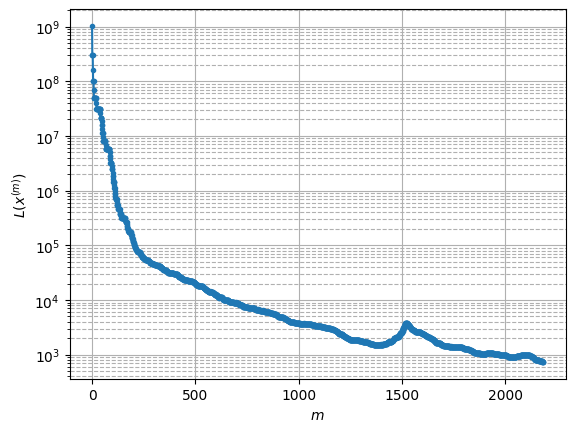

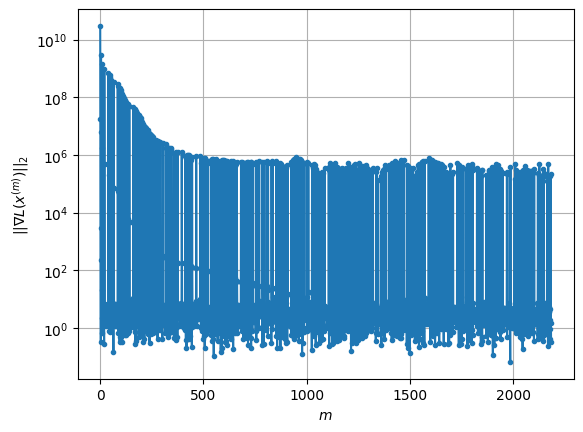

Windows:  80%|████████  | 237/296 [1:32:13<12:36, 12.83s/it]


Majorization-Minimization Iteration 1
Before applying the algorithm
Cost function: 741.0239289906092
Gradient norm: 207650.07757846278
Global relative error: 50.36438798684081
Position relative errors: 0.03760340704824043 m, 35.040795030994595 m, 5.168071022036366 m, 35.80507930808271 m

Iteration 1
Cost function: 738.9750112059762 (-0.28%)
Gradient norm: 2.5615425433036334 (-100.00%)
Global relative error = 50.32247103622137 (-0.08%)
Position relative errors: 0.048755554985193586 m, 35.024582403696634 m, 5.1897076980443675 m, 35.7588323631249 m

Iteration 2
Cost function: 738.9750121007387 (0.00%)
Gradient norm: 2.6429330305383494 (3.18%)
Global relative error = 50.32247104566652 (0.00%)
Position relative errors: 0.048755549522805766 m, 35.02458241065183 m, 5.189707670082799 m, 35.75883237366997 m

STOP on Iteration 3
Cost function = 738.9750120317678 (-0.00%)
Gradient norm = 0.8911101397490381 (-66.28%)
Global relative error = 50.32247104502476 (-0.00%)
Final position relative error

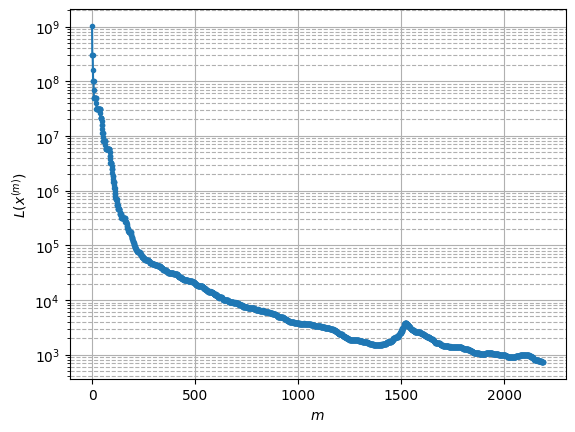

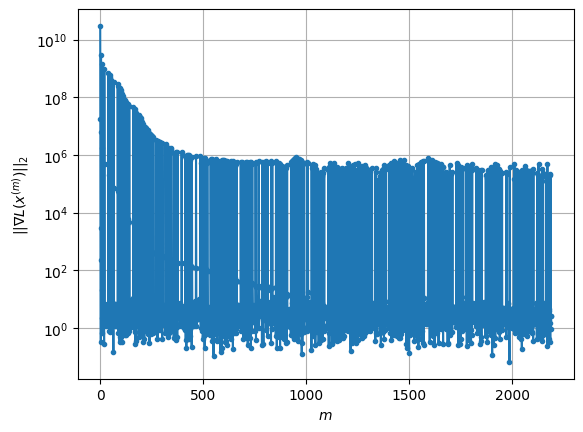

Windows:  80%|████████  | 238/296 [1:32:23<11:32, 11.95s/it]


Majorization-Minimization Iteration 1
Before applying the algorithm
Cost function: 755.5157426030815
Gradient norm: 260503.0339168794
Global relative error: 49.52522600231915
Position relative errors: 0.04737166027105028 m, 34.624002416432184 m, 5.450042103517153 m, 34.98886943547521 m

Iteration 1
Cost function: 753.2432254443788 (-0.30%)
Gradient norm: 3.818302515736275 (-100.00%)
Global relative error = 49.48300683875679 (-0.09%)
Position relative errors: 0.05340095378570843 m, 34.60704612039159 m, 5.47094071713879 m, 34.94261012262394 m

Iteration 2
Cost function: 753.2432257341677 (0.00%)
Gradient norm: 1.7358742529776012 (-54.54%)
Global relative error = 49.483006852554276 (0.00%)
Position relative errors: 0.05340094803985769 m, 34.60704613069991 m, 5.470940692519631 m, 34.9426101358169 m

Iteration 3
Cost function: 753.2432253623891 (-0.00%)
Gradient norm: 3.5653156343934853 (105.39%)
Global relative error = 49.48300685263786 (0.00%)
Position relative errors: 0.0534009480425167

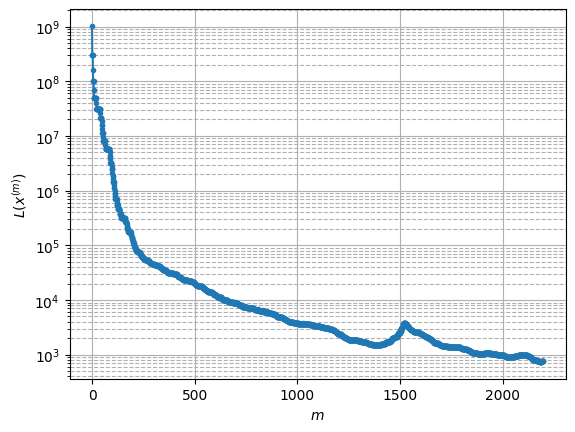

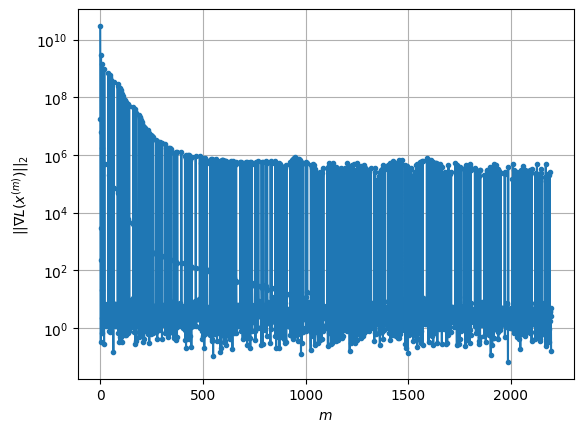

Windows:  81%|████████  | 239/296 [1:32:42<13:24, 14.11s/it]


Majorization-Minimization Iteration 1
Before applying the algorithm
Cost function: 769.2951286124918
Gradient norm: 256863.7182504783
Global relative error: 48.47552205132165
Position relative errors: 0.05175787889557331 m, 34.05571035692812 m, 5.705314982738906 m, 34.022509231224426 m

Iteration 1
Cost function: 766.8827878755865 (-0.31%)
Gradient norm: 1.3383230597221452 (-100.00%)
Global relative error = 48.433274105676226 (-0.09%)
Position relative errors: 0.05065480518212627 m, 34.03855852934844 m, 5.7264427950010885 m, 33.97592478254233 m

Iteration 2
Cost function: 766.882788515082 (0.00%)
Gradient norm: 1.9782807460903302 (47.82%)
Global relative error = 48.43327411638633 (0.00%)
Position relative errors: 0.0506547973421381 m, 34.03855853457936 m, 5.726442768528723 m, 33.97592479704264 m

Iteration 3
Cost function: 766.8827895681851 (0.00%)
Gradient norm: 1.6240832918185233 (-17.90%)
Global relative error = 48.43327411688297 (0.00%)
Position relative errors: 0.0506547986746402

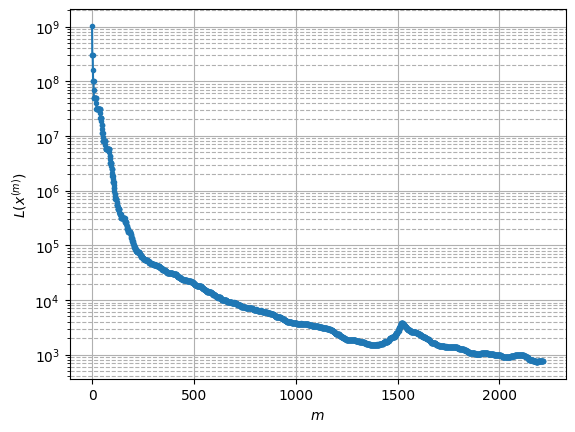

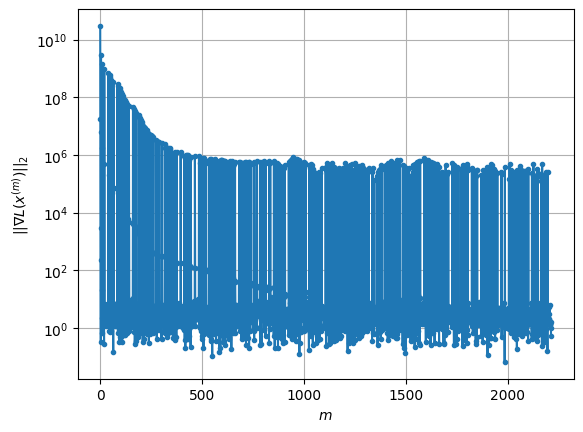

Windows:  81%|████████  | 240/296 [1:33:24<20:58, 22.47s/it]


Majorization-Minimization Iteration 1
Before applying the algorithm
Cost function: 765.0452759949358
Gradient norm: 246752.36333581278
Global relative error: 30.77474148955823
Position relative errors: 0.038950124421945814 m, 22.791676253229934 m, 6.694173922987831 m, 19.56549750768254 m

Iteration 1
Cost function: 762.840449898435 (-0.29%)
Gradient norm: 4.082542873271826 (-100.00%)
Global relative error = 30.752700229248344 (-0.07%)
Position relative errors: 0.028221755731204955 m, 22.780695785393593 m, 6.712630075362709 m, 19.53730390866222 m

Iteration 2
Cost function: 762.8404516698512 (0.00%)
Gradient norm: 2.090381565003037 (-48.80%)
Global relative error = 30.75270024223406 (0.00%)
Position relative errors: 0.028221750768056886 m, 22.780695786507707 m, 6.712630093497873 m, 19.537303921579586 m

Iteration 3
Cost function: 762.8404510669643 (-0.00%)
Gradient norm: 1.1644637332829828 (-44.29%)
Global relative error = 30.75270024240551 (0.00%)
Position relative errors: 0.028221755

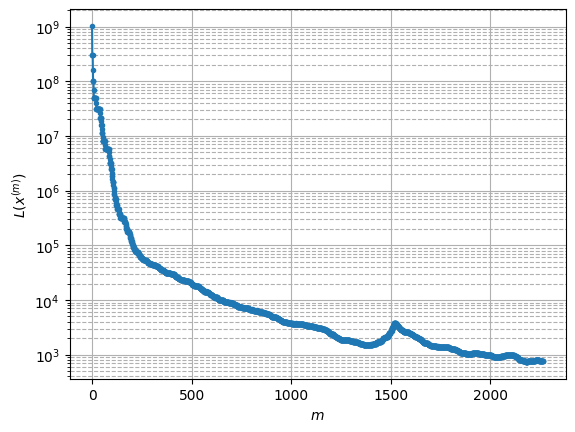

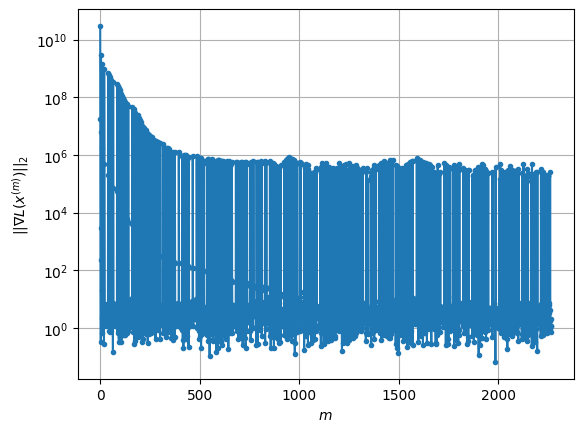

Windows:  84%|████████▍ | 249/296 [1:35:33<11:36, 14.82s/it]


Majorization-Minimization Iteration 1
Before applying the algorithm
Cost function: 755.7349501138389
Gradient norm: 179520.63126213202
Global relative error: 28.07617208362477
Position relative errors: 0.026799604318001578 m, 20.963932953742688 m, 6.637105799878447 m, 17.456541579634038 m

Iteration 1
Cost function: 753.067124887506 (-0.35%)
Gradient norm: 2.6692696903436444 (-100.00%)
Global relative error = 28.0595555232833 (-0.06%)
Position relative errors: 0.019054222700924887 m, 20.9531935798448 m, 6.65550510942068 m, 17.435710777232718 m

STOP on Iteration 2
Cost function = 753.0671246204049 (-0.00%)
Gradient norm = 0.4299346000355675 (-83.89%)
Global relative error = 28.059555537679987 (0.00%)
Final position relative errors: 0.019054226256480417 m, 20.95319358372917 m, 6.655505126620051 m, 17.43571078916433 m

Majorization-Minimization converged after 1 iterations


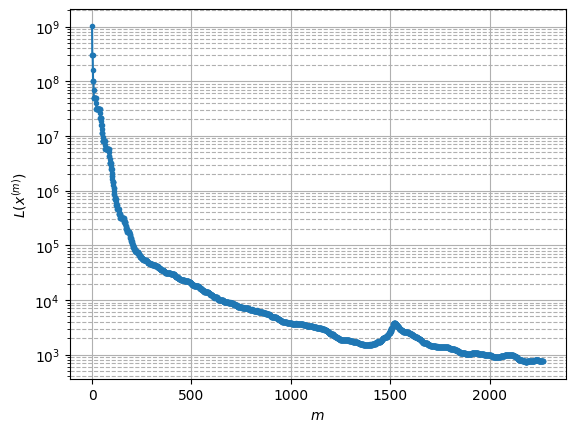

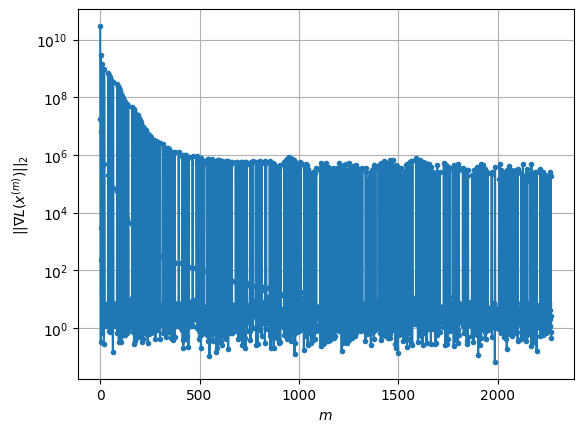

Windows:  84%|████████▍ | 250/296 [1:35:41<09:42, 12.66s/it]


Majorization-Minimization Iteration 1
Before applying the algorithm
Cost function: 744.2173004593651
Gradient norm: 284340.7779437339
Global relative error: 25.283027115475782
Position relative errors: 0.017849018924216 m, 19.04603588378164 m, 6.548786857980606 m, 15.283672884826714 m

Iteration 1
Cost function: 741.1592597880593 (-0.41%)
Gradient norm: 4.5416939950080675 (-100.00%)
Global relative error = 25.272311972656013 (-0.04%)
Position relative errors: 0.024140686289758753 m, 19.037748709478763 m, 6.567860457295717 m, 15.268075038545119 m

Iteration 2
Cost function: 741.1592586278003 (-0.00%)
Gradient norm: 3.5975338838688 (-20.79%)
Global relative error = 25.272311988799103 (0.00%)
Position relative errors: 0.02414067599660663 m, 19.037748713140818 m, 6.567860482463979 m, 15.268075049889209 m

Iteration 3
Cost function: 741.1592588197815 (0.00%)
Gradient norm: 1.5783116963586765 (-56.13%)
Global relative error = 25.272311989475543 (0.00%)
Position relative errors: 0.0241406823

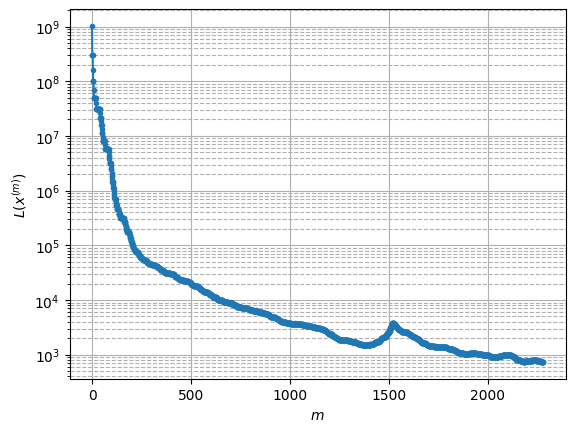

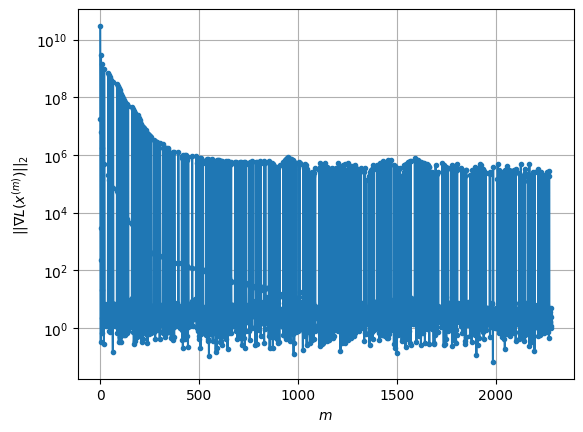

Windows:  85%|████████▍ | 251/296 [1:36:07<12:30, 16.67s/it]


Majorization-Minimization Iteration 1
Before applying the algorithm
Cost function: 735.5696522727964
Gradient norm: 285317.9199507146
Global relative error: 22.415140614243384
Position relative errors: 0.023142446313616793 m, 17.04862239644172 m, 6.430542452602194 m, 13.054809046365612 m

Iteration 1
Cost function: 732.5303622664328 (-0.41%)
Gradient norm: 4.354305943940508 (-100.00%)
Global relative error = 22.411983381214633 (-0.01%)
Position relative errors: 0.026400854758800642 m, 17.042186437483185 m, 6.454130783803031 m, 13.04614242793665 m

Iteration 2
Cost function: 732.5303627452723 (0.00%)
Gradient norm: 7.887713981771041 (81.15%)
Global relative error = 22.411983397494875 (0.00%)
Position relative errors: 0.026400859464240777 m, 17.042186441918133 m, 6.454130804939322 m, 13.046142439645118 m

STOP on Iteration 3
Cost function = 732.5303619675814 (-0.00%)
Gradient norm = 0.7321751866702185 (-90.72%)
Global relative error = 22.411983397873563 (0.00%)
Final position relative e

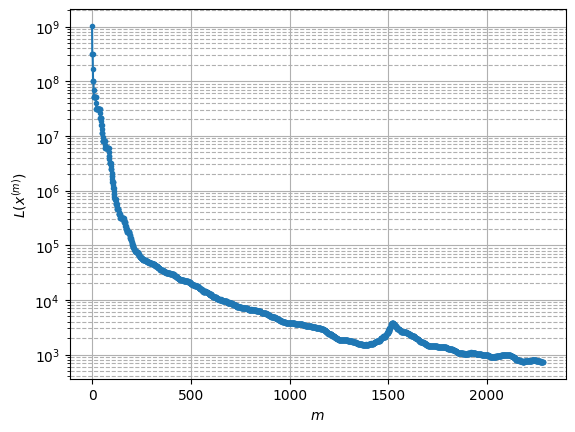

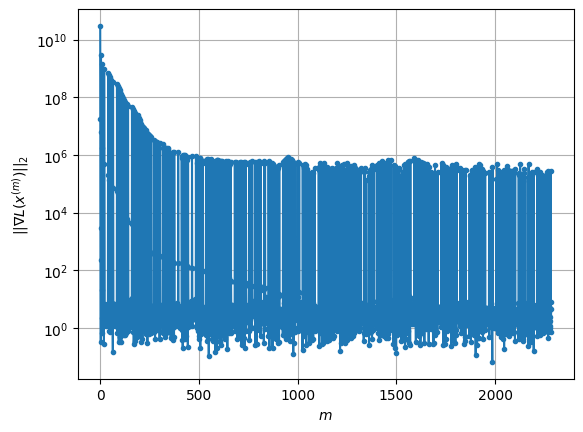

Windows:  85%|████████▌ | 252/296 [1:36:17<10:46, 14.69s/it]


Majorization-Minimization Iteration 1
Before applying the algorithm
Cost function: 723.8407857443073
Gradient norm: 236895.6174547882
Global relative error: 19.498490230461147
Position relative errors: 0.02541630877841086 m, 14.979857809751781 m, 6.28674537320324 m, 10.782785971632483 m

Iteration 1
Cost function: 721.3141708325754 (-0.35%)
Gradient norm: 4.840188137280881 (-100.00%)
Global relative error = 19.4993174584633 (0.00%)
Position relative errors: 0.024346386504047784 m, 14.973440321834456 m, 6.299464981491003 m, 10.785774197204463 m

Iteration 2
Cost function: 721.3141725807036 (0.00%)
Gradient norm: 3.042632285714134 (-37.14%)
Global relative error = 19.499317473369732 (0.00%)
Position relative errors: 0.024346395723338625 m, 14.973440325054868 m, 6.299465001650371 m, 10.785774207887668 m

Iteration 3
Cost function: 721.3141716628008 (-0.00%)
Gradient norm: 1.6573543006566531 (-45.53%)
Global relative error = 19.49931747404057 (0.00%)
Position relative errors: 0.0243463834

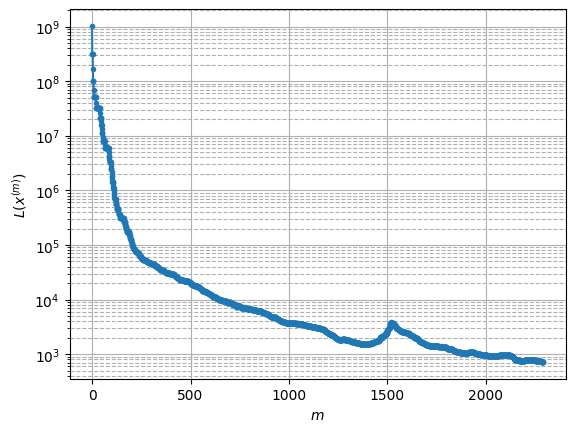

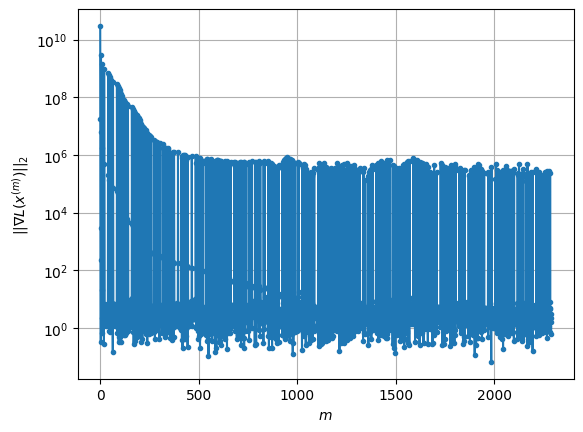

Windows:  85%|████████▌ | 253/296 [1:36:32<10:29, 14.65s/it]


Majorization-Minimization Iteration 1
Before applying the algorithm
Cost function: 702.6711491190758
Gradient norm: 228940.99656756088
Global relative error: 16.562494934669793
Position relative errors: 0.023554309378372135 m, 12.846982587686442 m, 6.103562417936105 m, 8.486131662375586 m

Iteration 1
Cost function: 699.94393827545 (-0.39%)
Gradient norm: 2.018316426430241 (-100.00%)
Global relative error = 16.573870332698288 (0.07%)
Position relative errors: 0.02824621431348726 m, 12.844084429843374 m, 6.114228335509823 m, 8.505014677535046 m

Iteration 2
Cost function: 699.9439383225747 (0.00%)
Gradient norm: 3.7643774855142436 (86.51%)
Global relative error = 16.57387034553312 (0.00%)
Position relative errors: 0.028246204972004897 m, 12.844084431077917 m, 6.114228352754215 m, 8.505014688316193 m

Iteration 3
Cost function: 699.9439377235016 (-0.00%)
Gradient norm: 4.9729249101067445 (32.10%)
Global relative error = 16.573870344054182 (-0.00%)
Position relative errors: 0.02824621976

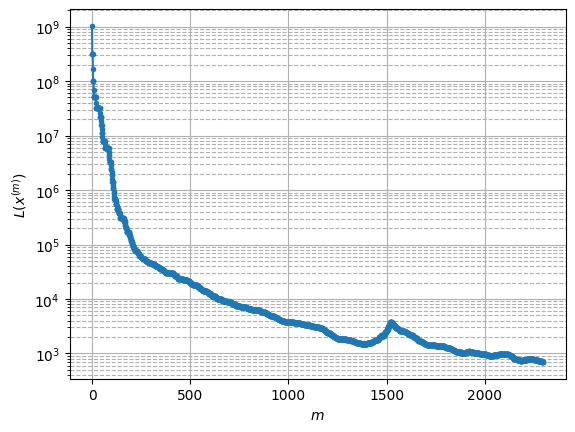

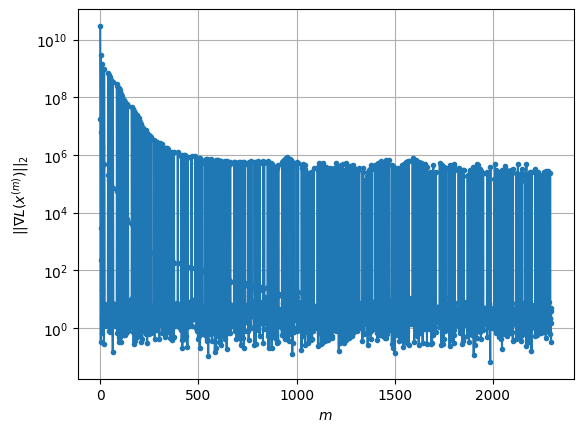

Windows:  86%|████████▌ | 254/296 [1:36:49<10:46, 15.40s/it]


Majorization-Minimization Iteration 1
Before applying the algorithm
Cost function: 686.6867886916076
Gradient norm: 153976.72719257834
Global relative error: 13.664969143369666
Position relative errors: 0.027250811453170917 m, 10.662986945146626 m, 5.890947698347863 m, 6.190732215713516 m

Iteration 1
Cost function: 684.1112292124652 (-0.38%)
Gradient norm: 1.840347152164252 (-100.00%)
Global relative error = 13.684426262896492 (0.14%)
Position relative errors: 0.023474394370095974 m, 10.660472826764394 m, 5.89669759215773 m, 6.232442070458704 m

Iteration 2
Cost function: 684.1112295314535 (0.00%)
Gradient norm: 3.12795005095037 (69.97%)
Global relative error = 13.68442627211167 (0.00%)
Position relative errors: 0.02347439840501857 m, 10.660472829442536 m, 5.896697595477867 m, 6.232442082954838 m

Iteration 3
Cost function: 684.1112297693899 (0.00%)
Gradient norm: 3.4411831281370566 (10.01%)
Global relative error = 13.684426273246645 (0.00%)
Position relative errors: 0.02347439101252

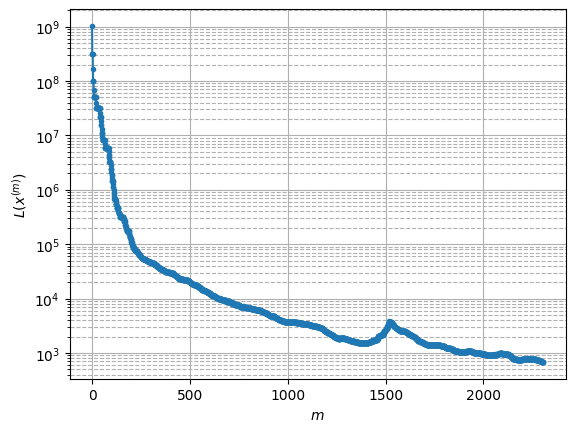

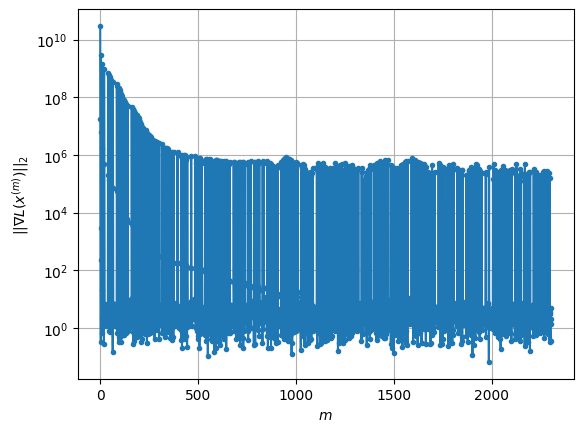

Windows:  86%|████████▌ | 255/296 [1:37:08<11:14, 16.45s/it]


Majorization-Minimization Iteration 1
Before applying the algorithm
Cost function: 675.8189681882196
Gradient norm: 237384.66055897268
Global relative error: 10.89453297264739
Position relative errors: 0.022656264727362506 m, 8.43446842234936 m, 5.6471934857048725 m, 3.956802689023419 m

STOP on Iteration 1
Cost function = 673.2406821152167 (-0.38%)
Gradient norm = 0.6358942465002764 (-100.00%)
Global relative error = 10.923927018401905 (0.27%)
Final position relative errors: 0.0156920771697335 m, 8.43959242768122 m, 5.646919415999644 m, 4.026726299471675 m

Majorization-Minimization converged after 1 iterations


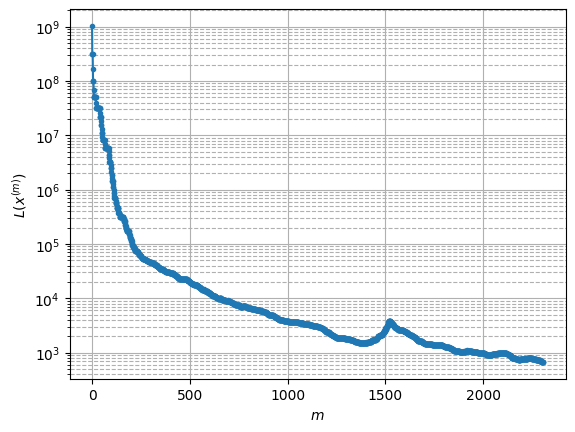

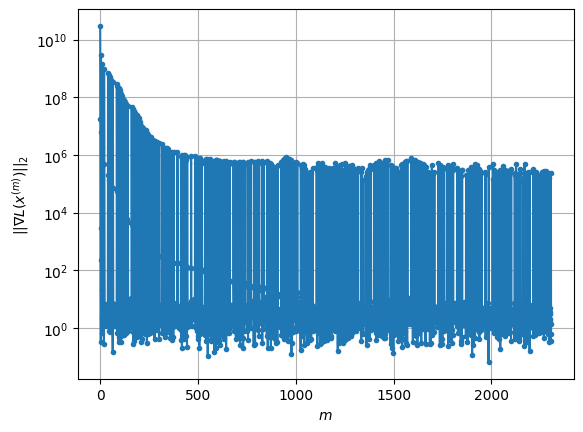

Windows:  86%|████████▋ | 256/296 [1:37:13<08:45, 13.13s/it]


Majorization-Minimization Iteration 1
Before applying the algorithm
Cost function: 662.5977455301419
Gradient norm: 137392.50218764486
Global relative error: 8.440950342515928
Position relative errors: 0.014950530432587218 m, 6.179669796509595 m, 5.372877900252266 m, 2.0470062258184734 m

STOP on Iteration 1
Cost function = 660.1775903225869 (-0.37%)
Gradient norm = 0.5711881035343864 (-100.00%)
Global relative error = 8.482295973554983 (0.49%)
Final position relative errors: 0.020205062856596193 m, 6.185606736185265 m, 5.363457893975245 m, 2.2175394069600634 m

Majorization-Minimization converged after 1 iterations


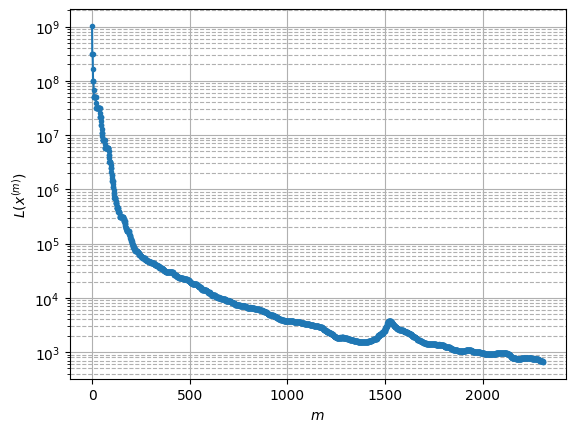

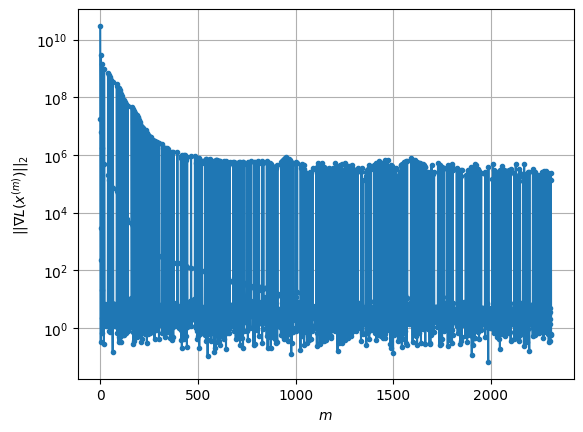

Windows:  87%|████████▋ | 257/296 [1:37:19<07:01, 10.82s/it]


Majorization-Minimization Iteration 1
Before applying the algorithm
Cost function: 659.6367307187218
Gradient norm: 154205.9246490336
Global relative error: 6.715978475860607
Position relative errors: 0.019728160298489502 m, 3.9046719815911946 m, 5.066348720184013 m, 2.046105752422269 m

Iteration 1
Cost function: 657.904573542812 (-0.26%)
Gradient norm: 3.6586820118472385 (-100.00%)
Global relative error = 6.747501751916978 (0.47%)
Position relative errors: 0.02067954489248161 m, 3.9173981214963955 m, 5.043920118419149 m, 2.1767274459514687 m

Iteration 2
Cost function: 657.9045726265452 (-0.00%)
Gradient norm: 4.091686095719185 (11.83%)
Global relative error = 6.747501765889381 (0.00%)
Position relative errors: 0.02067954497140117 m, 3.9173981272439664 m, 5.043920128028242 m, 2.1767274566530452 m

Iteration 3
Cost function: 657.9045727779687 (0.00%)
Gradient norm: 4.109901224769864 (0.45%)
Global relative error = 6.747501769783336 (0.00%)
Position relative errors: 0.0206795458860858

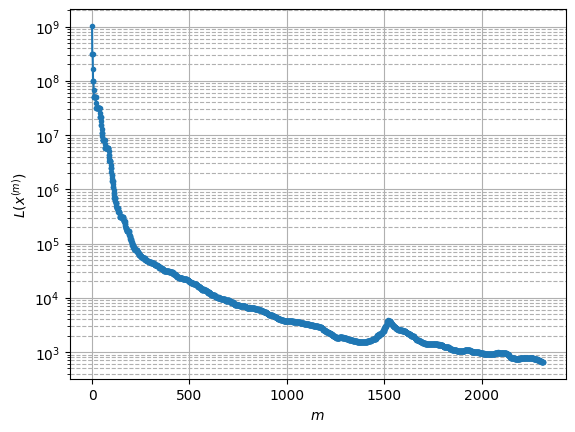

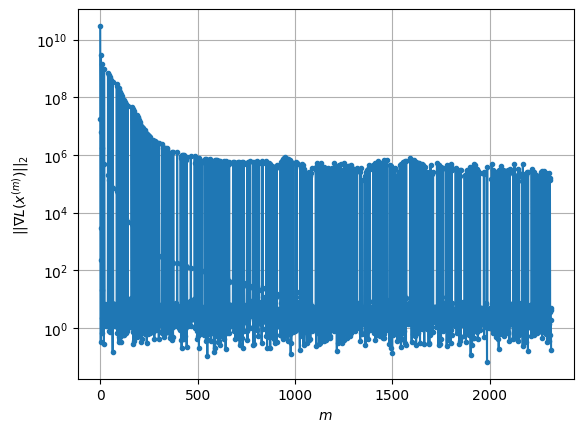

Windows:  87%|████████▋ | 258/296 [1:37:35<07:58, 12.58s/it]


Majorization-Minimization Iteration 1
Before applying the algorithm
Cost function: 653.2821174321788
Gradient norm: 361467.5753158864
Global relative error: 6.349944768606154
Position relative errors: 0.020196563276136403 m, 1.6511459678811162 m, 4.725163089847735 m, 3.9070275283957003 m

Iteration 1
Cost function: 651.2831385392917 (-0.31%)
Gradient norm: 3.4880650078524775 (-100.00%)
Global relative error = 6.385527597046423 (0.56%)
Position relative errors: 0.018720859624902164 m, 1.6704110210727998 m, 4.7044100418201875 m, 3.9811797766055803 m

Iteration 2
Cost function: 651.2831389762364 (0.00%)
Gradient norm: 2.1029503674218484 (-39.71%)
Global relative error = 6.3855276069772895 (0.00%)
Position relative errors: 0.01872085640237365 m, 1.6704110215673653 m, 4.704410046517309 m, 3.9811797867912997 m

STOP on Iteration 3
Cost function = 651.2831371918786 (-0.00%)
Gradient norm = 0.31293759441671987 (-85.12%)
Global relative error = 6.385527605933127 (-0.00%)
Final position relativ

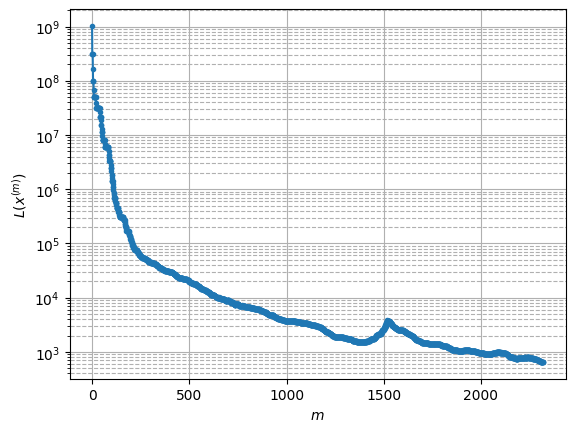

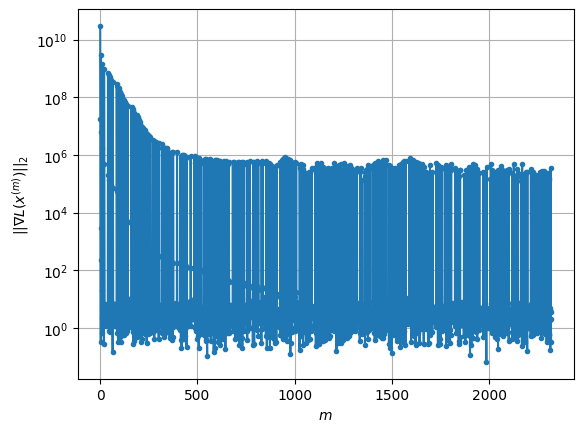

Windows:  88%|████████▊ | 259/296 [1:37:45<07:16, 11.78s/it]


Majorization-Minimization Iteration 1
Before applying the algorithm
Cost function: 660.5662053888685
Gradient norm: 187044.50502441457
Global relative error: 7.563519002737155
Position relative errors: 0.018490357809611422 m, 0.8775335595356946 m, 4.36567140719867 m, 6.113450204216059 m

Iteration 1
Cost function: 658.6489167553062 (-0.29%)
Gradient norm: 3.481508718507103 (-100.00%)
Global relative error = 7.568651487279589 (0.07%)
Position relative errors: 0.019170127048854558 m, 0.9061224594820312 m, 4.338569347283806 m, 6.1348861384175 m

Iteration 2
Cost function: 658.648916715316 (-0.00%)
Gradient norm: 2.709750481067186 (-22.17%)
Global relative error = 7.568651488290735 (0.00%)
Position relative errors: 0.01917013201543558 m, 0.9061224650824937 m, 4.3385693559519325 m, 6.1348861326922455 m

Iteration 3
Cost function: 658.6489173407897 (0.00%)
Gradient norm: 1.217911518807209 (-55.05%)
Global relative error = 7.568651487898553 (-0.00%)
Position relative errors: 0.01917013019629

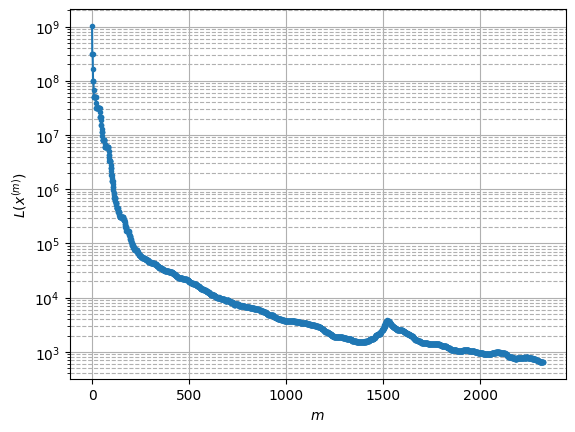

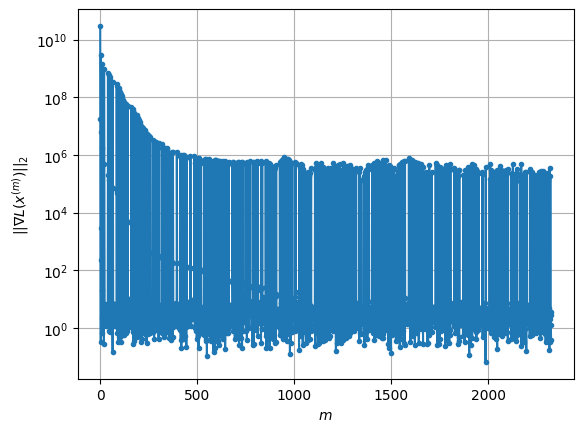

Windows:  88%|████████▊ | 260/296 [1:37:57<07:08, 11.90s/it]


Majorization-Minimization Iteration 1
Before applying the algorithm
Cost function: 662.0324908156441
Gradient norm: 130493.38817090903
Global relative error: 9.747352997418627
Position relative errors: 0.019980587034597524 m, 3.0679409636365502 m, 3.9818630247018953 m, 8.35104751656969 m

Iteration 1
Cost function: 660.7691530696579 (-0.19%)
Gradient norm: 1.4672043511753177 (-100.00%)
Global relative error = 9.743259334093436 (-0.04%)
Position relative errors: 0.018970813213746843 m, 3.0675451346880727 m, 3.9587260069181167 m, 8.357415886128035 m

Iteration 2
Cost function: 660.7691516673976 (-0.00%)
Gradient norm: 2.6327853983225933 (79.44%)
Global relative error = 9.74325933344152 (-0.00%)
Position relative errors: 0.018970815244045865 m, 3.067545134436968 m, 3.9587260072380164 m, 8.35741588530408 m

Iteration 3
Cost function: 660.7691514419769 (-0.00%)
Gradient norm: 4.7415033906266935 (80.09%)
Global relative error = 9.743259333752777 (0.00%)
Position relative errors: 0.018970814

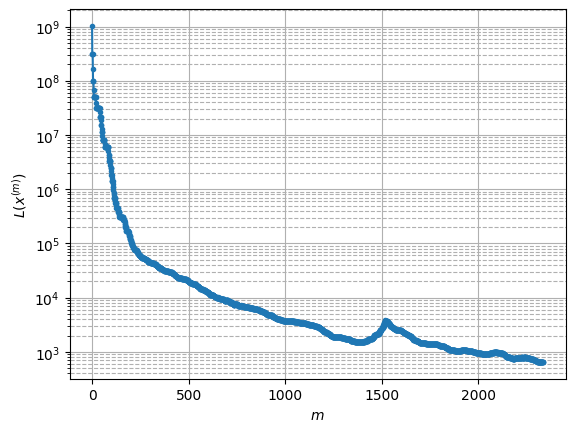

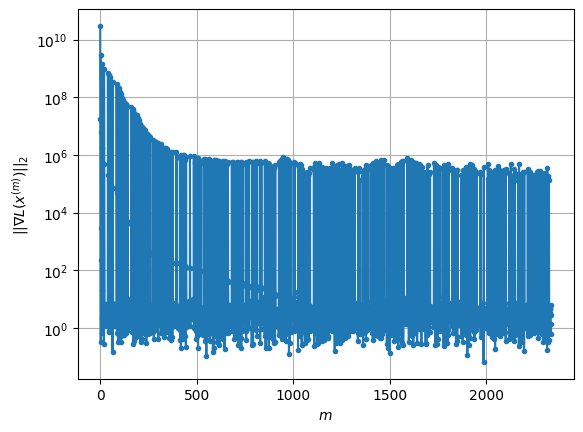

Windows:  88%|████████▊ | 261/296 [1:38:26<09:48, 16.80s/it]


Majorization-Minimization Iteration 1
Before applying the algorithm
Cost function: 665.1238937921487
Gradient norm: 181664.06115347877
Global relative error: 12.378396485731022
Position relative errors: 0.02001140281895213 m, 5.3333359947932815 m, 3.5861772042763826 m, 10.579046885646699 m

Iteration 1
Cost function: 663.9563064620282 (-0.18%)
Gradient norm: 1.2248428453394193 (-100.00%)
Global relative error = 12.357742424941971 (-0.17%)
Position relative errors: 0.025147948575902645 m, 5.329284916125905 m, 3.5558769344291443 m, 10.567152161993603 m

Iteration 2
Cost function: 663.9563033179993 (-0.00%)
Gradient norm: 2.8415088483331776 (131.99%)
Global relative error = 12.357742423731017 (-0.00%)
Position relative errors: 0.02514794757052658 m, 5.329284912947507 m, 3.5558769399939174 m, 10.567152160310258 m

STOP on Iteration 3
Cost function = 663.9563056710198 (0.00%)
Gradient norm = 0.7038269951292789 (-75.23%)
Global relative error = 12.357742423337333 (-0.00%)
Final position rel

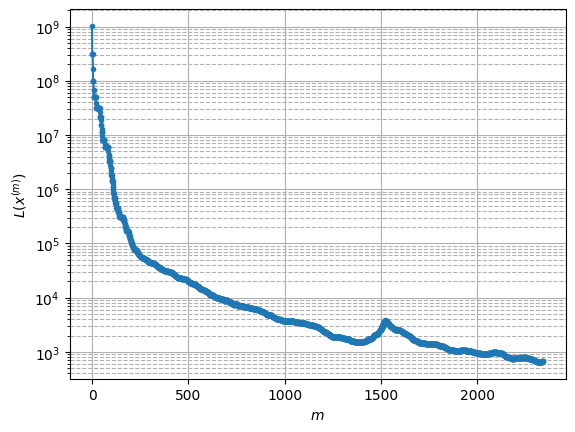

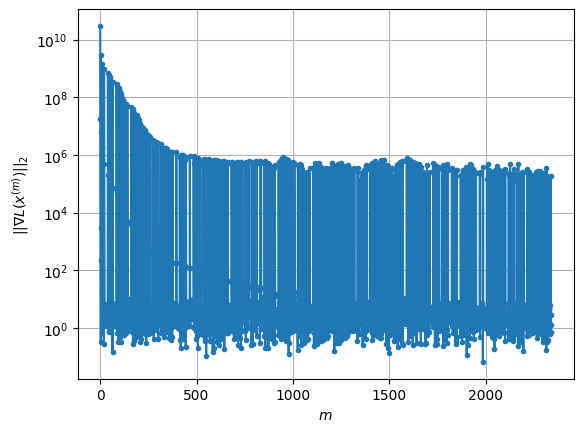

Windows:  89%|████████▊ | 262/296 [1:38:36<08:23, 14.80s/it]


Majorization-Minimization Iteration 1
Before applying the algorithm
Cost function: 679.5717064220709
Gradient norm: 197089.75800584623
Global relative error: 15.182515990655343
Position relative errors: 0.02615717956249498 m, 7.5836876735800365 m, 3.169690468437889 m, 12.765031291154504 m

Iteration 1
Cost function: 678.2614833494381 (-0.19%)
Gradient norm: 2.0043558194105517 (-100.00%)
Global relative error = 15.156209688496684 (-0.17%)
Position relative errors: 0.019257707822591397 m, 7.580801419521692 m, 3.142625804122807 m, 12.742168215226812 m

STOP on Iteration 2
Cost function = 678.2614847180197 (0.00%)
Gradient norm = 0.195886996031415 (-90.23%)
Global relative error = 15.156209685099137 (-0.00%)
Final position relative errors: 0.019257707109913022 m, 7.580801418136643 m, 3.142625804065957 m, 12.742168212024731 m

Majorization-Minimization converged after 1 iterations


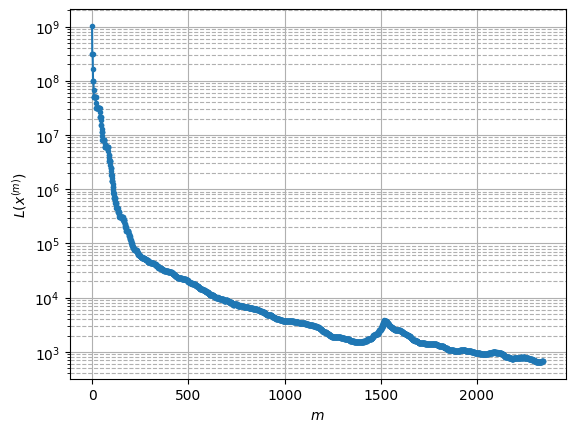

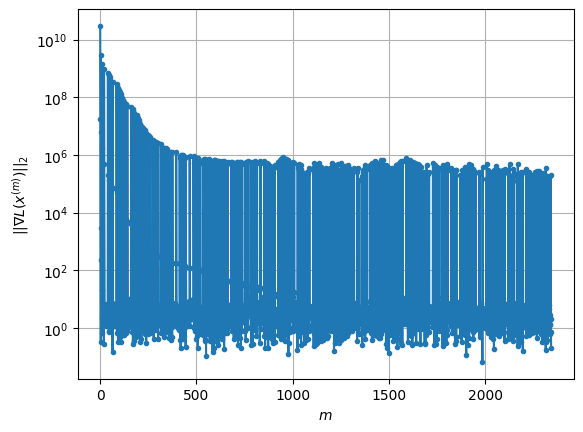

Windows:  89%|████████▉ | 263/296 [1:38:43<06:57, 12.64s/it]


Majorization-Minimization Iteration 1
Before applying the algorithm
Cost function: 684.1126888450635
Gradient norm: 355443.8143778191
Global relative error: 18.04433345808384
Position relative errors: 0.020038735386220023 m, 9.804708229752952 m, 2.7457977774293876 m, 14.897085379412795 m

STOP on Iteration 1
Cost function = 682.6808823390713 (-0.21%)
Gradient norm = 0.5167451491432774 (-100.00%)
Global relative error = 18.012799465104692 (-0.17%)
Final position relative errors: 0.021765754896641645 m, 9.798941551084795 m, 2.7200200362778673 m, 14.867414147920424 m

Majorization-Minimization converged after 1 iterations


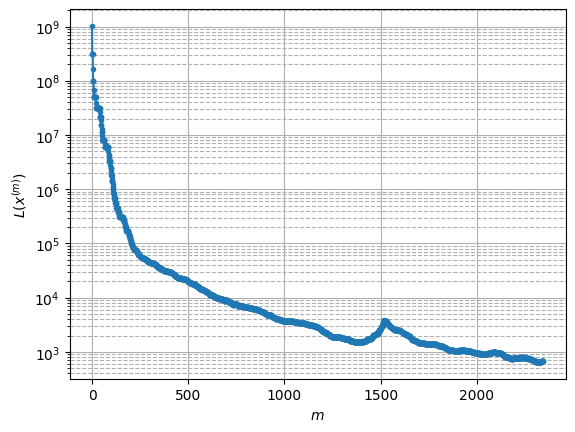

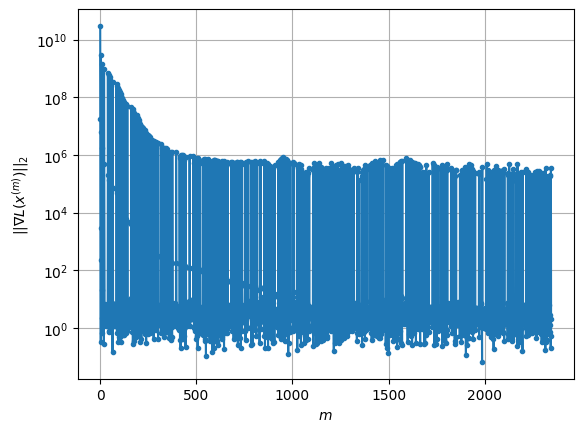

Windows:  89%|████████▉ | 264/296 [1:38:49<05:33, 10.44s/it]


Majorization-Minimization Iteration 1
Before applying the algorithm
Cost function: 688.1728125451681
Gradient norm: 307696.9221331211
Global relative error: 20.898121029736398
Position relative errors: 0.022409337827600927 m, 11.981089981723853 m, 2.3172655567495304 m, 16.965027473432926 m

STOP on Iteration 1
Cost function = 686.659291171873 (-0.22%)
Gradient norm = 0.5188379799224785 (-100.00%)
Global relative error = 20.859990104550917 (-0.18%)
Final position relative errors: 0.03295114172381762 m, 11.972720616627086 m, 2.2776181692290693 m, 16.92932235046029 m

Majorization-Minimization converged after 1 iterations


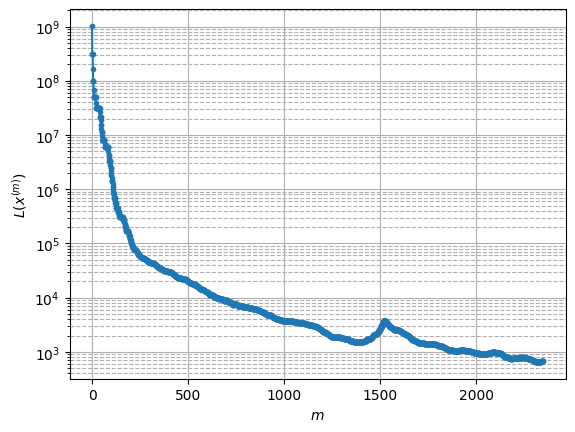

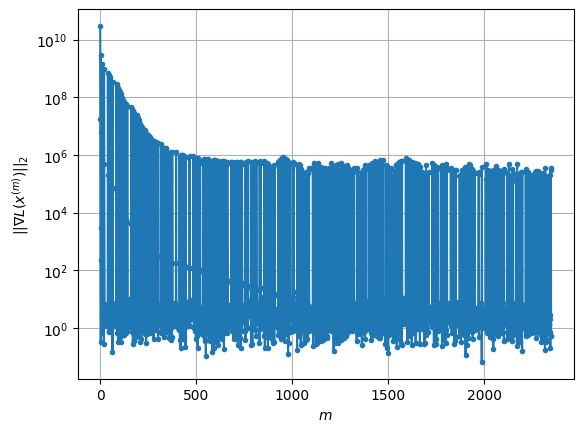

Windows:  90%|████████▉ | 265/296 [1:38:56<04:51,  9.41s/it]


Majorization-Minimization Iteration 1
Before applying the algorithm
Cost function: 706.0172985817094
Gradient norm: 292172.408855736
Global relative error: 23.702603987683876
Position relative errors: 0.03295260609136955 m, 14.102998212737063 m, 1.8733538945569597 m, 18.958004318000658 m

Iteration 1
Cost function: 703.3964058650382 (-0.37%)
Gradient norm: 1.4000691067245798 (-100.00%)
Global relative error = 23.659412400890925 (-0.18%)
Position relative errors: 0.025548988393042635 m, 14.092061896338588 m, 1.8163710335396255 m, 18.91769872421447 m

Iteration 2
Cost function: 703.3964057986207 (-0.00%)
Gradient norm: 2.019231835796975 (44.22%)
Global relative error = 23.65941239536456 (-0.00%)
Position relative errors: 0.025548991040802313 m, 14.092061896738429 m, 1.8163710425983162 m, 18.91769871613175 m

Iteration 3
Cost function: 703.3964047882928 (-0.00%)
Gradient norm: 3.1322678334237644 (55.12%)
Global relative error = 23.659412395292733 (-0.00%)
Position relative errors: 0.0255

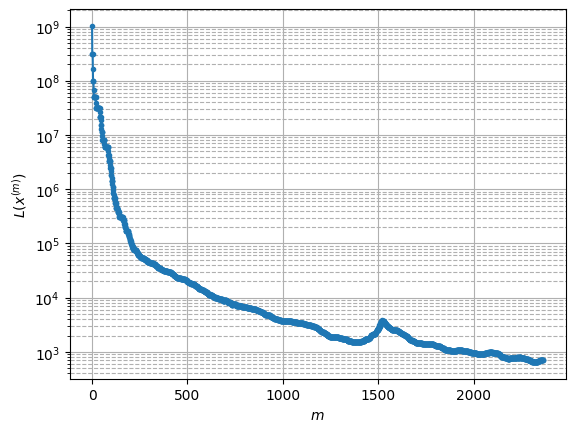

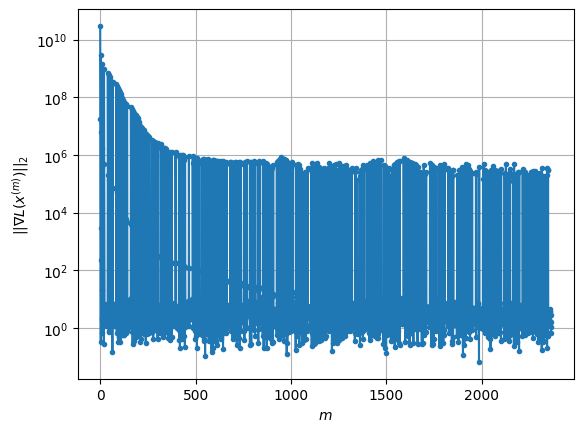

Windows:  90%|████████▉ | 266/296 [1:39:36<09:23, 18.77s/it]


Majorization-Minimization Iteration 1
Before applying the algorithm
Cost function: 708.6406644294266
Gradient norm: 281428.44020693284
Global relative error: 26.431417589242542
Position relative errors: 0.026001010549760683 m, 16.16175376471735 m, 1.4184538808405076 m, 20.86630362440039 m

Iteration 1
Cost function: 706.3246195684308 (-0.33%)
Gradient norm: 3.189005488006141 (-100.00%)
Global relative error = 26.384702708933897 (-0.18%)
Position relative errors: 0.023779479203041267 m, 16.15183773591281 m, 1.3555246655932378 m, 20.818992031175103 m

Iteration 2
Cost function: 706.3246200672855 (0.00%)
Gradient norm: 4.2455044970207725 (33.13%)
Global relative error = 26.38470271093618 (0.00%)
Position relative errors: 0.023779476828388085 m, 16.151837735168098 m, 1.355524680170311 m, 20.81899203334403 m

Iteration 3
Cost function: 706.3246191354647 (-0.00%)
Gradient norm: 4.001582294816752 (-5.75%)
Global relative error = 26.384702710990258 (0.00%)
Position relative errors: 0.02377947

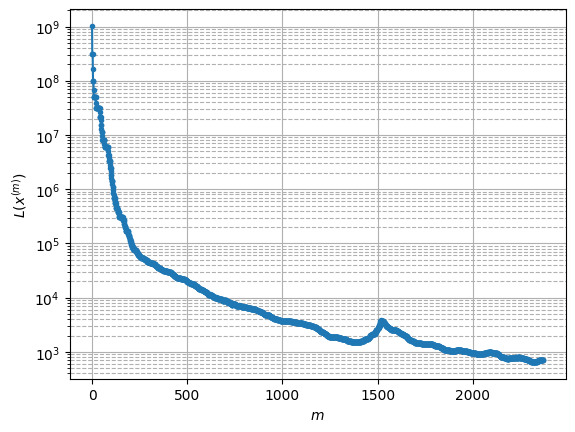

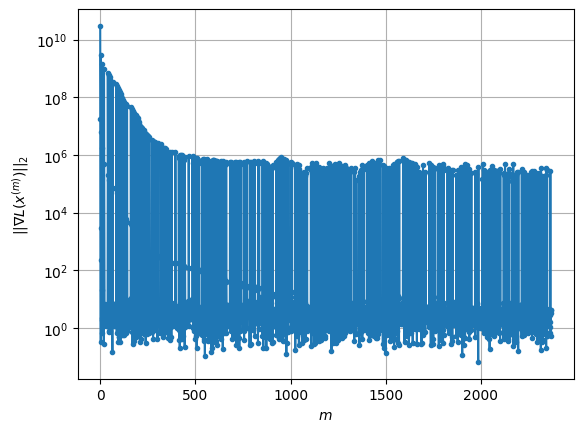

Windows:  90%|█████████ | 267/296 [1:39:48<08:07, 16.81s/it]


Majorization-Minimization Iteration 1
Before applying the algorithm
Cost function: 714.225249926914
Gradient norm: 213868.11857290077
Global relative error: 29.06467264077272
Position relative errors: 0.02422802478275373 m, 18.150954969800505 m, 0.9817938534571922 m, 22.67887718843607 m

Iteration 1
Cost function: 712.3391402764672 (-0.26%)
Gradient norm: 1.0444226999489574 (-100.00%)
Global relative error = 29.018823652887956 (-0.16%)
Position relative errors: 0.023697919717978883 m, 18.13685061076907 m, 0.9136082785055009 m, 22.63425467973877 m

Iteration 2
Cost function: 712.3391415569577 (0.00%)
Gradient norm: 2.090299713557975 (100.14%)
Global relative error = 29.018823652314804 (-0.00%)
Position relative errors: 0.02369791940992972 m, 18.136850607474308 m, 0.913608292015037 m, 22.634254681099065 m

STOP on Iteration 3
Cost function = 712.339140384737 (-0.00%)
Gradient norm = 0.7272555892036525 (-65.21%)
Global relative error = 29.018823651568756 (-0.00%)
Final position relative 

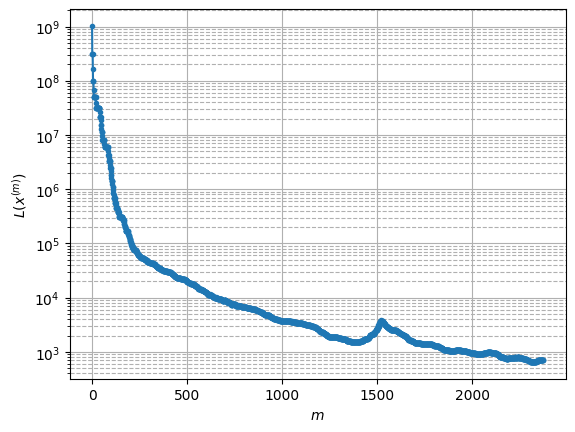

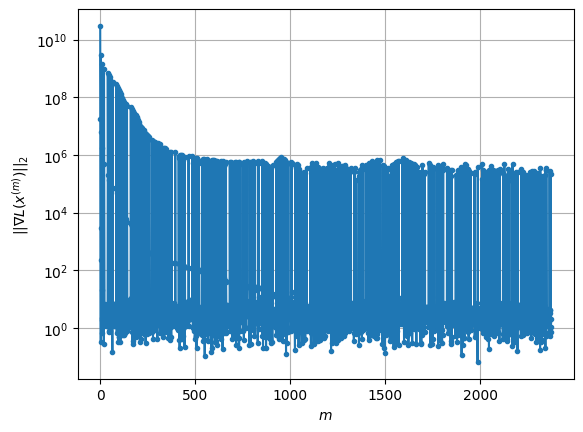

Windows:  91%|█████████ | 268/296 [1:39:58<06:52, 14.75s/it]


Majorization-Minimization Iteration 1
Before applying the algorithm
Cost function: 717.4343375038029
Gradient norm: 306347.31084518606
Global relative error: 31.58846645827587
Position relative errors: 0.024096104036760622 m, 20.056840416960732 m, 0.6279675465328524 m, 24.39585172152395 m

Iteration 1
Cost function: 715.4836598979299 (-0.27%)
Gradient norm: 1.7011267623837119 (-100.00%)
Global relative error = 31.542150755952477 (-0.15%)
Position relative errors: 0.024360612793456905 m, 20.04145957065214 m, 0.5671704471824178 m, 24.350011069730282 m

Iteration 2
Cost function: 715.4836602829362 (0.00%)
Gradient norm: 2.960536475689574 (74.03%)
Global relative error = 31.542150756121213 (0.00%)
Position relative errors: 0.024360609617651845 m, 20.04145956763092 m, 0.5671704561883268 m, 24.350011072228902 m

Iteration 3
Cost function: 715.4836602733162 (-0.00%)
Gradient norm: 6.699997112418153 (126.31%)
Global relative error = 31.542150755965228 (-0.00%)
Position relative errors: 0.0243

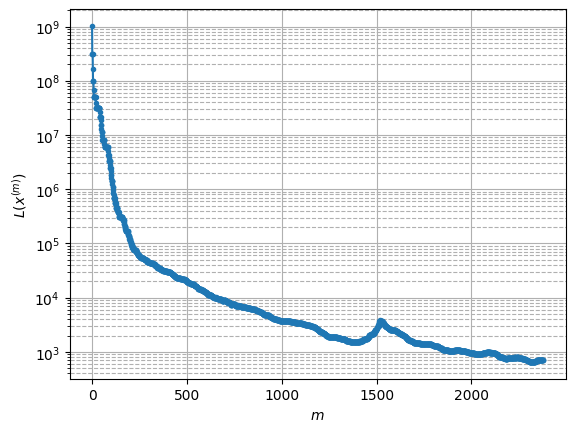

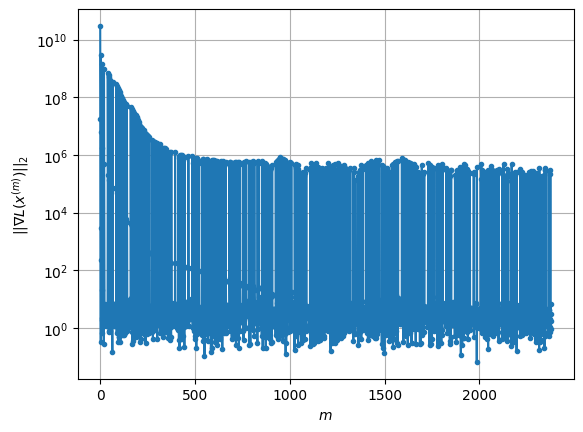

Windows:  91%|█████████ | 269/296 [1:40:11<06:17, 14.00s/it]


Majorization-Minimization Iteration 1
Before applying the algorithm
Cost function: 715.2643518411328
Gradient norm: 232453.23385412098
Global relative error: 33.98621221248278
Position relative errors: 0.024187165959508917 m, 21.873831598237057 m, 0.5694086345743768 m, 26.005223265903492 m

Iteration 1
Cost function: 713.050924786921 (-0.31%)
Gradient norm: 1.0867896600896785 (-100.00%)
Global relative error = 33.938704058749586 (-0.14%)
Position relative errors: 0.022265129502757774 m, 21.857212498072634 m, 0.5460408723447785 m, 25.957611173175287 m

STOP on Iteration 2
Cost function = 713.0509259107183 (0.00%)
Gradient norm = 0.7586287677281696 (-30.20%)
Global relative error = 33.938704061881936 (0.00%)
Final position relative errors: 0.022265128172845237 m, 21.857212495097325 m, 0.5460408834338288 m, 25.957611179543918 m

Majorization-Minimization converged after 1 iterations


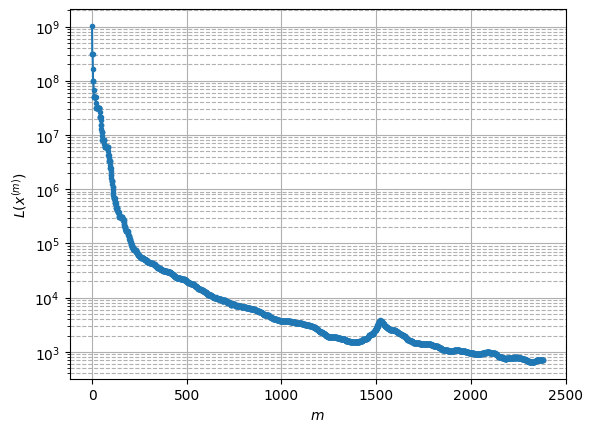

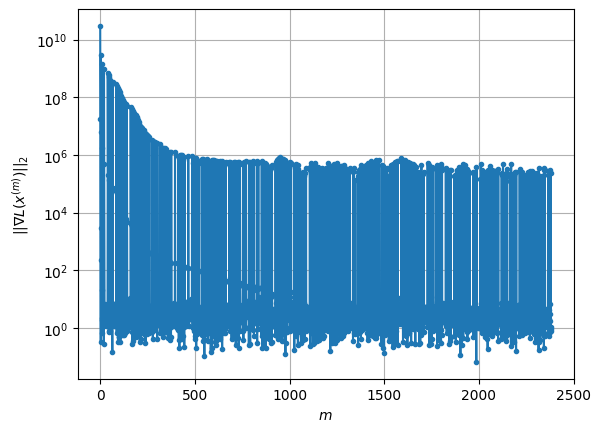

Windows:  91%|█████████ | 270/296 [1:40:18<05:13, 12.05s/it]


Majorization-Minimization Iteration 1
Before applying the algorithm
Cost function: 711.868769805154
Gradient norm: 231858.58658074253
Global relative error: 36.24399885304401
Position relative errors: 0.022071452955776474 m, 23.593975464578712 m, 0.8646442870492853 m, 27.499131135639402 m

Iteration 1
Cost function: 709.8126784657015 (-0.29%)
Gradient norm: 5.247696483813124 (-100.00%)
Global relative error = 36.196820394341785 (-0.13%)
Position relative errors: 0.020511492388381236 m, 23.575764362034594 m, 0.8517126887408767 m, 27.452975138934097 m

Iteration 2
Cost function: 709.812678892128 (0.00%)
Gradient norm: 2.521222275247086 (-51.96%)
Global relative error = 36.19682039565372 (0.00%)
Position relative errors: 0.020511490511952793 m, 23.57576435921445 m, 0.851712697489164 m, 27.45297514281571 m

Iteration 3
Cost function: 709.8126804381974 (0.00%)
Gradient norm: 2.5256203423412904 (0.17%)
Global relative error = 36.19682039574543 (0.00%)
Position relative errors: 0.02051149236

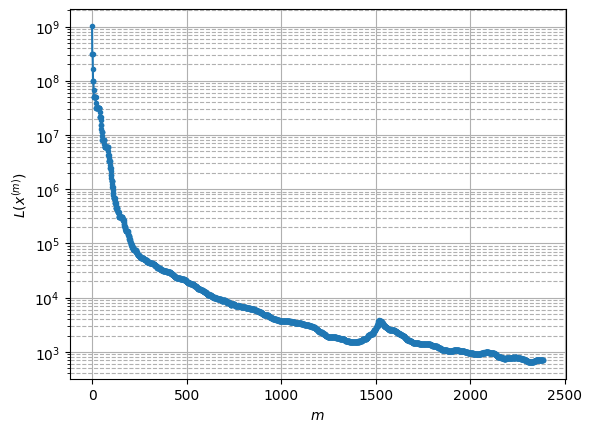

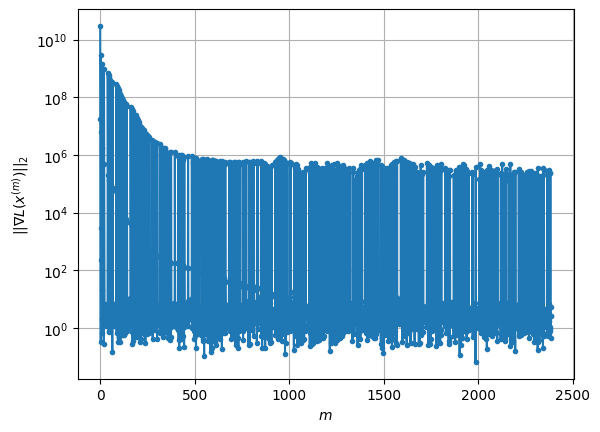

Windows:  92%|█████████▏| 271/296 [1:40:30<05:02, 12.08s/it]


Majorization-Minimization Iteration 1
Before applying the algorithm
Cost function: 711.6413029556084
Gradient norm: 260991.83306318504
Global relative error: 38.351439629283036
Position relative errors: 0.020490237915434212 m, 25.209615520223075 m, 1.2714971208203056 m, 28.873687240525996 m

Iteration 1
Cost function: 709.7457829008773 (-0.27%)
Gradient norm: 4.122215992448932 (-100.00%)
Global relative error = 38.3055934396098 (-0.12%)
Position relative errors: 0.02027994950657201 m, 25.189970876168 m, 1.276524343366303 m, 28.82971843455312 m

Iteration 2
Cost function: 709.7457795746334 (-0.00%)
Gradient norm: 6.455173201616657 (56.59%)
Global relative error = 38.30559344334546 (0.00%)
Position relative errors: 0.020279947755438822 m, 25.18997087268918 m, 1.2765243423616477 m, 28.82971844260195 m

Iteration 3
Cost function: 709.7457814228206 (0.00%)
Gradient norm: 2.8504538948666105 (-55.84%)
Global relative error = 38.3055934435634 (0.00%)
Position relative errors: 0.02027994874513

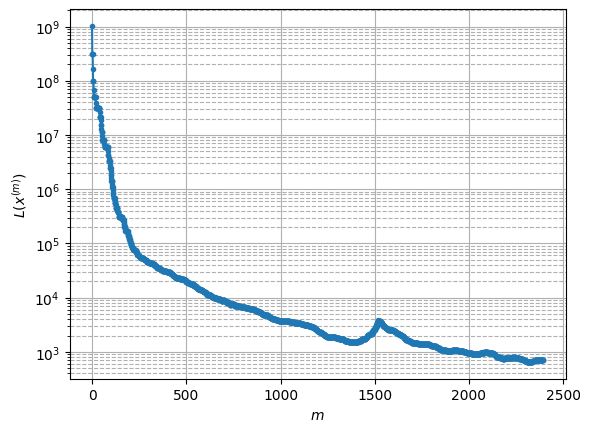

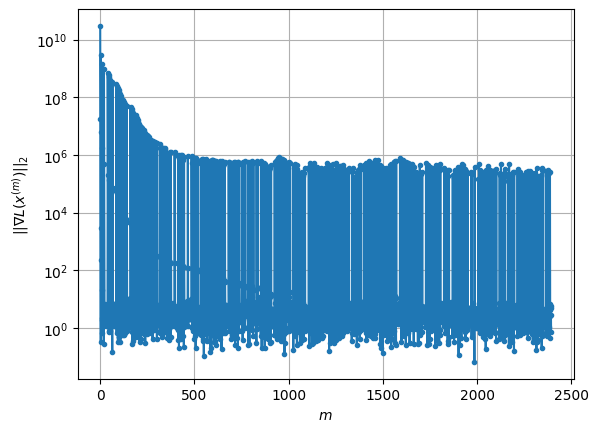

Windows:  92%|█████████▏| 272/296 [1:40:47<05:22, 13.42s/it]


Majorization-Minimization Iteration 1
Before applying the algorithm
Cost function: 708.1684716798464
Gradient norm: 225521.30864018403
Global relative error: 40.29878610768393
Position relative errors: 0.020109130460374384 m, 26.71380584654903 m, 1.7164266270356148 m, 30.123365333183493 m

STOP on Iteration 1
Cost function = 706.3603144654018 (-0.26%)
Gradient norm = 0.42062755688006864 (-100.00%)
Global relative error = 40.25402188778548 (-0.11%)
Final position relative errors: 0.018477186047762325 m, 26.695595597441834 m, 1.7318232071025617 m, 30.078743777548972 m

Majorization-Minimization converged after 1 iterations


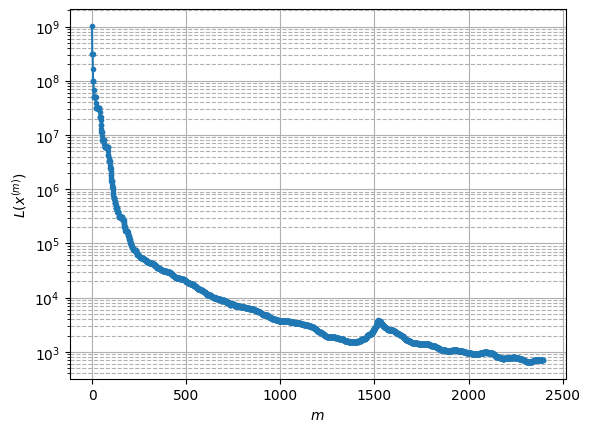

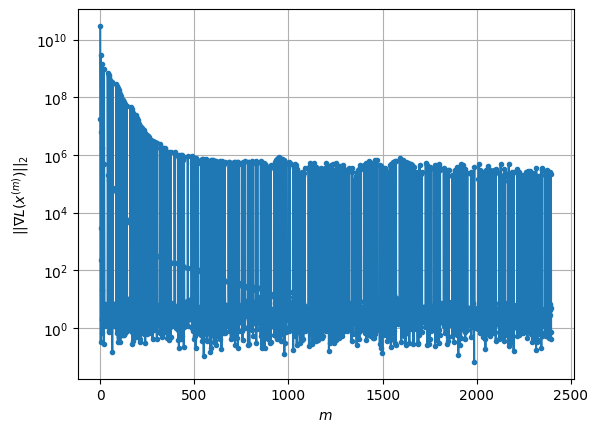

Windows:  92%|█████████▏| 273/296 [1:40:52<04:12, 10.99s/it]


Majorization-Minimization Iteration 1
Before applying the algorithm
Cost function: 710.899131336087
Gradient norm: 312240.9195622562
Global relative error: 42.07618384444536
Position relative errors: 0.018084981994232557 m, 28.102744563556264 m, 2.1720915003868306 m, 31.239747035812048 m

Iteration 1
Cost function: 709.1783637114673 (-0.24%)
Gradient norm: 2.270065863807485 (-100.00%)
Global relative error = 42.032166647489646 (-0.10%)
Position relative errors: 0.015581134123665772 m, 28.0838487493005 m, 2.190567415923787 m, 31.19616569206888 m

Iteration 2
Cost function: 709.1783641376572 (0.00%)
Gradient norm: 2.1669173277621967 (-4.54%)
Global relative error = 42.03216664847847 (0.00%)
Position relative errors: 0.015581134022748343 m, 28.08384874854404 m, 2.190567413431338 m, 31.19616569425724 m

Iteration 3
Cost function: 709.178363804803 (-0.00%)
Gradient norm: 2.3438850650613694 (8.17%)
Global relative error = 42.032166648599805 (0.00%)
Position relative errors: 0.01558113458869

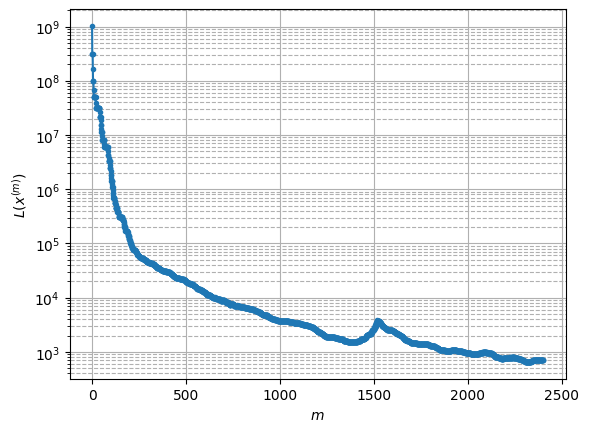

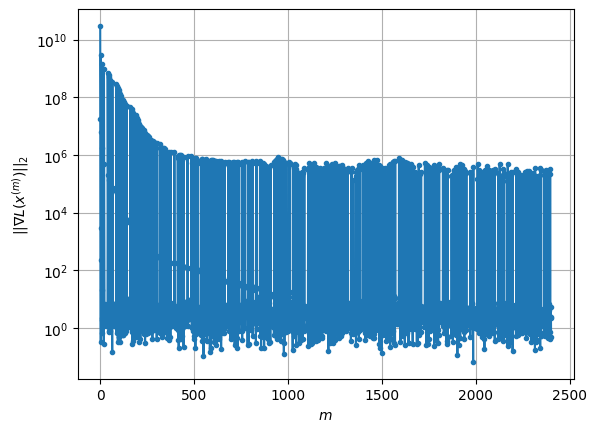

Windows:  93%|█████████▎| 274/296 [1:41:08<04:34, 12.48s/it]


Majorization-Minimization Iteration 1
Before applying the algorithm
Cost function: 706.1132131298577
Gradient norm: 262436.0078829079
Global relative error: 43.674697283284694
Position relative errors: 0.015473158450246516 m, 29.36821955281401 m, 2.624641185800411 m, 32.219515250498404 m

Iteration 1
Cost function: 703.8662493494845 (-0.32%)
Gradient norm: 8.472445079058218 (-100.00%)
Global relative error = 43.63084807011306 (-0.10%)
Position relative errors: 0.022532879888666067 m, 29.350068975744225 m, 2.645791792031529 m, 32.17488017412933 m

Iteration 2
Cost function: 703.8662471422987 (-0.00%)
Gradient norm: 14.1492590092102 (67.00%)
Global relative error = 43.630848073006376 (0.00%)
Position relative errors: 0.022532879143662293 m, 29.35006897464846 m, 2.6457917903437114 m, 32.17488017919169 m

Iteration 3
Cost function: 703.8662471486725 (0.00%)
Gradient norm: 6.986969963065193 (-50.62%)
Global relative error = 43.63084807347912 (0.00%)
Position relative errors: 0.022532880539

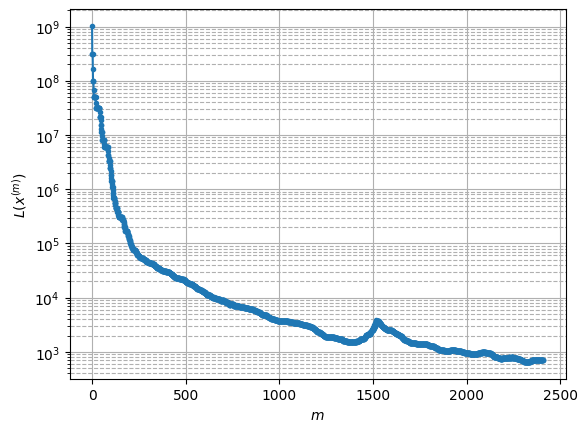

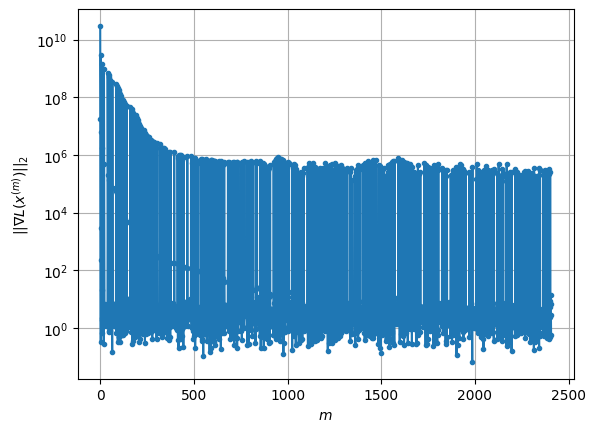

Windows:  93%|█████████▎| 275/296 [1:41:22<04:33, 13.03s/it]


Majorization-Minimization Iteration 1
Before applying the algorithm
Cost function: 694.2836675262987
Gradient norm: 270833.38782309974
Global relative error: 45.086259194771586
Position relative errors: 0.022419847337309416 m, 30.506055407646237 m, 3.069764889770782 m, 33.05641890819205 m

Iteration 1
Cost function: 691.978495812887 (-0.33%)
Gradient norm: 5.6895294785310035 (-100.00%)
Global relative error = 45.044348505844106 (-0.09%)
Position relative errors: 0.01934722580721898 m, 30.48694719109501 m, 3.0924332106038657 m, 33.014774043286685 m

Iteration 2
Cost function: 691.9784972398854 (0.00%)
Gradient norm: 1.6853446730826724 (-70.38%)
Global relative error = 45.044348512195114 (0.00%)
Position relative errors: 0.01934722306585801 m, 30.486947187710882 m, 3.0924332077272156 m, 33.01477405534787 m

Iteration 3
Cost function: 691.9784970128537 (-0.00%)
Gradient norm: 1.0239130025922698 (-39.25%)
Global relative error = 45.04434851220059 (0.00%)
Position relative errors: 0.019347

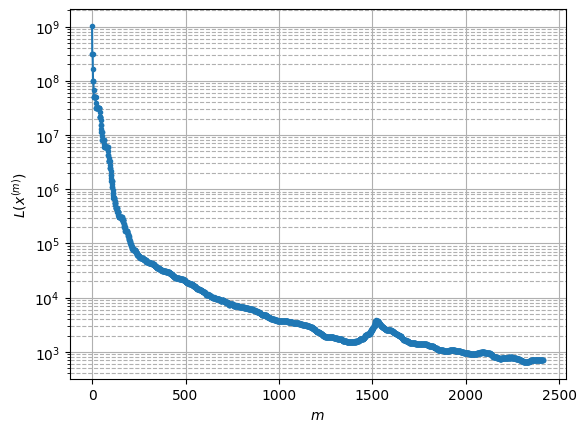

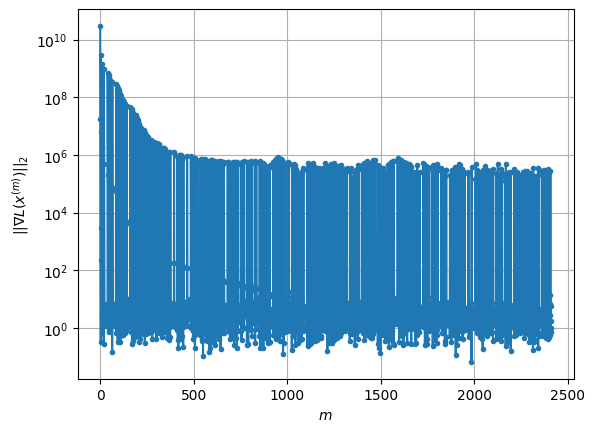

Windows:  93%|█████████▎| 276/296 [1:41:35<04:15, 12.79s/it]


Majorization-Minimization Iteration 1
Before applying the algorithm
Cost function: 677.4301186578559
Gradient norm: 230606.6452360324
Global relative error: 46.30602364421102
Position relative errors: 0.01919730232740768 m, 31.509553374825398 m, 3.503522876450918 m, 33.75085791642322 m

Iteration 1
Cost function: 674.6804521767543 (-0.41%)
Gradient norm: 8.864657170706625 (-100.00%)
Global relative error = 46.2663306794208 (-0.09%)
Position relative errors: 0.0189894955373984 m, 31.490293603145677 m, 3.5265168704278835 m, 33.7119809768573 m

Iteration 2
Cost function: 674.6804526262491 (0.00%)
Gradient norm: 8.922062654971185 (0.65%)
Global relative error = 46.26633068750922 (0.00%)
Position relative errors: 0.01898949418414744 m, 31.490293600430103 m, 3.526516868944889 m, 33.711980990650346 m

STOP on Iteration 3
Cost function = 674.6804537628819 (0.00%)
Gradient norm = 0.6774546123127888 (-92.41%)
Global relative error = 46.26633068708289 (-0.00%)
Final position relative errors: 0.0

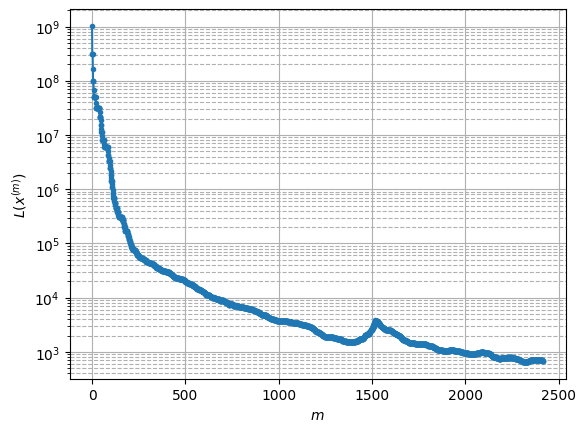

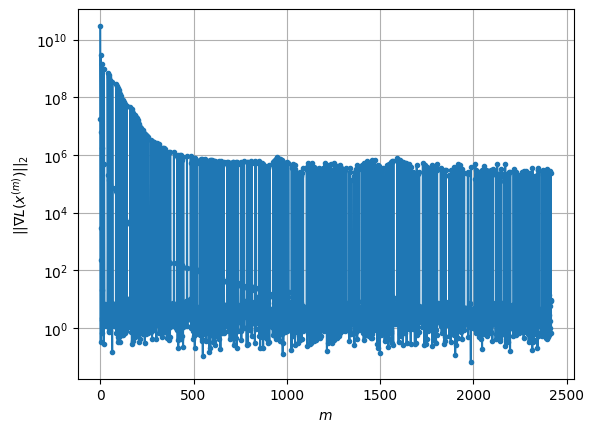

Windows:  94%|█████████▎| 277/296 [1:41:44<03:46, 11.91s/it]


Majorization-Minimization Iteration 1
Before applying the algorithm
Cost function: 666.8546787881471
Gradient norm: 209481.66291955902
Global relative error: 47.32860069172186
Position relative errors: 0.018845277368145917 m, 32.37511598058597 m, 3.9225032763158936 m, 34.299586328136556 m

Iteration 1
Cost function: 664.1726837282378 (-0.40%)
Gradient norm: 1.3495179728535438 (-100.00%)
Global relative error = 47.291266496353806 (-0.08%)
Position relative errors: 0.024763901575389602 m, 32.35479773065304 m, 3.9431010894424645 m, 34.26487986576674 m

STOP on Iteration 2
Cost function = 664.1726835566581 (-0.00%)
Gradient norm = 0.8352859292424281 (-38.10%)
Global relative error = 47.29126650377282 (0.00%)
Final position relative errors: 0.024763898317976346 m, 32.35479772827651 m, 3.9431010850065915 m, 34.26487987876309 m

Majorization-Minimization converged after 1 iterations


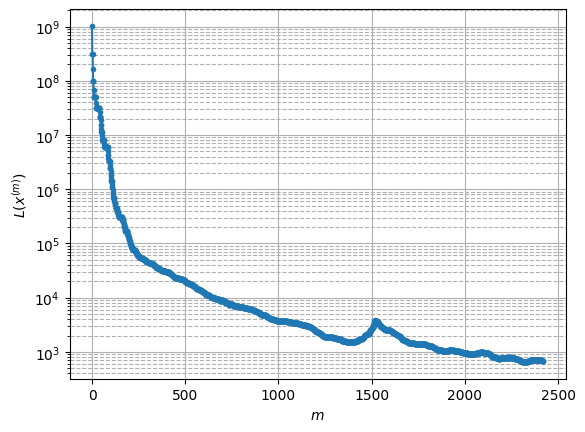

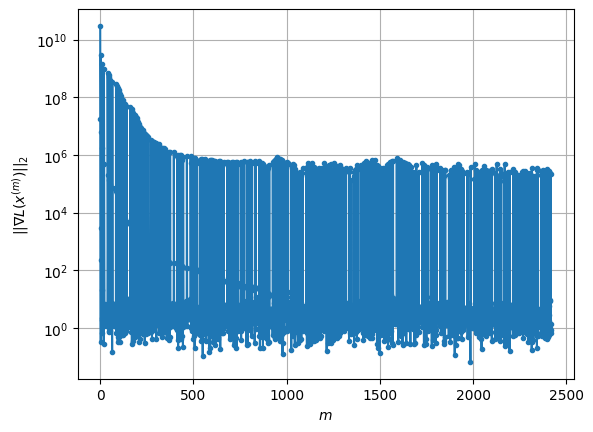

Windows:  94%|█████████▍| 278/296 [1:41:52<03:09, 10.52s/it]


Majorization-Minimization Iteration 1
Before applying the algorithm
Cost function: 662.6273878416224
Gradient norm: 136432.79771961123
Global relative error: 48.14939026066473
Position relative errors: 0.024525434942609132 m, 33.098049295674905 m, 4.3218848439255435 m, 34.70163433860887 m

STOP on Iteration 1
Cost function = 661.2737574072605 (-0.20%)
Gradient norm = 0.2666284839208873 (-100.00%)
Global relative error = 48.11332932012495 (-0.07%)
Final position relative errors: 0.01923891277747438 m, 33.07909473398385 m, 4.342347373200291 m, 34.66712274945188 m

Majorization-Minimization converged after 1 iterations


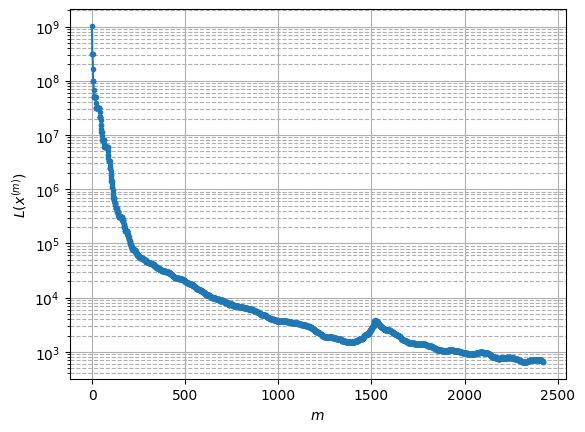

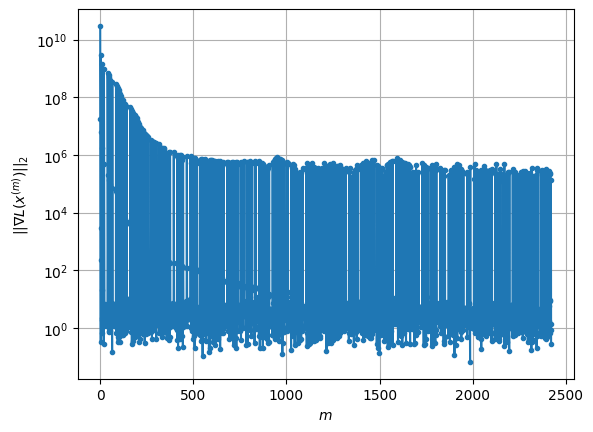

Windows:  94%|█████████▍| 279/296 [1:41:57<02:32,  8.98s/it]


Majorization-Minimization Iteration 1
Before applying the algorithm
Cost function: 660.5833956704845
Gradient norm: 134629.03574334588
Global relative error: 48.76364602926646
Position relative errors: 0.019099991259753167 m, 33.67758653749955 m, 4.70192318946521 m, 34.95146305830615 m

Iteration 1
Cost function: 659.2905395874661 (-0.20%)
Gradient norm: 3.2738482929072106 (-100.00%)
Global relative error = 48.728637647515974 (-0.07%)
Position relative errors: 0.019440685558626224 m, 33.65842175948883 m, 4.7211021362612 m, 34.918497471953856 m

Iteration 2
Cost function: 659.2905407084592 (0.00%)
Gradient norm: 4.439438637939592 (35.60%)
Global relative error = 48.72863765005299 (0.00%)
Position relative errors: 0.019440682744427017 m, 33.658421758326284 m, 4.721102134707154 m, 34.91849747682654 m

Iteration 3
Cost function: 659.2905400757662 (-0.00%)
Gradient norm: 3.8843271642652435 (-12.50%)
Global relative error = 48.728637650484565 (0.00%)
Position relative errors: 0.019440686283

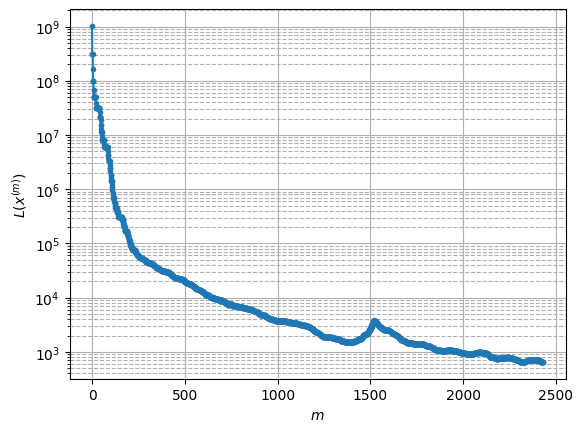

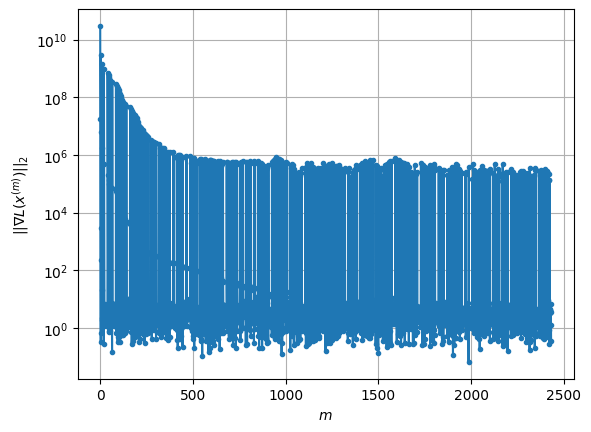

Windows:  95%|█████████▍| 280/296 [1:42:21<03:33, 13.35s/it]


Majorization-Minimization Iteration 1
Before applying the algorithm
Cost function: 651.1747104339122
Gradient norm: 161060.56006317513
Global relative error: 49.16844727117927
Position relative errors: 0.018825513419591582 m, 34.10965246277294 m, 5.0597459438150825 m, 35.04948447930234 m

Iteration 1
Cost function: 649.6144796450241 (-0.24%)
Gradient norm: 3.452557742002853 (-100.00%)
Global relative error = 49.135148576465824 (-0.07%)
Position relative errors: 0.015113857936546647 m, 34.091298529349224 m, 5.07816892958663 m, 35.01796812858834 m

Iteration 2
Cost function: 649.6144806903476 (0.00%)
Gradient norm: 1.4955296222360308 (-56.68%)
Global relative error = 49.13514858199982 (0.00%)
Position relative errors: 0.015113856652293473 m, 34.09129853034376 m, 5.078168927037609 m, 35.01796813575532 m

Iteration 3
Cost function: 649.6144783159626 (-0.00%)
Gradient norm: 4.752976190502305 (217.81%)
Global relative error = 49.13514858274208 (0.00%)
Position relative errors: 0.01511385626

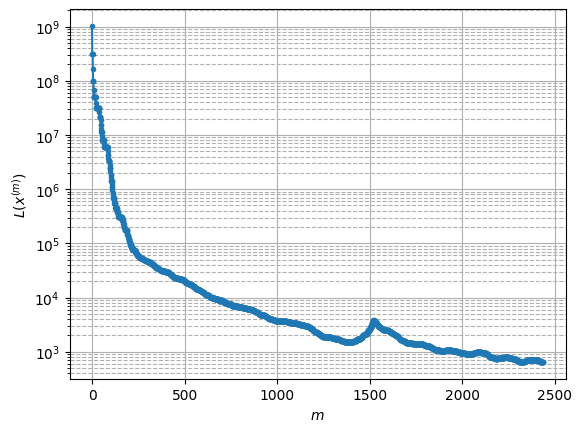

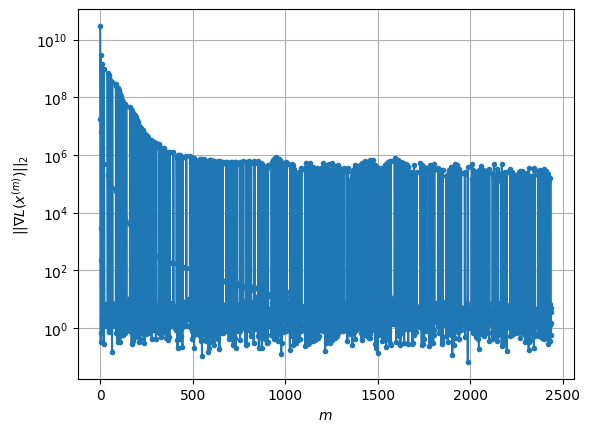

Windows:  95%|█████████▍| 281/296 [1:42:33<03:14, 12.94s/it]


Majorization-Minimization Iteration 1
Before applying the algorithm
Cost function: 655.0627337103914
Gradient norm: 191526.17528426836
Global relative error: 49.362695203912224
Position relative errors: 0.015006808125398442 m, 34.39337619736102 m, 5.3940186160871795 m, 34.995366072439346 m

Iteration 1
Cost function: 653.8754893921142 (-0.18%)
Gradient norm: 2.3565436825524833 (-100.00%)
Global relative error = 49.32996643339733 (-0.07%)
Position relative errors: 0.015155966276057684 m, 34.37534363920071 m, 5.410228422253743 m, 34.9644175383076 m

STOP on Iteration 2
Cost function = 653.8754891198287 (-0.00%)
Gradient norm = 0.6656477871208385 (-71.75%)
Global relative error = 49.32996643961224 (0.00%)
Final position relative errors: 0.015155966794139221 m, 34.37534363886809 m, 5.410228421529113 m, 34.96441754751489 m

Majorization-Minimization converged after 1 iterations


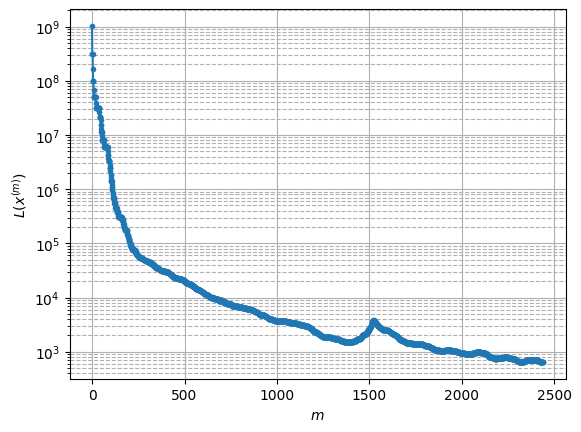

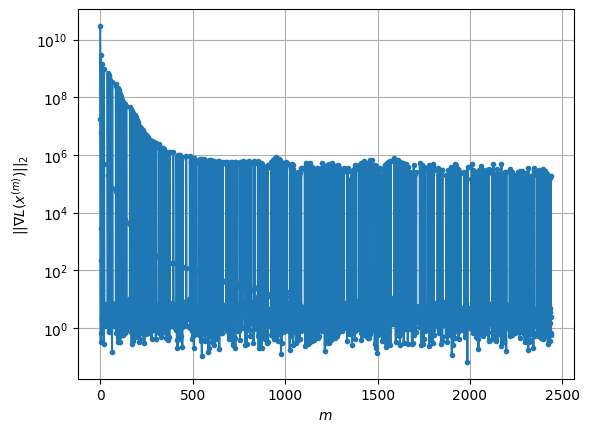

Windows:  95%|█████████▌| 282/296 [1:42:40<02:38, 11.30s/it]


Majorization-Minimization Iteration 1
Before applying the algorithm
Cost function: 653.610313444727
Gradient norm: 183253.49574911493
Global relative error: 49.344583739370854
Position relative errors: 0.015118896043930165 m, 34.52706936897364 m, 5.7018708279723045 m, 34.78876003167701 m

Iteration 1
Cost function: 652.7184005282548 (-0.14%)
Gradient norm: 5.25983179747738 (-100.00%)
Global relative error = 49.312458982751764 (-0.07%)
Position relative errors: 0.011277242470043393 m, 34.51019745929997 m, 5.717748061953648 m, 34.757331185671816 m

Iteration 2
Cost function: 652.718400086571 (-0.00%)
Gradient norm: 2.750693008704468 (-47.70%)
Global relative error = 49.312458986497056 (0.00%)
Position relative errors: 0.011277246498170653 m, 34.51019745896298 m, 5.71774806235787 m, 34.757331191252284 m

STOP on Iteration 3
Cost function = 652.7184003802372 (0.00%)
Gradient norm = 0.8863747041368341 (-67.78%)
Global relative error = 49.312458986561055 (0.00%)
Final position relative erro

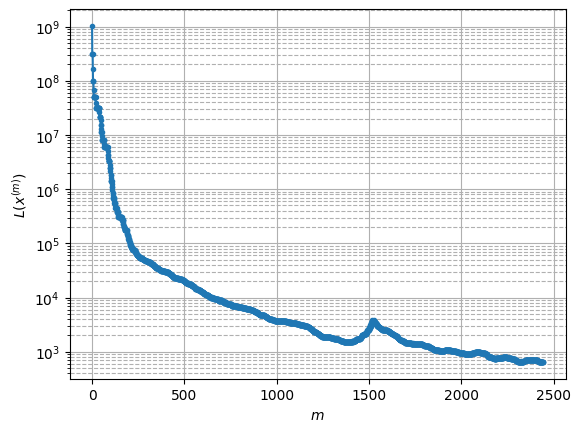

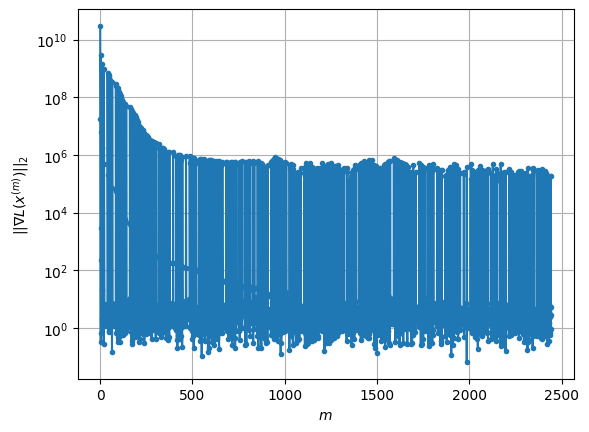

Windows:  96%|█████████▌| 283/296 [1:42:51<02:25, 11.18s/it]


Majorization-Minimization Iteration 1
Before applying the algorithm
Cost function: 652.2903126788652
Gradient norm: 333561.3547220542
Global relative error: 49.11439939975059
Position relative errors: 0.01141912343235001 m, 34.510975088547525 m, 5.983547547915164 m, 34.42983866475778 m

Iteration 1
Cost function: 650.9279316487163 (-0.21%)
Gradient norm: 3.551840225010157 (-100.00%)
Global relative error = 49.08363980431071 (-0.06%)
Position relative errors: 0.007899147313153927 m, 34.49651652872818 m, 5.998507201440363 m, 34.39784627414336 m

Iteration 2
Cost function: 650.9279310953623 (-0.00%)
Gradient norm: 7.614636376084421 (114.39%)
Global relative error = 49.08363980909247 (0.00%)
Position relative errors: 0.00789914379492372 m, 34.49651652835213 m, 5.9985072002431465 m, 34.39784628155336 m

Iteration 3
Cost function: 650.9279311532368 (0.00%)
Gradient norm: 2.603083696660628 (-65.81%)
Global relative error = 49.08363980888273 (-0.00%)
Position relative errors: 0.00789915069420

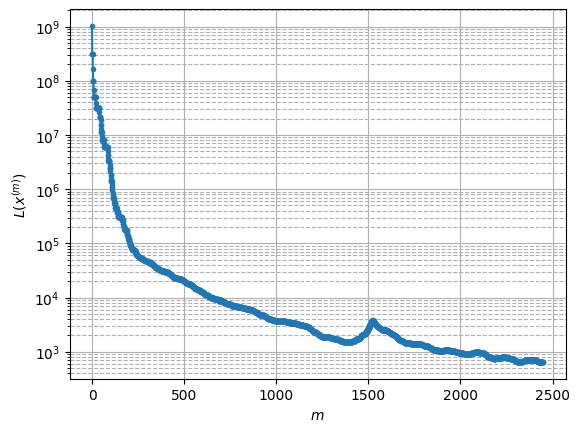

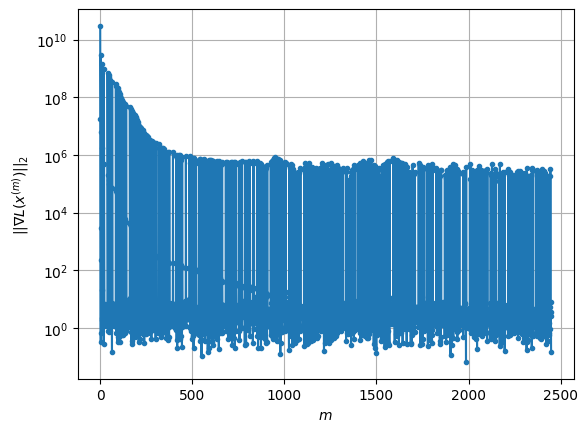

Windows:  96%|█████████▌| 284/296 [1:43:04<02:18, 11.58s/it]


Majorization-Minimization Iteration 1
Before applying the algorithm
Cost function: 644.785265762961
Gradient norm: 215798.33026289096
Global relative error: 48.674088484254035
Position relative errors: 0.008084013143641985 m, 34.34638147318283 m, 6.237050622905559 m, 33.92037721630386 m

Iteration 1
Cost function: 642.9276898964454 (-0.29%)
Gradient norm: 3.5163146345634386 (-100.00%)
Global relative error = 48.645142835787425 (-0.06%)
Position relative errors: 0.012208030625687991 m, 34.334390444116785 m, 6.251328568237689 m, 33.88834878888647 m

Iteration 2
Cost function: 642.9276891079387 (-0.00%)
Gradient norm: 4.422419381493059 (25.77%)
Global relative error = 48.645142846004546 (0.00%)
Position relative errors: 0.012208027365277136 m, 34.33439044699564 m, 6.251328568161499 m, 33.88834880065116 m

STOP on Iteration 3
Cost function = 642.9276887231675 (-0.00%)
Gradient norm = 0.5347239258719341 (-87.91%)
Global relative error = 48.645142845955235 (-0.00%)
Final position relative e

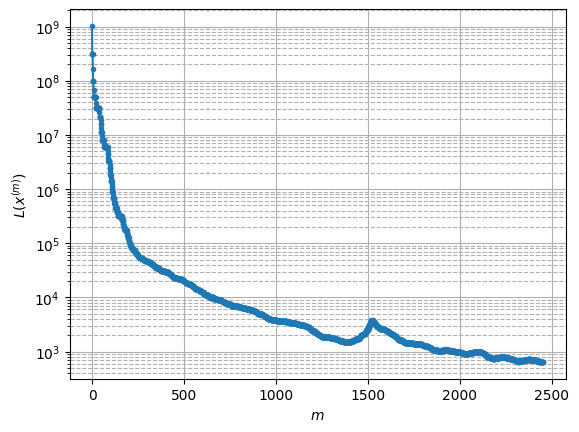

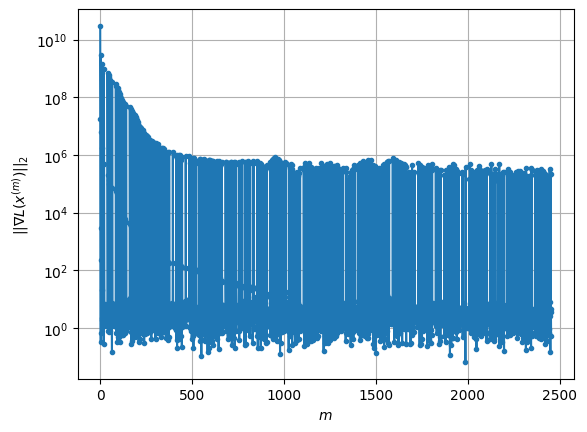

Windows:  96%|█████████▋| 285/296 [1:43:13<02:01, 11.08s/it]


Majorization-Minimization Iteration 1
Before applying the algorithm
Cost function: 647.1695610505974
Gradient norm: 141048.06154070163
Global relative error: 48.02624384001737
Position relative errors: 0.012714864114226915 m, 34.03405890997943 m, 6.461307740691082 m, 33.263404614732856 m

Iteration 1
Cost function: 646.0619808176531 (-0.17%)
Gradient norm: 1.7933439898683274 (-100.00%)
Global relative error = 47.997625100020684 (-0.06%)
Position relative errors: 0.013073280425574287 m, 34.02252959450577 m, 6.4725330081076216 m, 33.23169354505606 m

STOP on Iteration 2
Cost function = 646.0619785875014 (-0.00%)
Gradient norm = 0.745389252551396 (-58.44%)
Global relative error = 47.99762510592797 (0.00%)
Final position relative errors: 0.013073278856818266 m, 34.02252959533198 m, 6.4725330080824905 m, 33.23169355274778 m

Majorization-Minimization converged after 1 iterations


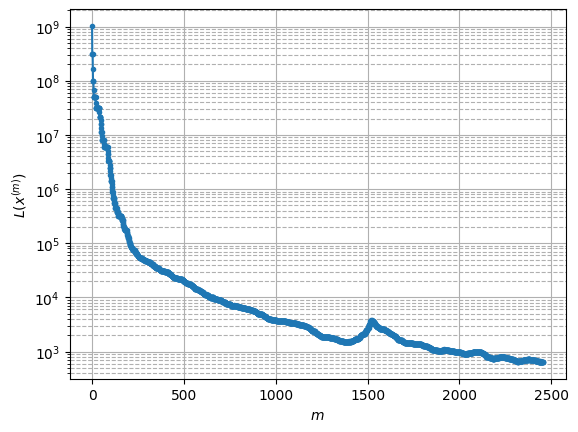

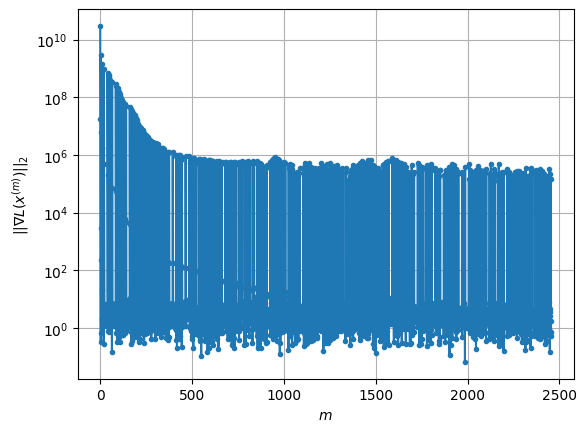

Windows:  97%|█████████▋| 286/296 [1:43:21<01:39,  9.96s/it]


Majorization-Minimization Iteration 1
Before applying the algorithm
Cost function: 644.035055015978
Gradient norm: 154679.7922735611
Global relative error: 47.17259411072566
Position relative errors: 0.013918909724613333 m, 33.57349492054092 m, 6.653005685050297 m, 32.462457011093235 m

Iteration 1
Cost function: 642.5454303415177 (-0.23%)
Gradient norm: 2.2721460624627294 (-100.00%)
Global relative error = 47.14603379992655 (-0.06%)
Position relative errors: 0.016772673548656004 m, 33.563327654149255 m, 6.664638457902729 m, 32.431983799961245 m

Iteration 2
Cost function: 642.545429522386 (-0.00%)
Gradient norm: 1.9860166933448407 (-12.59%)
Global relative error = 47.146033803719355 (0.00%)
Position relative errors: 0.01677266934171714 m, 33.563327653225315 m, 6.664638457642746 m, 32.43198380648657 m

STOP on Iteration 3
Cost function = 642.5454301142886 (0.00%)
Gradient norm = 0.9789455757765059 (-50.71%)
Global relative error = 47.14603380338221 (-0.00%)
Final position relative err

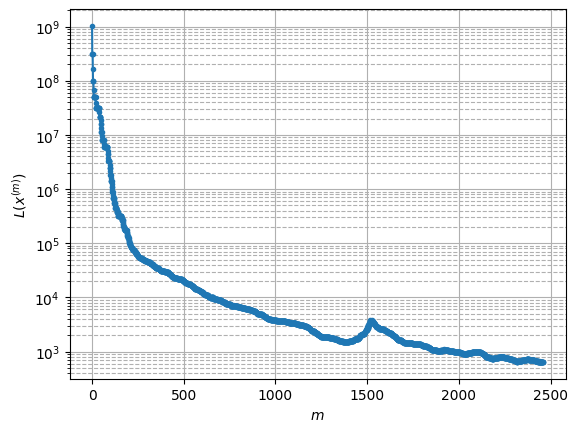

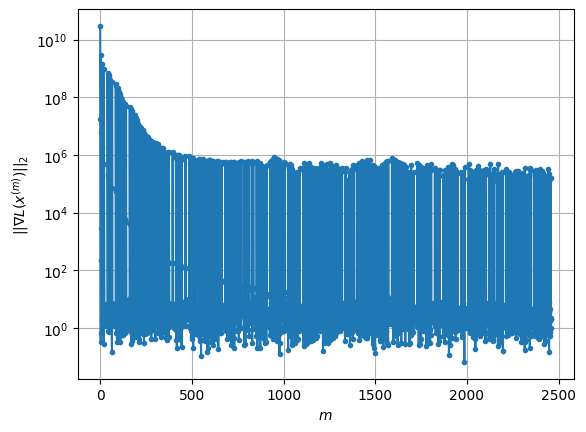

Windows:  97%|█████████▋| 287/296 [1:43:31<01:29,  9.90s/it]


Majorization-Minimization Iteration 1
Before applying the algorithm
Cost function: 641.066668676717
Gradient norm: 197890.41506300925
Global relative error: 46.11887930828805
Position relative errors: 0.017772024762918465 m, 32.96766426379033 m, 6.8144943795440005 m, 31.522152466856973 m

STOP on Iteration 1
Cost function = 640.1967631213181 (-0.14%)
Gradient norm = 0.9364723194166308 (-100.00%)
Global relative error = 46.09238541819205 (-0.06%)
Final position relative errors: 0.0168004403694813 m, 32.95814757416537 m, 6.8223314441568235 m, 31.491643632067582 m

Majorization-Minimization converged after 1 iterations


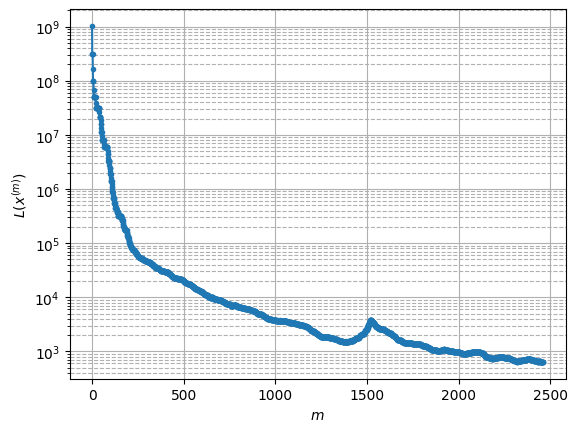

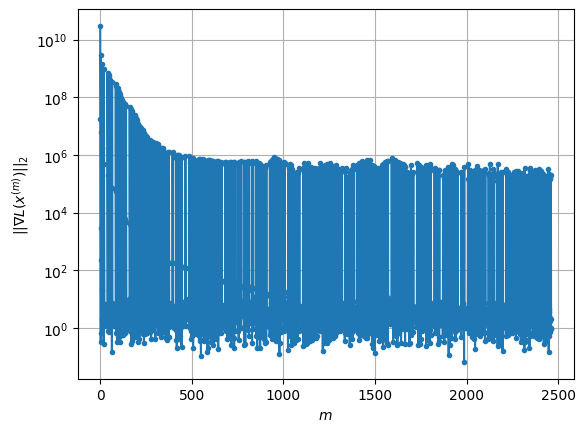

Windows:  97%|█████████▋| 288/296 [1:43:36<01:08,  8.50s/it]


Majorization-Minimization Iteration 1
Before applying the algorithm
Cost function: 649.8323733214022
Gradient norm: 310368.7328892629
Global relative error: 44.86824178833601
Position relative errors: 0.017901739892060953 m, 32.218624620087695 m, 6.940920010329633 m, 30.4457242902967 m

Iteration 1
Cost function: 648.6156406080964 (-0.19%)
Gradient norm: 5.085080632744361 (-100.00%)
Global relative error = 44.84221867135248 (-0.06%)
Position relative errors: 0.01673197067610929 m, 32.20918736812542 m, 6.9488822581598955 m, 30.415539633852674 m

Iteration 2
Cost function: 648.6156409708203 (0.00%)
Gradient norm: 6.136415676461252 (20.67%)
Global relative error = 44.842218678666114 (0.00%)
Position relative errors: 0.016731968395492743 m, 32.209187370127744 m, 6.948882257635618 m, 30.415539642635924 m

Iteration 3
Cost function: 648.6156410246518 (0.00%)
Gradient norm: 1.3088968699376058 (-78.67%)
Global relative error = 44.84221867878652 (0.00%)
Position relative errors: 0.016731971186

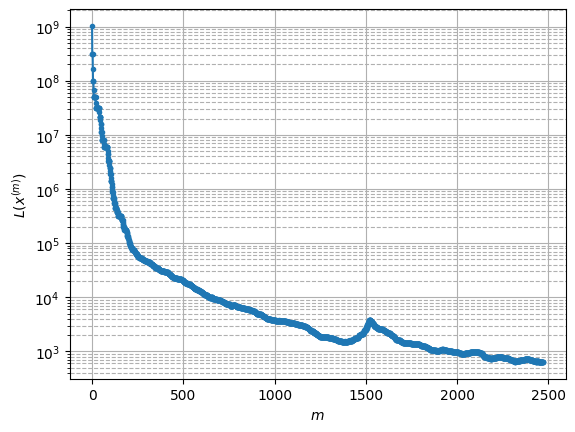

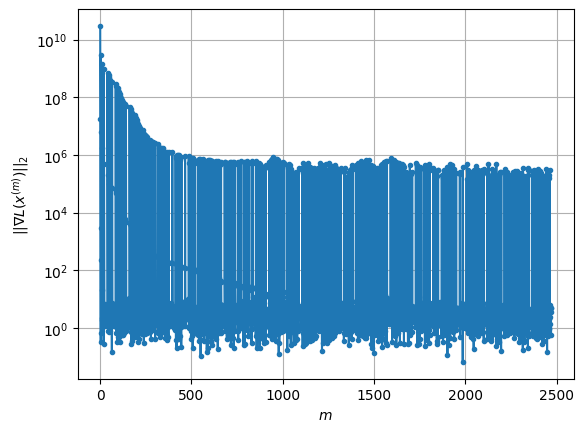

Windows:  98%|█████████▊| 289/296 [1:43:57<01:26, 12.38s/it]


Majorization-Minimization Iteration 1
Before applying the algorithm
Cost function: 657.2972629610271
Gradient norm: 276902.2158901419
Global relative error: 43.426996273620325
Position relative errors: 0.017979368326518554 m, 31.329186612403724 m, 7.035555076469969 m, 29.238434167613182 m

Iteration 1
Cost function: 655.8885128988692 (-0.21%)
Gradient norm: 3.721888846583893 (-100.00%)
Global relative error = 43.40136539336079 (-0.06%)
Position relative errors: 0.020886662020865792 m, 31.320309070813263 m, 7.04447969785691 m, 29.207720701920163 m

STOP on Iteration 2
Cost function = 655.8885125254484 (-0.00%)
Gradient norm = 0.795347819462365 (-78.63%)
Global relative error = 43.40136540253254 (0.00%)
Final position relative errors: 0.020886665158244264 m, 31.32030907339354 m, 7.044479695969163 m, 29.207720713235105 m

Majorization-Minimization converged after 1 iterations


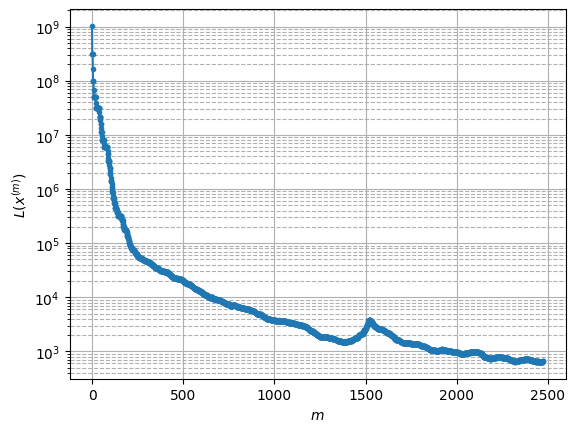

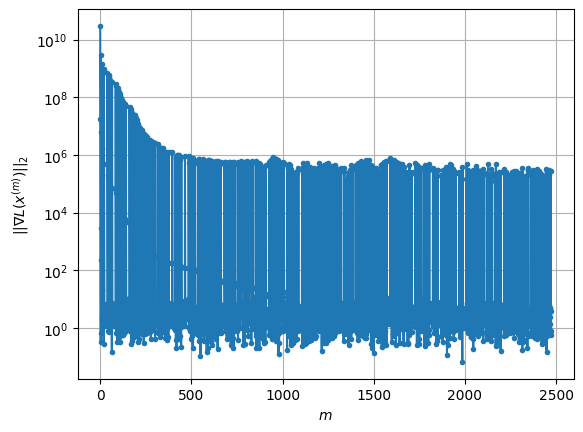

Windows:  98%|█████████▊| 290/296 [1:44:05<01:05, 10.89s/it]


Majorization-Minimization Iteration 1
Before applying the algorithm
Cost function: 656.643815382739
Gradient norm: 163226.55841489226
Global relative error: 41.80190919313441
Position relative errors: 0.022114555039914753 m, 30.303864453219568 m, 7.098695379605743 m, 27.90488491221136 m

Iteration 1
Cost function: 655.601795889713 (-0.16%)
Gradient norm: 4.599683419652433 (-100.00%)
Global relative error = 41.77769396607712 (-0.06%)
Position relative errors: 0.03181260786953727 m, 30.295125572486768 m, 7.107087846218088 m, 27.875948914654032 m

Iteration 2
Cost function: 655.6017973119318 (0.00%)
Gradient norm: 2.52978336801189 (-45.00%)
Global relative error = 41.77769397188797 (0.00%)
Position relative errors: 0.031812611605414695 m, 30.295125574016215 m, 7.107087845489863 m, 27.875948921881967 m

Iteration 3
Cost function: 655.6017961138527 (-0.00%)
Gradient norm: 3.811504827500887 (50.67%)
Global relative error = 41.777693971982515 (0.00%)
Position relative errors: 0.0318126067104

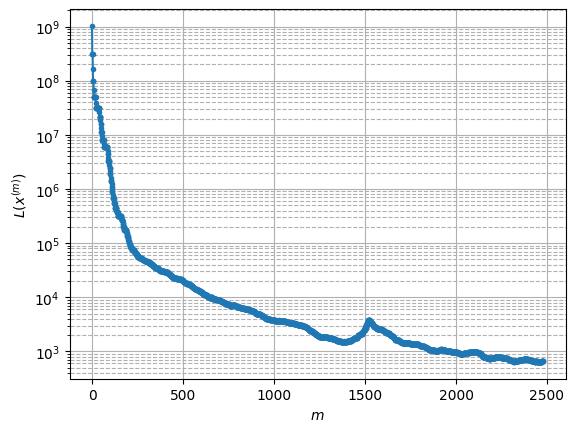

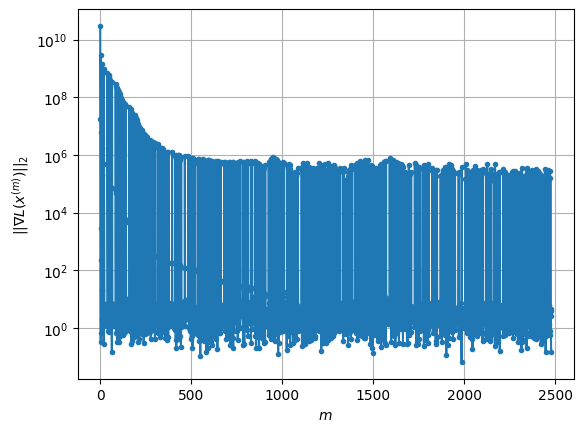

Windows:  98%|█████████▊| 291/296 [1:44:17<00:57, 11.43s/it]


Majorization-Minimization Iteration 1
Before applying the algorithm
Cost function: 654.8661948428337
Gradient norm: 132117.32907242922
Global relative error: 40.00174417895782
Position relative errors: 0.03261939444437451 m, 29.146814451992768 m, 7.128502238424945 m, 26.453451909083565 m

Iteration 1
Cost function: 654.0503003555878 (-0.12%)
Gradient norm: 2.016166605868922 (-100.00%)
Global relative error = 39.9790191292697 (-0.06%)
Position relative errors: 0.026260956585776825 m, 29.13822012557334 m, 7.136600735484631 m, 26.42637551247696 m

STOP on Iteration 2
Cost function = 654.0503003718057 (0.00%)
Gradient norm = 0.6950633891660282 (-65.53%)
Global relative error = 39.97901913584961 (0.00%)
Final position relative errors: 0.026260957136950775 m, 29.138220128387744 m, 7.136600734873319 m, 26.426375519492666 m

Majorization-Minimization converged after 1 iterations


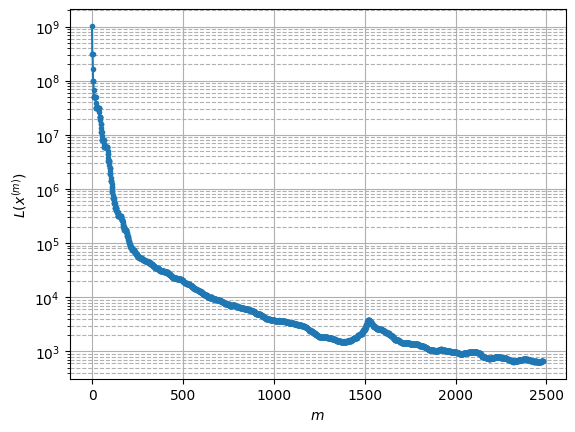

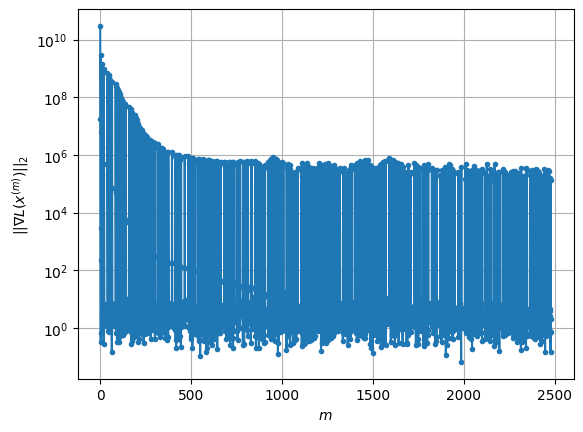

Windows:  99%|█████████▊| 292/296 [1:44:25<00:41, 10.30s/it]


Majorization-Minimization Iteration 1
Before applying the algorithm
Cost function: 660.2226621846092
Gradient norm: 186204.5172033641
Global relative error: 38.03519597156502
Position relative errors: 0.027268573559092138 m, 27.86320973491708 m, 7.1250288735549825 m, 24.890755223256186 m

Iteration 1
Cost function: 658.5479865874063 (-0.25%)
Gradient norm: 1.9493754807027945 (-100.00%)
Global relative error = 38.013754404556074 (-0.06%)
Position relative errors: 0.0235212576282577 m, 27.85491428758714 m, 7.134424698841443 m, 24.864583395960143 m

Iteration 2
Cost function: 658.5479858689833 (-0.00%)
Gradient norm: 1.6383318329394063 (-15.96%)
Global relative error = 38.01375441307507 (0.00%)
Position relative errors: 0.023521253208858024 m, 27.85491429068341 m, 7.134424696673675 m, 24.864583406141772 m

Iteration 3
Cost function: 658.5479856635617 (-0.00%)
Gradient norm: 2.5491223524880966 (55.59%)
Global relative error = 38.01375441294262 (-0.00%)
Position relative errors: 0.02352125

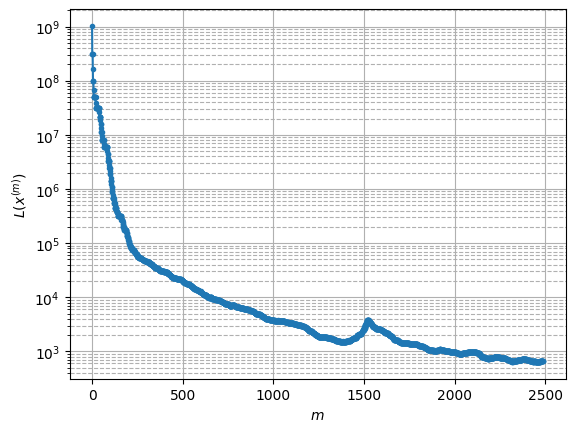

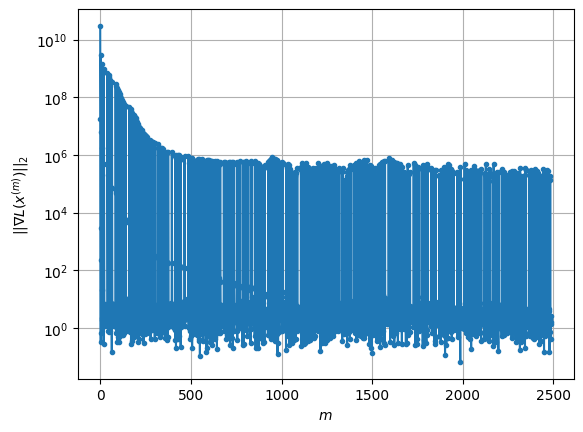

Windows:  99%|█████████▉| 293/296 [1:44:41<00:35, 11.99s/it]


Majorization-Minimization Iteration 1
Before applying the algorithm
Cost function: 659.8323451419107
Gradient norm: 190193.23765561037
Global relative error: 35.911576828566304
Position relative errors: 0.024482559367276713 m, 26.458905689279003 m, 7.089774200856057 m, 23.22285030350762 m

Iteration 1
Cost function: 658.4457956894945 (-0.21%)
Gradient norm: 4.4006956275319835 (-100.00%)
Global relative error = 35.89005261443473 (-0.06%)
Position relative errors: 0.02456962896900261 m, 26.44986035798679 m, 7.0994663102691025 m, 23.196903997745665 m

Iteration 2
Cost function: 658.4457961142342 (0.00%)
Gradient norm: 7.124929342983589 (61.90%)
Global relative error = 35.890052621724365 (0.00%)
Position relative errors: 0.024569627642662826 m, 26.449860360770565 m, 7.099466308145256 m, 23.196904006501384 m

Iteration 3
Cost function: 658.4457961430057 (0.00%)
Gradient norm: 1.5288113241703691 (-78.54%)
Global relative error = 35.89005262186684 (0.00%)
Position relative errors: 0.02456962

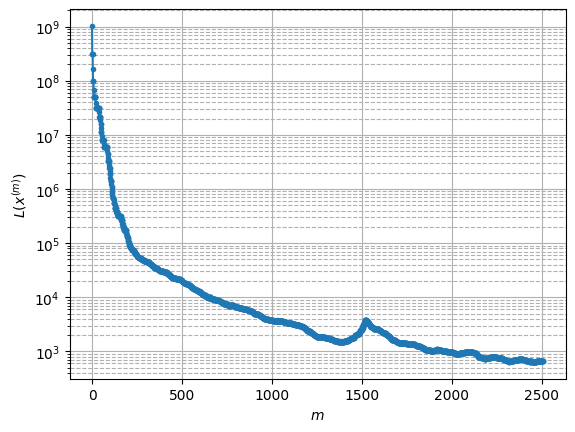

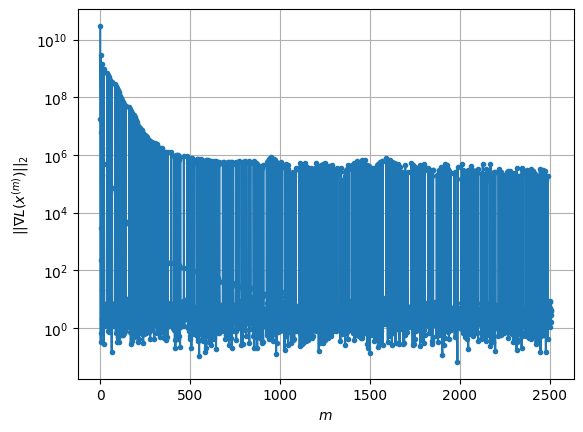

Windows:  99%|█████████▉| 294/296 [1:45:28<00:44, 22.43s/it]


Majorization-Minimization Iteration 1
Before applying the algorithm
Cost function: 654.3064802985106
Gradient norm: 148470.04614332246
Global relative error: 33.639966404756244
Position relative errors: 0.025538561210396816 m, 24.939113583634025 m, 7.021944538163072 m, 21.456421487595446 m

Iteration 1
Cost function: 653.3183402716018 (-0.15%)
Gradient norm: 1.412289468579981 (-100.00%)
Global relative error = 33.621426794688986 (-0.06%)
Position relative errors: 0.026653047949120247 m, 24.93160237365516 m, 7.03060869744165 m, 21.43324063645596 m

Iteration 2
Cost function: 653.3183398105202 (-0.00%)
Gradient norm: 2.8278220437982347 (100.23%)
Global relative error = 33.621426801110275 (0.00%)
Position relative errors: 0.026653045158166643 m, 24.931602376580702 m, 7.03060869699801 m, 21.43324064327469 m

Iteration 3
Cost function: 653.3183408259342 (0.00%)
Gradient norm: 3.5158194458029124 (24.33%)
Global relative error = 33.62142680147114 (0.00%)
Position relative errors: 0.026653054

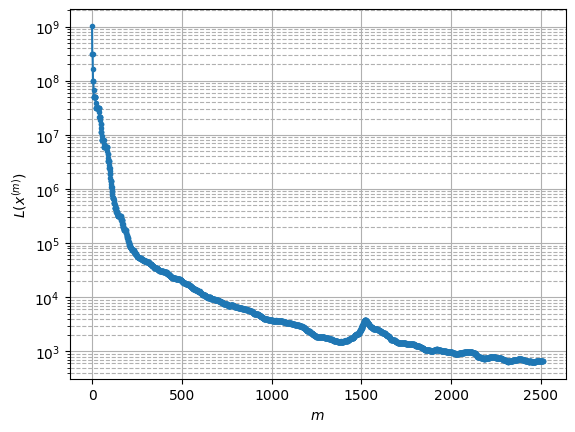

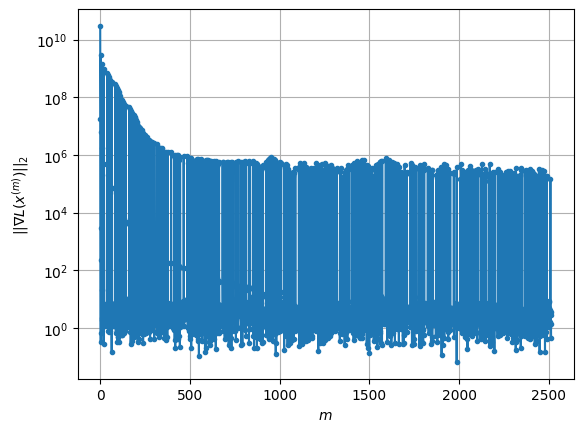

Windows: 100%|█████████▉| 295/296 [1:45:40<00:19, 19.34s/it]


Majorization-Minimization Iteration 1
Before applying the algorithm
Cost function: 652.7909437268237
Gradient norm: 344443.08275219874
Global relative error: 31.234914612372062
Position relative errors: 0.027437729453352634 m, 23.31279421418427 m, 6.920560032237987 m, 19.601960498141413 m

STOP on Iteration 1
Cost function = 650.833452864391 (-0.30%)
Gradient norm = 0.8320102691945853 (-100.00%)
Global relative error = 31.219648536406748 (-0.05%)
Final position relative errors: 0.02909990742683674 m, 23.3047071329219 m, 6.931596200775054 m, 19.58334633326138 m

Majorization-Minimization converged after 1 iterations


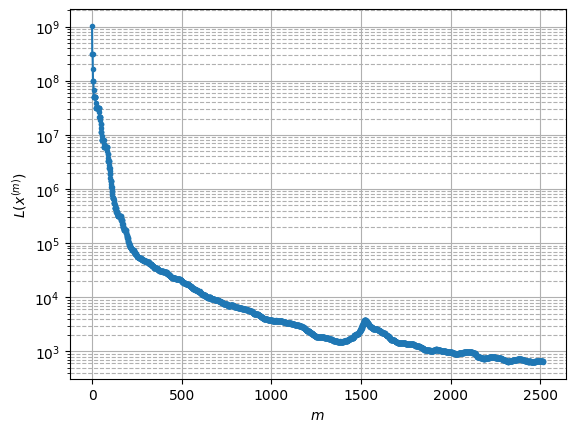

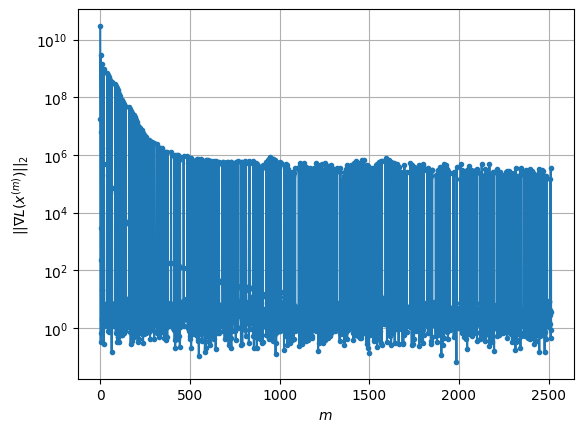

RMSE after convergence:
Chief: nan m
Deputy 1: nan m
Deputy 2: nan m
Deputy 3: nan m


/usr/local/lib/python3.10/dist-packages/numpy/core/fromnumeric.py:3504: RuntimeWarning: Mean of empty slice.
  return _methods._mean(a, axis=axis, dtype=dtype,
/usr/local/lib/python3.10/dist-packages/numpy/core/_methods.py:129: RuntimeWarning: invalid value encountered in scalar divide
  ret = ret.dtype.type(ret / rcount)


In [11]:
# Main execution loop
def run_estimation():
    
    Y = np.zeros((9, 1, T))
    for t in range(T):
        Y[:, :, t] = h(X_true[:, :, t]) + np.random.normal(0, np.sqrt(np.diag(R)).reshape((9, 1)), size=(9, 1))
        
    # Initialize storage for results
    X_est_mm = np.zeros_like(X_true)
    X_est_mm[:, :, 0] = X_est[:, :, 0]  # Use same initial conditions
    
    # Storage for errors
    errors_chief_mm = []
    errors_deputy1_mm = []
    errors_deputy2_mm = []
    errors_deputy3_mm = []
    
    # Initialize solver
    solver = MM_Newton()
    
    # Sliding window estimation
    for t in tqdm(range(T - W + 1), desc="Windows", leave=False):
        # Get measurements for current window
        Y_window = Y[:, :, t:t + W]
        
        # Initial guess is the previous estimate propagated forward
        if t == 0:
            x_init = X_est[:, :, t]
        else:
            x_init = X_est_mm[:, :, t]
        
        # Solve the optimization problem
        x_sol = solver.solve(x_init, Y_window, X_true[:, :, t])
        
        # Store the solution
        X_est_mm[:, :, t] = x_sol
        
        # Plot the results
        give_me_the_plots(solver.cost_function_values, solver.grad_norm_values)
        
        # Propagate solution to next timestep if not at the end
        if t < T - W:
            X_est_mm[:, :, t + 1] = SatelliteDynamics().x_new(dt, x_sol)
        
        # Calculate and store errors
        error_chief = np.linalg.norm(X_est_mm[:3, :, t] - X_true[:3, :, t])
        error_deputy1 = np.linalg.norm(X_est_mm[6:9, :, t] - X_true[6:9, :, t])
        error_deputy2 = np.linalg.norm(X_est_mm[12:15, :, t] - X_true[12:15, :, t])
        error_deputy3 = np.linalg.norm(X_est_mm[18:21, :, t] - X_true[18:21, :, t])
        
        errors_chief_mm.append(error_chief)
        errors_deputy1_mm.append(error_deputy1)
        errors_deputy2_mm.append(error_deputy2)
        errors_deputy3_mm.append(error_deputy3)
    
    return X_est_mm, errors_chief_mm, errors_deputy1_mm, errors_deputy2_mm, errors_deputy3_mm

# Run the estimation
X_est_mm, errors_chief_mm, errors_deputy1_mm, errors_deputy2_mm, errors_deputy3_mm = run_estimation()

# Print RMSE for each satellite
print("RMSE after convergence:")
print(f"Chief: {np.sqrt(np.mean(np.array(errors_chief_mm[T_RMSE:])**2)):.2f} m")
print(f"Deputy 1: {np.sqrt(np.mean(np.array(errors_deputy1_mm[T_RMSE:])**2)):.2f} m")
print(f"Deputy 2: {np.sqrt(np.mean(np.array(errors_deputy2_mm[T_RMSE:])**2)):.2f} m")
print(f"Deputy 3: {np.sqrt(np.mean(np.array(errors_deputy3_mm[T_RMSE:])**2)):.2f} m")

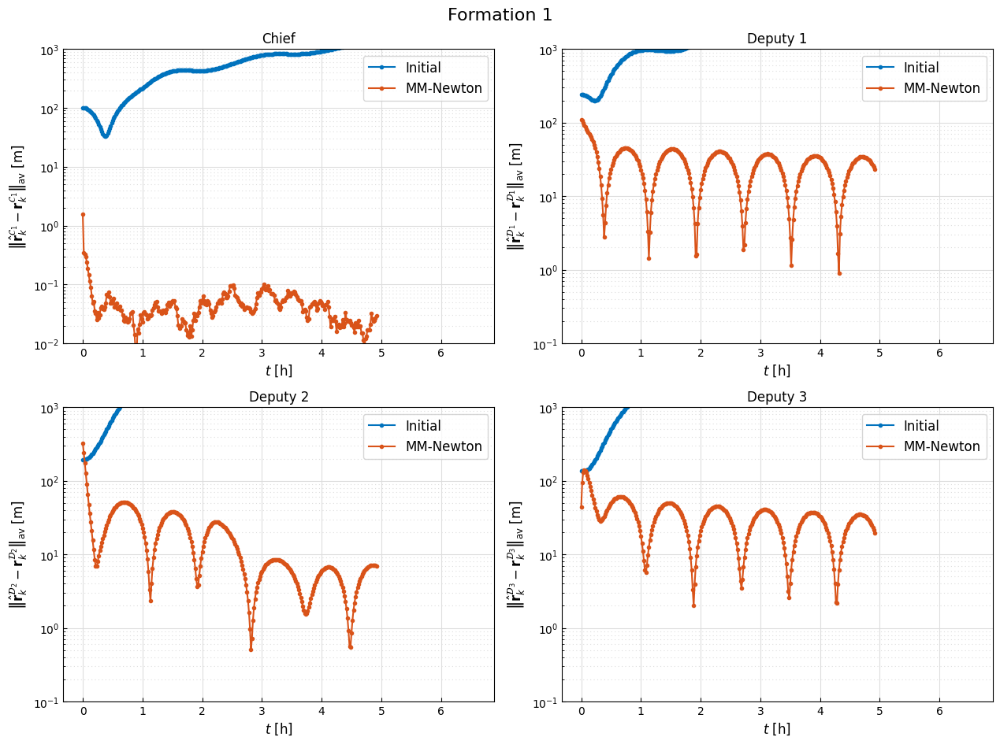

In [12]:
dev_chief = errors_chief_mm
dev_deputy1 = errors_deputy1_mm
dev_deputy2 = errors_deputy2_mm
dev_deputy3 = errors_deputy3_mm

# MATLAB default color cycle
matlab_default_colors = [
    [0, 0.4470, 0.7410],  # blue
    [0.8500, 0.3250, 0.0980],  # orange
    [0.9290, 0.6940, 0.1250],  # yellow
    [0.4940, 0.1840, 0.5560],  # purple
    [0.4660, 0.6740, 0.1880],  # green
    [0.3010, 0.7450, 0.9330],  # light blue
    [0.6350, 0.0780, 0.1840],  # red
]
# Set the color cycle in Matplotlib to match MATLAB's default
plt.rcParams["axes.prop_cycle"] = plt.cycler(color=matlab_default_colors)

time = np.arange(0, T) / dt
algorithm = "MM-Newton"

# Plot positions based on screen size
fig_width = 2 * 6.4  # in inchesa
fig_height = 2 * 4.8  # in inches

# Create a 2 by 2 figure
fig, axs = plt.subplots(2, 2, figsize=(fig_width, fig_height))

# Plot 1: Chief
axs[0, 0].plot(time, dev_chief_initial, ".-", label="Initial")
axs[0, 0].plot(time[:K - W + 1], dev_chief, ".-", label=algorithm)
axs[0, 0].grid(which="major", color="#DDDDDD", zorder=1)
axs[0, 0].grid(which="minor", color="#DDDDDD", linestyle=(0, (1, 3)), zorder=2)
axs[0, 0].grid(True, which="both")
axs[0, 0].set_yscale("log")
axs[0, 0].set_xlabel("$t$ [h]", fontsize=12)
axs[0, 0].set_ylabel(
    "$\\left\\|\\hat{\\mathbf{r}}_k^{\\mathcal{C}_1} - \\mathbf{r}_k^{\\mathcal{C}_1}\\right\\|_\\mathrm{av}$ [m]",
    fontsize=12,
)
axs[0, 0].set_ylim([1e-2, 1e3])
axs[0, 0].tick_params(axis="both", which="both", direction="in")
axs[0, 0].legend(fontsize=12)
axs[0, 0].set_title("Chief")

# Plot 2: Deputy 1
axs[0, 1].plot(time, dev_deputy1_initial, ".-", label="Initial")
axs[0, 1].plot(time[:K - W + 1], dev_deputy1, ".-", label=algorithm)
axs[0, 1].grid(which="major", color="#DDDDDD", zorder=1)
axs[0, 1].grid(which="minor", color="#DDDDDD", linestyle=(0, (1, 3)), zorder=2)
axs[0, 1].grid(True, which="both")
axs[0, 1].set_yscale("log")
axs[0, 1].set_xlabel("$t$ [h]", fontsize=12)
axs[0, 1].set_ylabel(
    "$\\left\\|\\hat{\\mathbf{r}}_k^{\\mathcal{D}_1} - \\mathbf{r}_k^{\\mathcal{D}_1}\\right\\|_\\mathrm{av}$ [m]",
    fontsize=12,
)
axs[0, 1].set_ylim([1e-1, 1e3])
axs[0, 1].tick_params(axis="both", which="both", direction="in")
axs[0, 1].legend(fontsize=12)
axs[0, 1].set_title("Deputy 1")

# Plot 3: Deputy 2
axs[1, 0].plot(time, dev_deputy2_initial, ".-", label="Initial")
axs[1, 0].plot(time[:K - W + 1], dev_deputy2, ".-", label=algorithm)
axs[1, 0].grid(which="major", color="#DDDDDD", zorder=1)
axs[1, 0].grid(which="minor", color="#DDDDDD", linestyle=(0, (1, 3)), zorder=2)
axs[1, 0].grid(True, which="both")
axs[1, 0].set_yscale("log")
axs[1, 0].set_xlabel("$t$ [h]", fontsize=12)
axs[1, 0].set_ylabel(
    "$\\left\\|\\hat{\\mathbf{r}}_k^{\\mathcal{D}_2} - \\mathbf{r}_k^{\\mathcal{D}_2}\\right\\|_\\mathrm{av}$ [m]",
    fontsize=12,
)
axs[1, 0].set_ylim([1e-1, 1e3])
axs[1, 0].tick_params(axis="both", which="both", direction="in")
axs[1, 0].legend(fontsize=12)
axs[1, 0].set_title("Deputy 2")

# Plot 4: Deputy 3
axs[1, 1].plot(time, dev_deputy3_initial, ".-", label="Initial")
axs[1, 1].plot(time[:K - W + 1], dev_deputy3, ".-", label=algorithm)
axs[1, 1].grid(which="major", color="#DDDDDD", zorder=1)
axs[1, 1].grid(which="minor", color="#DDDDDD", linestyle=(0, (1, 3)), zorder=2)
axs[1, 1].grid(True, which="both")
axs[1, 1].set_yscale("log")
axs[1, 1].set_xlabel("$t$ [h]", fontsize=12)
axs[1, 1].set_ylabel(
    "$\\left\\|\\hat{\\mathbf{r}}_k^{\\mathcal{D}_3} - \\mathbf{r}_k^{\\mathcal{D}_3}\\right\\|_\\mathrm{av}$ [m]",
    fontsize=12,
)
axs[1, 1].set_ylim([1e-1, 1e3])
axs[1, 1].tick_params(axis="both", which="both", direction="in")
axs[1, 1].legend(fontsize=12)
axs[1, 1].set_title("Deputy 3")

fig.suptitle(f"Formation {formation}", fontsize=16)
plt.tight_layout(rect=[0, 0, 1, 1])
plt.show()

In [14]:
import pickle
from datetime import datetime

# Fill the dictionary
data = {}
data["true"] = X_true
data[0] = X_est_mm

# Save to pickle file
with open(
    f'mm_newton2_form{formation}_{datetime.now().strftime("%Y%m%d_%H%M%S")}.pkl',
    "wb",
) as file:
    pickle.dump(data, file)